In [1]:
#!/usr/bin/env python

import matplotlib.pyplot as plt
import scipy.io as sio
import numpy as np
import math
import sys, os
import os.path
import shutil
import pylab as pl
import pickle as pickle
from lcdata import get_LC as lc
from lcdata import get_PR as pr
import mce_data

/usr/lib/python3/dist-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
#===================================#
# INPUTS
#===================================#
class opts:
	testbed = 'BA'
	freq = 150 # GHz --> H10 is 220GHz but mapping is same (H & L modules = same mapping, and darks in same places)
	date = '20240416'
	module = 'H10'
	runn = '%s_%s_%s'%(date,testbed,module)
	fn300 = 'LC_light_FPU_326mK_datamode1_run5_with_plate'
	fn077 = 'LC_light_FPU_321mK_datamode1_run10_ln2'
	fitrange = {'rnti_low': 2000.00,
    	        'rnti_hgh': 2500.00,
	            'sc_low': None,
                'sc_high': None}
	im = 1 # Columns 16 - 31 (second half of mce)
	cols = range(16*im,16*(im+1))
	rows = range(41)
    #dets = [(19,2),(24,2),(27,2),(03,3),(07,3),(15,3),(22,3),(23,3),(25,3),(29,3),(32,3),(12,4),(23,4),(04,5),(23,9)]
    #dets = [(32,8),(38,8),(39,8)]
	ifoutputinMCE = False
	doFigure = True
	# plot ax[1] xy limits
	pmin = 50  # pW
	pmax = 400 # pW
	rmin = 80 # mOhm
	rmax = 200 # mOhm
	# for finding psat
	reasonableInorm300 = 40.e-6 #A
	reasonableInorm077 = 40.e-6 #A

if opts.testbed in ['SK','sk']:
	import calib_SK
	calib = calib_SK.calib_sk()
	if opts.freq == 40:
		import ba40_ModuleMapping as minfo
	elif opts.freq == 30:
		import ba30_ModuleMapping_N3 as minfo
	elif opts.freq == 150:
		import Lx_ModuleMapping as minfo
	else:
		print('WRONG INPUT')
		print(opts)
elif opts.testbed in ['BA','ba']:
        import calib_BA2
        calib = calib_BA2.calib_ba2()
        if opts.freq == 40:
        	import ba40_ModuleMapping_BA2_badpos as minfo
        elif opts.freq == 30:
        	import ba30_ModuleMapping_BA as minfo
        elif opts.freq == 150:
                import Lx_ModuleMapping as minfo
else:
	print('WRONG INPUT')
	print(opts)

In [3]:
#===================================#
# Loading data
#===================================#
in_path  = 'oe_data/'
out_path_main = 'outputs/'

out_path = out_path_main
if not os.path.isdir(out_path):
    os.makedirs(out_path)

datafn300 = in_path + opts.fn300 + '/' + opts.fn300
datafn077 = in_path + opts.fn077 + '/' + opts.fn077 # file path

biasfn300 = datafn300 + '.bias'
f300 = mce_data.MCEFile(datafn300)

#===================================#

dname300 = os.path.split(datafn300)[0]
biasfn077 = datafn077 + '.bias'
f077 = mce_data.MCEFile(datafn077)
dname077 = os.path.split(datafn077)[0]

#===================================#
# Calib

bias300 = np.loadtxt(biasfn300,skiprows=1)
bias077 = np.loadtxt(biasfn077,skiprows=1)
# FLIP IT
y300 = -1.0*f300.Read(row_col=True,unfilter='DC').data # reading data
y077 = -1.0*f077.Read(row_col=True,unfilter='DC').data # give array for each detector, can find each detector by mce column

nr,nc,nt = y300.shape
rows = np.zeros((nc,nr),dtype=np.int64)
cols = np.zeros((nc,nr),dtype=np.int64)


oe_data/

oe_data/


In [4]:
#===================================#
# Outputs
#===================================#
dpdt_array = [[0 for i in range(41)] for j in range(32)]
psat300_array = [[0 for i in range(41)] for j in range(32)]
psat077_array = [[0 for i in range(41)] for j in range(32)]

rnti_array = [[0 for i in range(41)] for j in range(32)]
detcol_array = [[0 for i in range(41)] for j in range(32)]
detrow_array = [[0 for i in range(41)] for j in range(32)]
detpol_array = [[0 for i in range(41)] for j in range(32)]
dpdt_dark = [[0 for i in range(41)] for j in range(32)]

In [5]:
#===================================#
# Cook LC
#===================================#
nancount = 0
dark_detcolrow=[(5,1), (10,9), (5,18), (14,18)]

row 0, col 16


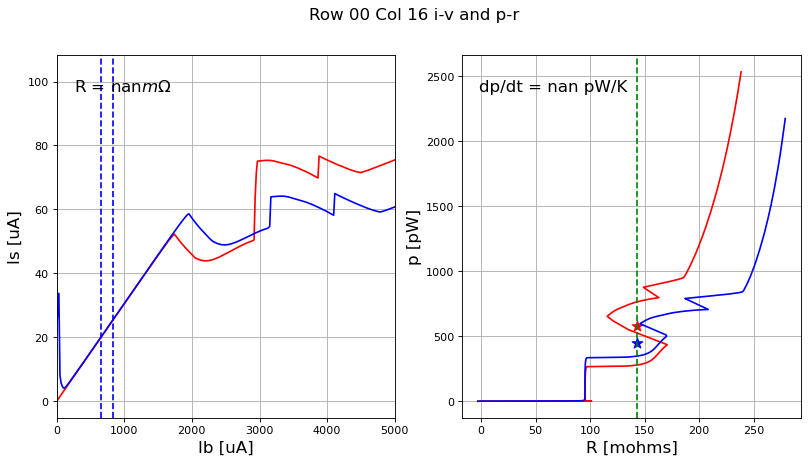

nan nan
row 0, col 17


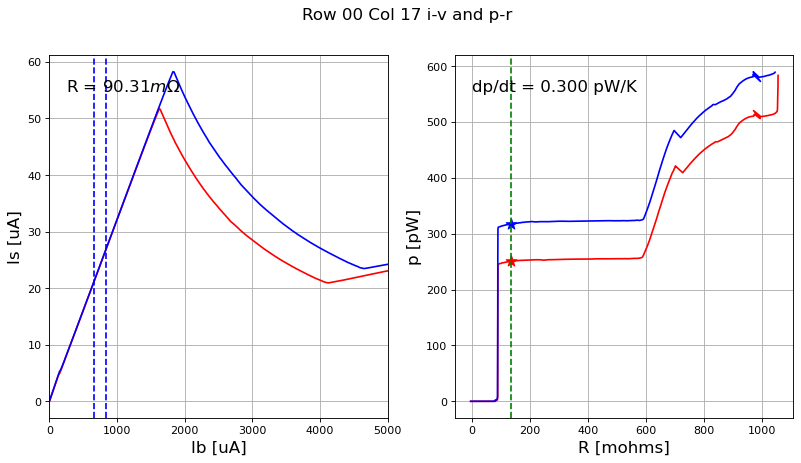

0.2997009229402868 0.09030832337562494
row 0, col 18


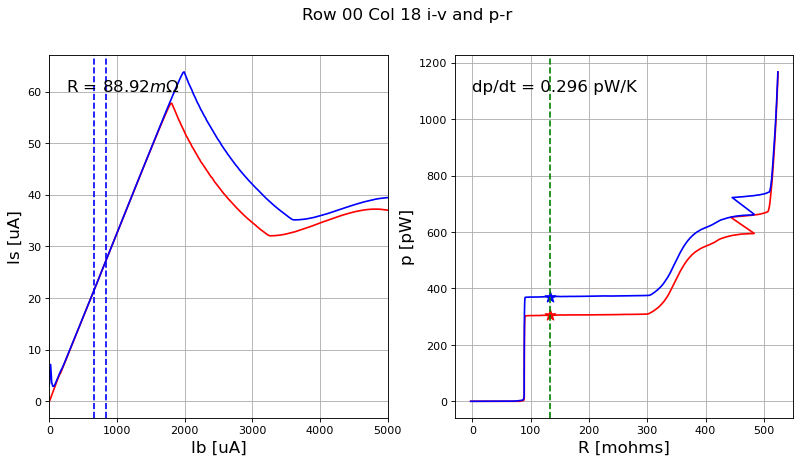

0.2962200379321109 0.0889220482884869
row 0, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


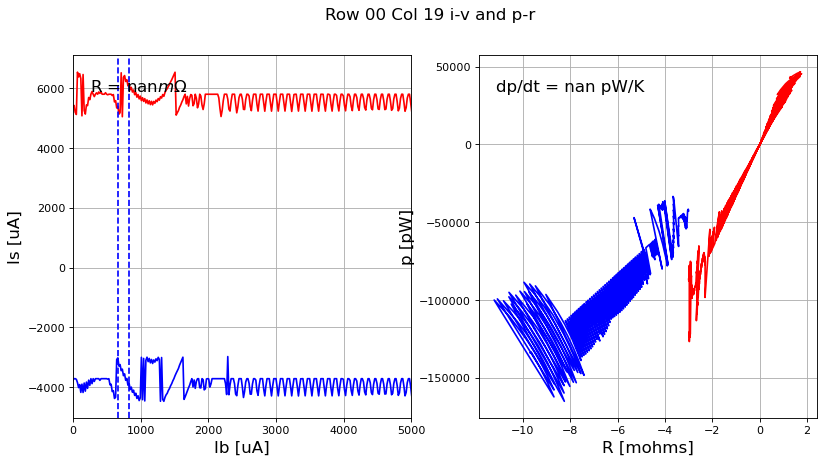

nan nan
row 0, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


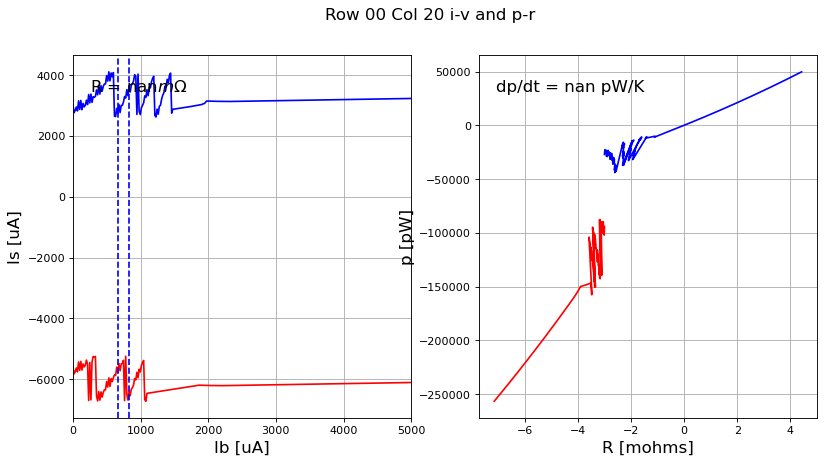

nan nan
row 0, col 21


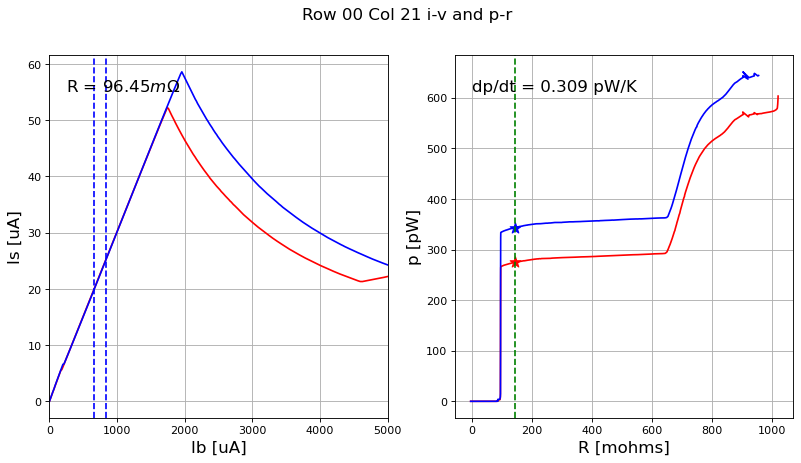

0.30901722125487563 0.09645263518821166
row 0, col 22


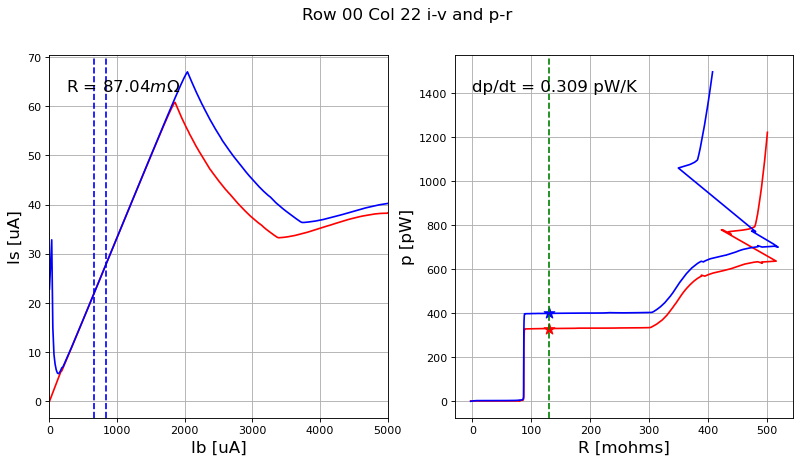

0.3088461832530352 0.08703916149542762
row 0, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


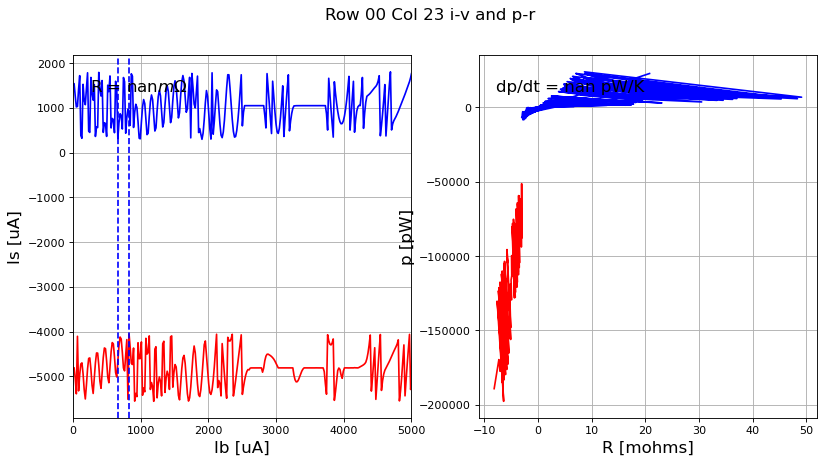

nan nan
row 0, col 24


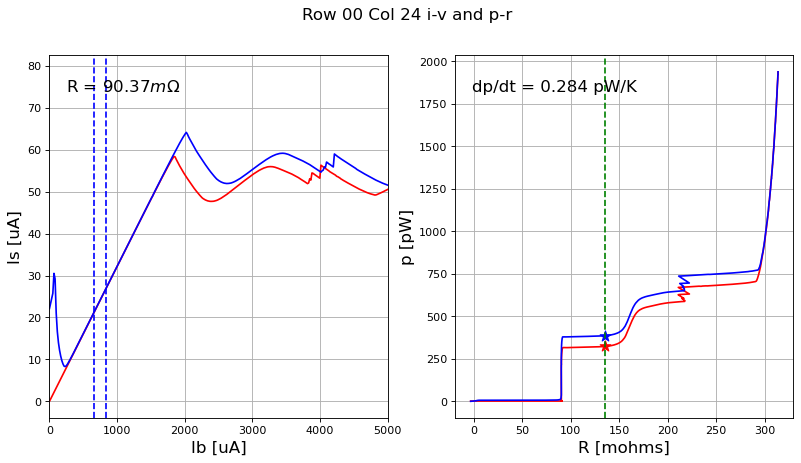

0.2837586983605862 0.0903680080941002
row 0, col 25


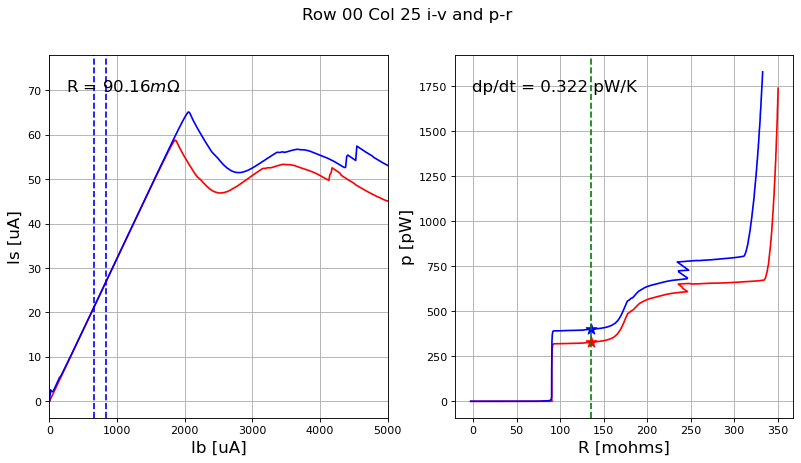

0.3224062260456997 0.09015734595718201
row 0, col 26


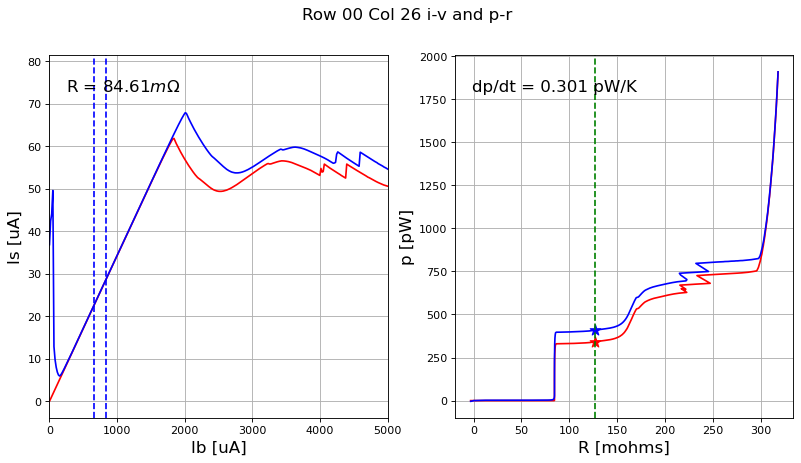

0.3014432449845926 0.08461284723319587
row 0, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


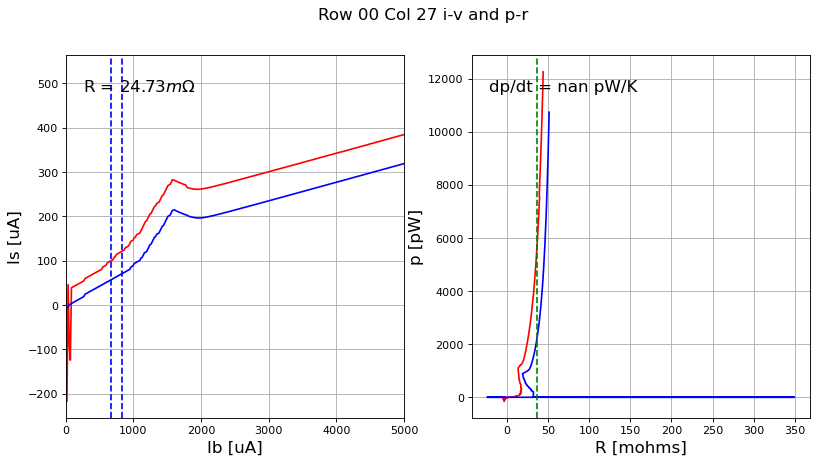

nan 0.024727293626432112
row 0, col 28


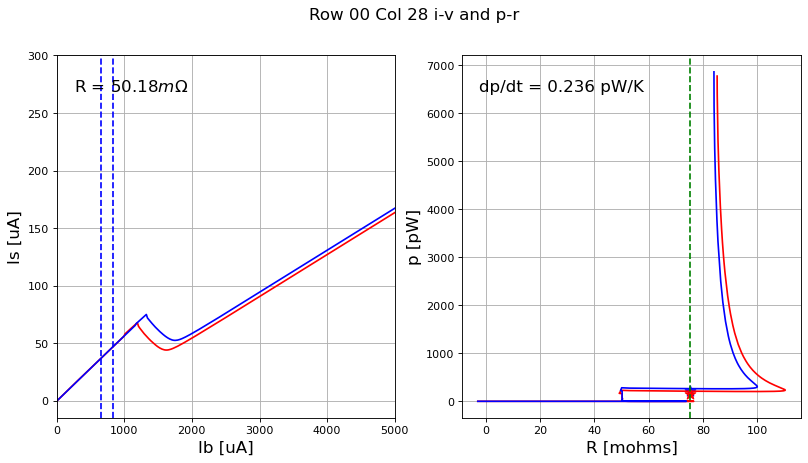

0.23585825779434608 0.05018207093630307
row 0, col 29


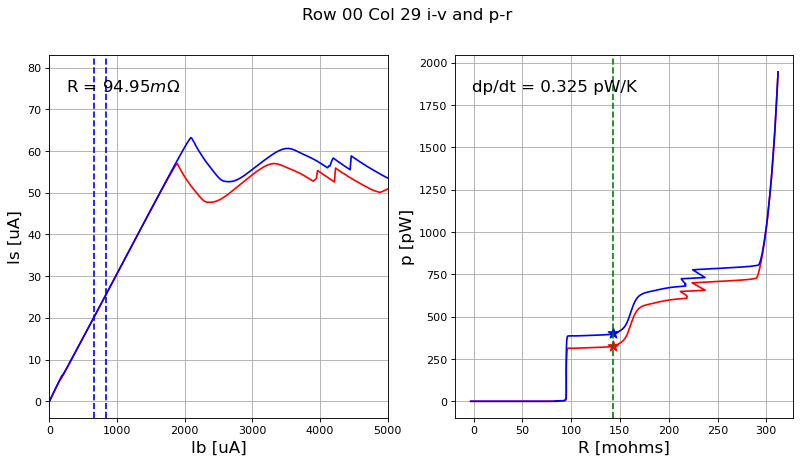

0.3247083943457821 0.09494942802505568
row 0, col 30


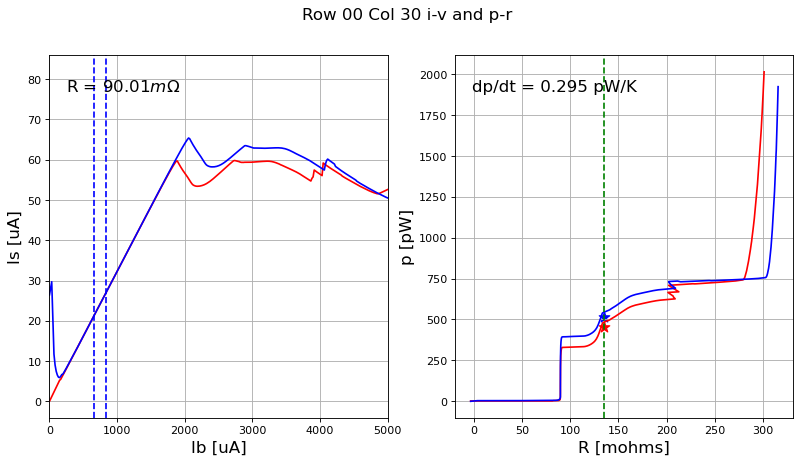

0.2953576269380913 0.09001319696620022
row 0, col 31


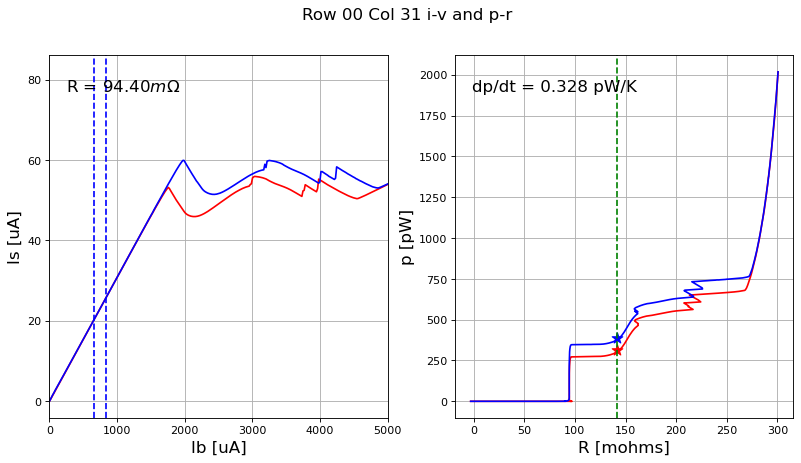

0.327504784676728 0.09439899723326708
row 1, col 16


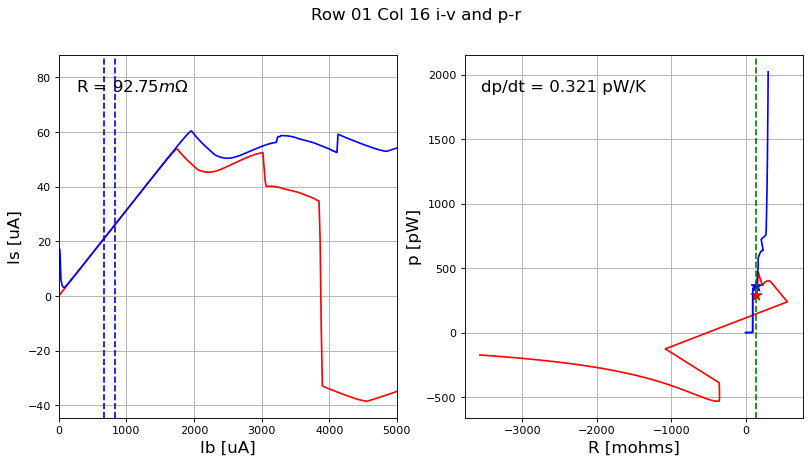

0.32113100721751053 0.0927476746425987
row 1, col 17


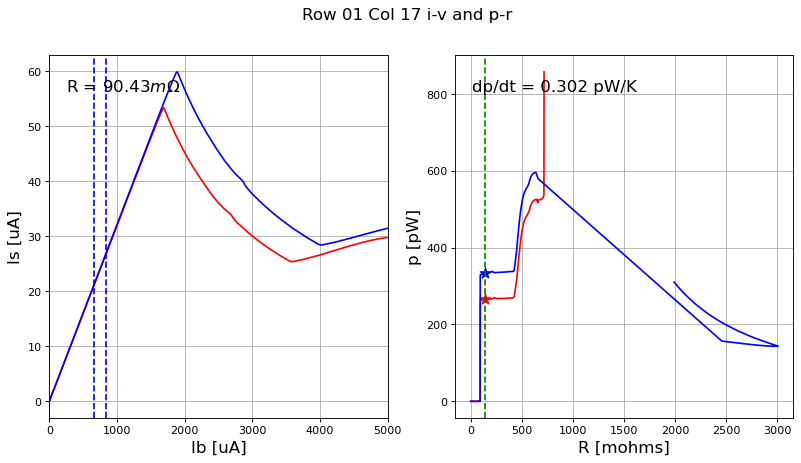

0.3022215334808277 0.09042954861950783
row 1, col 18


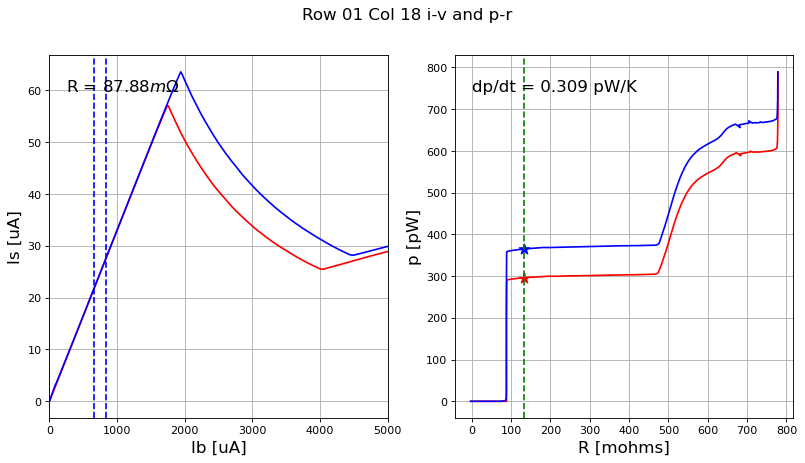

0.3088559922118074 0.08788189836929365
row 1, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


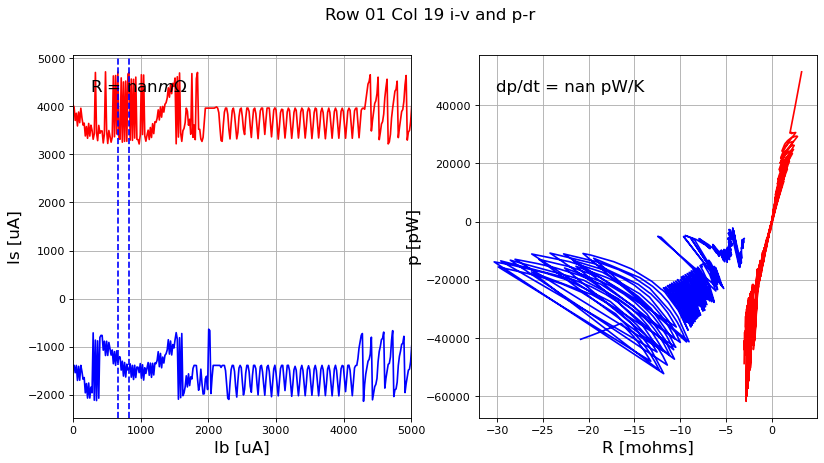

nan nan
row 1, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


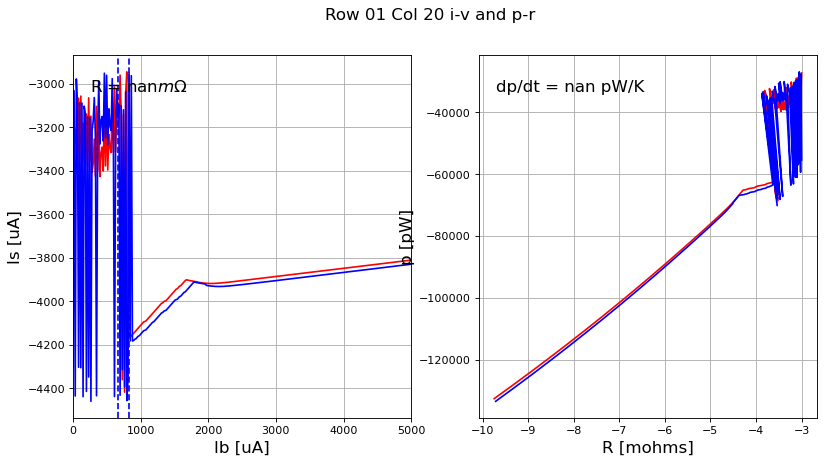

nan nan
row 1, col 21


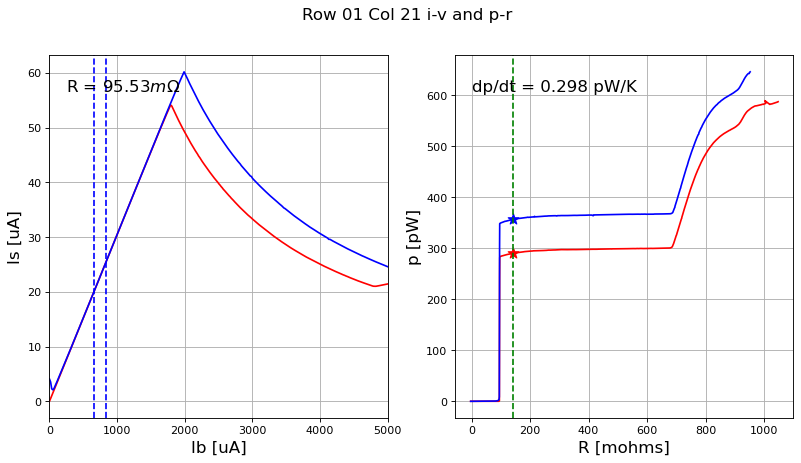

0.29785659492473504 0.09553461743652983
row 1, col 22


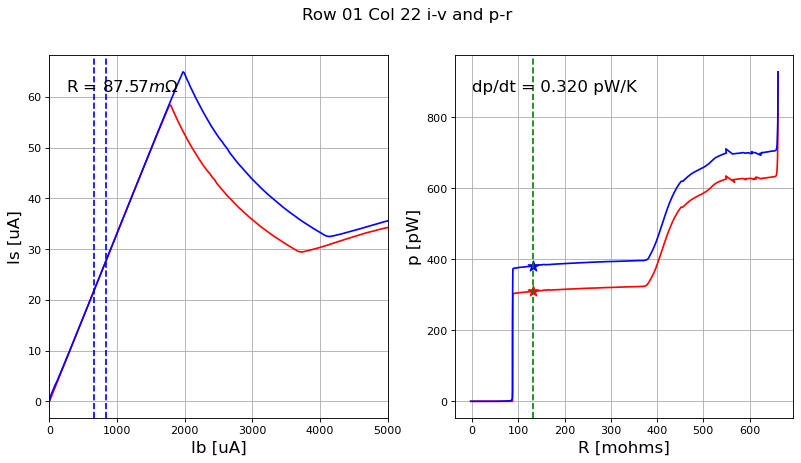

0.32016037922624074 0.08756700936584964
row 1, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


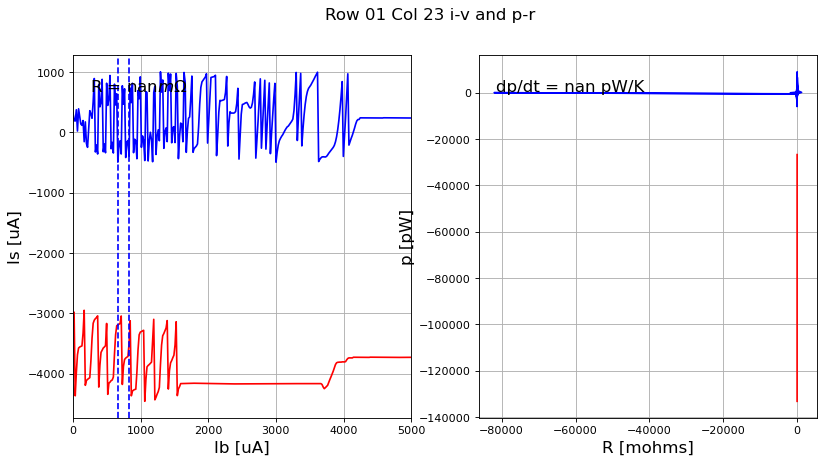

nan nan
row 1, col 24


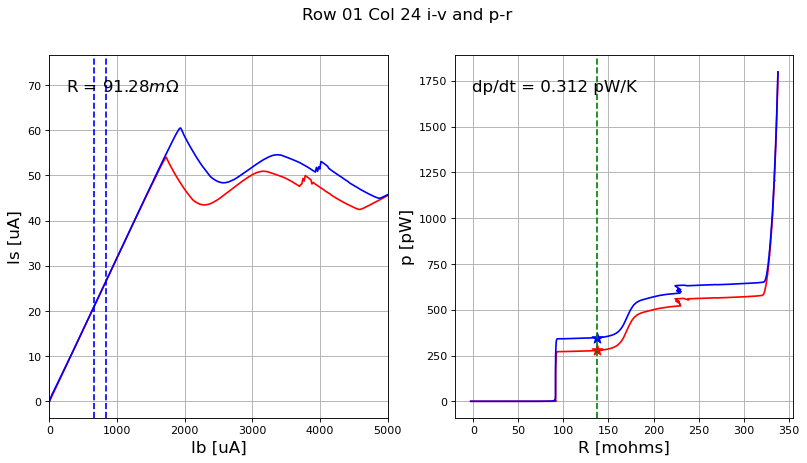

0.3119525881334037 0.09127918402360717
row 1, col 25


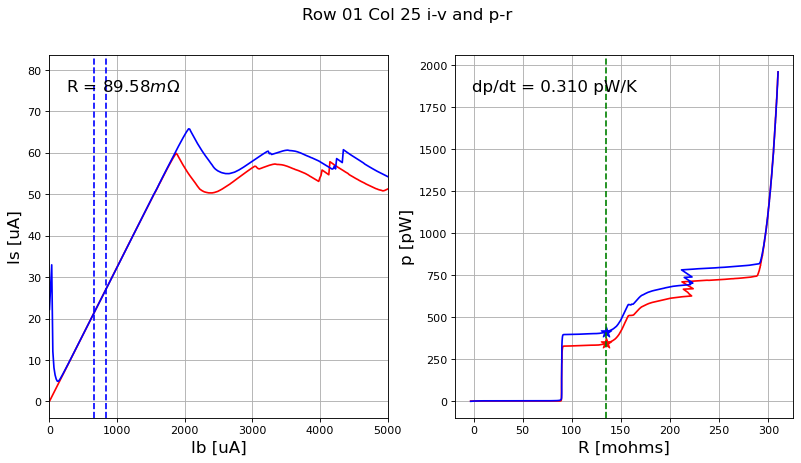

0.309661361345265 0.08957956524606053
row 1, col 26


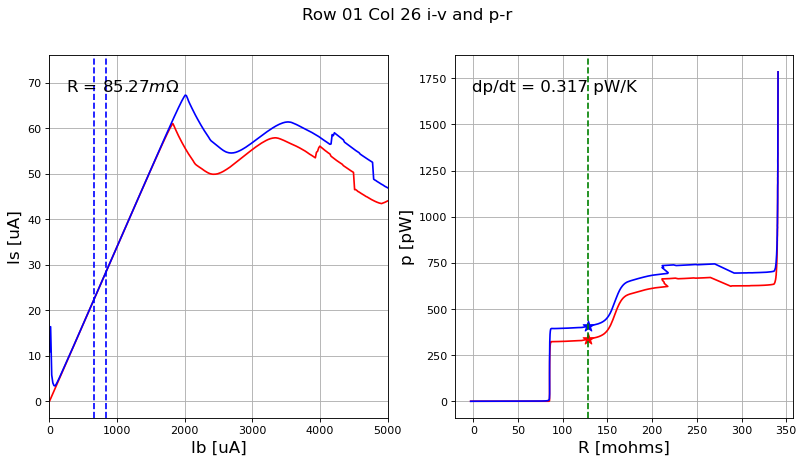

0.31701763636677927 0.08526504082146588
row 1, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


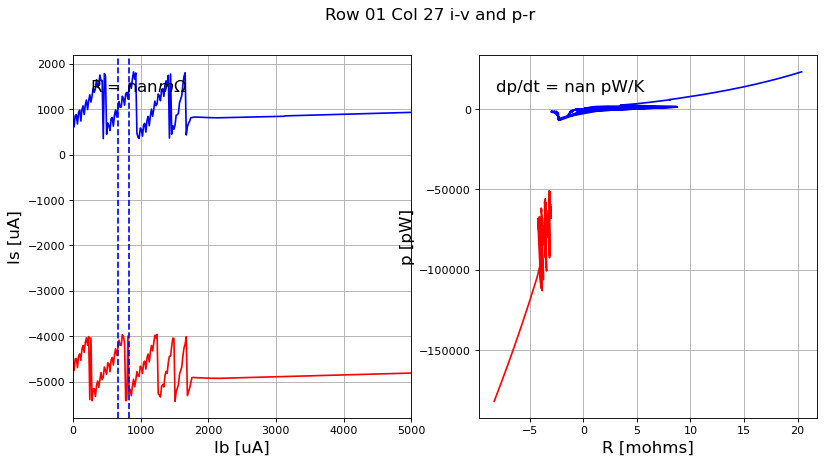

nan nan
row 1, col 28


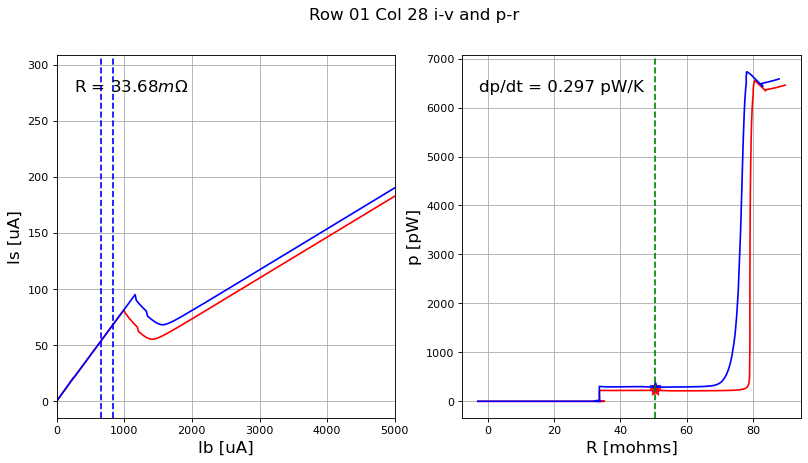

0.29711289460208207 0.033678062567173525
row 1, col 29


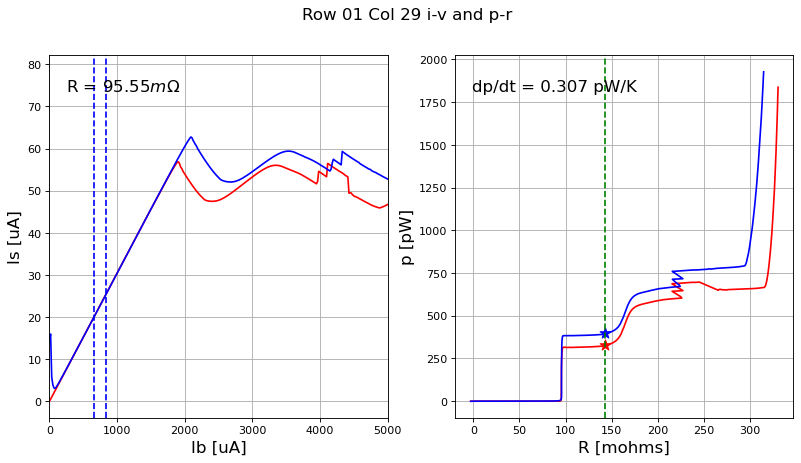

0.30697962583211036 0.09555401547832673
row 1, col 30


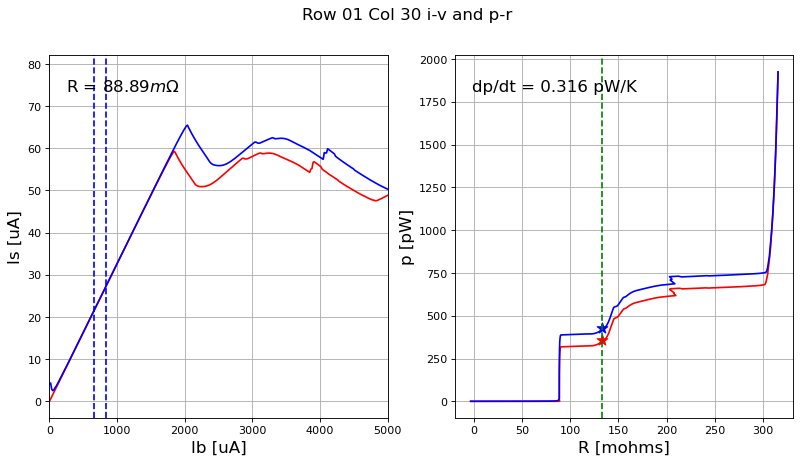

0.31572709922954495 0.08889493921110331
row 1, col 31


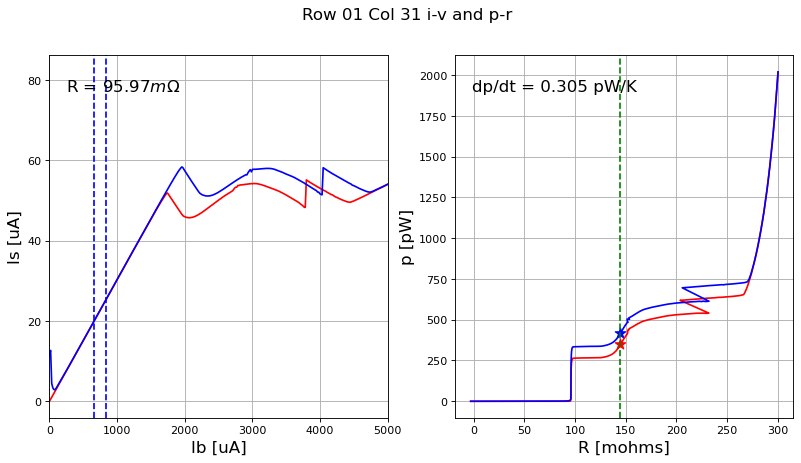

0.30464388057015834 0.09597427311356876
row 2, col 16


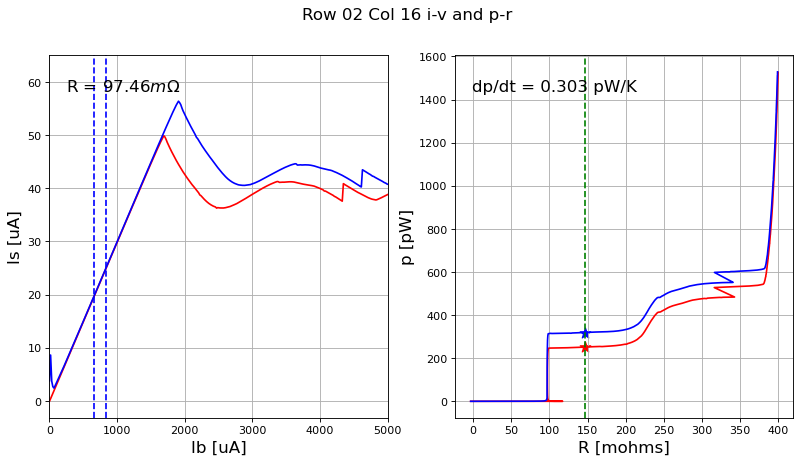

0.3033989779528262 0.09746418014477445
row 2, col 17


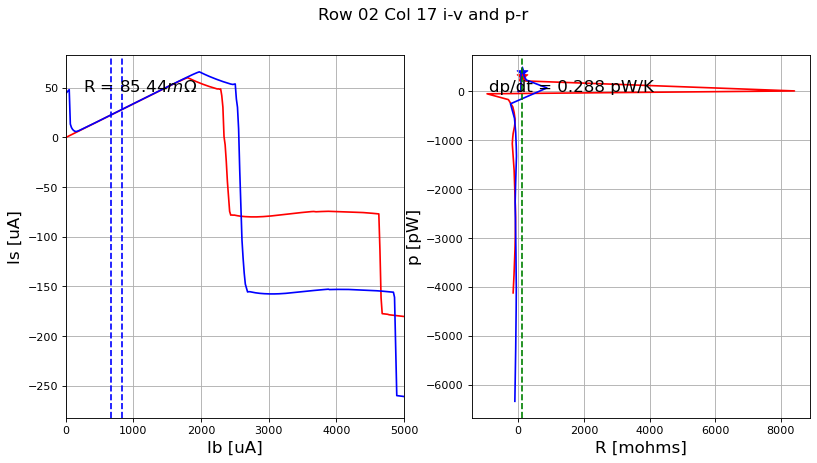

0.28786436479472677 0.0854361388242261
row 2, col 18


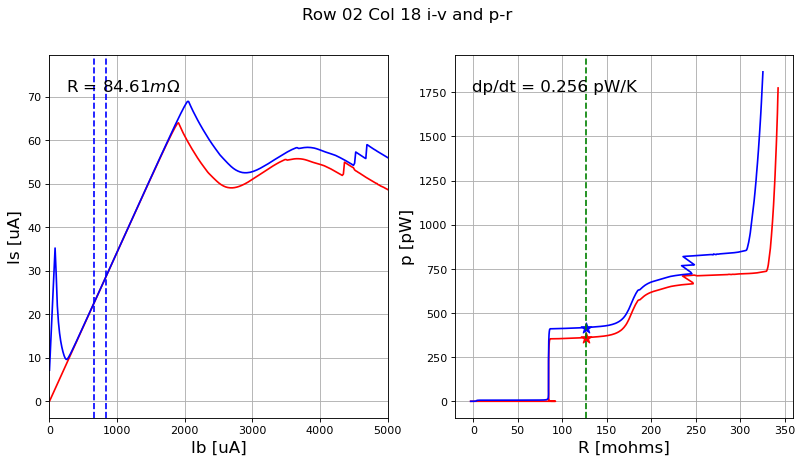

0.2560480278019814 0.08460680555133368
row 2, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


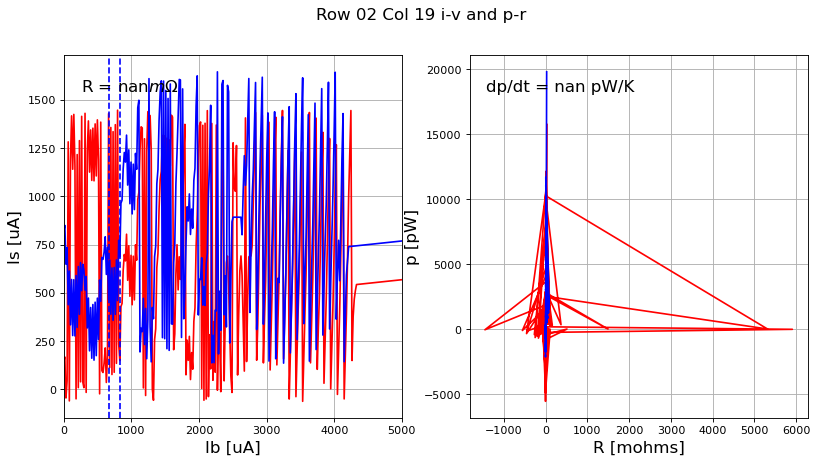

nan nan
row 2, col 20


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


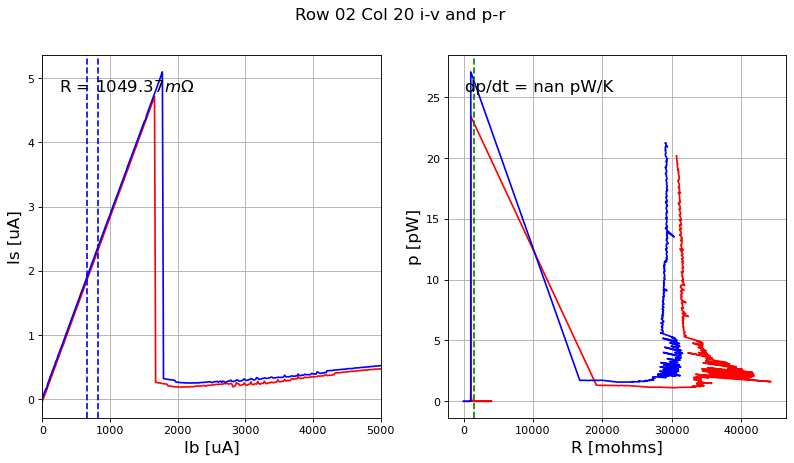

nan 1.049371950669262
row 2, col 21


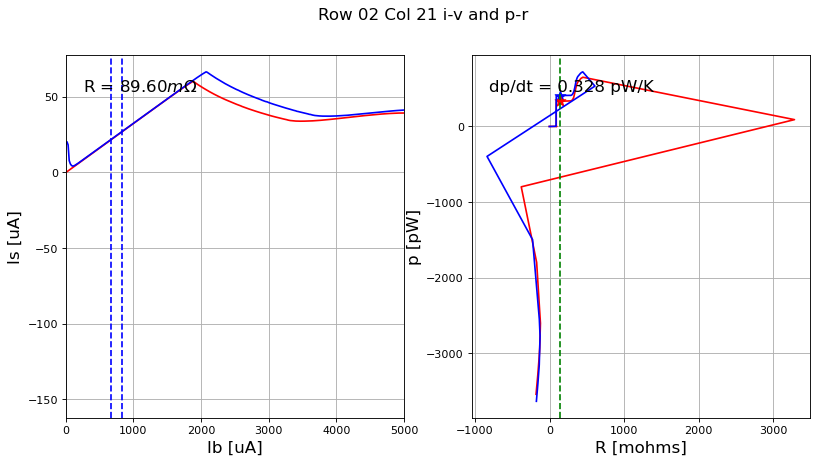

0.328316763177589 0.08960082387577867
row 2, col 22


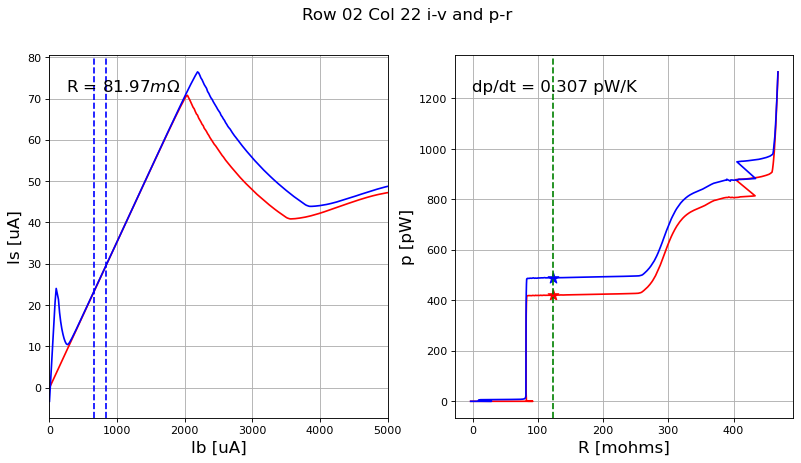

0.3067195303284918 0.08196868150636497
row 2, col 23


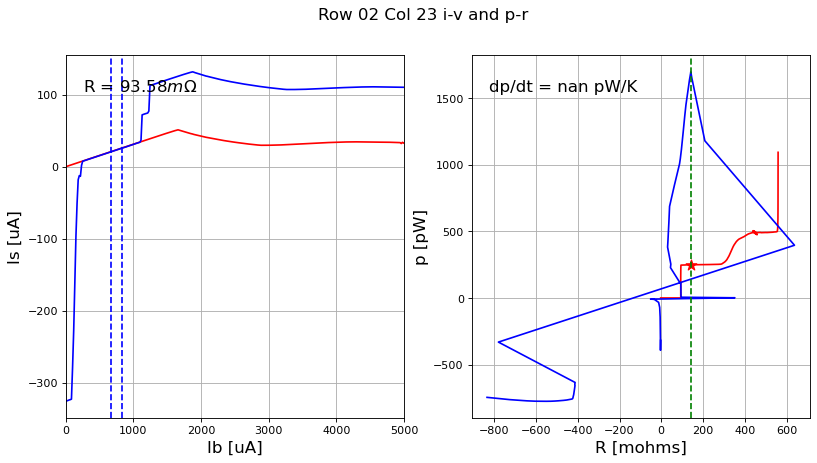

nan 0.093582347232682
row 2, col 24


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


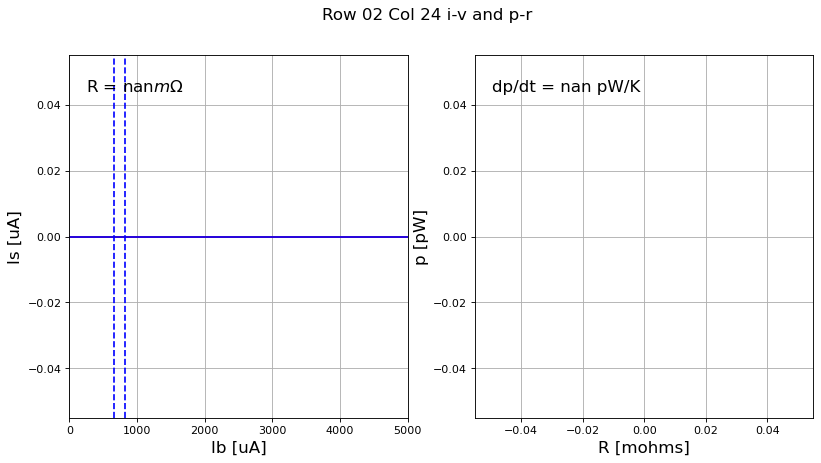

nan nan
row 2, col 25


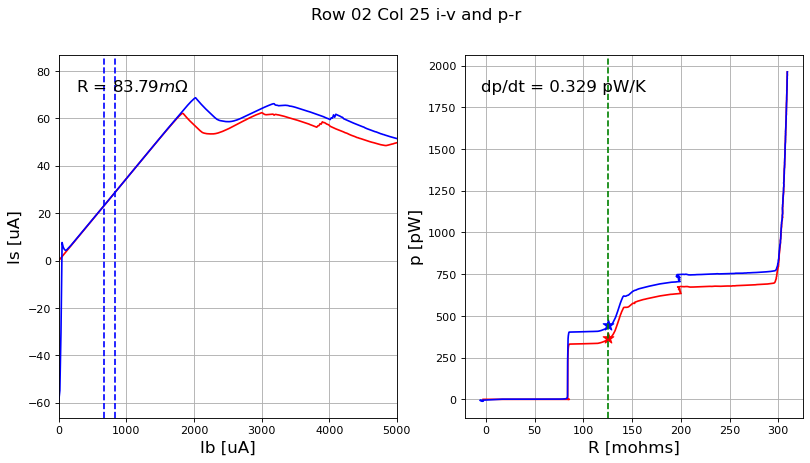

0.32899377027453097 0.08378677207264794
row 2, col 26


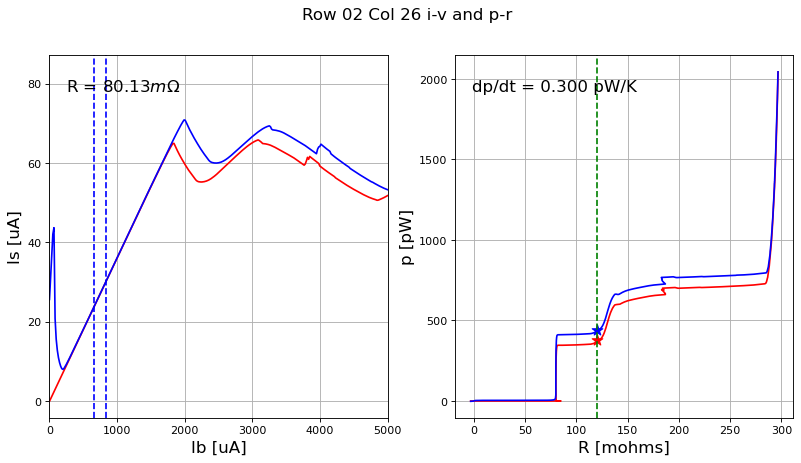

0.3000243071564475 0.08013278109891234
row 2, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


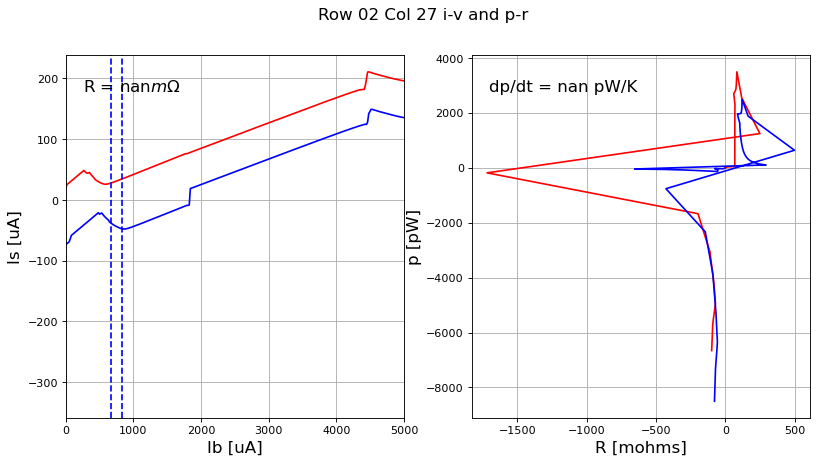

nan nan
row 2, col 28


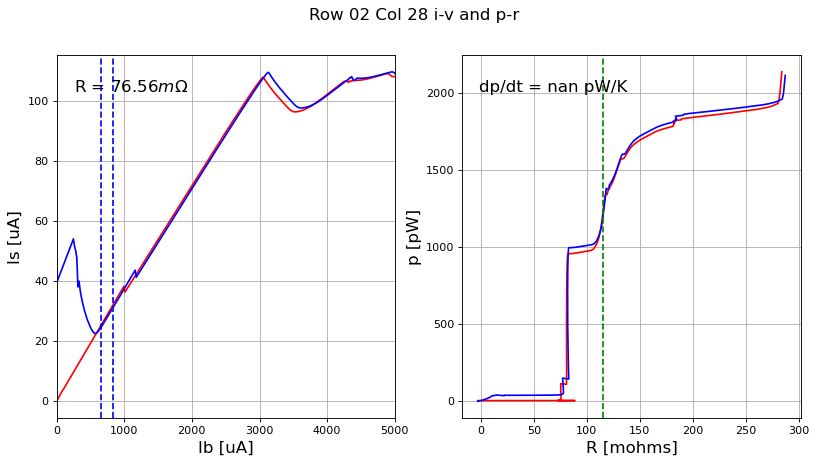

nan 0.07655740132919053
row 2, col 29


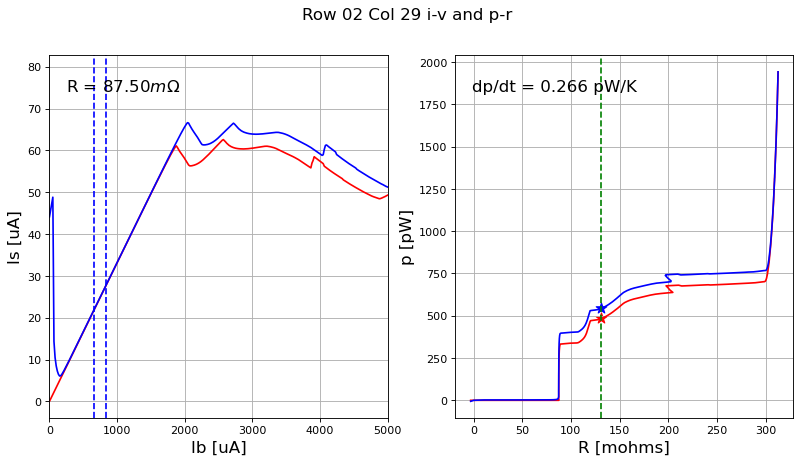

0.26587273806194184 0.08749826596336994
row 2, col 30


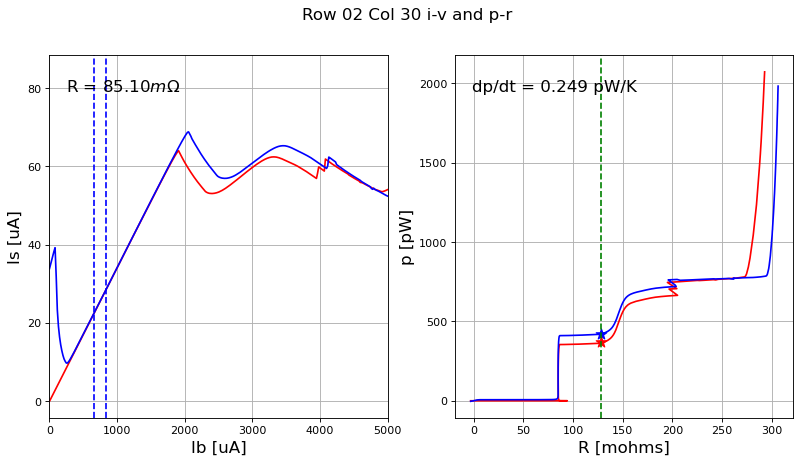

0.24920328471360031 0.08509709500802881
row 2, col 31


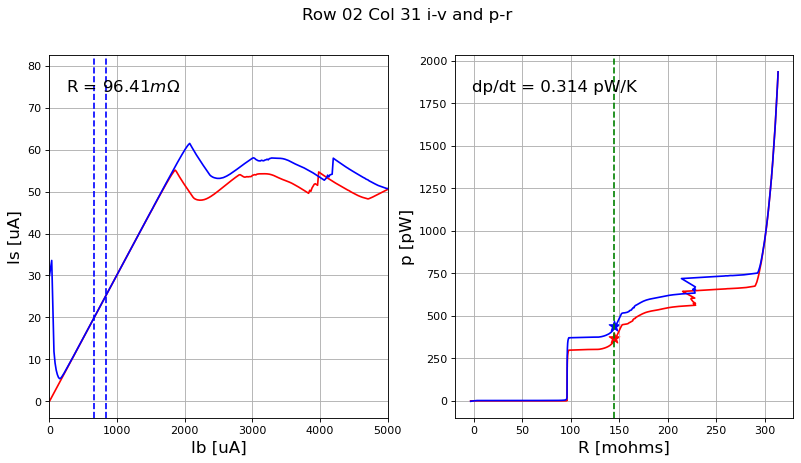

0.31381706517663654 0.09641495861681446
row 3, col 16


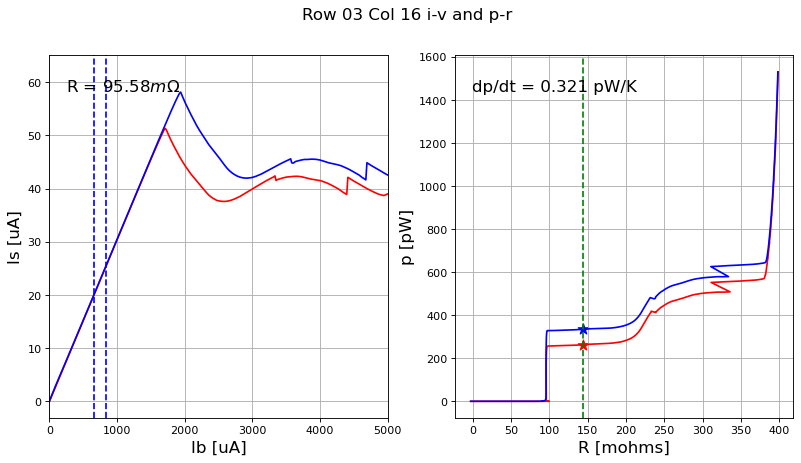

0.3206062218561308 0.09557910493520758
row 3, col 17


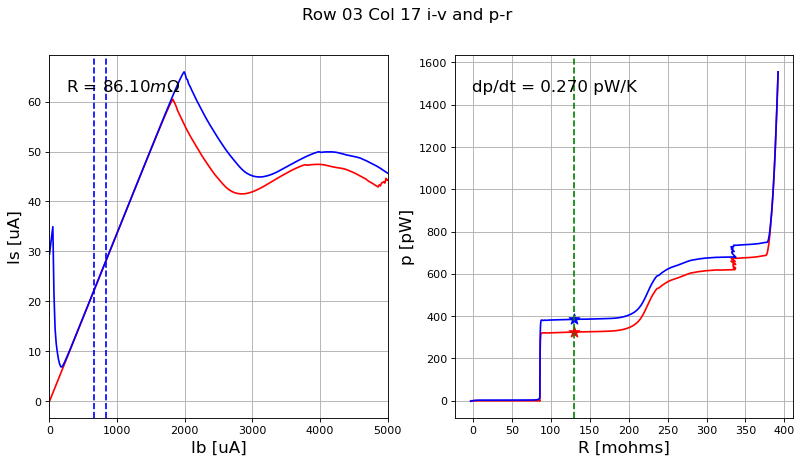

0.2703577294996739 0.0860959421522718
row 3, col 18


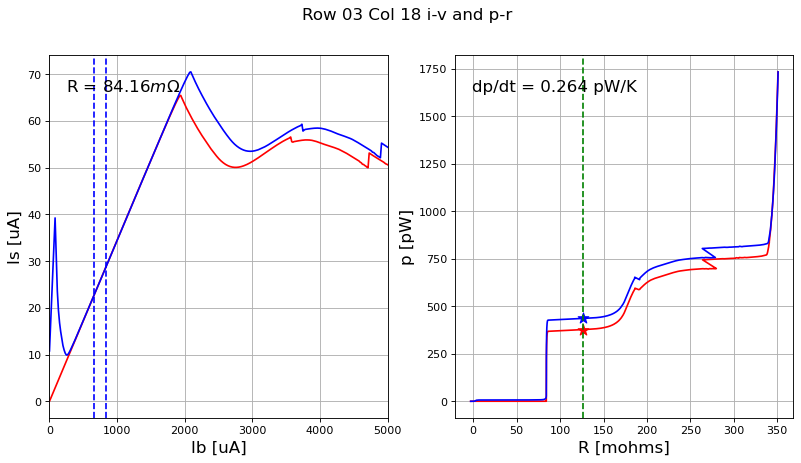

0.2638887503626648 0.08416001494082911
row 3, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


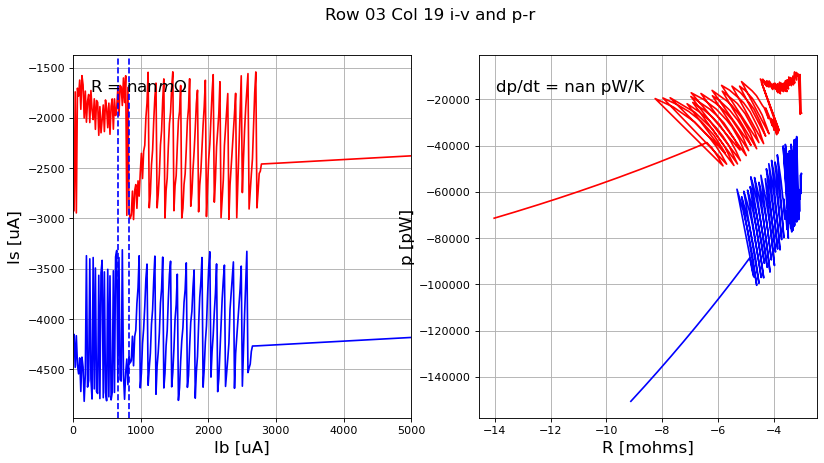

nan nan
row 3, col 20
#####################
20 3


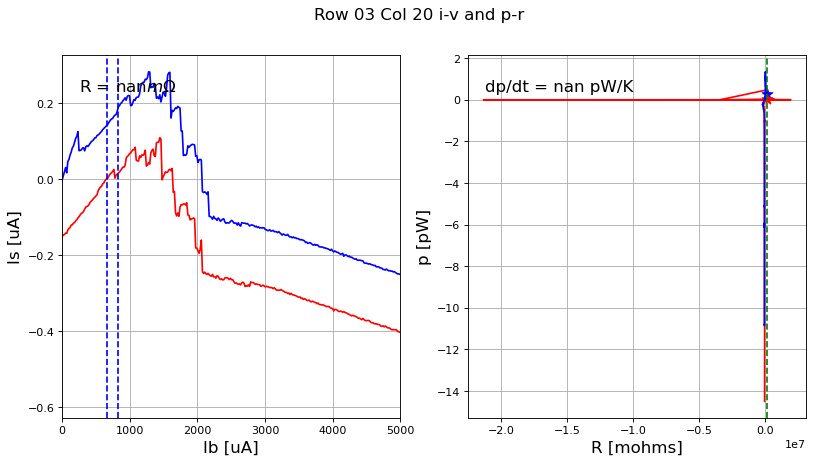

nan nan
row 3, col 21


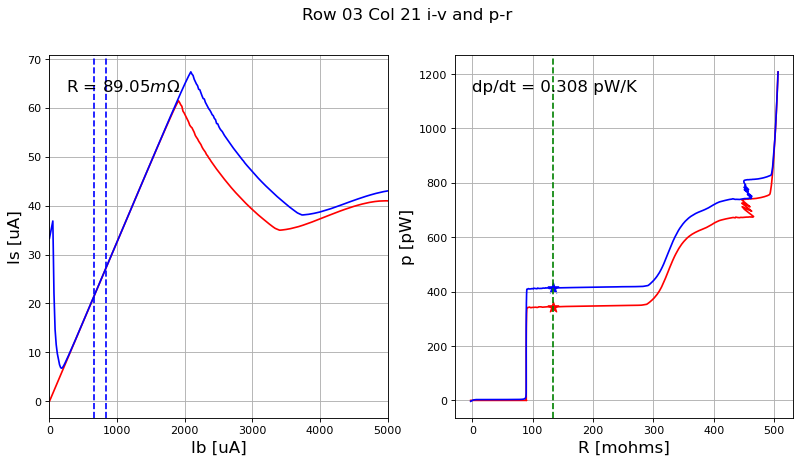

0.3082940452389857 0.08904948543723569
row 3, col 22


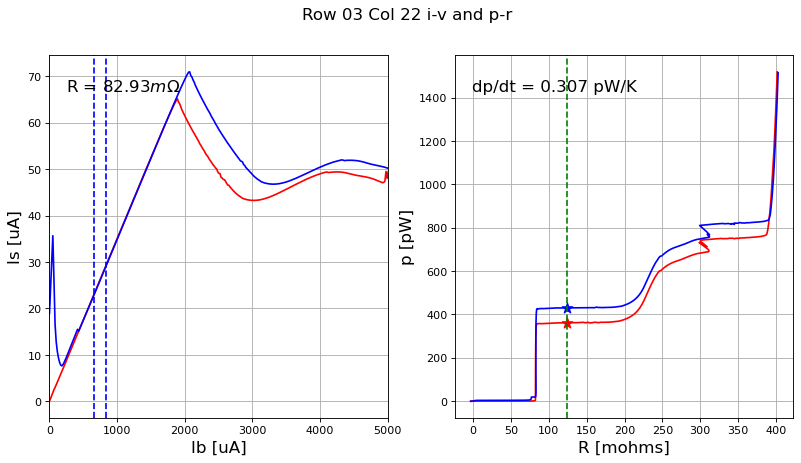

0.3072412673467949 0.08292904524582814
row 3, col 23


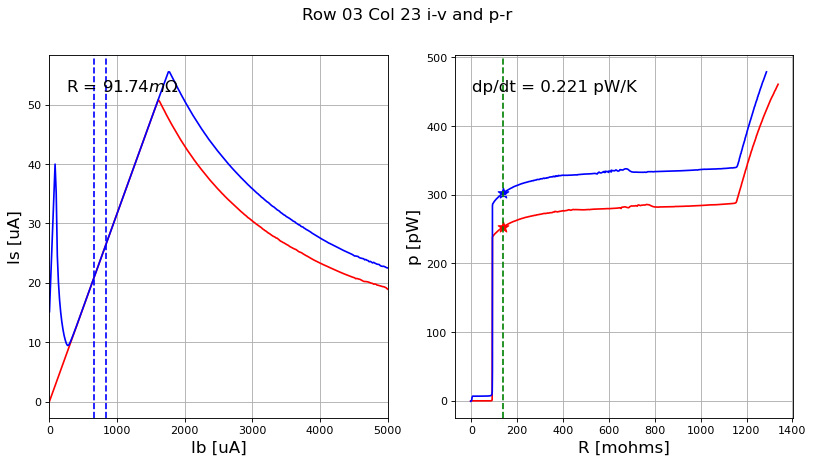

0.22085120304260217 0.09173967171468153
row 3, col 24


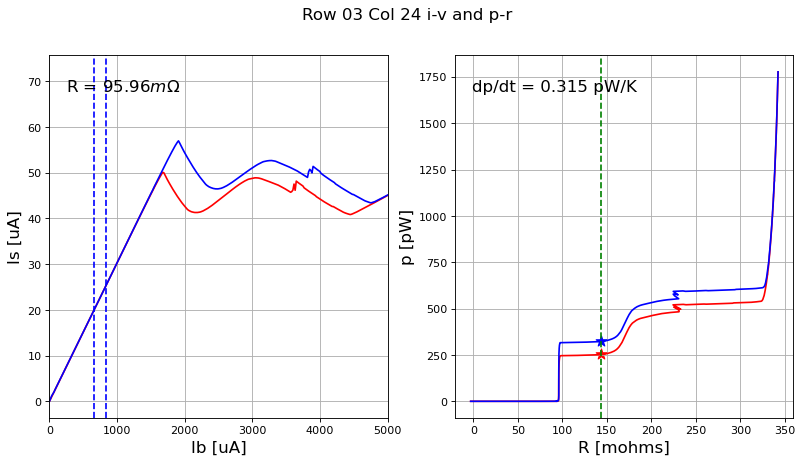

0.3149598715622726 0.09595898396391128
row 3, col 25


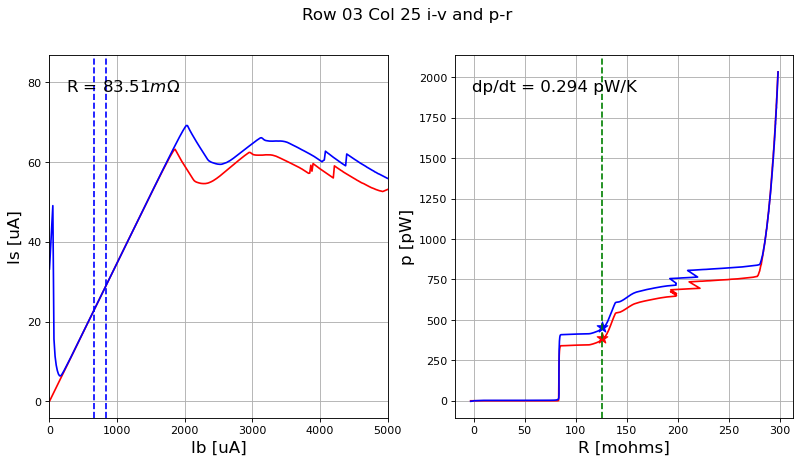

0.2940228400998382 0.08351414956374312
row 3, col 26


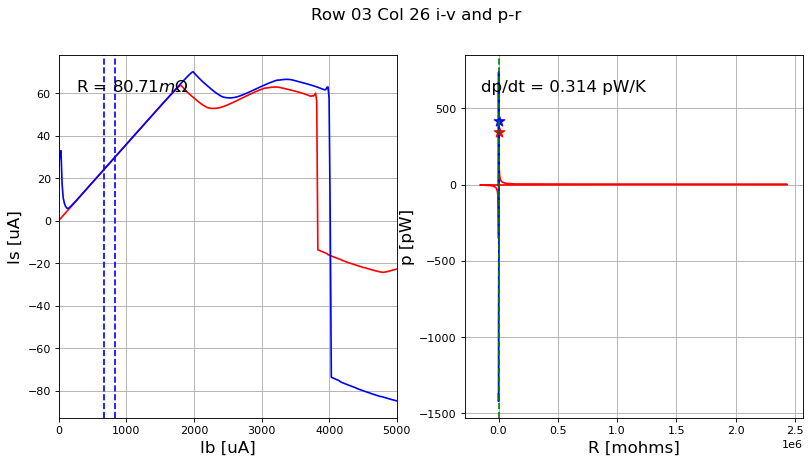

0.31378742357676853 0.0807078419216242
row 3, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


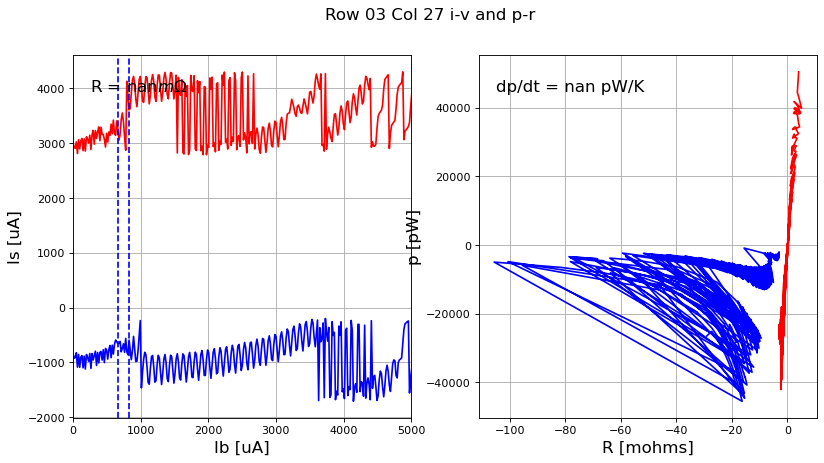

nan nan
row 3, col 28


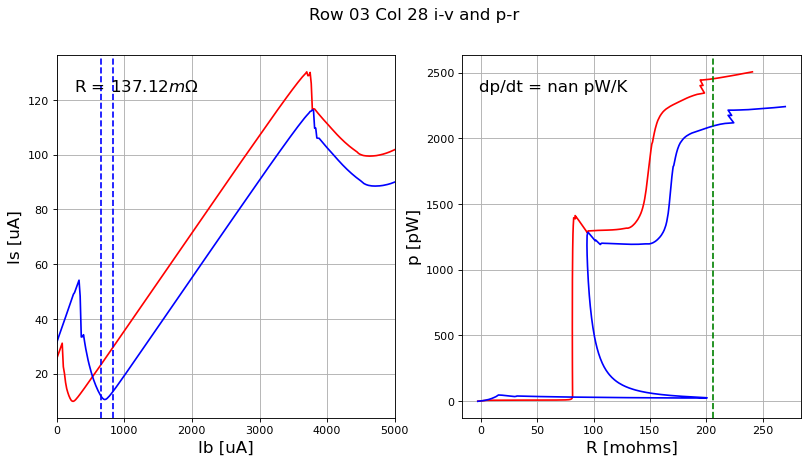

nan 0.13711596377263346
row 3, col 29


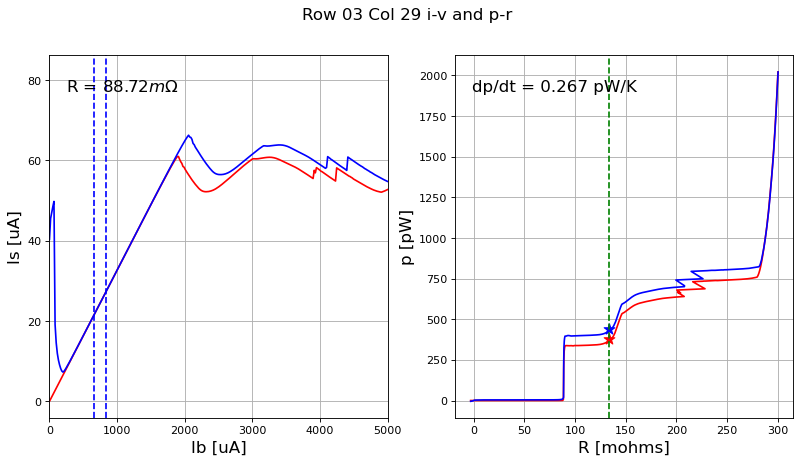

0.26701814775810667 0.08871738271505035
row 3, col 30


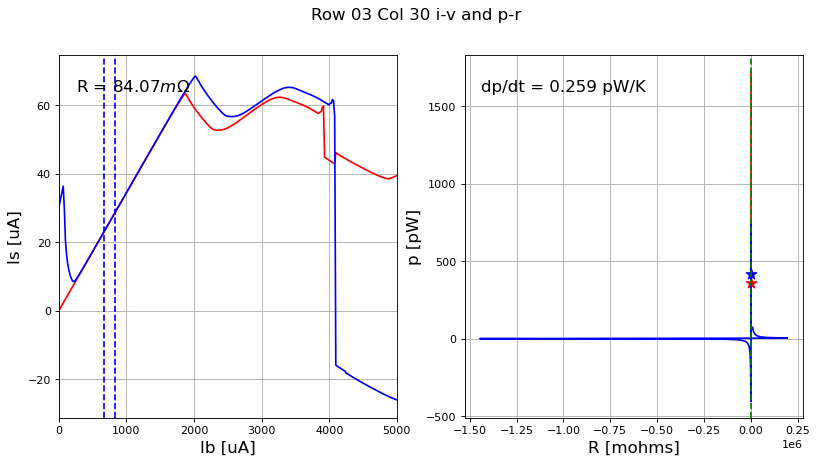

0.25924180935366853 0.0840669576787734
row 3, col 31


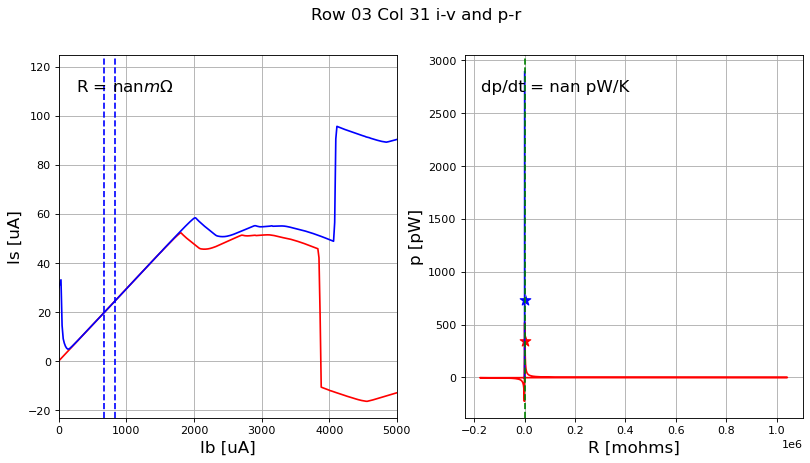

nan nan
row 4, col 16


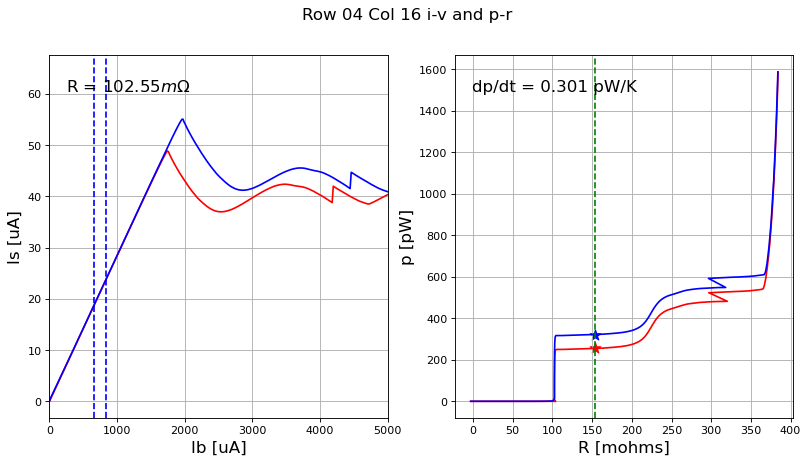

0.3010626356576181 0.10255189059914196
row 4, col 17


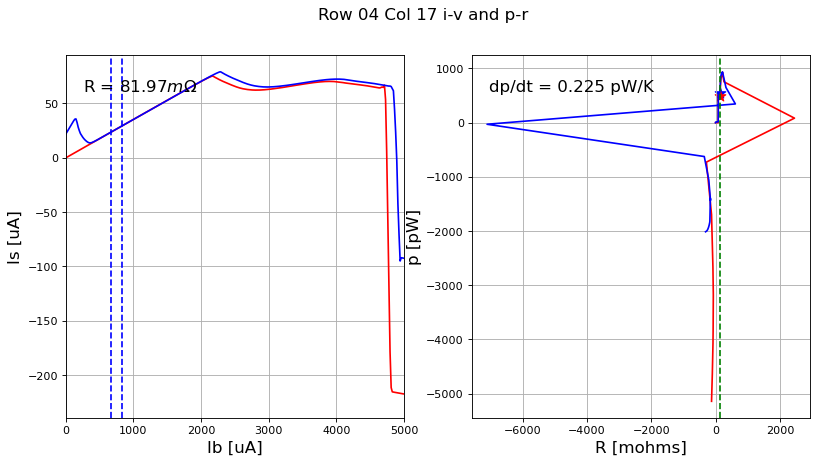

0.22486861702254748 0.08197429575632653
row 4, col 18


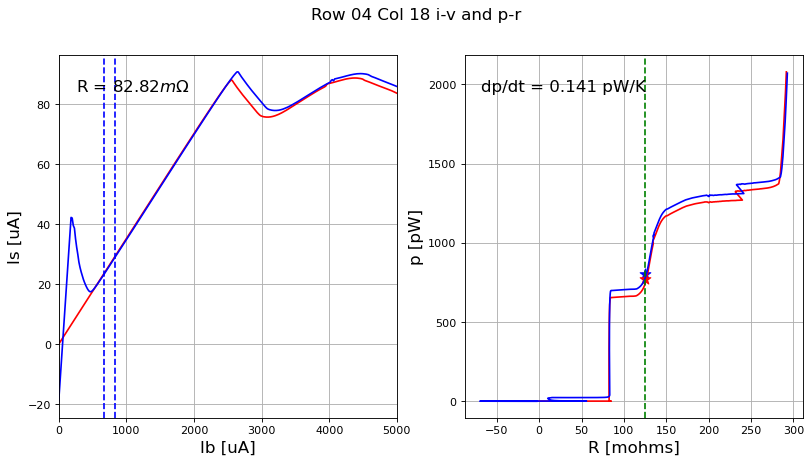

0.14069140310068248 0.08282471225233087
row 4, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


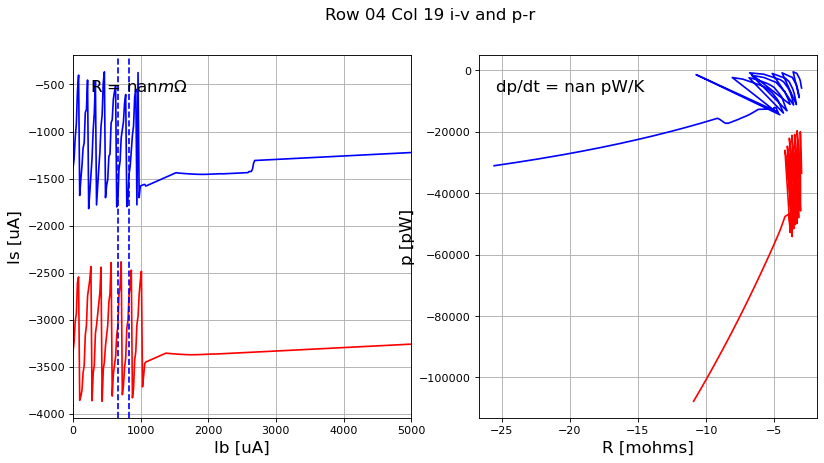

nan nan
row 4, col 20


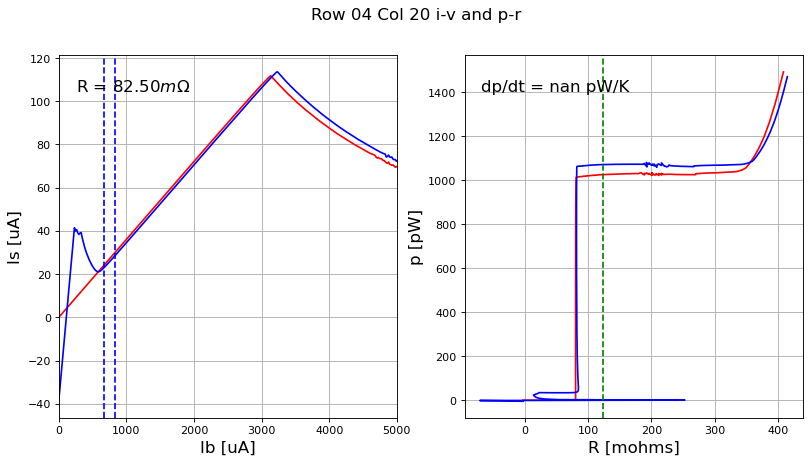

nan 0.08250040237407821
row 4, col 21


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


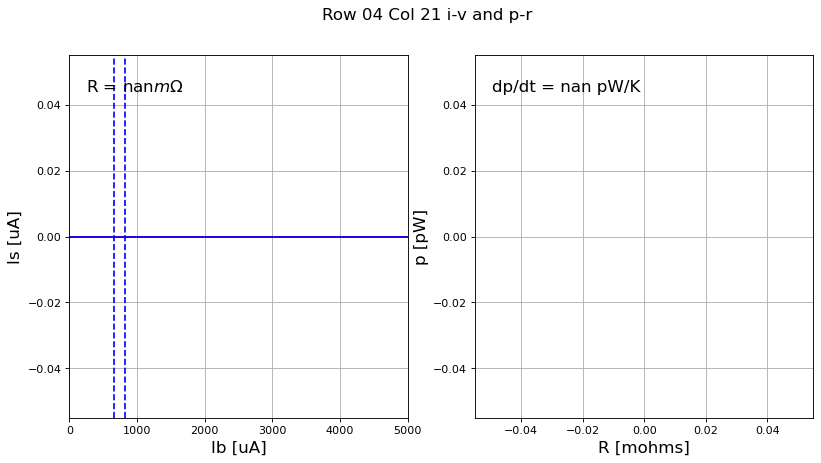

nan nan
row 4, col 22


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


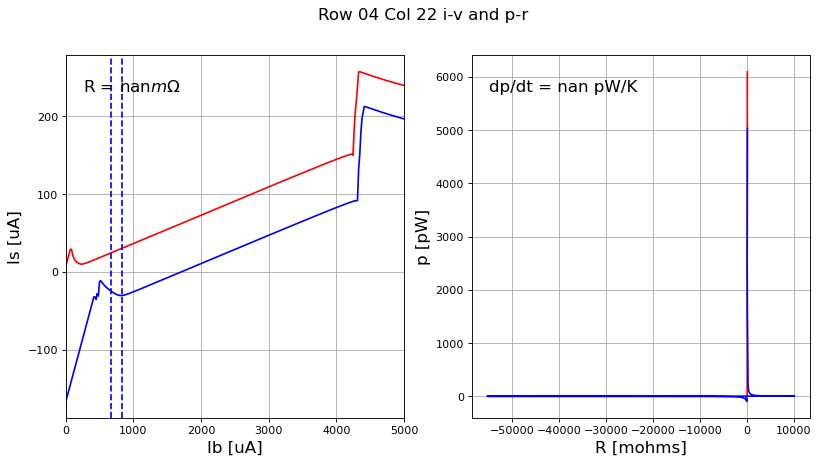

nan nan
row 4, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


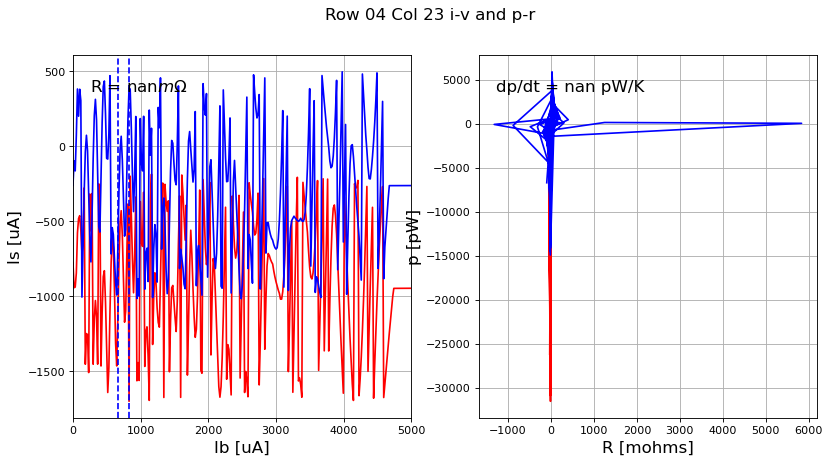

nan nan
row 4, col 24


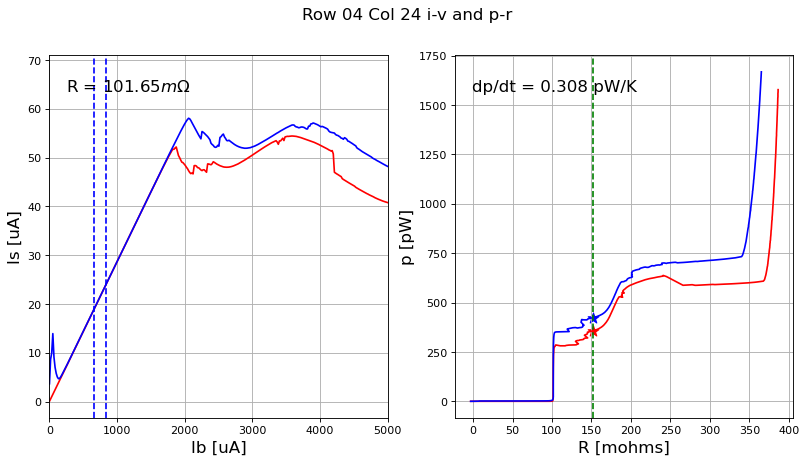

0.30838886761761536 0.10165003865740407
row 4, col 25


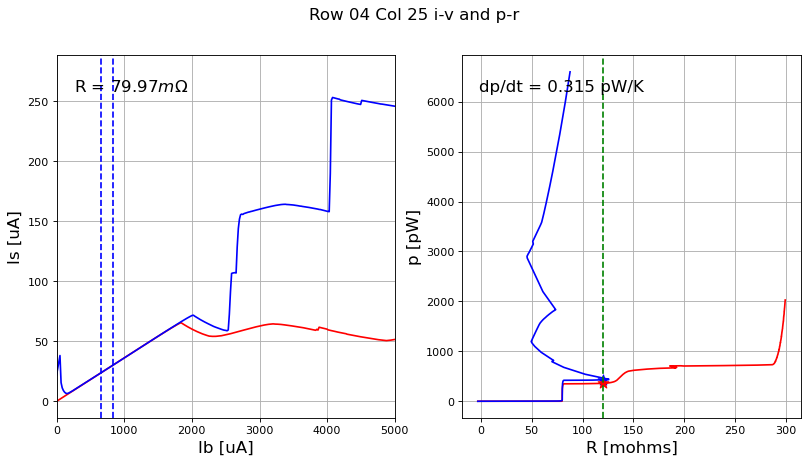

0.31471916491537316 0.07997421104733775
row 4, col 26


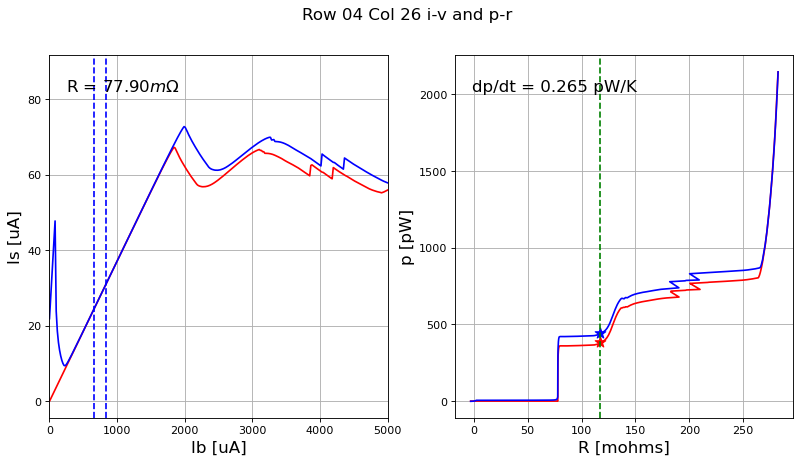

0.264722462655846 0.07790255952510522
row 4, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


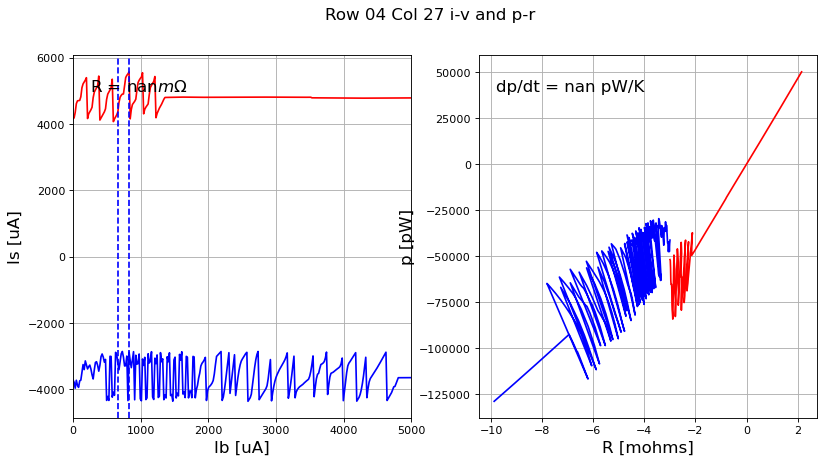

nan nan
row 4, col 28


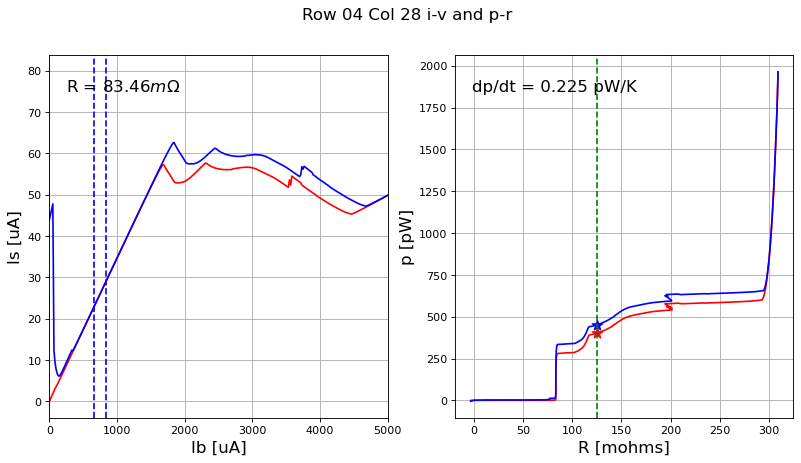

0.2253240503231088 0.08346097879964516
row 4, col 29


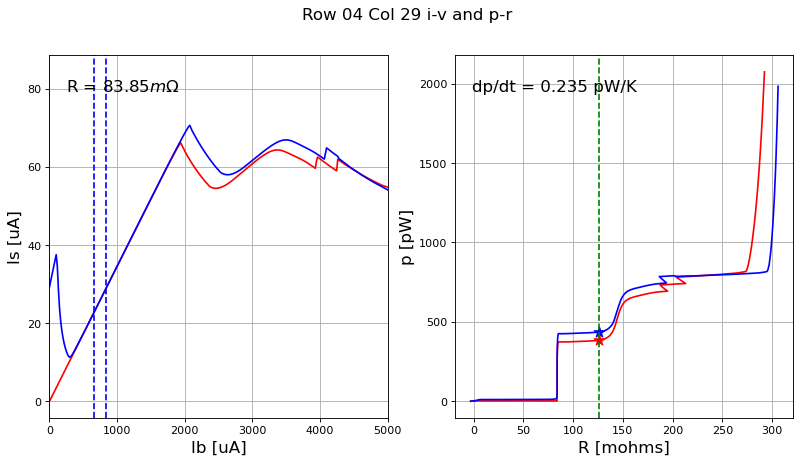

0.23539844016656325 0.08384636524205627
row 4, col 30


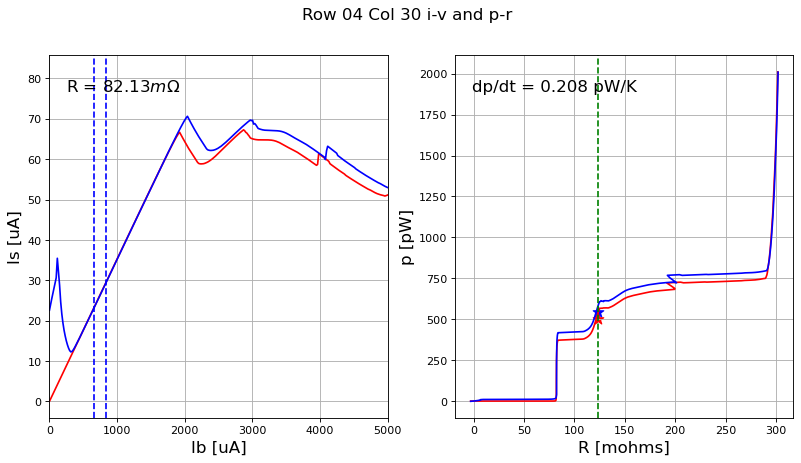

0.2080943545038679 0.08212771483148909
row 4, col 31


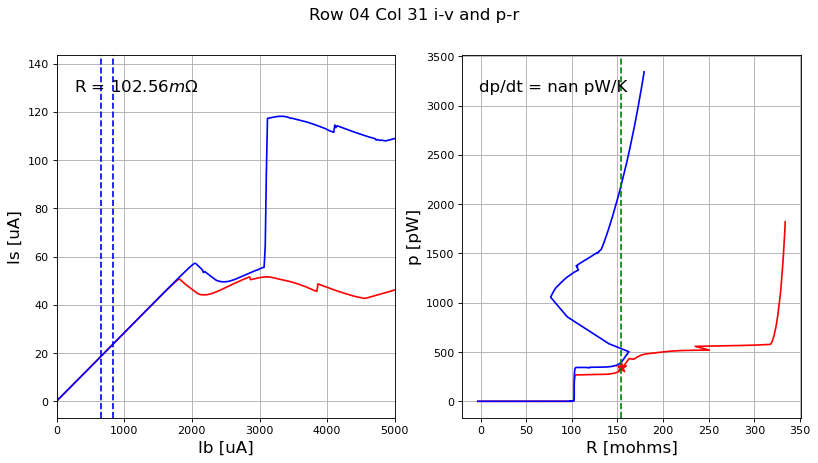

nan 0.10255607076333478
row 5, col 16


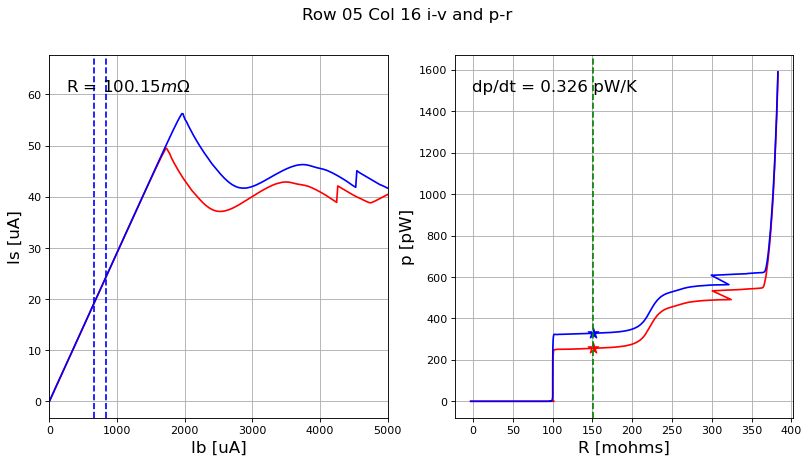

0.3259318077469965 0.10014529131950334
row 5, col 17


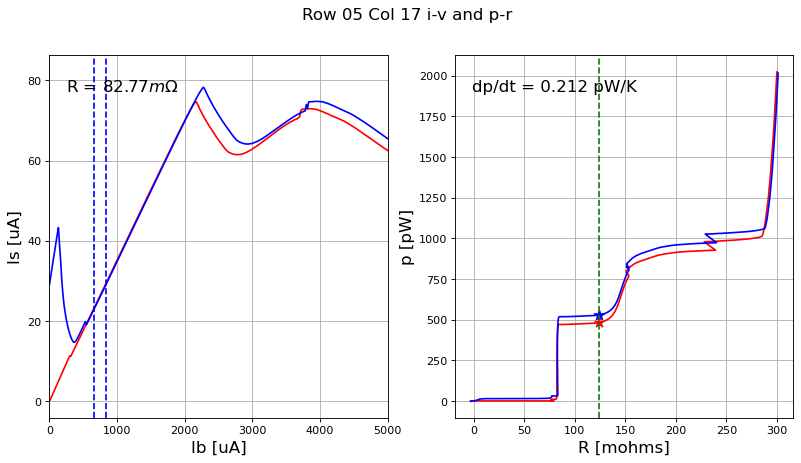

0.21154629654464635 0.08277300069870785
row 5, col 18


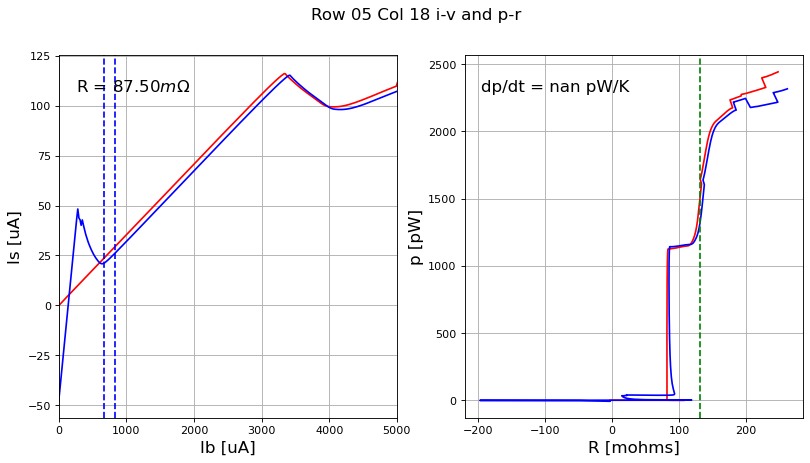

nan 0.08750087282372124
row 5, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


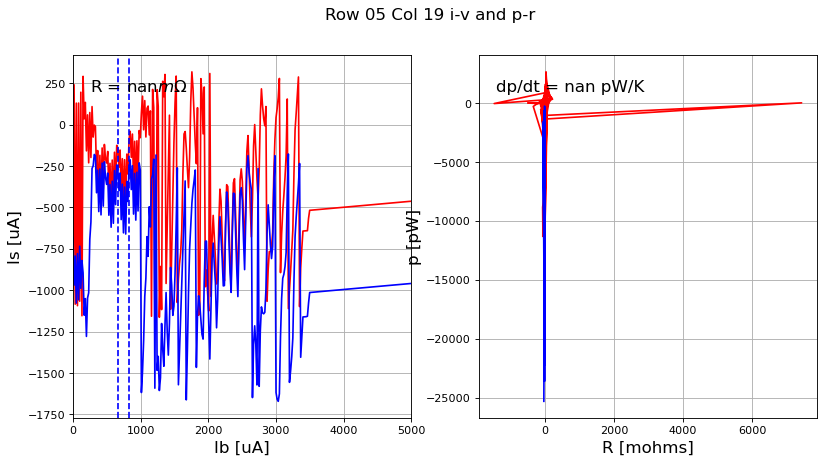

nan nan
row 5, col 20


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


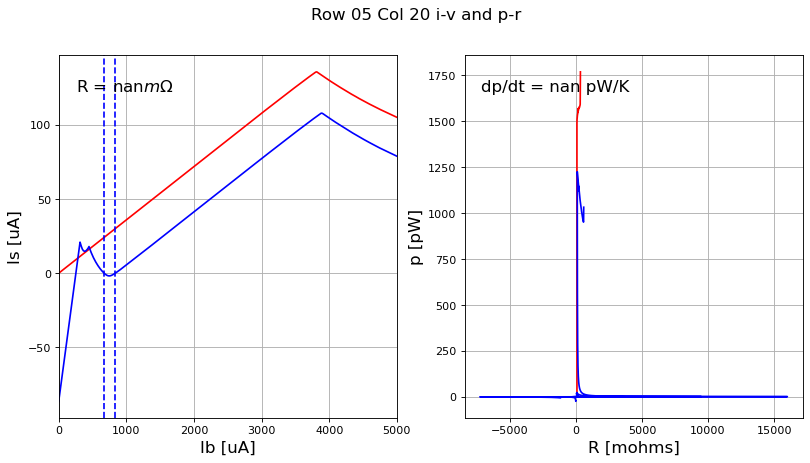

nan nan
row 5, col 21


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


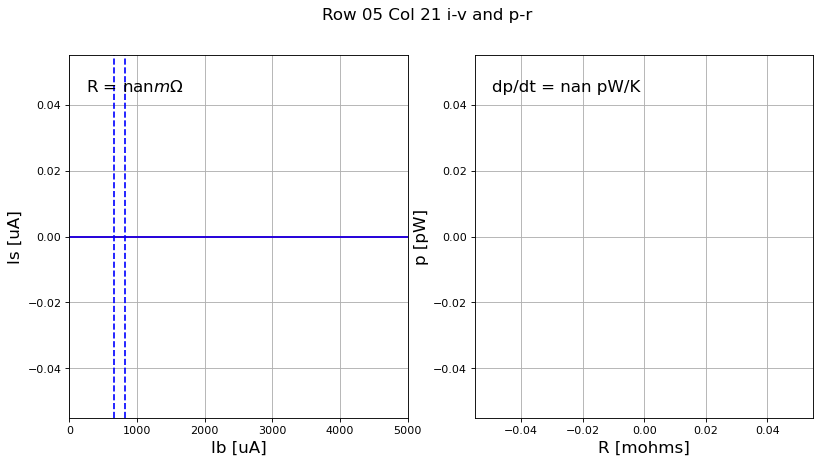

nan nan
row 5, col 22


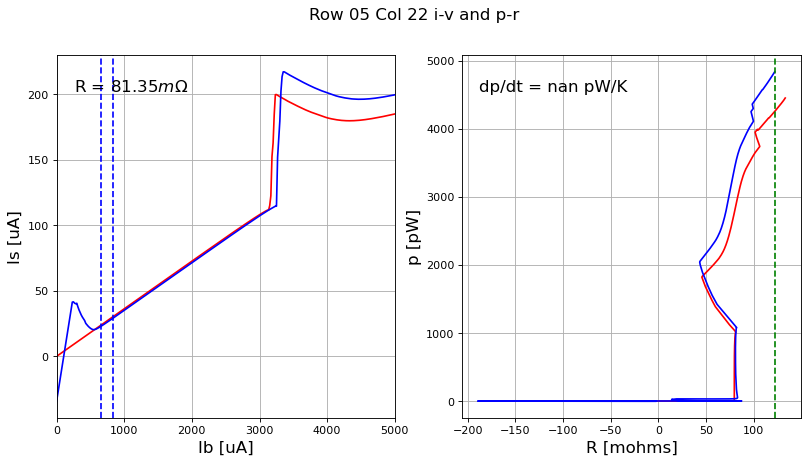

nan 0.08134867264838827
row 5, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


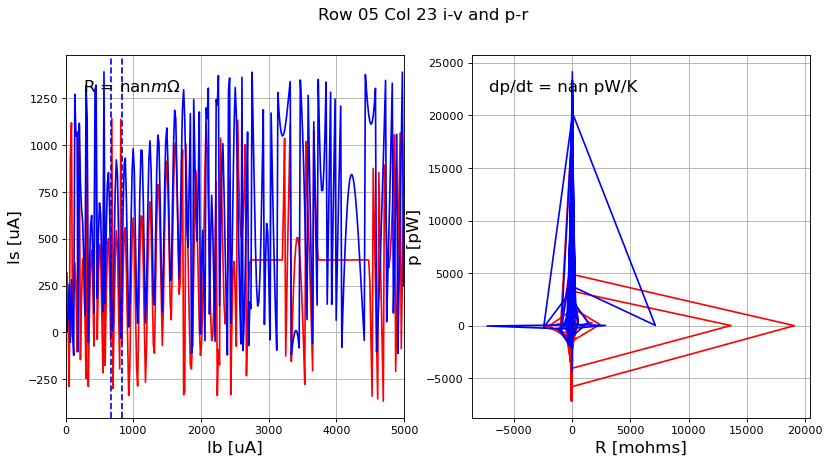

nan nan
row 5, col 24


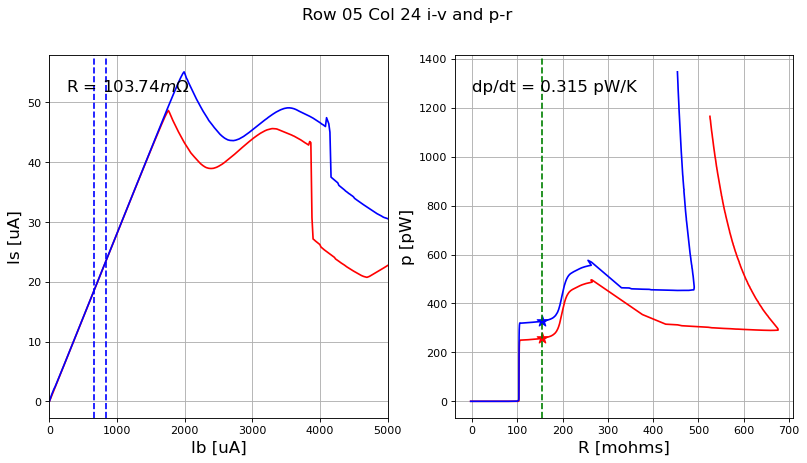

0.3151877399658825 0.10373896431636999
row 5, col 25


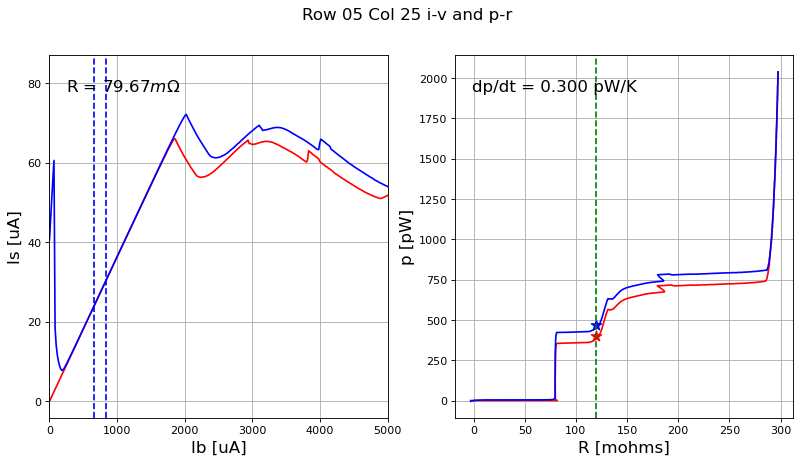

0.29981582255265044 0.07966666971513402
row 5, col 26


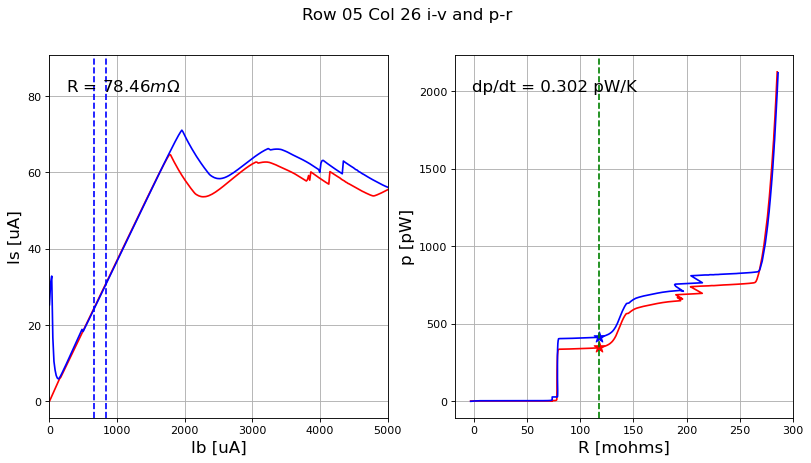

0.30182328320957214 0.0784584785897599
row 5, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


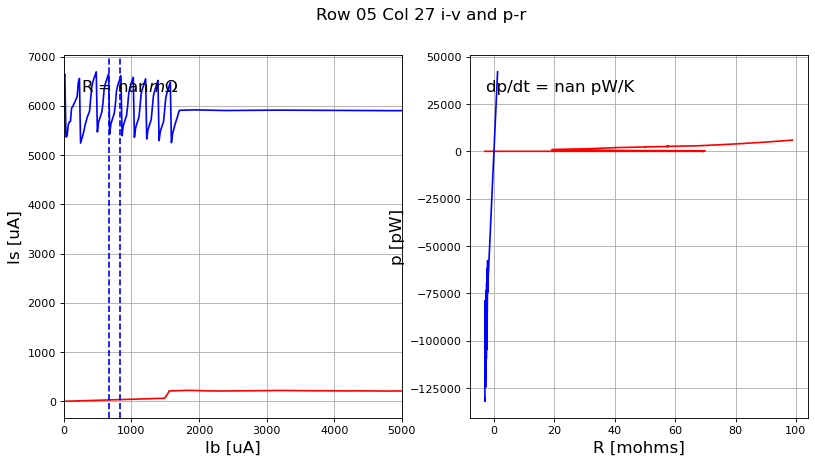

nan nan
row 5, col 28


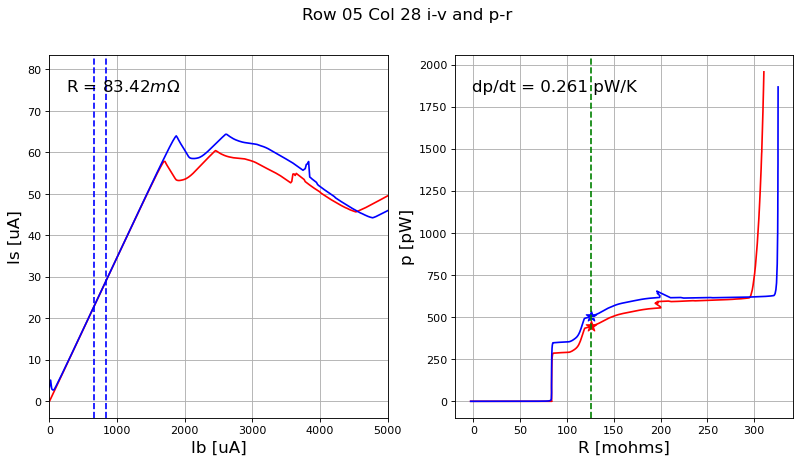

0.260920525536608 0.08342251164638322
row 5, col 29


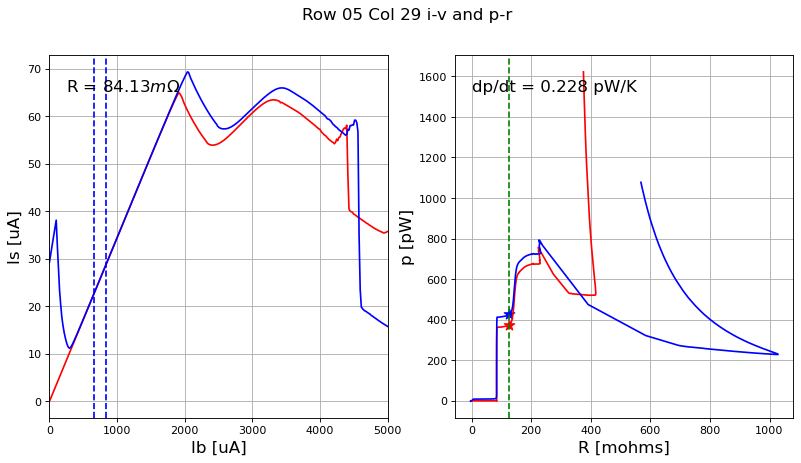

0.22805178493958644 0.08413230034790072
row 5, col 30


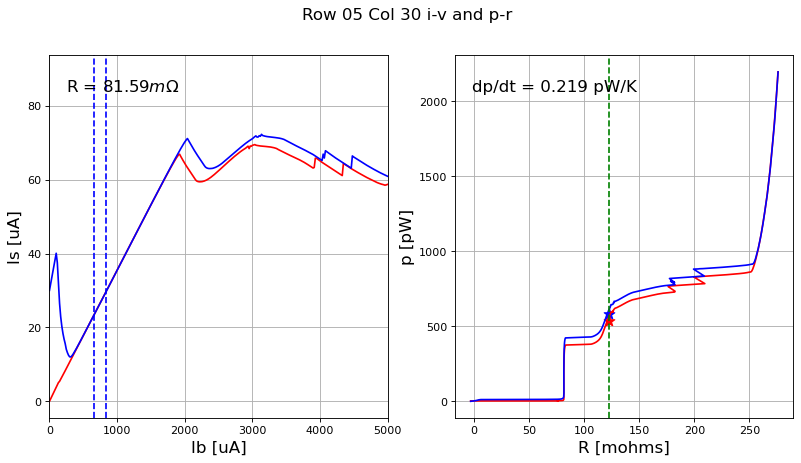

0.21907671761701758 0.08159304155963741
row 5, col 31


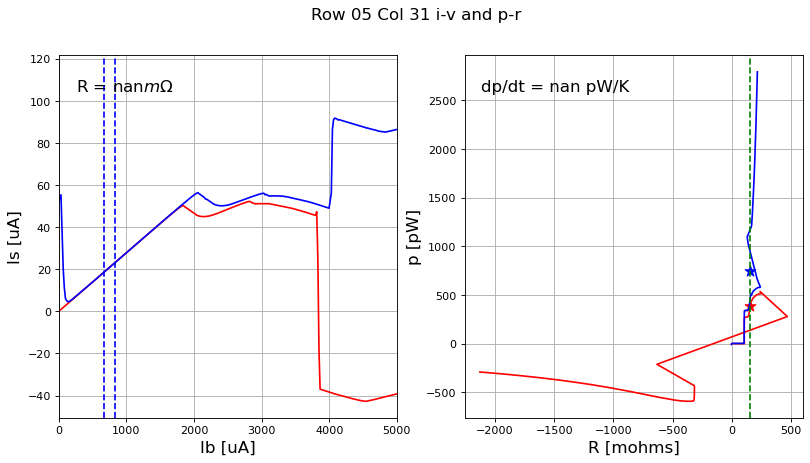

nan nan
row 6, col 16


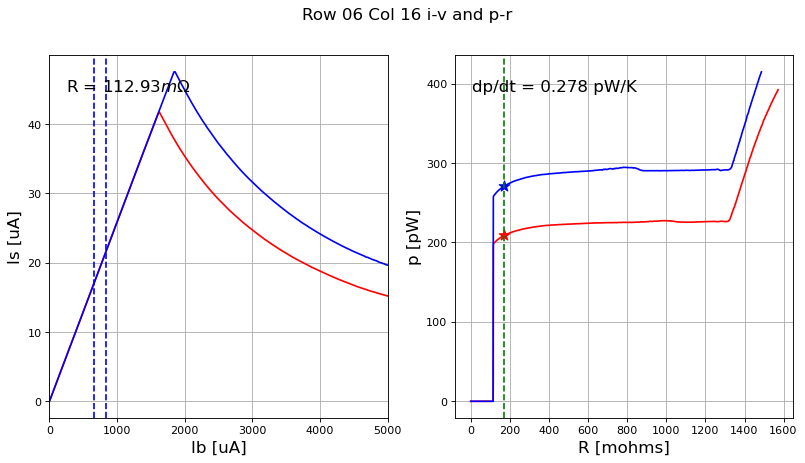

0.27837102566271366 0.11292943983098873
row 6, col 17


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


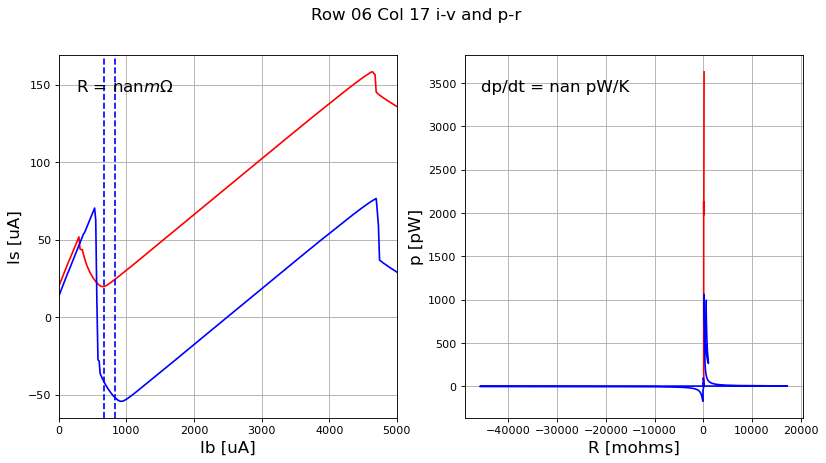

nan nan
row 6, col 18


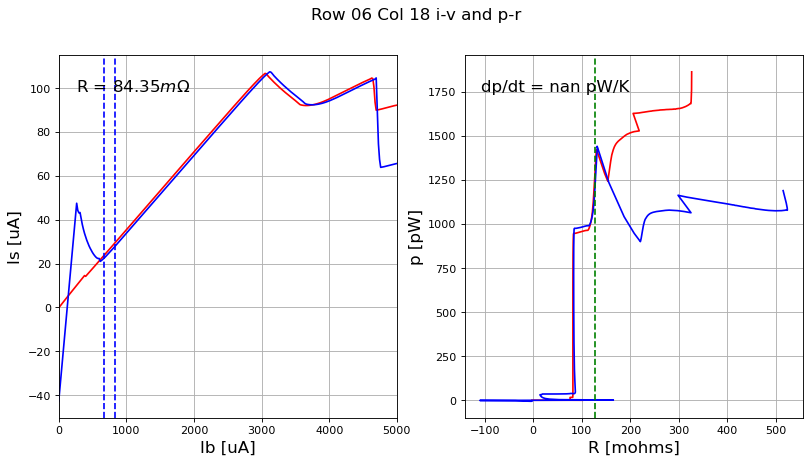

nan 0.08435198880502759
row 6, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


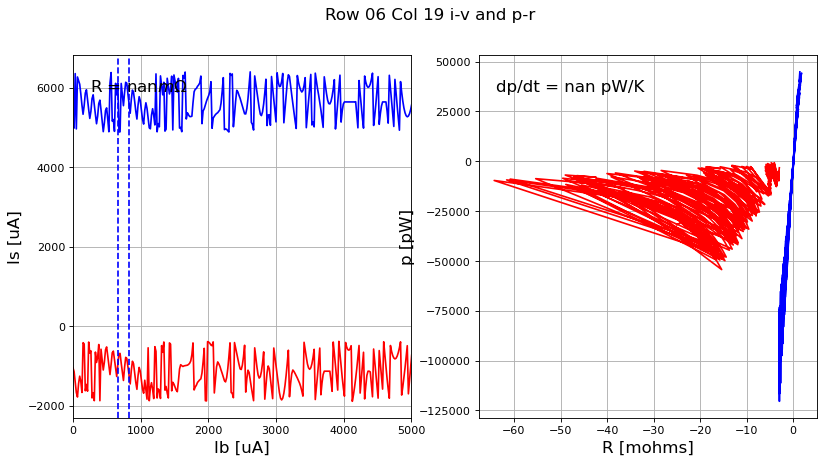

nan nan
row 6, col 20


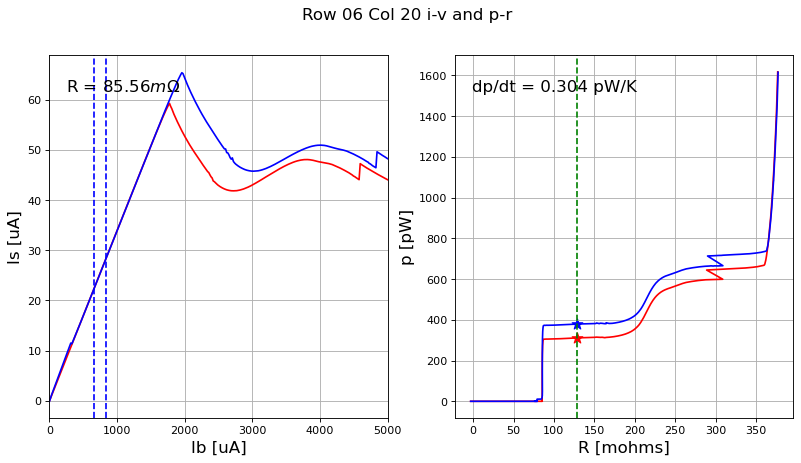

0.3042311065924917 0.08555800824463927
row 6, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


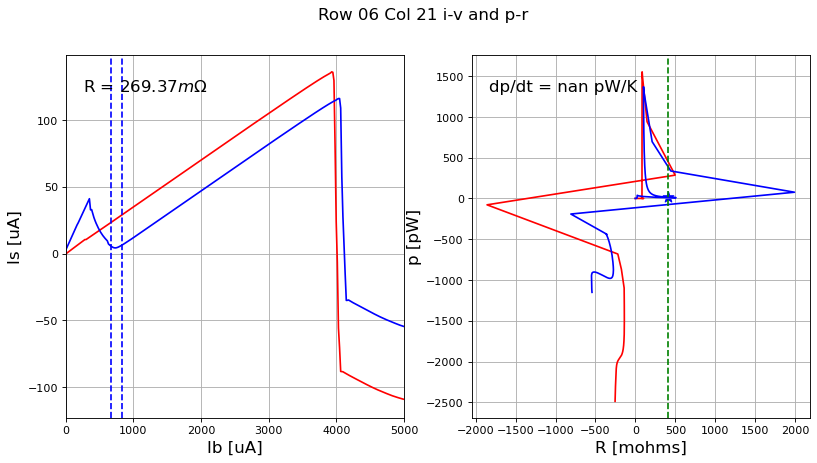

nan 0.26936803774854795
row 6, col 22


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


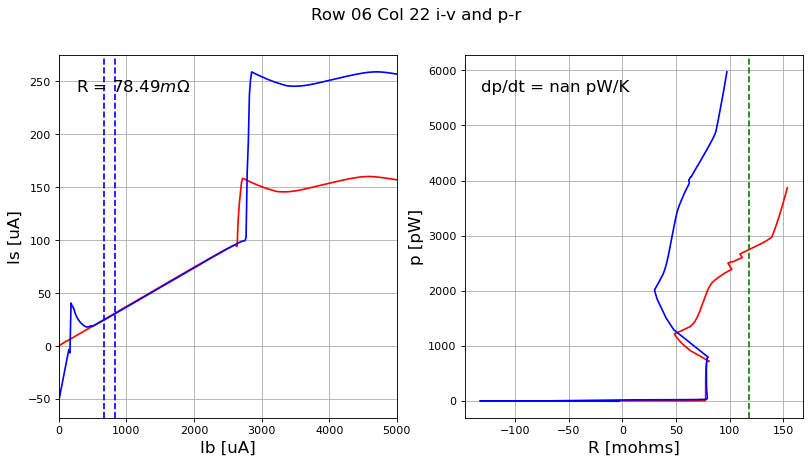

nan 0.07849085398378747
row 6, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


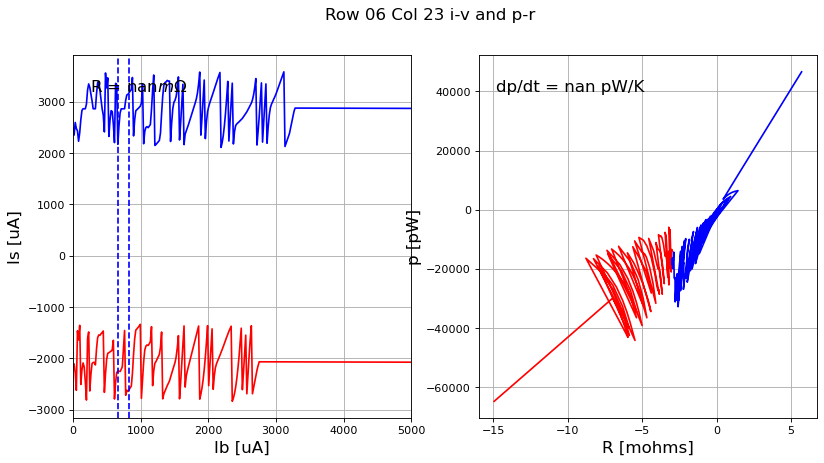

nan nan
row 6, col 24


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


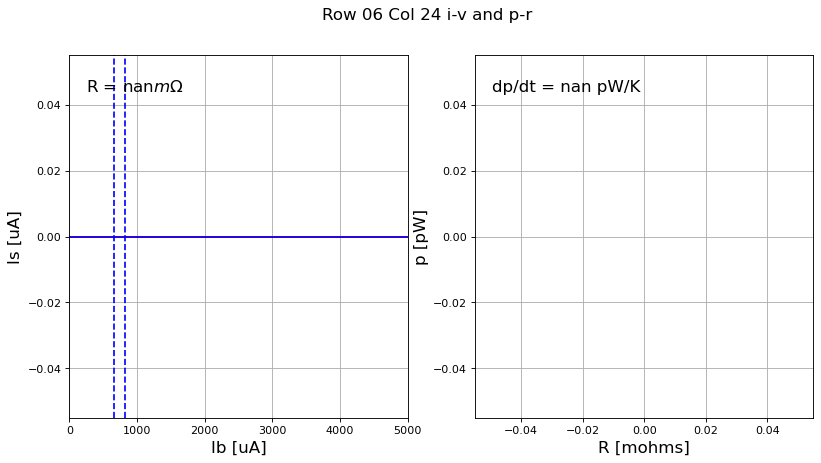

nan nan
row 6, col 25


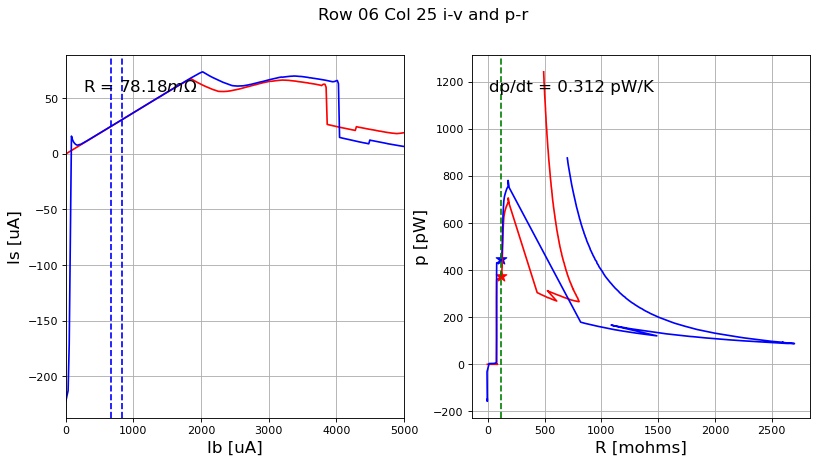

0.31209636344514285 0.07818449866937774
row 6, col 26


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


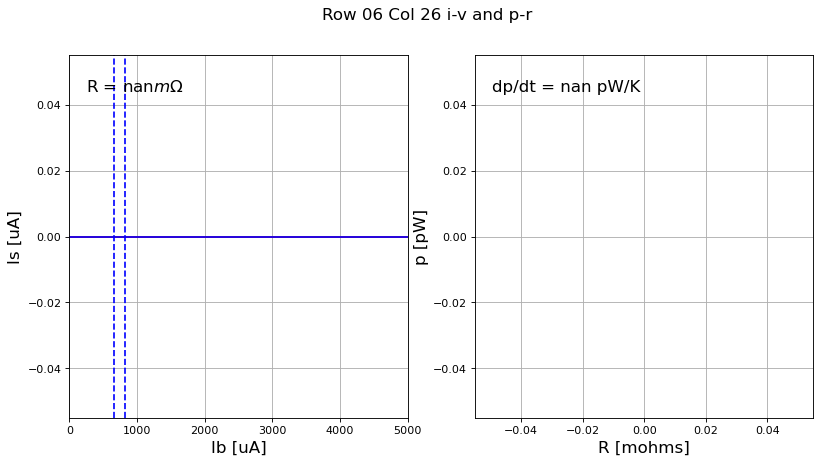

nan nan
row 6, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


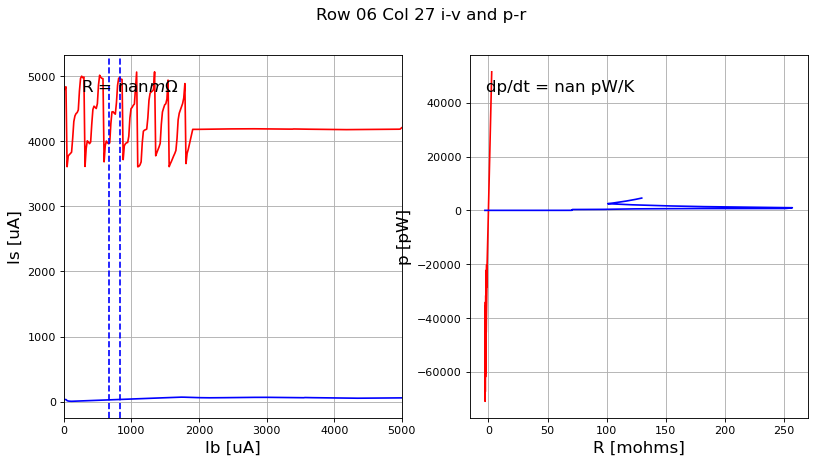

nan nan
row 6, col 28


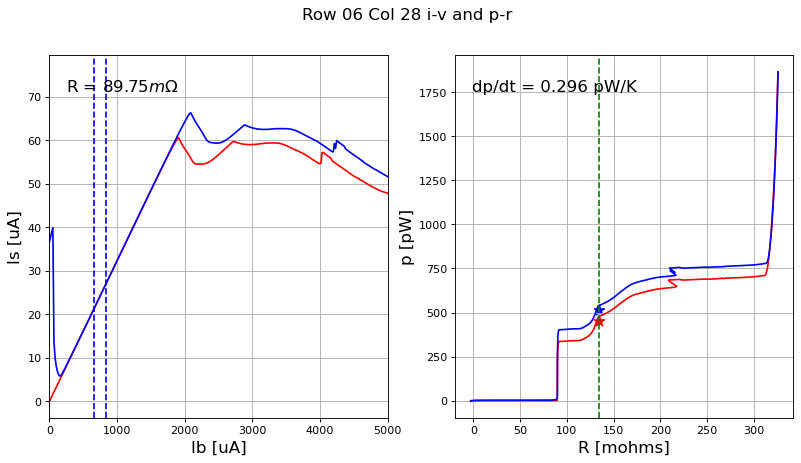

0.2964775599008189 0.08974815760058685
row 6, col 29


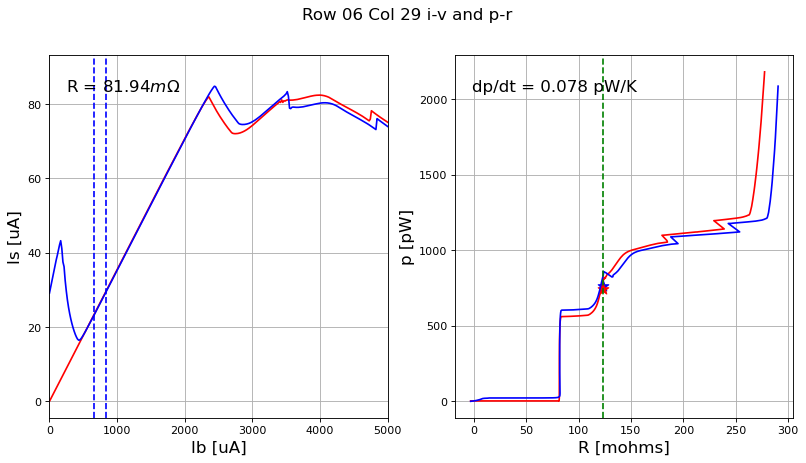

0.07781401010086332 0.08194494657616999
row 6, col 30


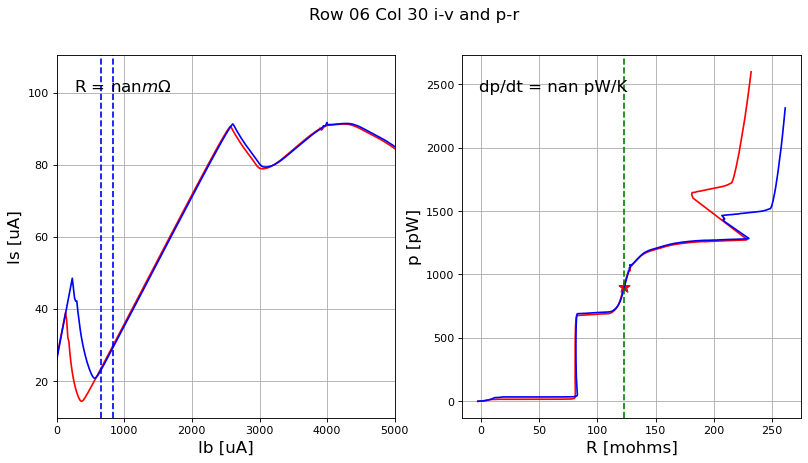

nan nan
row 6, col 31


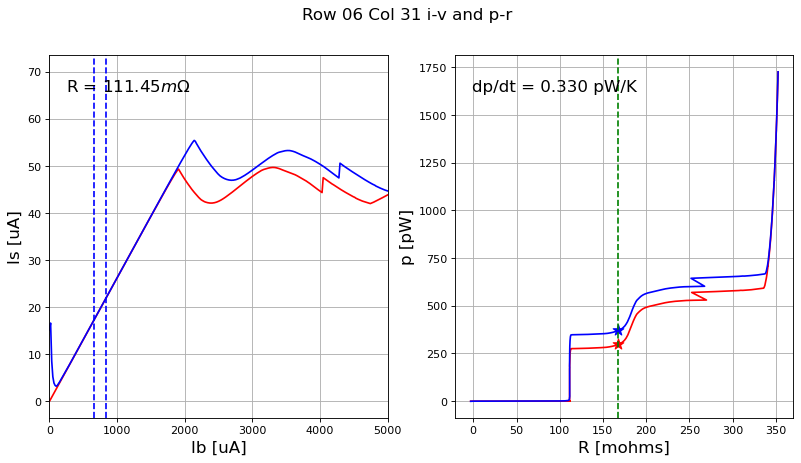

0.329999570054748 0.11145375961678194
row 7, col 16


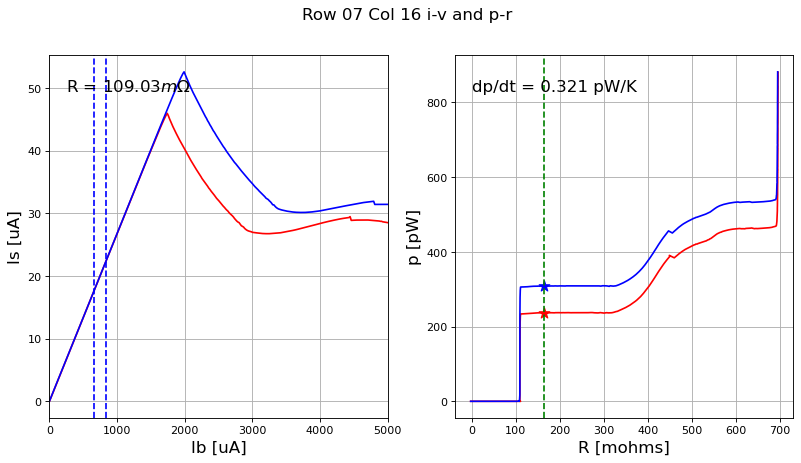

0.3211321995506986 0.10903128609496537
row 7, col 17


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


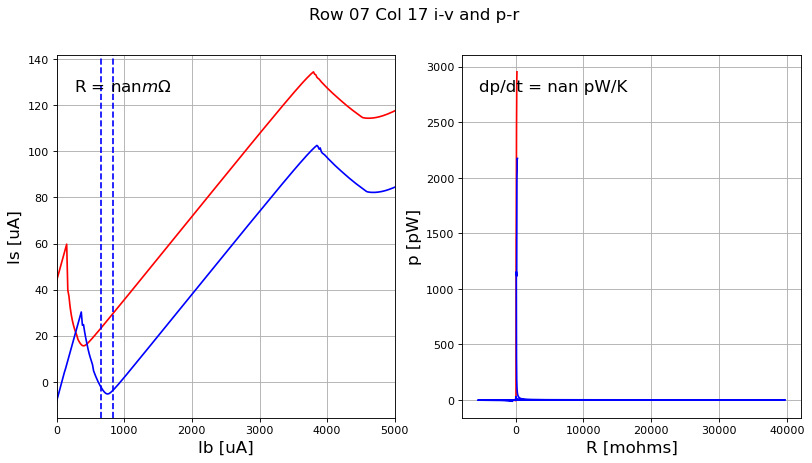

nan nan
row 7, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


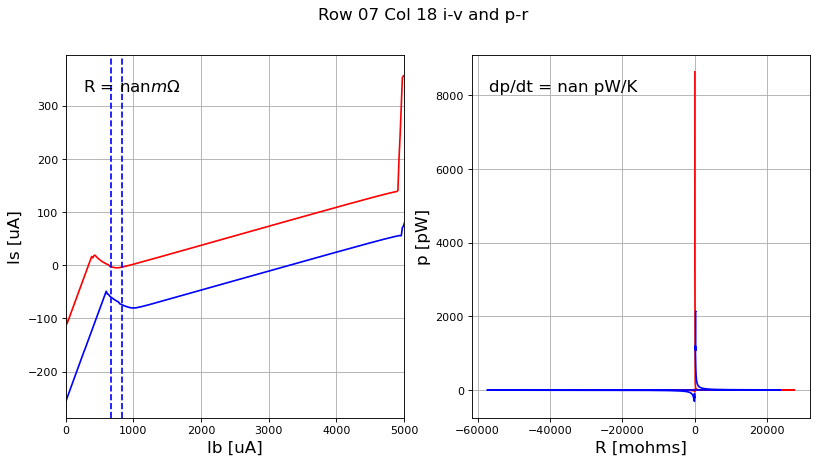

nan nan
row 7, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


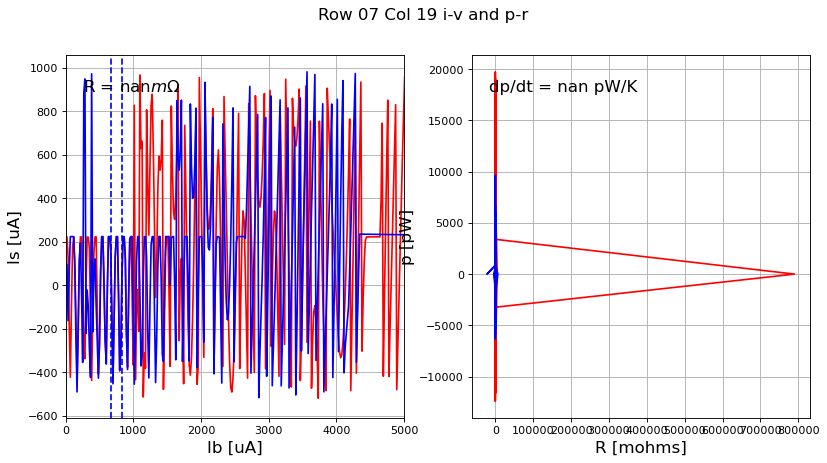

nan nan
row 7, col 20


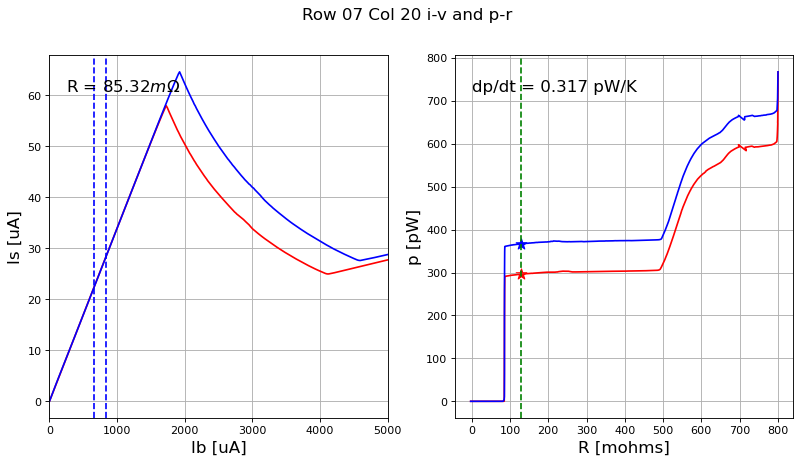

0.31682202374301777 0.08532375641195228
row 7, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


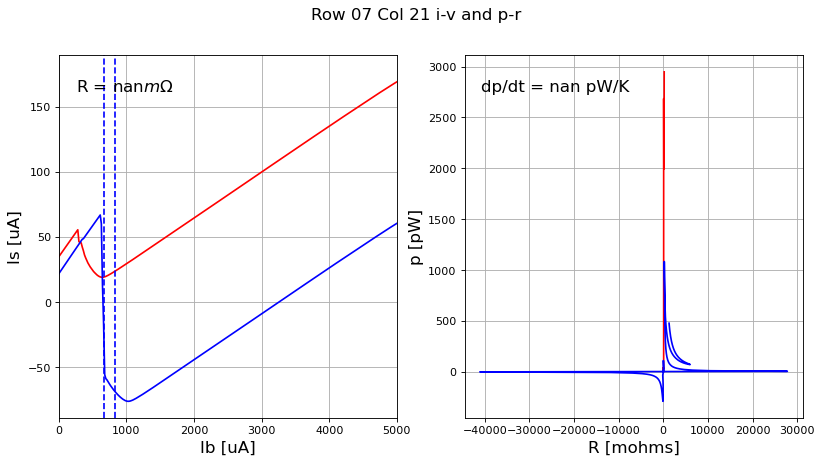

nan nan
row 7, col 22


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


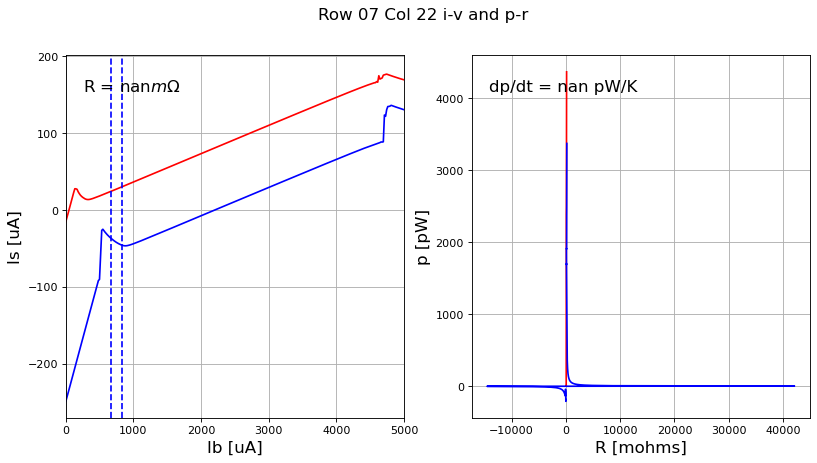

nan nan
row 7, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


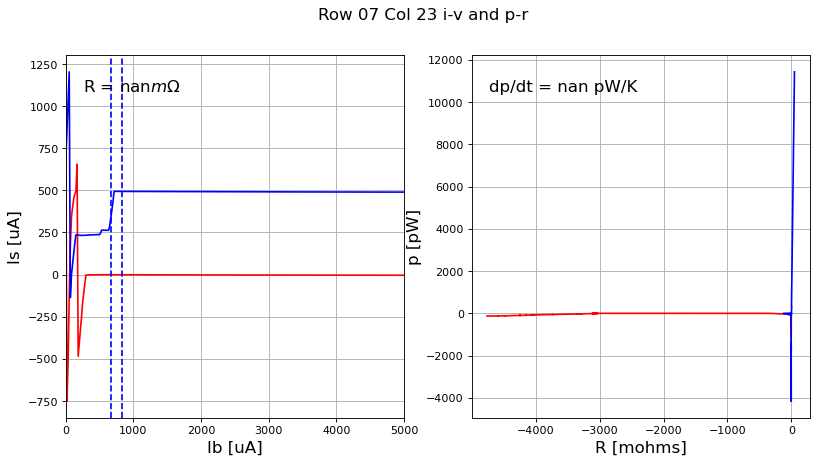

nan nan
row 7, col 24


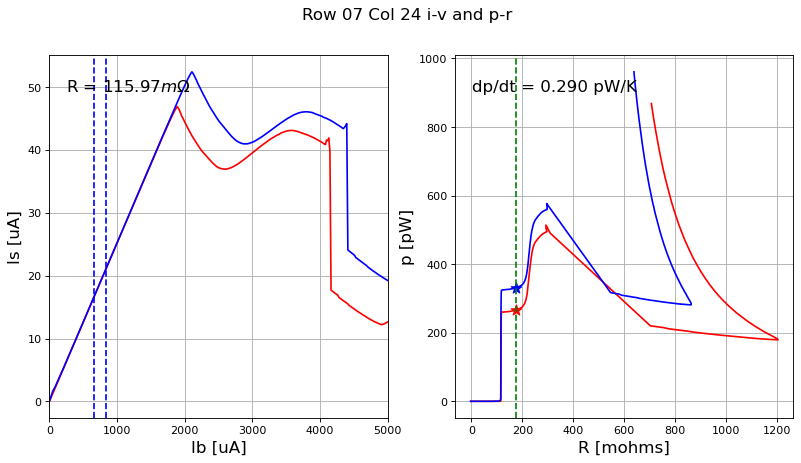

0.28982395489353135 0.11597469249811287
row 7, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


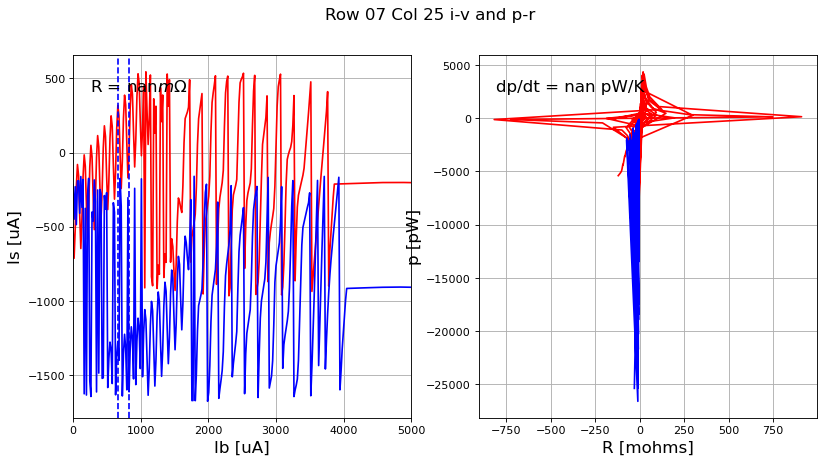

nan nan
row 7, col 26


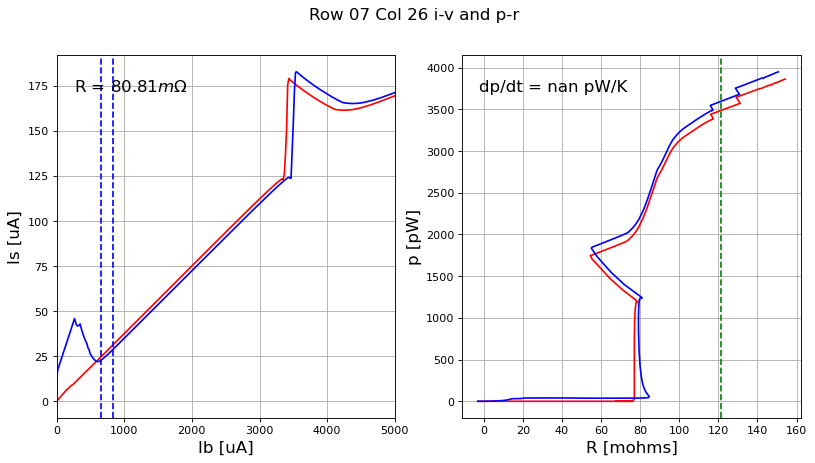

nan 0.0808118591321055
row 7, col 27


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


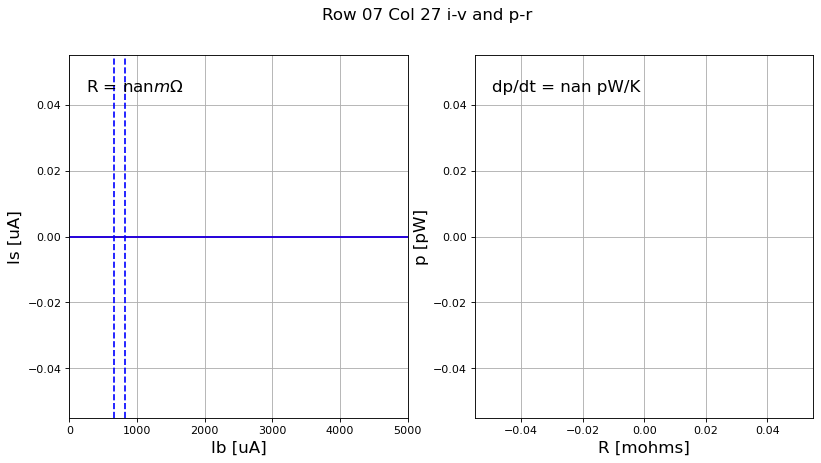

nan nan
row 7, col 28


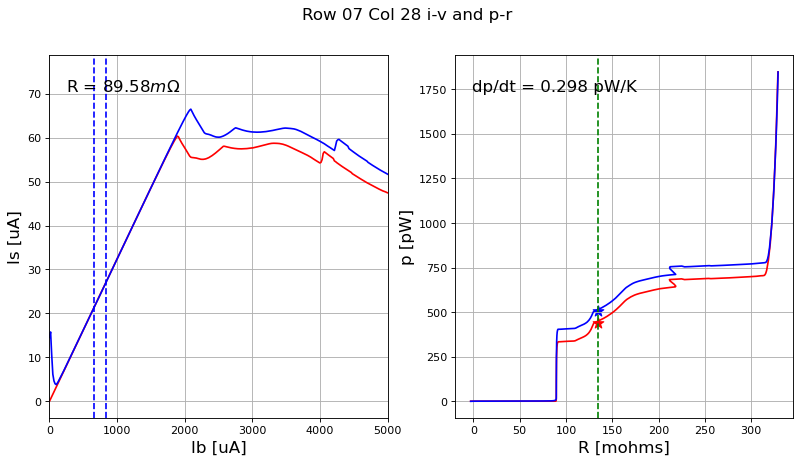

0.2979766771908688 0.08958291305802814
row 7, col 29


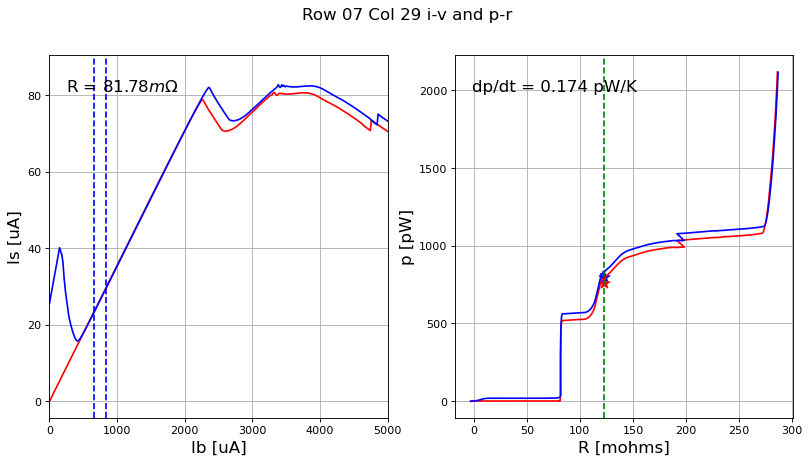

0.17389093013266355 0.08177885648290938
row 7, col 30


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


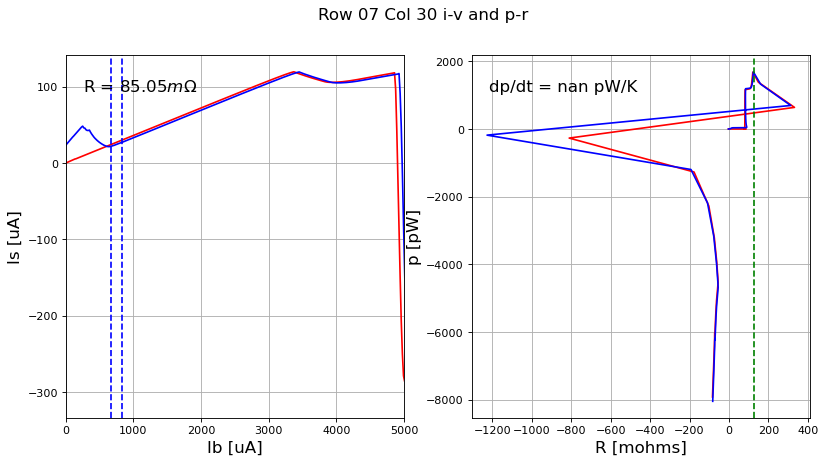

nan 0.0850455196913143
row 7, col 31


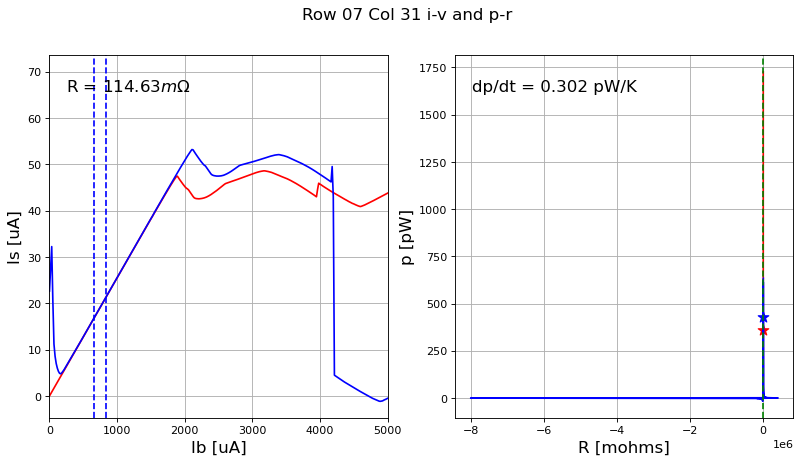

0.3020331845772683 0.11463034700523206
row 8, col 16


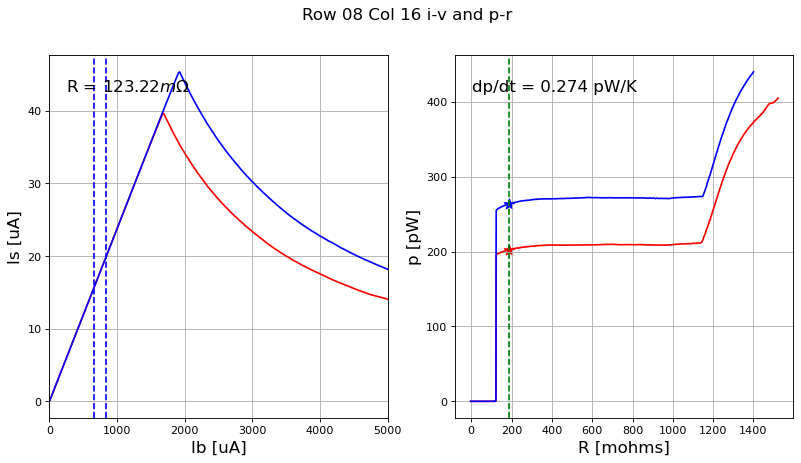

0.2742233198108555 0.12322245383768932
row 8, col 17


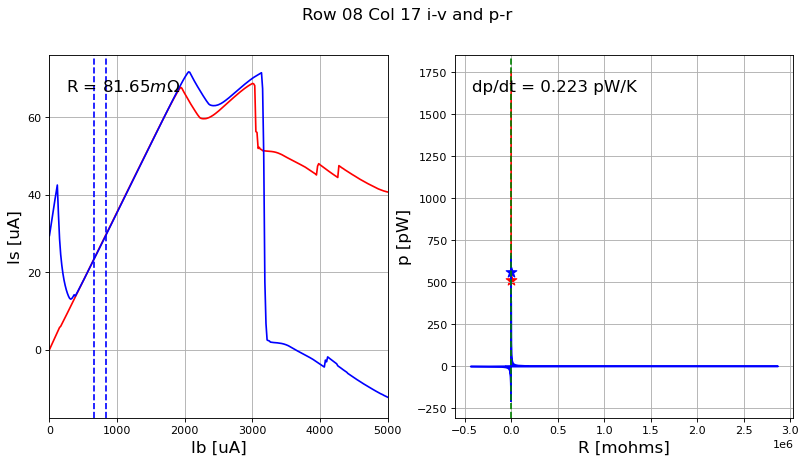

0.2234439098336778 0.08164831864224317
row 8, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


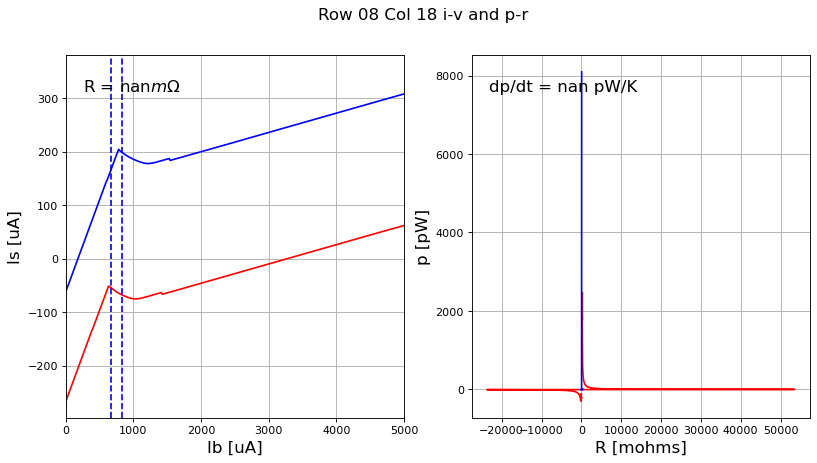

nan nan
row 8, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


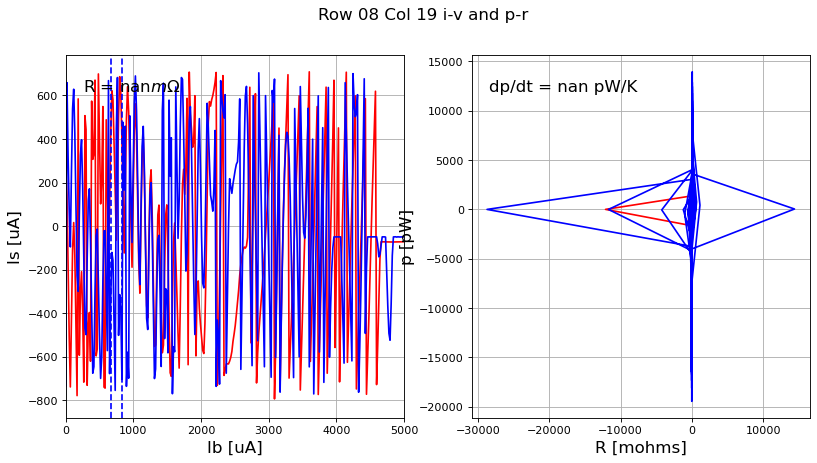

nan nan
row 8, col 20


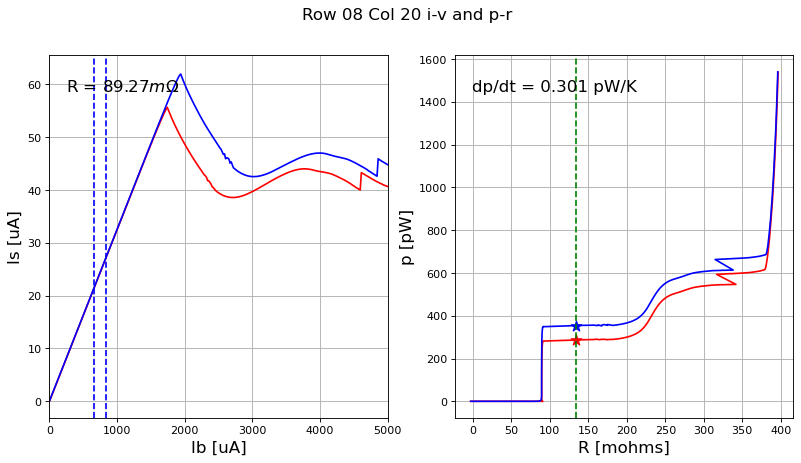

0.30121113854201775 0.08926857088097076
row 8, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


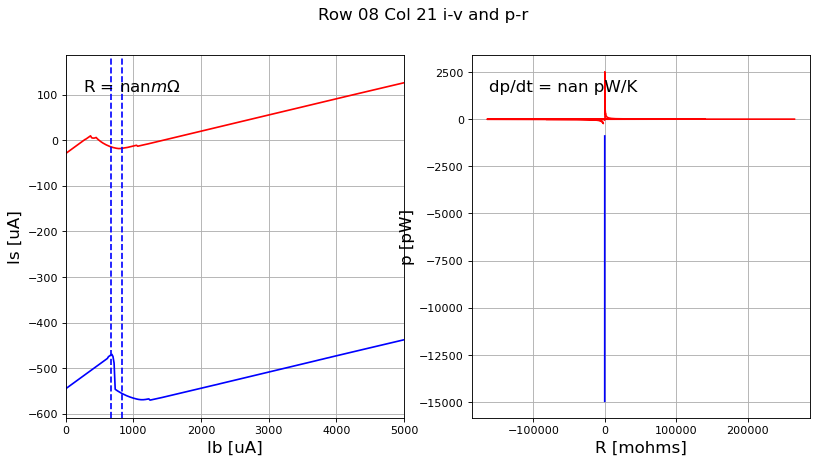

nan nan
row 8, col 22


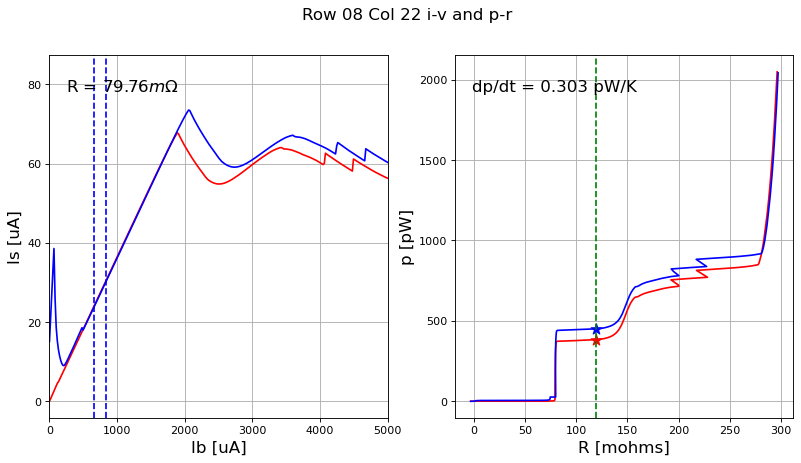

0.3025170416926167 0.07975903704232343
row 8, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


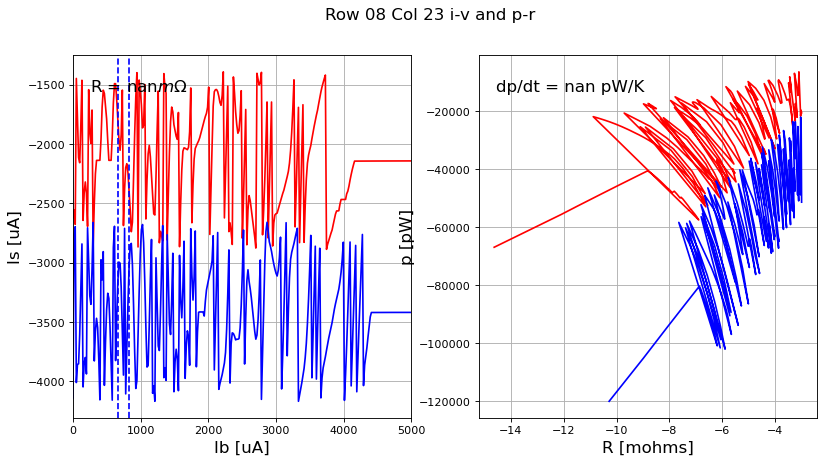

nan nan
row 8, col 24


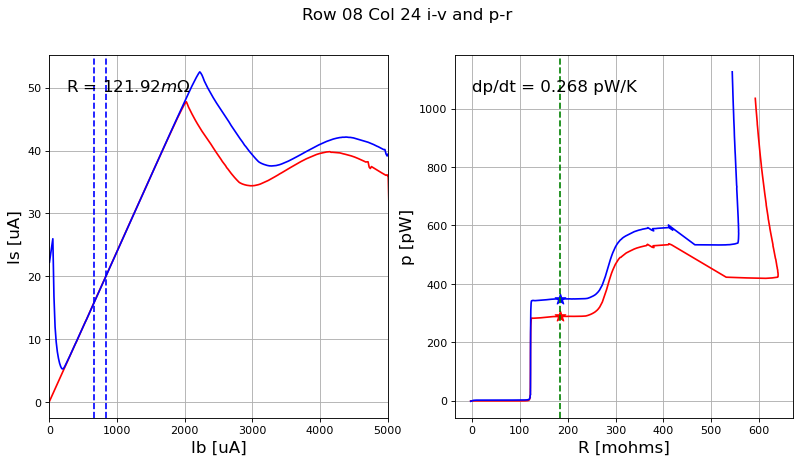

0.2681134115194231 0.12192333747586452
row 8, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


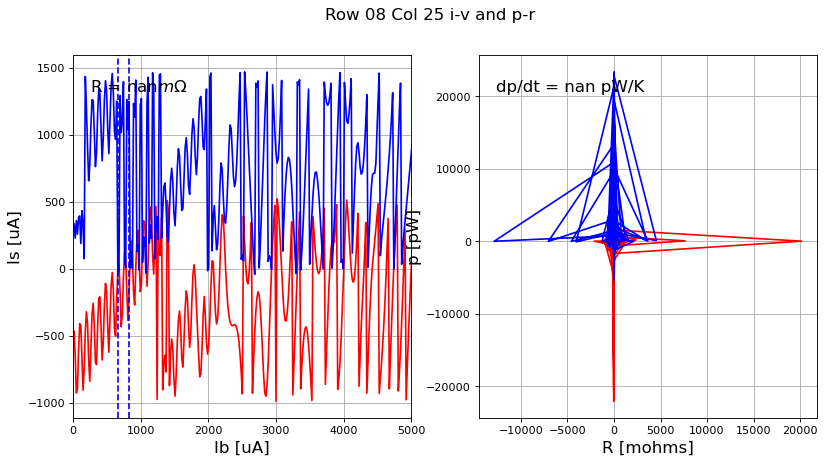

nan nan
row 8, col 26


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


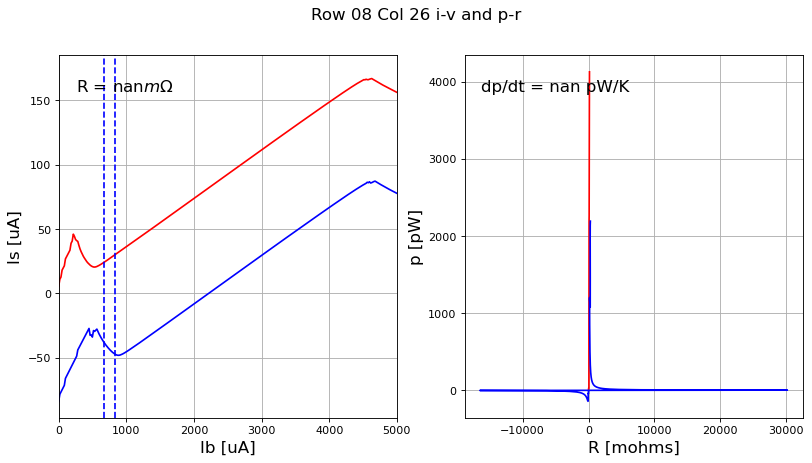

nan nan
row 8, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


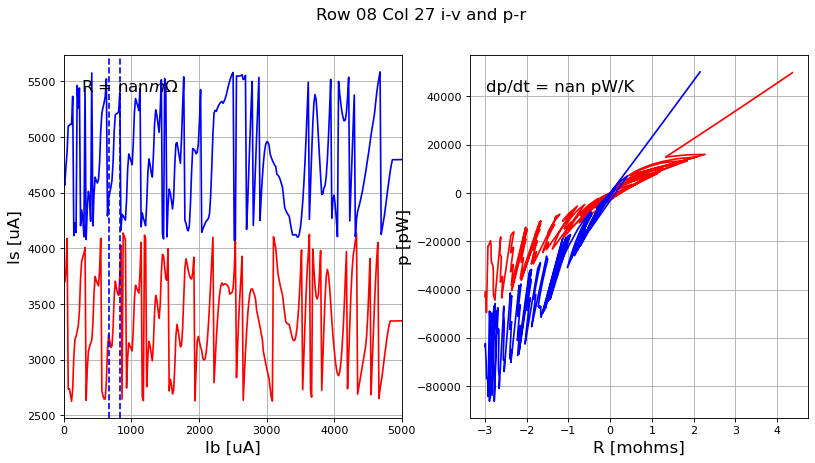

nan nan
row 8, col 28


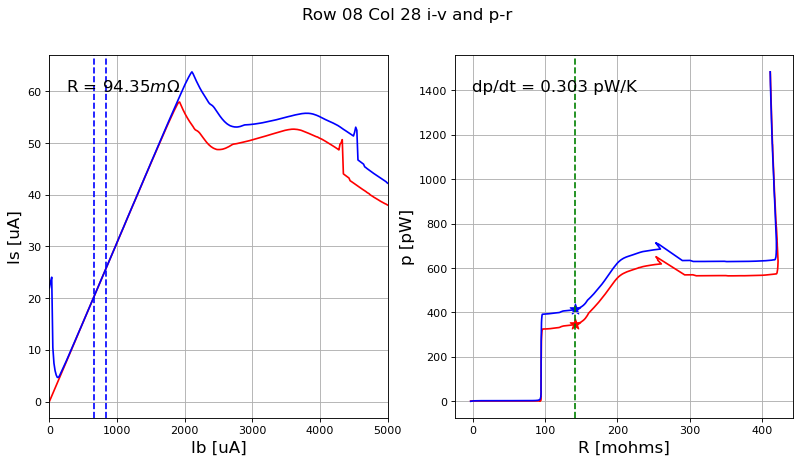

0.3029449761577008 0.09434806267912602
row 8, col 29


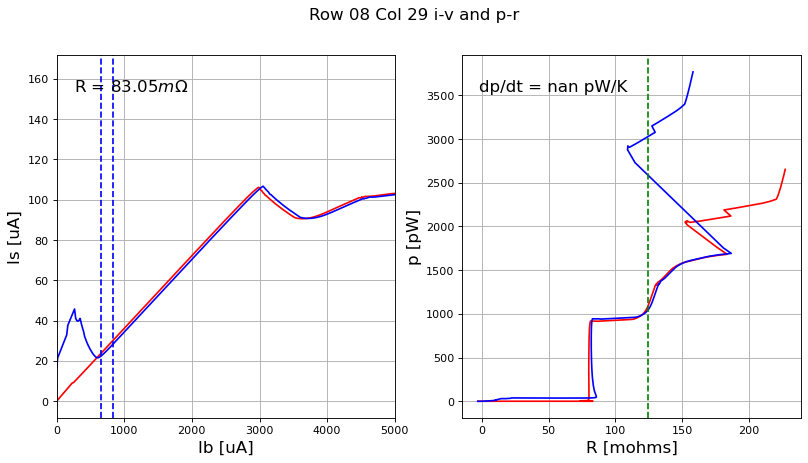

nan 0.08305461271091327
row 8, col 30


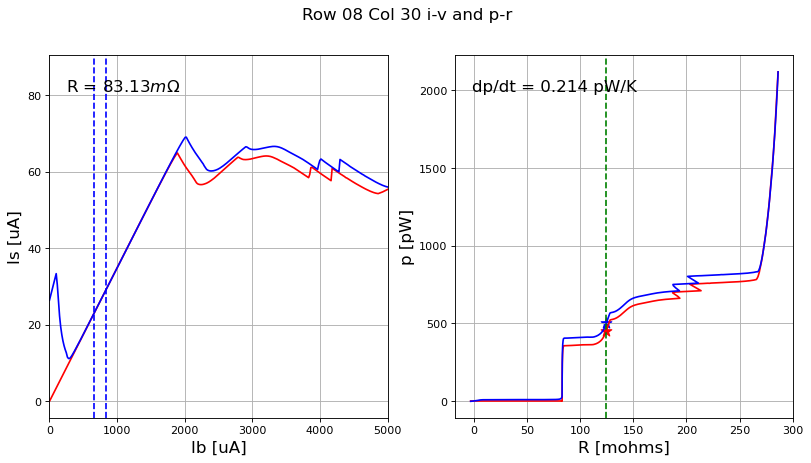

0.21438327665301704 0.08313043147718427
row 8, col 31


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


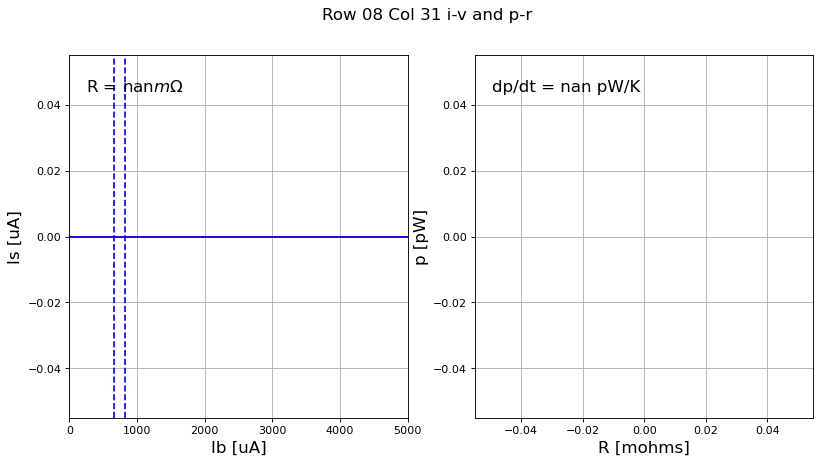

nan nan
row 9, col 16


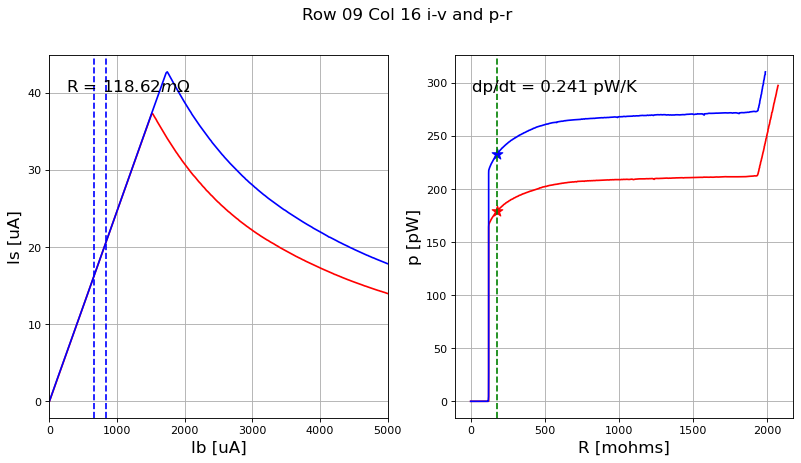

0.2406728960835225 0.1186244744418983
row 9, col 17


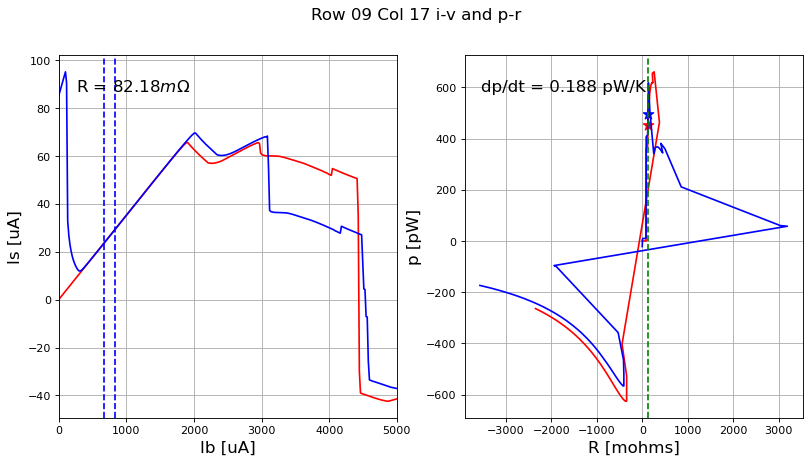

0.1881965068958628 0.08218142803986073
row 9, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


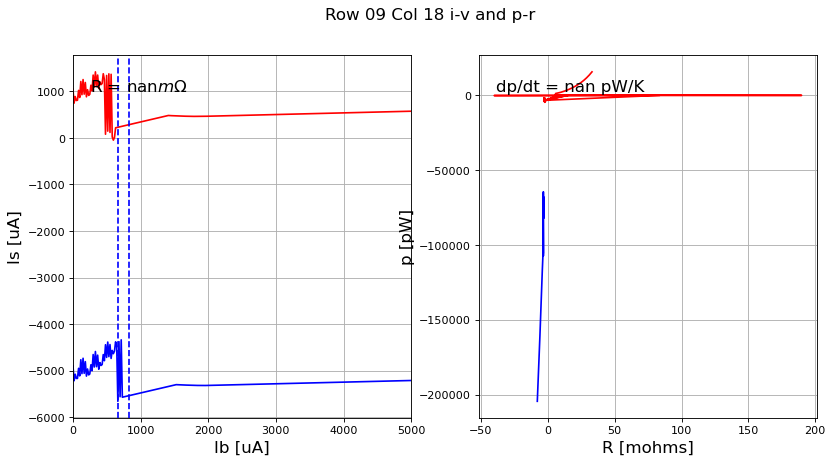

nan nan
row 9, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


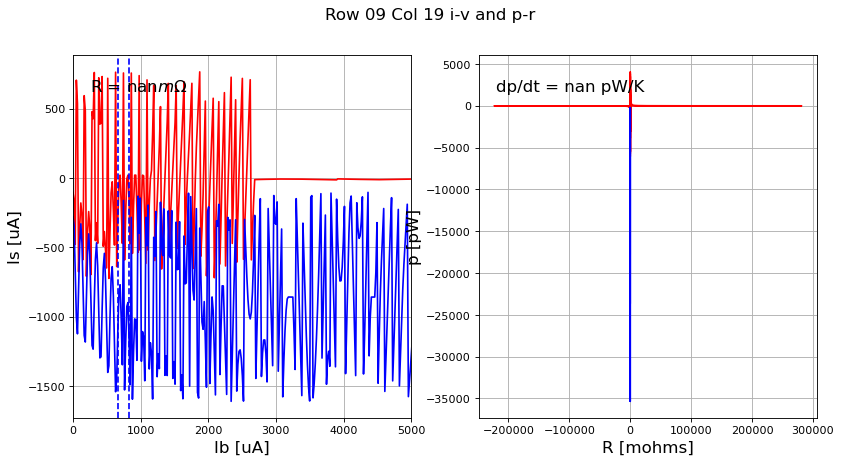

nan nan
row 9, col 20


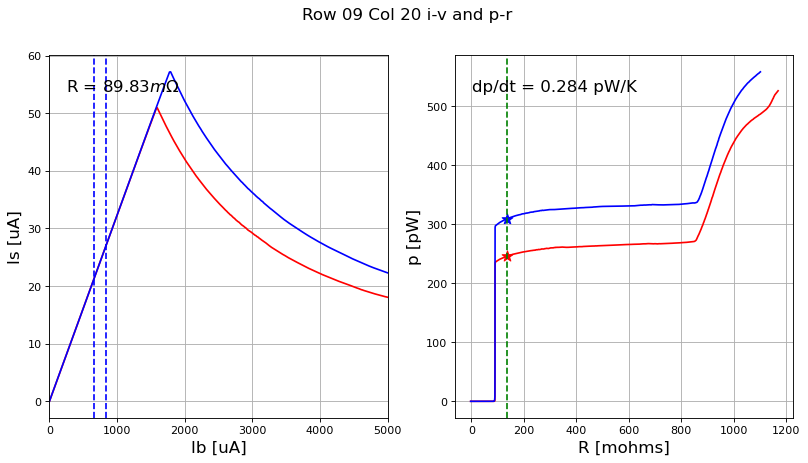

0.28443485295367976 0.08983347525652172
row 9, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


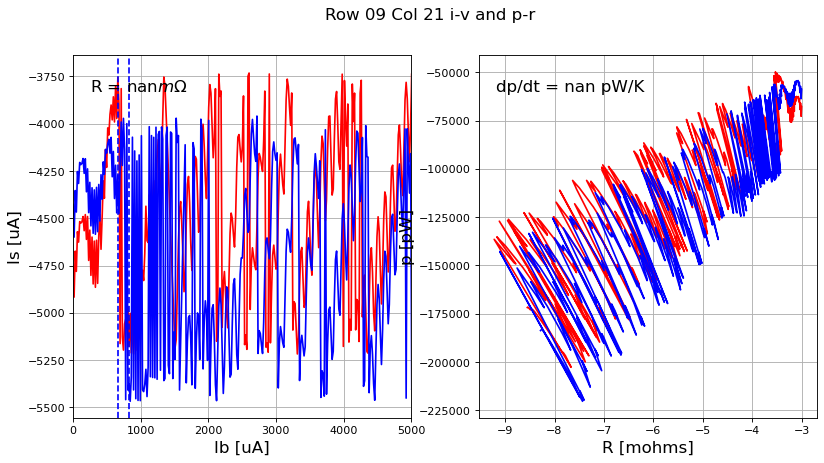

nan nan
row 9, col 22


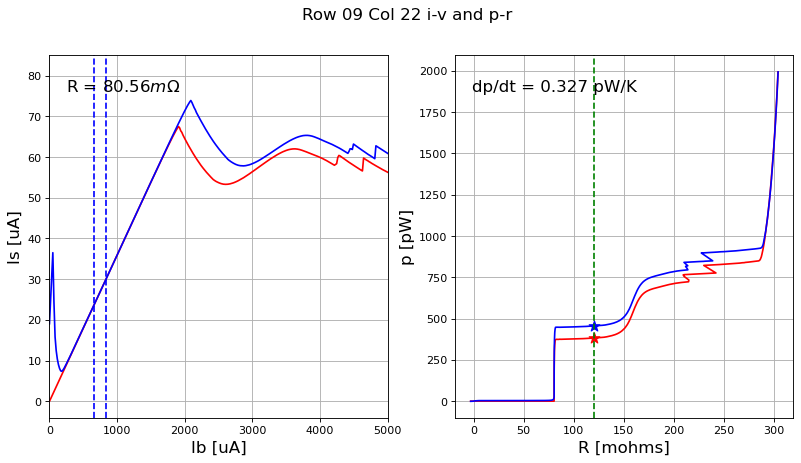

0.3270368526622364 0.08055676856419162
row 9, col 23


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


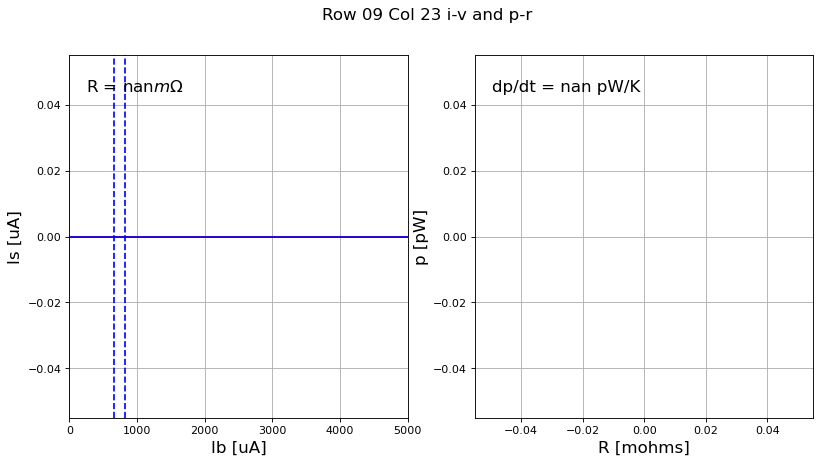

nan nan
row 9, col 24


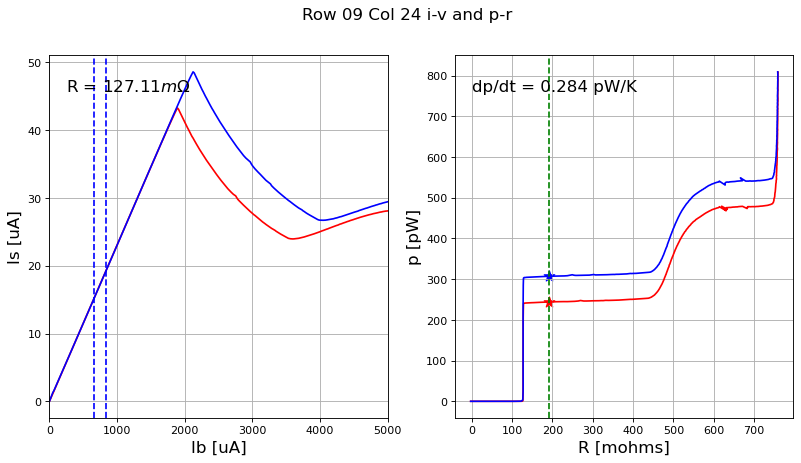

0.28399447670329564 0.12710538171077013
row 9, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


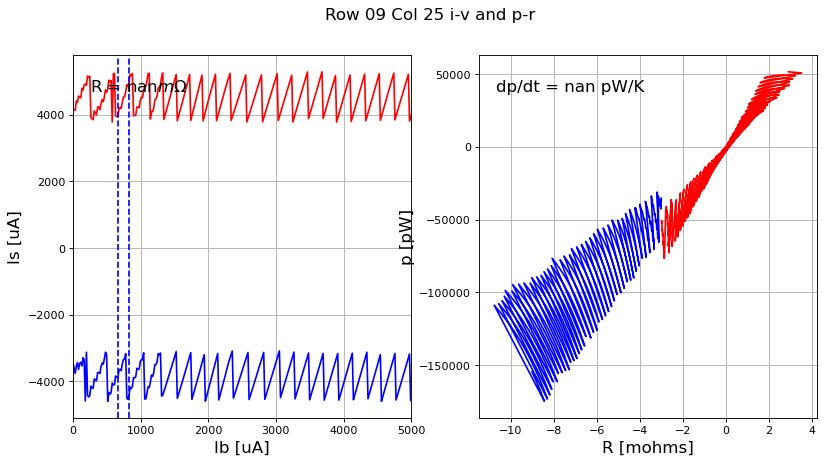

nan nan
row 9, col 26


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


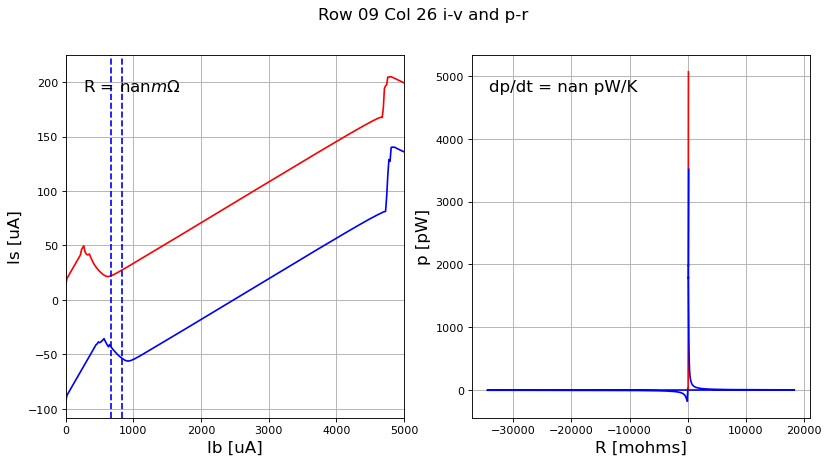

nan nan
row 9, col 27


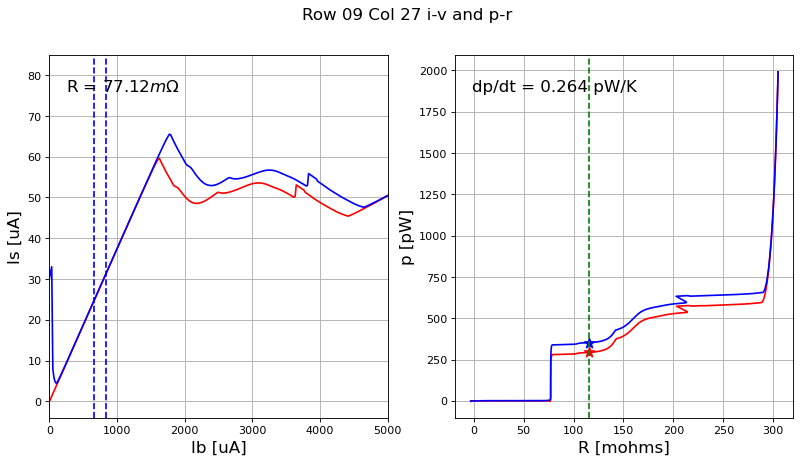

0.26373555609610677 0.07712046453604904
row 9, col 28


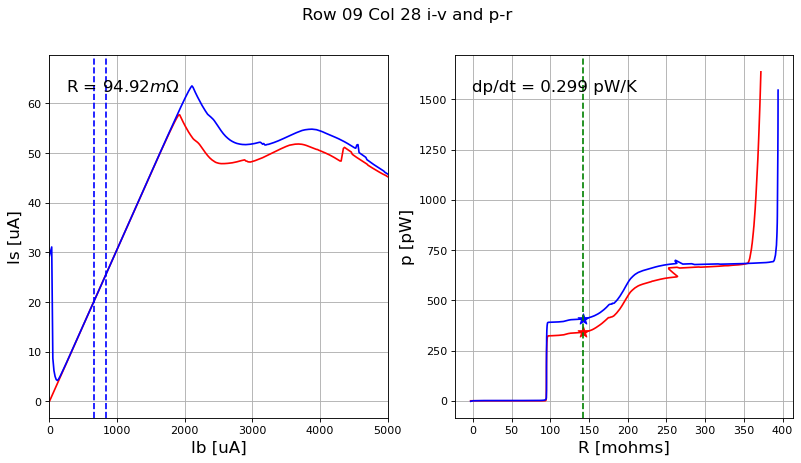

0.29895344209553765 0.09491681969407112
row 9, col 29


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


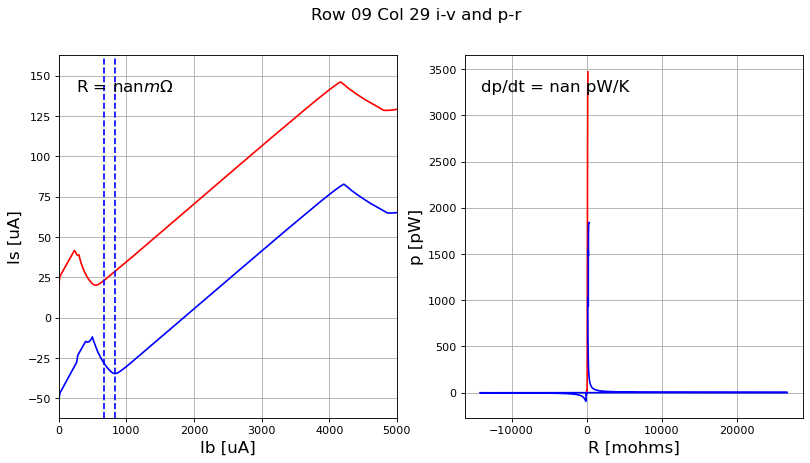

nan nan
row 9, col 30


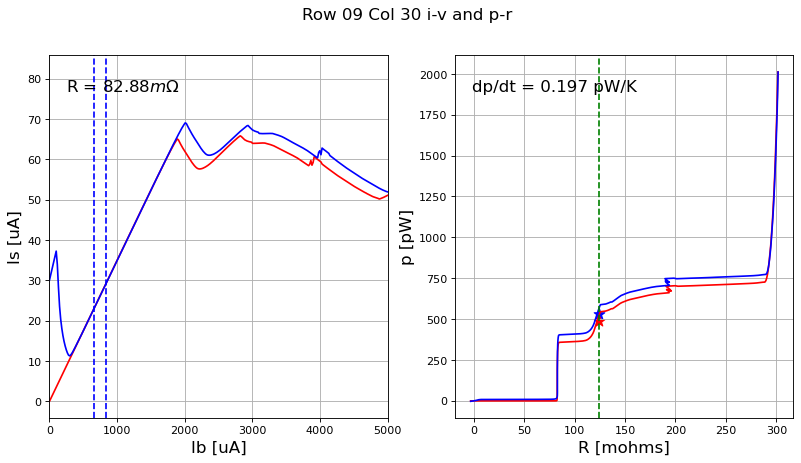

0.19703350119135354 0.08288070329148615
row 9, col 31


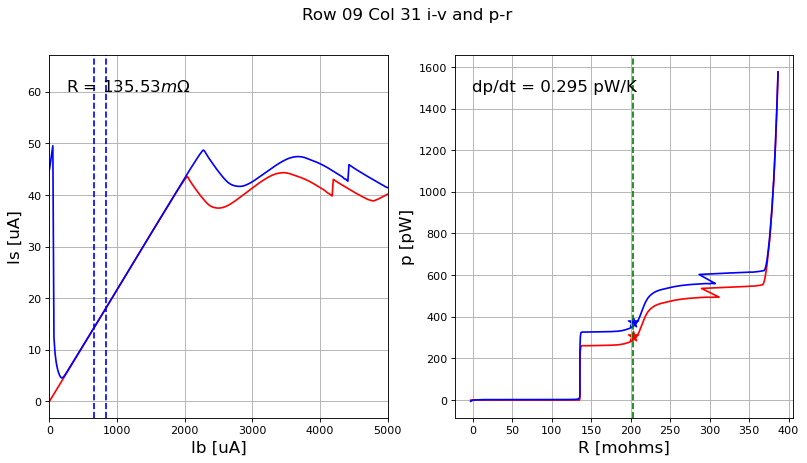

0.2952524948436555 0.13552857413898833
row 10, col 16


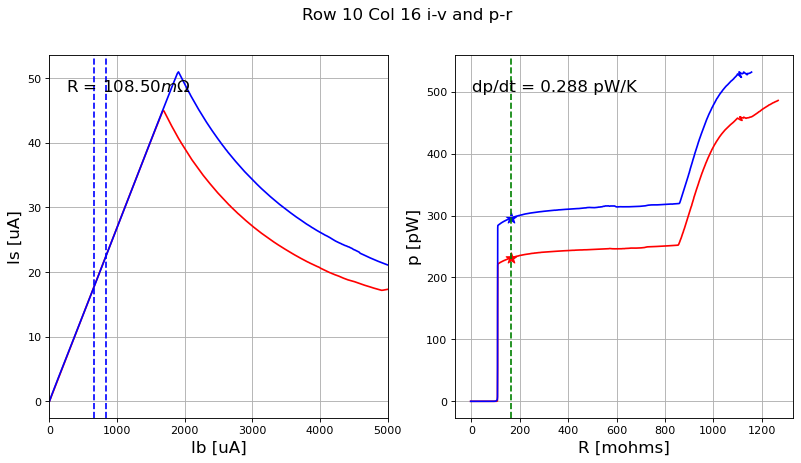

0.2883811305224802 0.10850496272767236
row 10, col 17


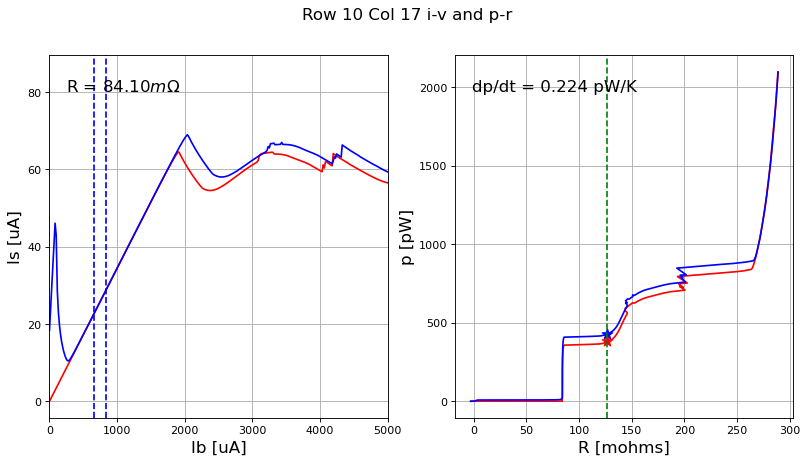

0.223756900869651 0.08409729138227243
row 10, col 18


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


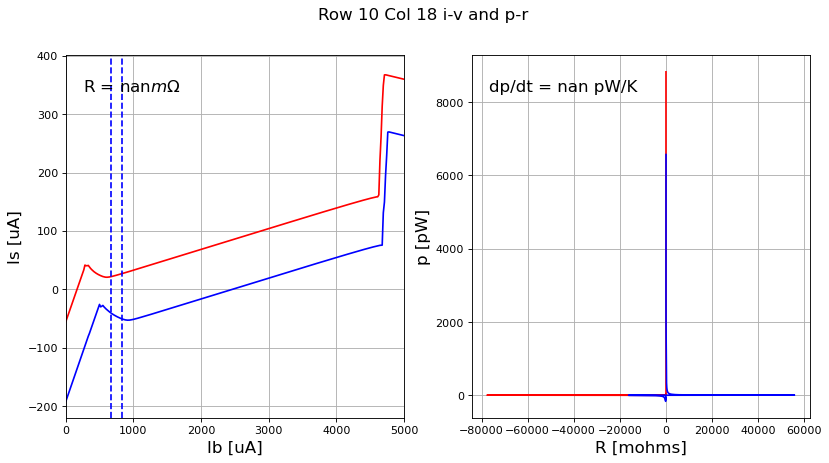

nan nan
row 10, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


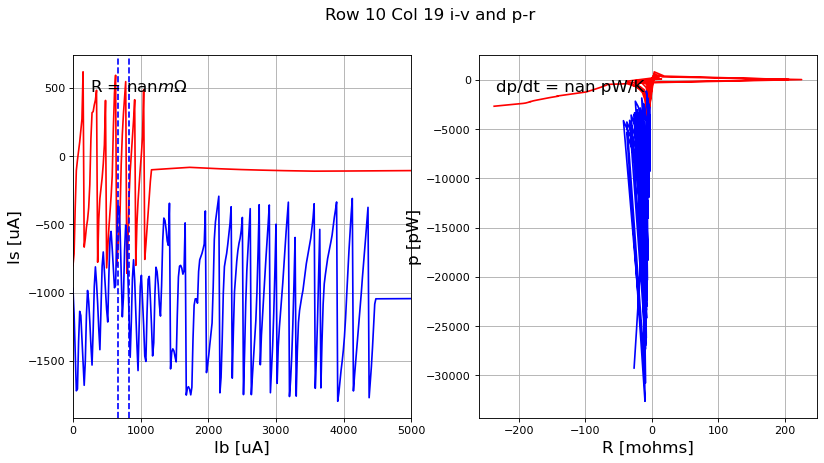

nan nan
row 10, col 20


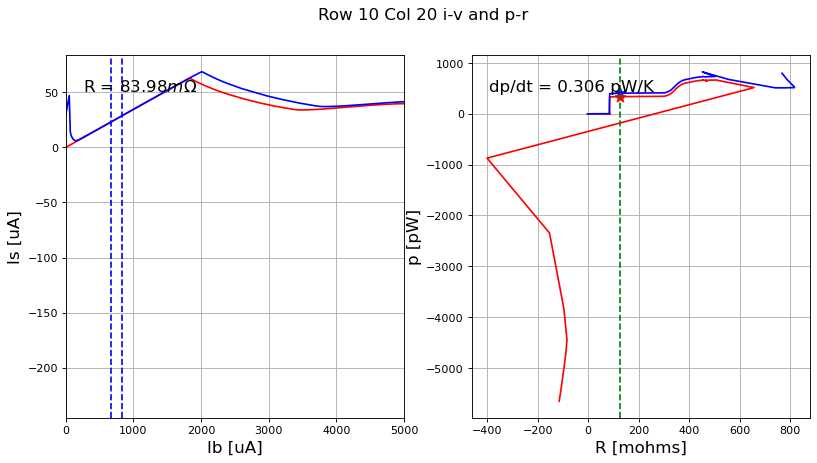

0.3061513006383561 0.0839842234441452
row 10, col 21
#####################
21 10


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


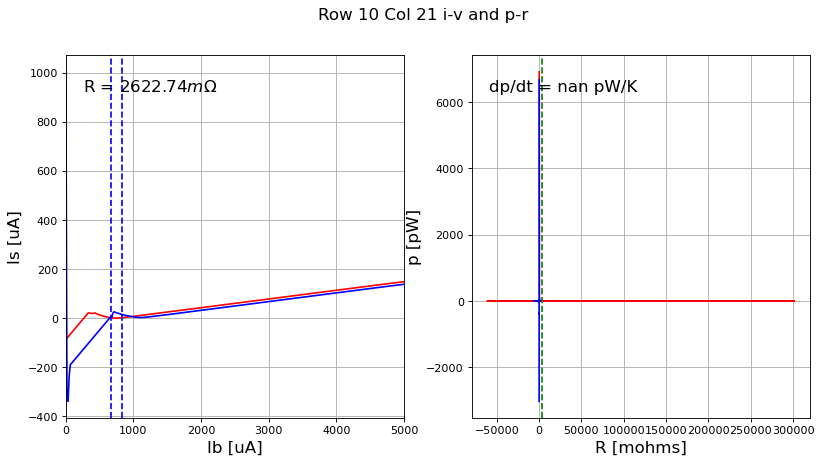

nan 2.6227409085285203
row 10, col 22


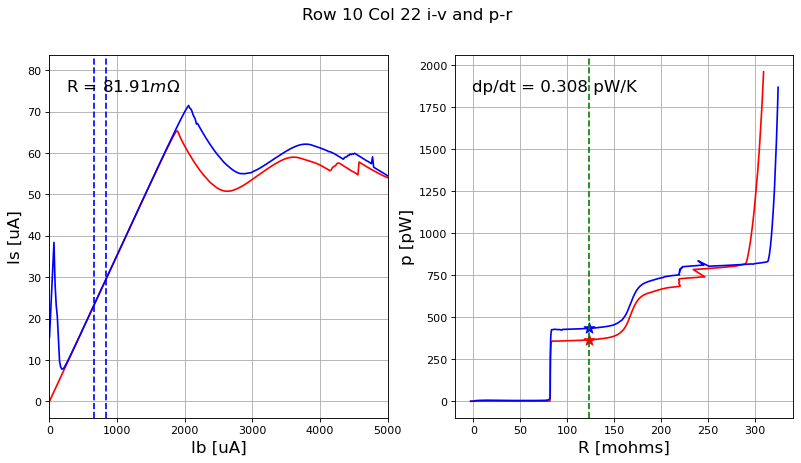

0.3083724308876697 0.08190675616408616
row 10, col 23


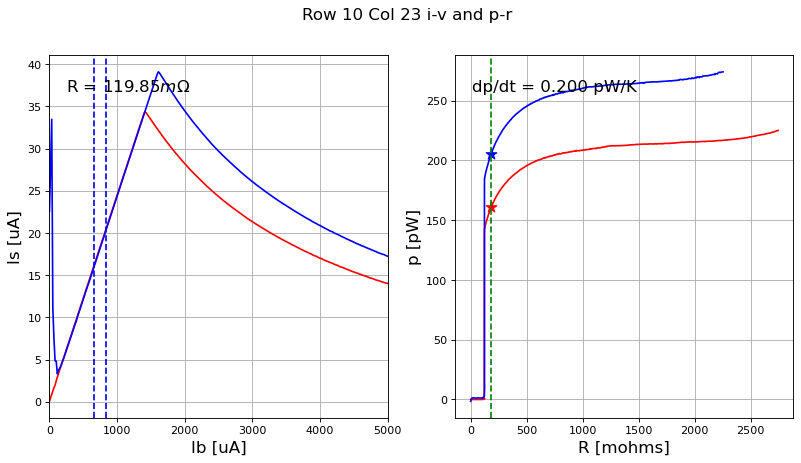

0.20028729310410784 0.11985378984218424
row 10, col 24


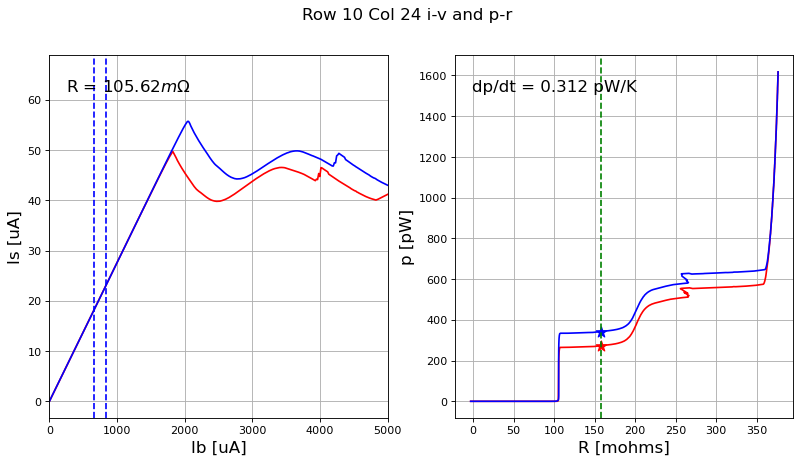

0.312417628669828 0.1056221231853616
row 10, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


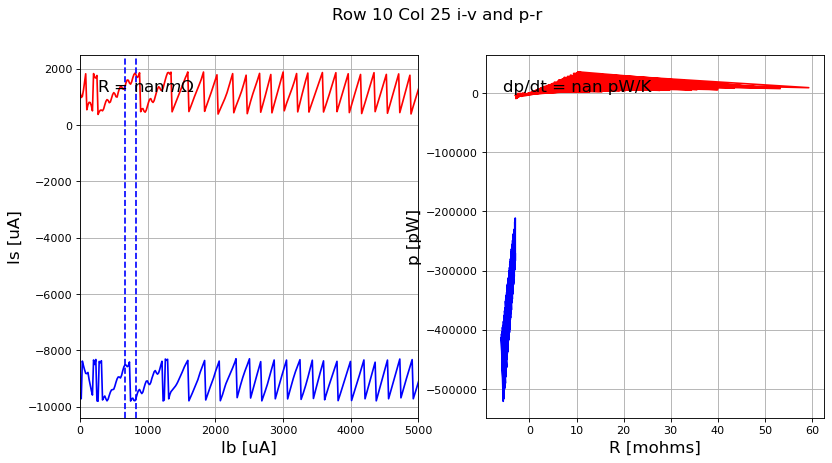

nan nan
row 10, col 26


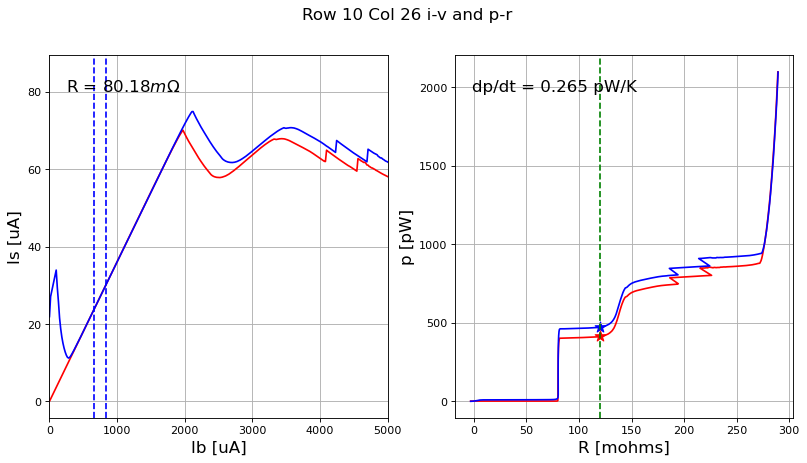

0.2651434173526702 0.08018328809967268
row 10, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


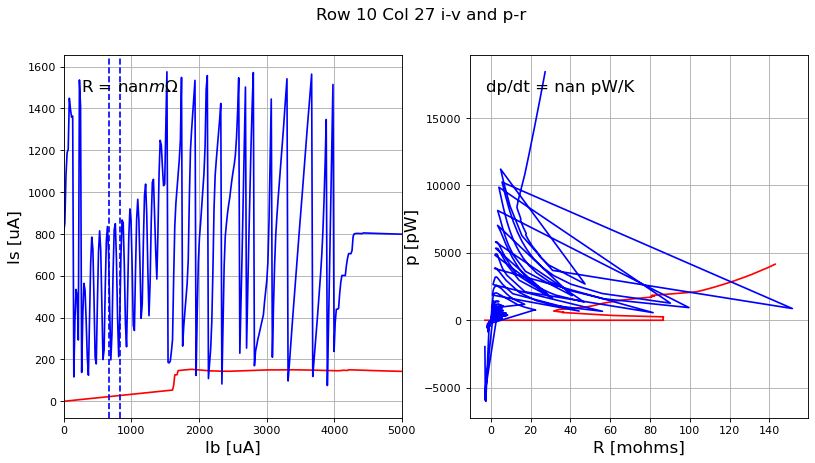

nan nan
row 10, col 28


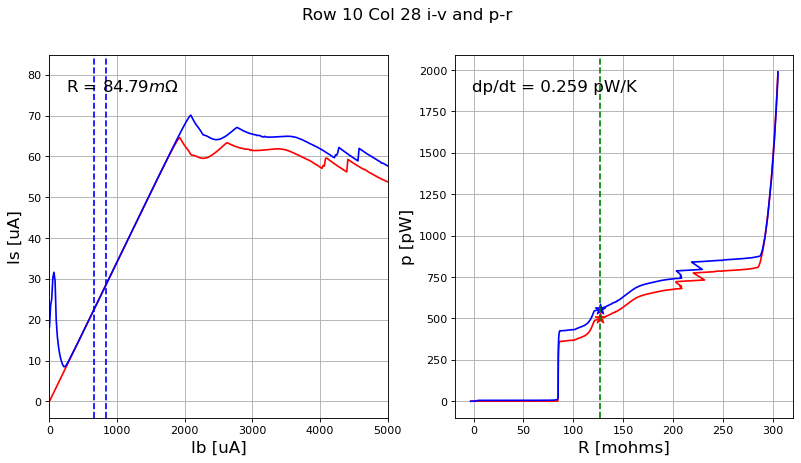

0.25934642491712234 0.08478935554175951
row 10, col 29


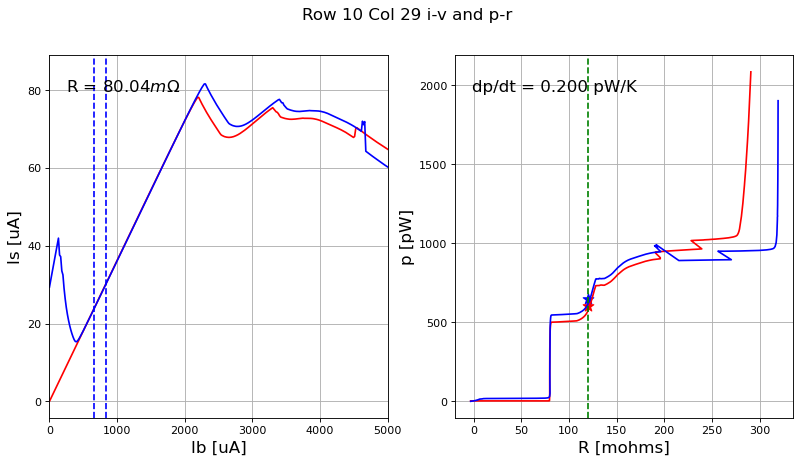

0.19966002618366913 0.08003681788369708
row 10, col 30


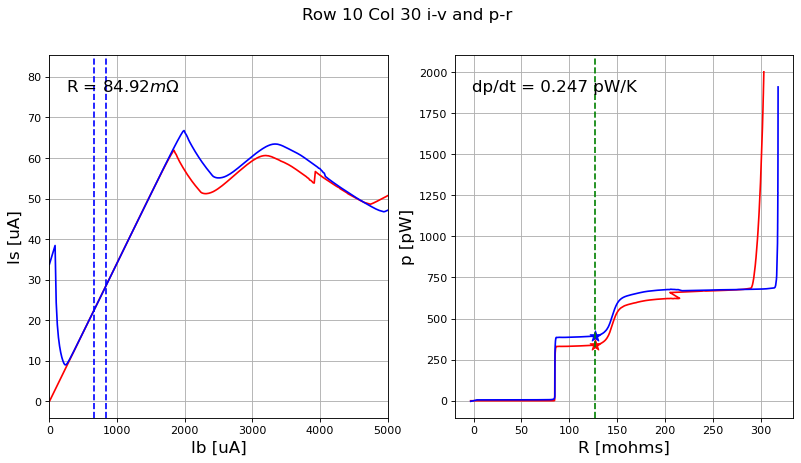

0.2465823927556651 0.08492319871399519
row 10, col 31


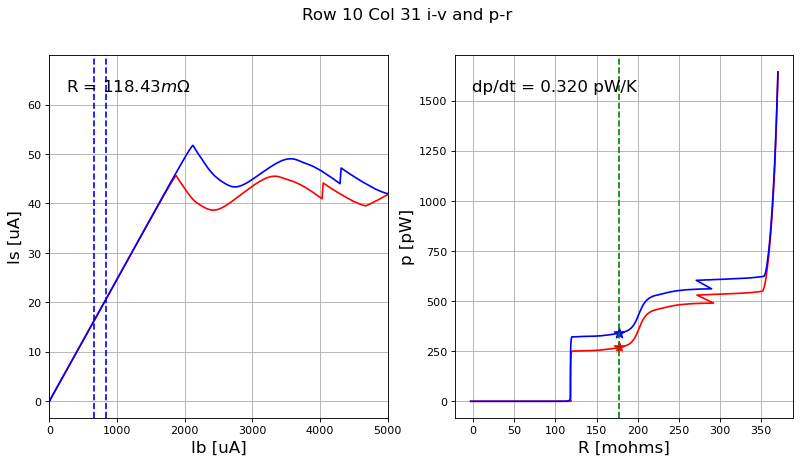

0.319525682217882 0.11843447797198316
row 11, col 16


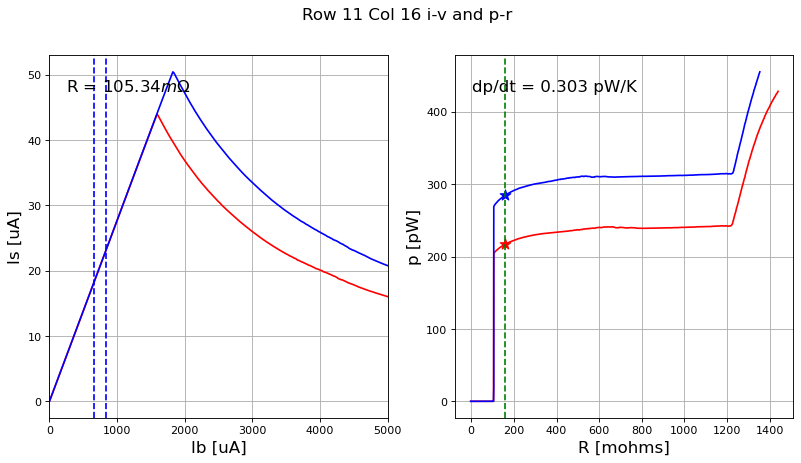

0.30252280559163347 0.10533761973976673
row 11, col 17


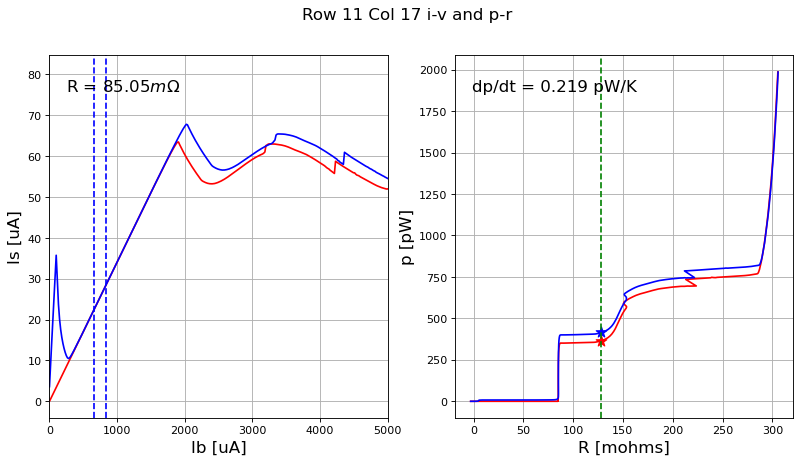

0.2190268541748399 0.08504968942389135
row 11, col 18


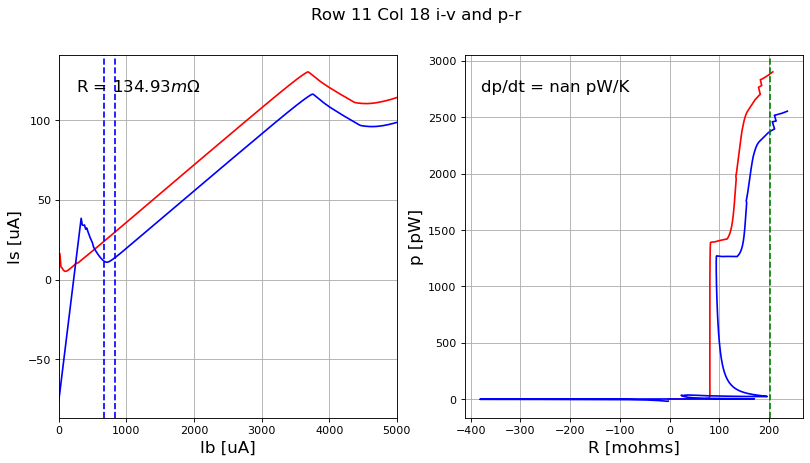

nan 0.13493207687826048
row 11, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


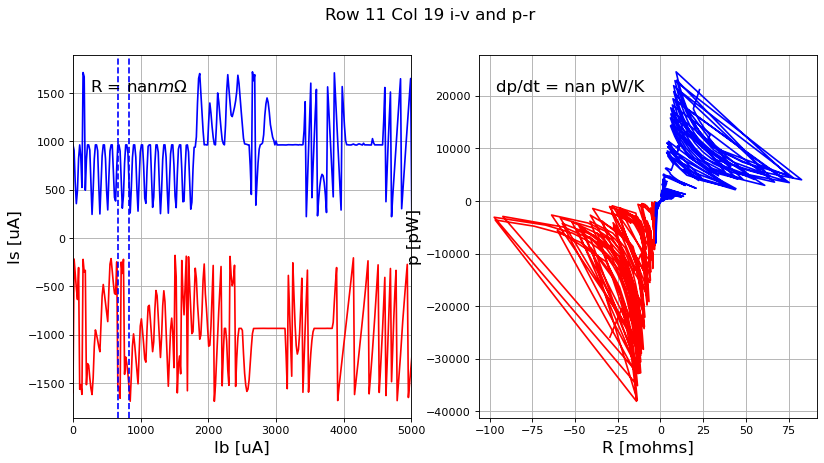

nan nan
row 11, col 20


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


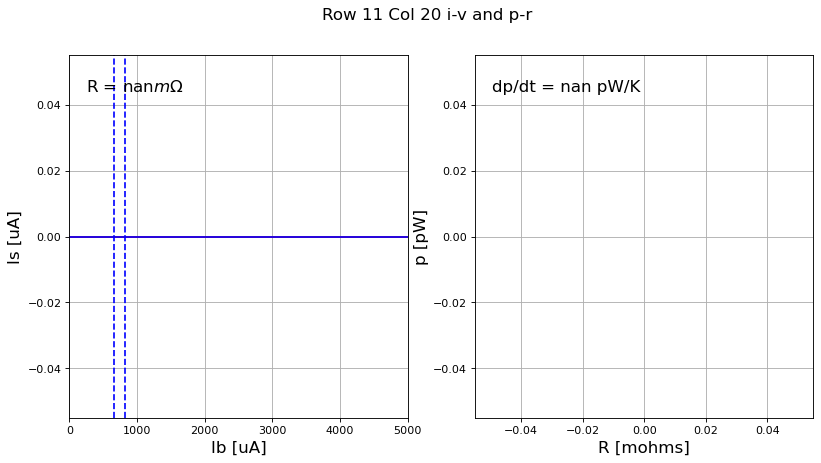

nan nan
row 11, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


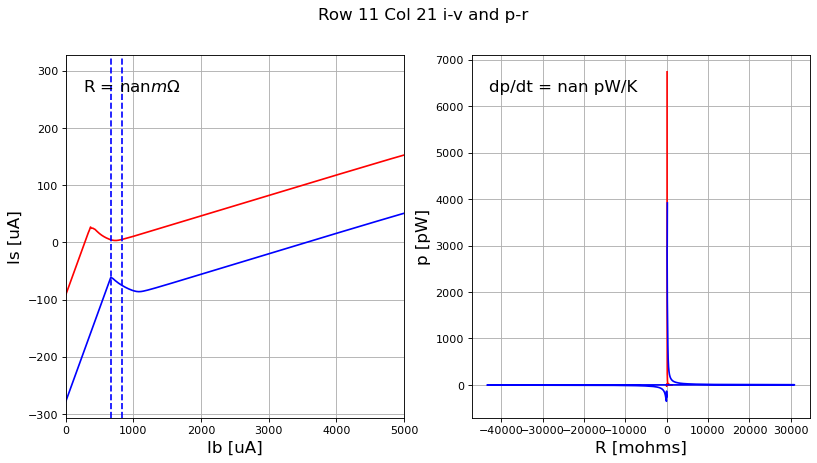

nan nan
row 11, col 22


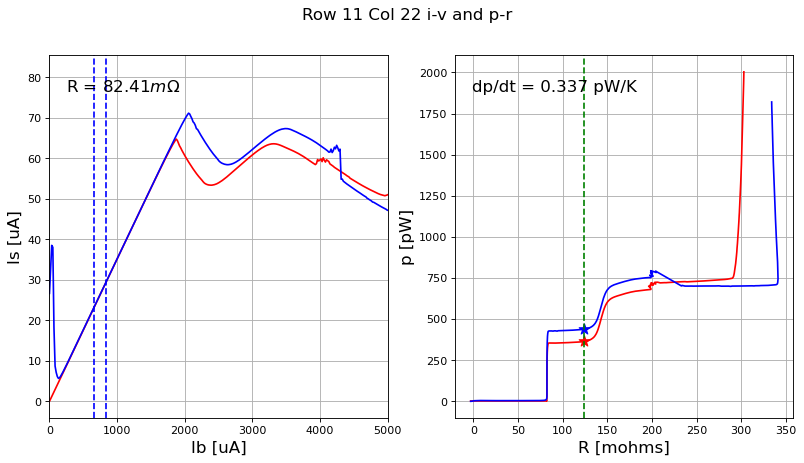

0.33685435517667817 0.08240734104061322
row 11, col 23


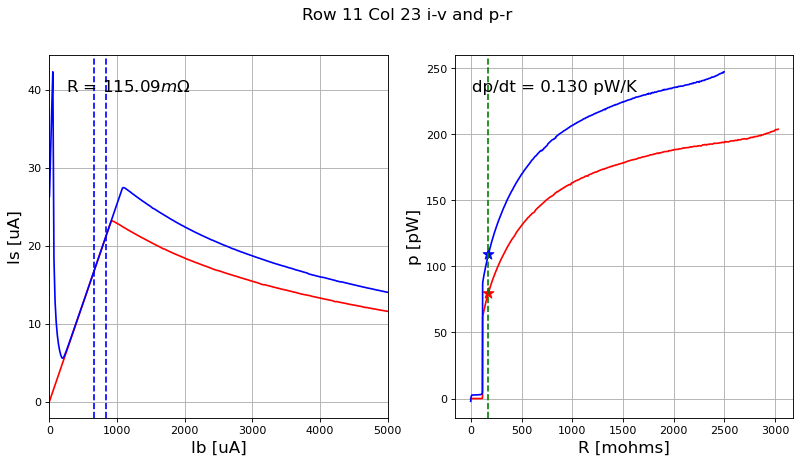

0.1299209621392976 0.1150878863834284
row 11, col 24


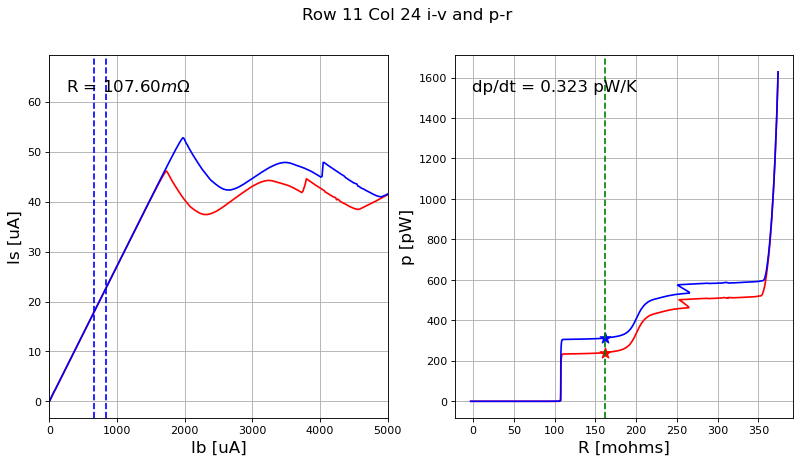

0.32282425961416505 0.10759941820624369
row 11, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


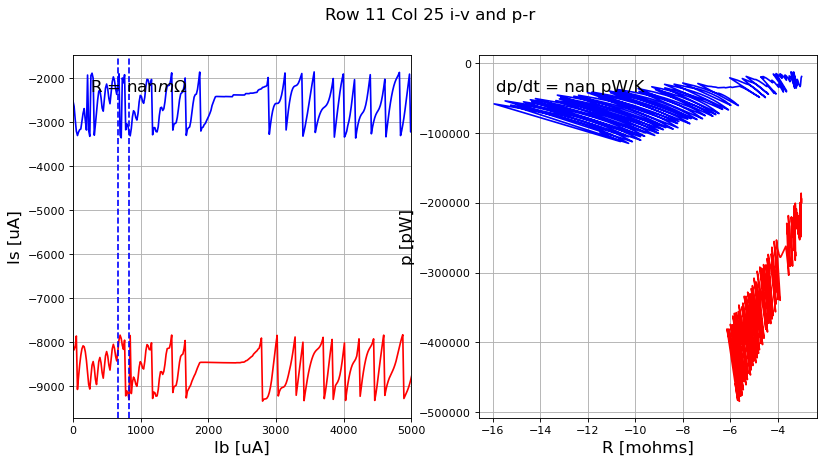

nan nan
row 11, col 26


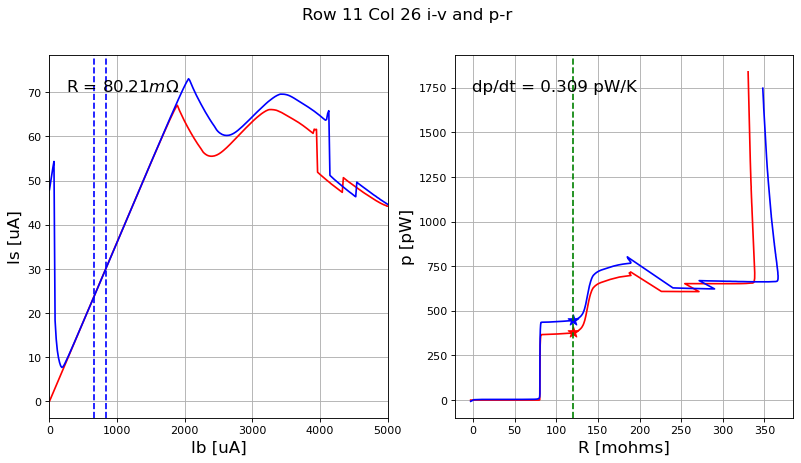

0.3090548244105352 0.08021352385275915
row 11, col 27


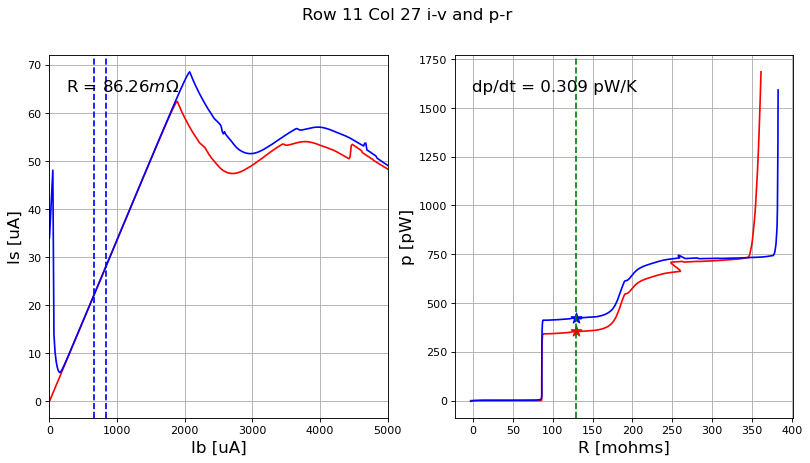

0.3091254377516308 0.08625600179905835
row 11, col 28


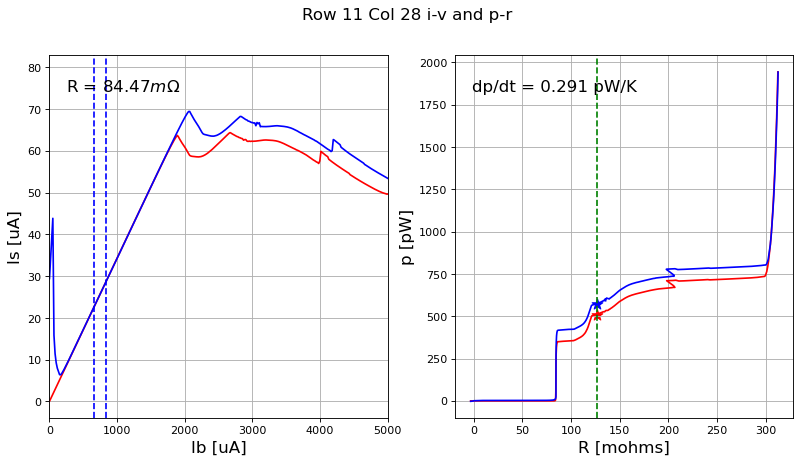

0.29087260348877203 0.0844688819773636
row 11, col 29
#####################
29 11


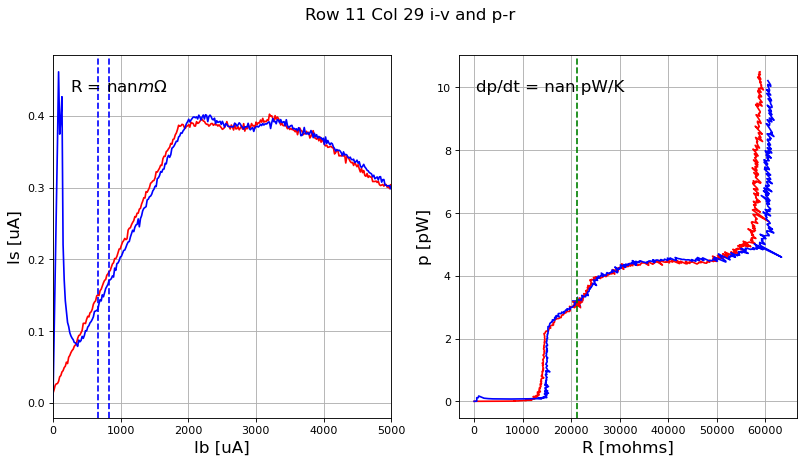

nan nan
row 11, col 30


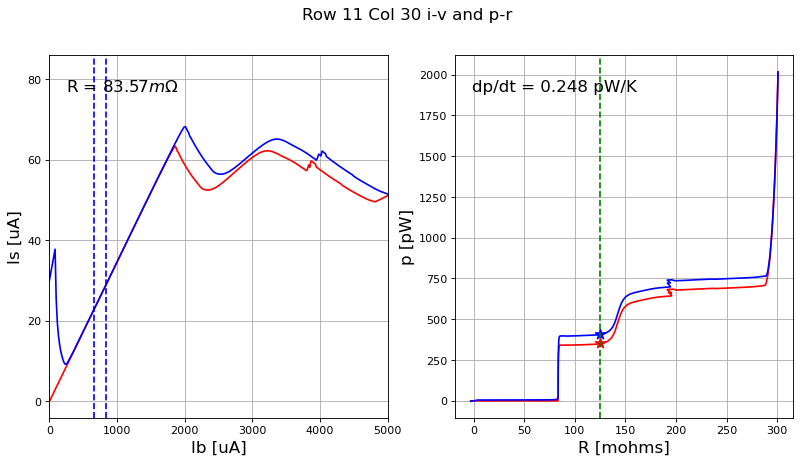

0.24789355811307634 0.08356668797944362
row 11, col 31


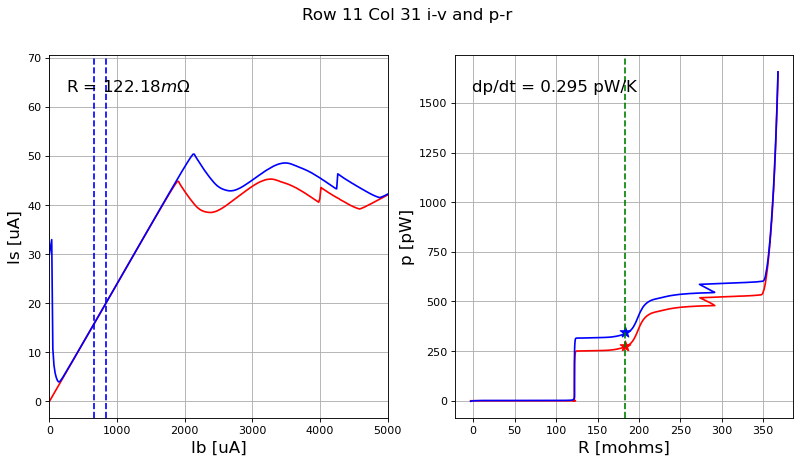

0.29514679485443124 0.12218270920352994
row 12, col 16


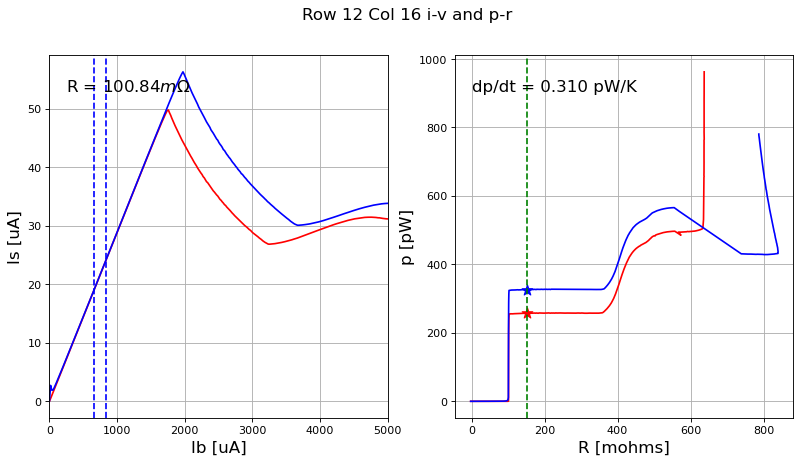

0.3095773700857819 0.10084434350096291
row 12, col 17


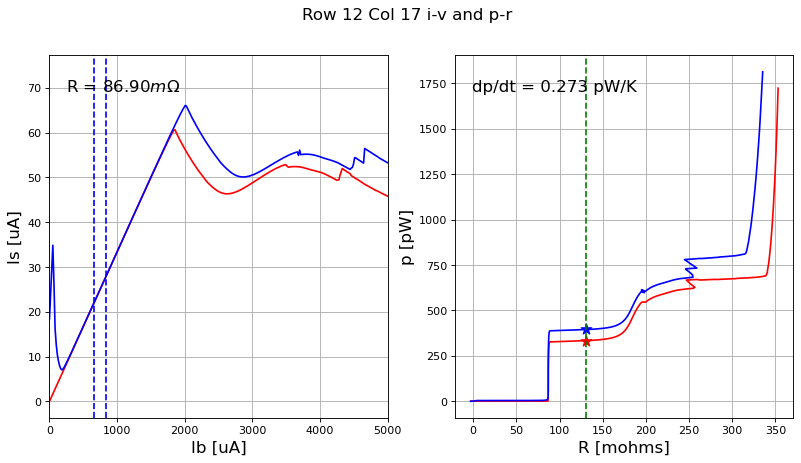

0.2730423100077873 0.08689574360460536
row 12, col 18


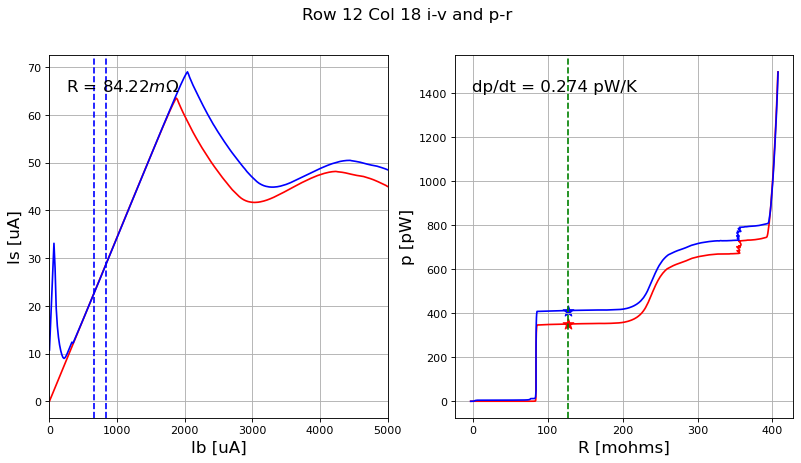

0.27396185580557064 0.08422194156973253
row 12, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


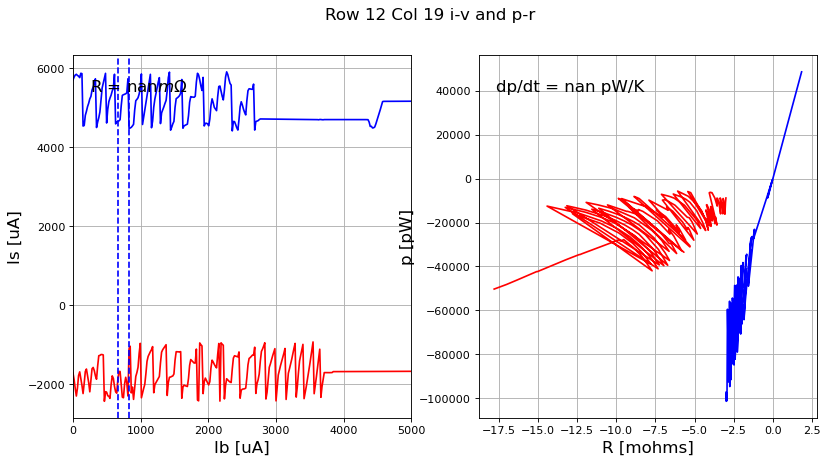

nan nan
row 12, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


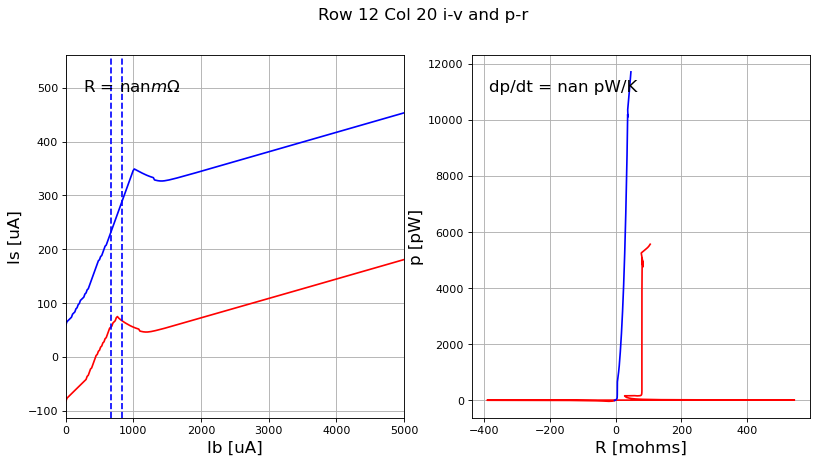

nan nan
row 12, col 21


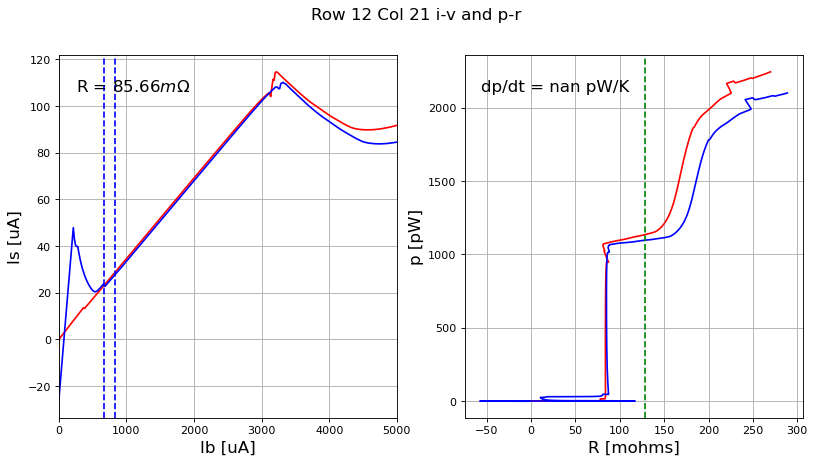

nan 0.08565684206188073
row 12, col 22


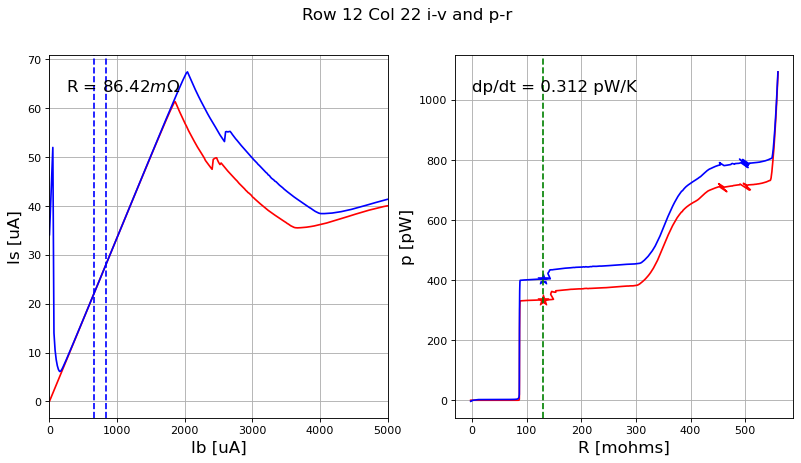

0.3115259222074579 0.0864184274789992
row 12, col 23


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


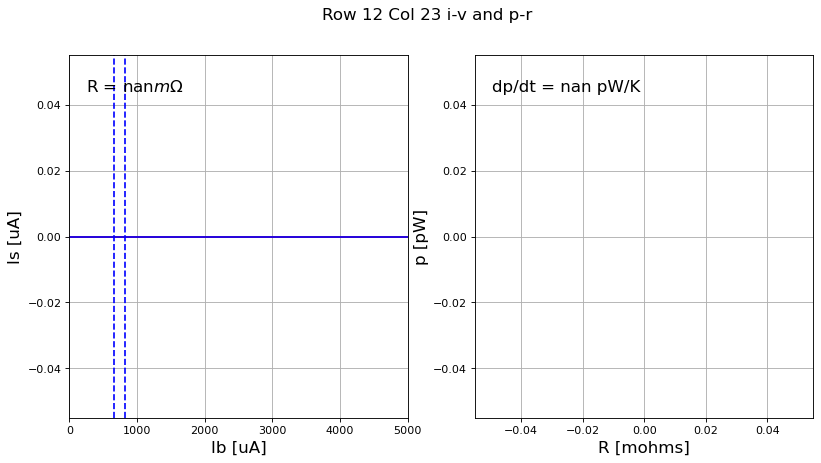

nan nan
row 12, col 24


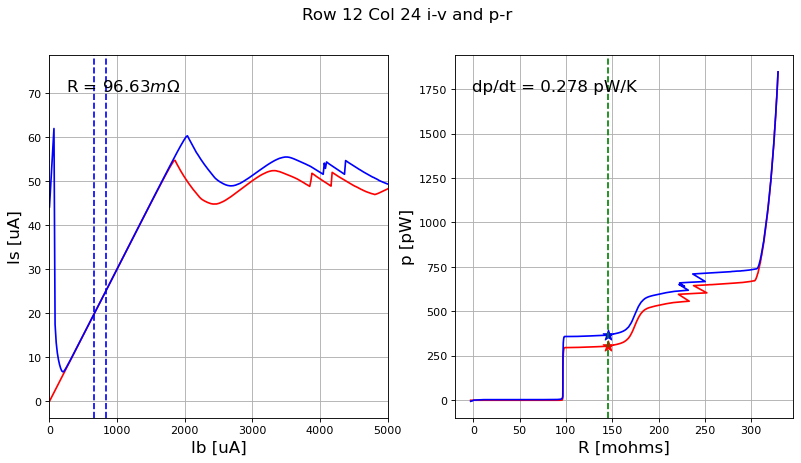

0.27783489037839504 0.09662692884424039
row 12, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


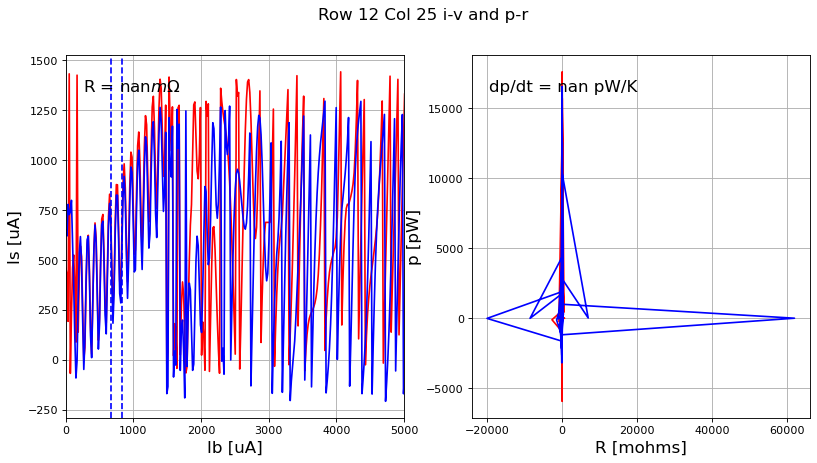

nan nan
row 12, col 26


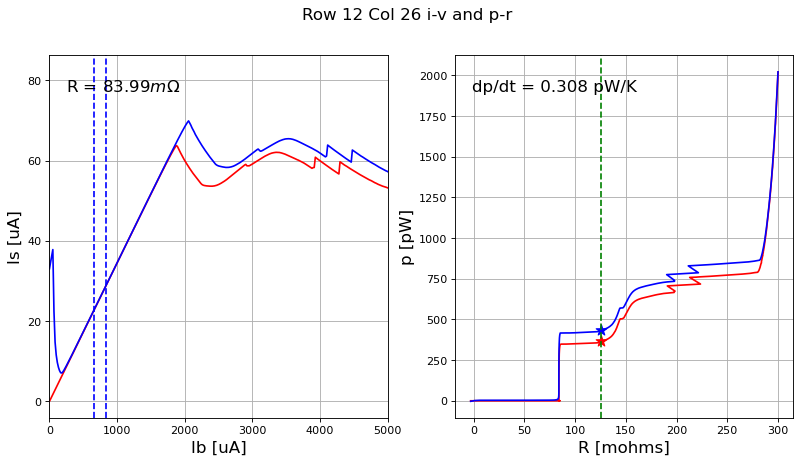

0.307899501437931 0.083986194895049
row 12, col 27


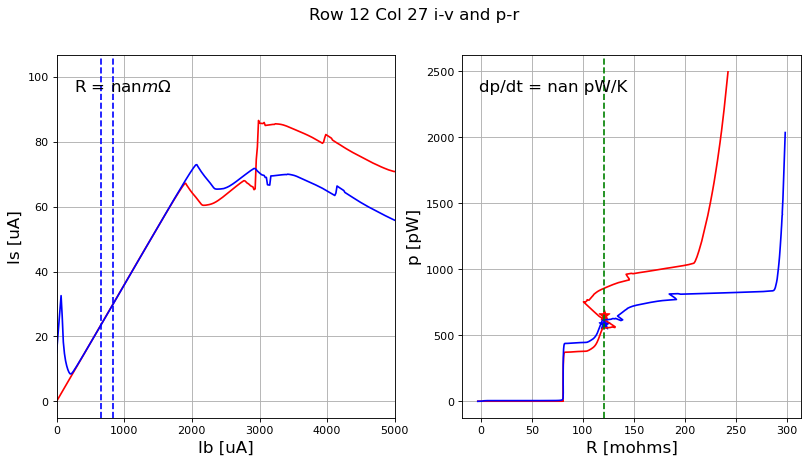

nan nan
row 12, col 28


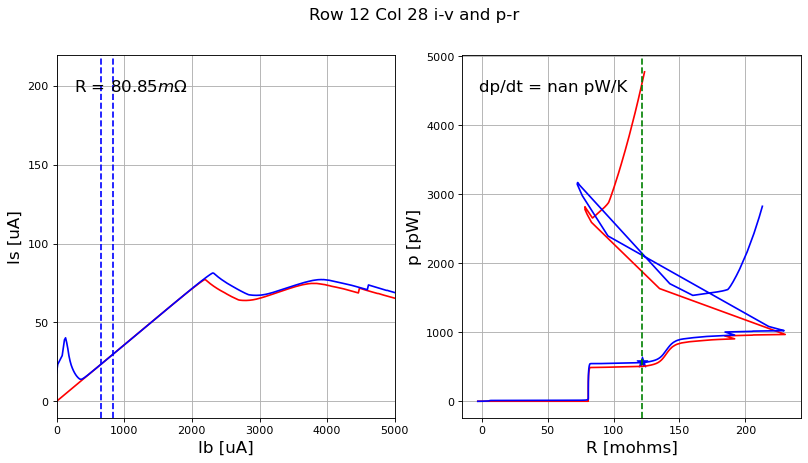

nan 0.08085380846412915
row 12, col 29


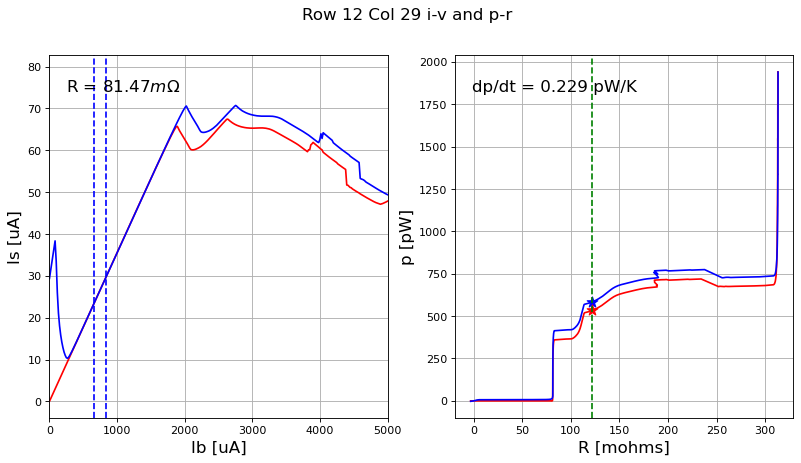

0.22940978551964344 0.08147182273476086
row 12, col 30


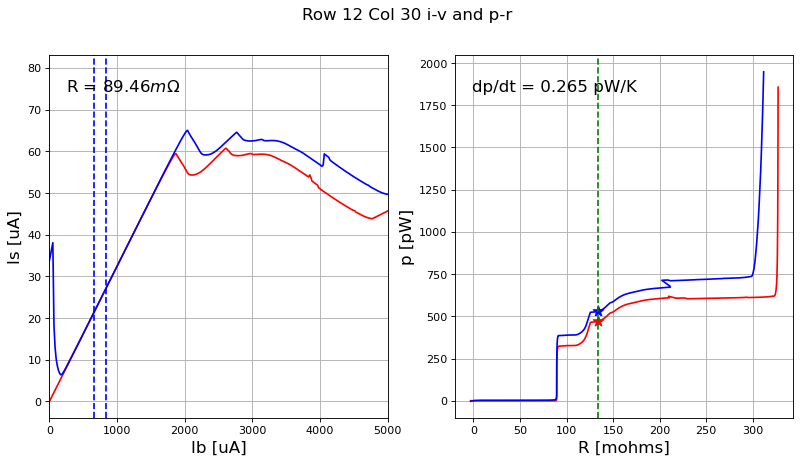

0.2653247013325564 0.08946479902142604
row 12, col 31


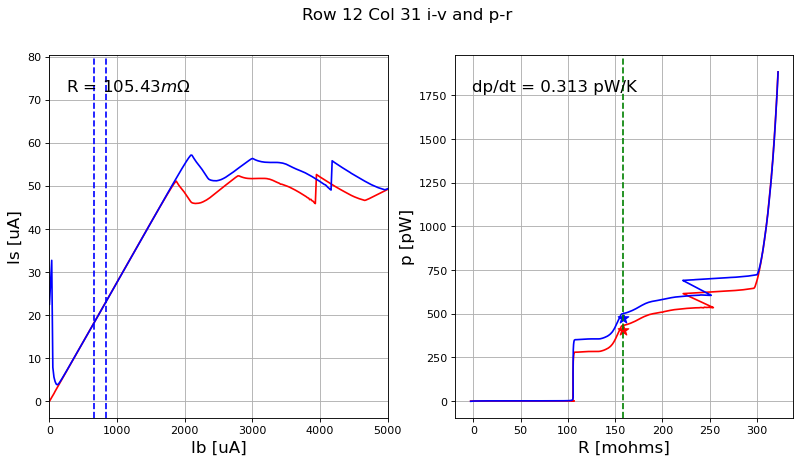

0.31262358877203017 0.10542539515824853
row 13, col 16


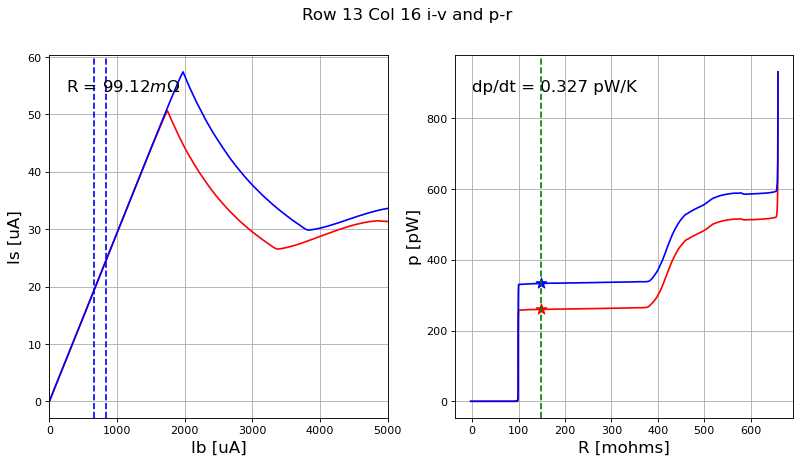

0.32745472897479294 0.09911662945689625
row 13, col 17


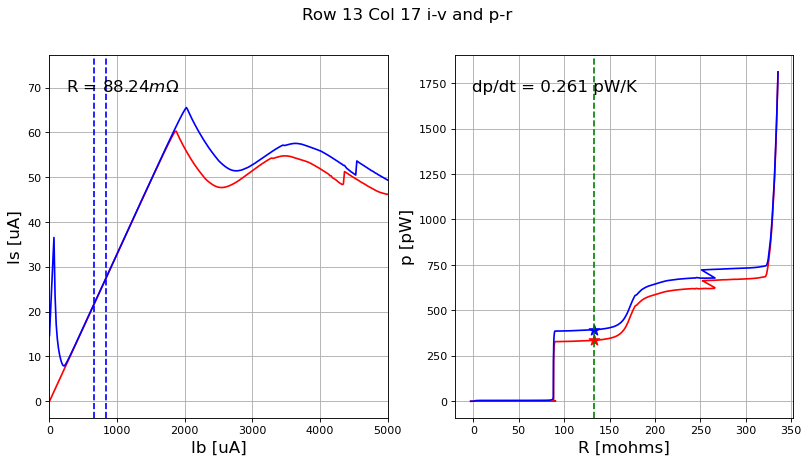

0.2608831421215556 0.08824227620233319
row 13, col 18


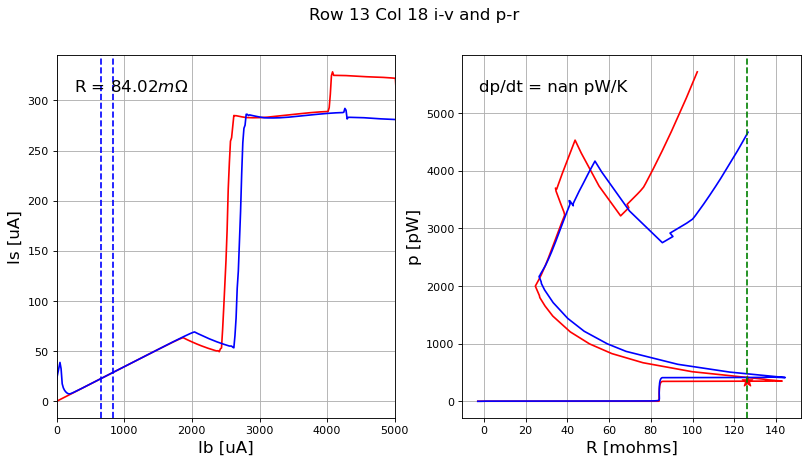

nan 0.08401761025751392
row 13, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


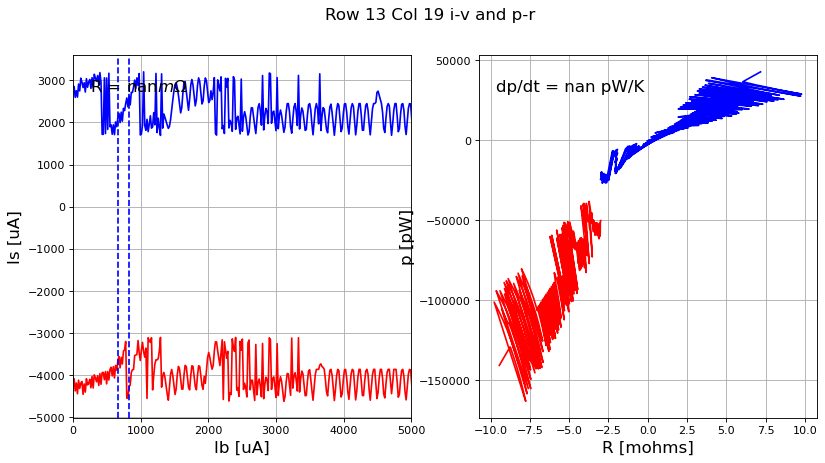

nan nan
row 13, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


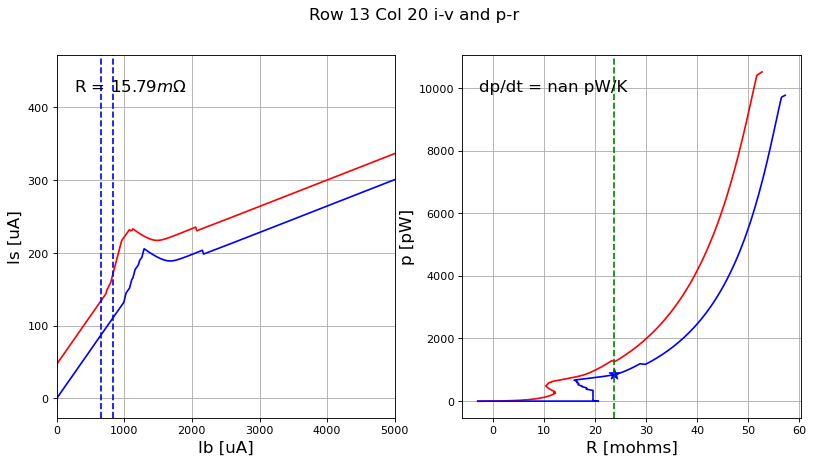

nan 0.0157851479532773
row 13, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


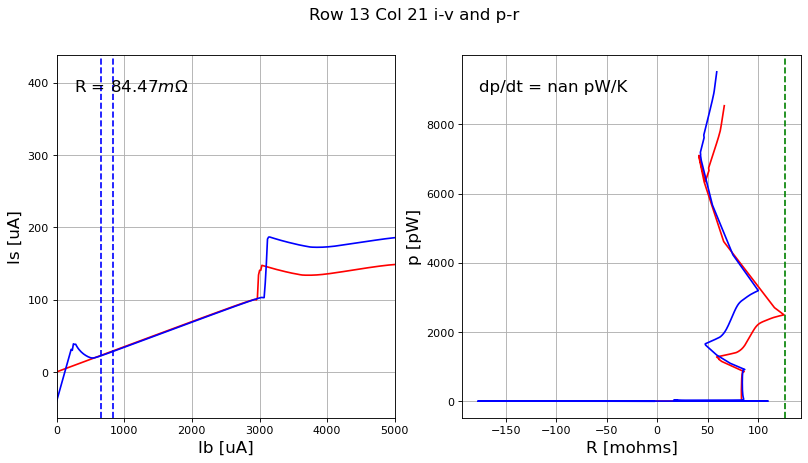

nan 0.0844698473037942
row 13, col 22


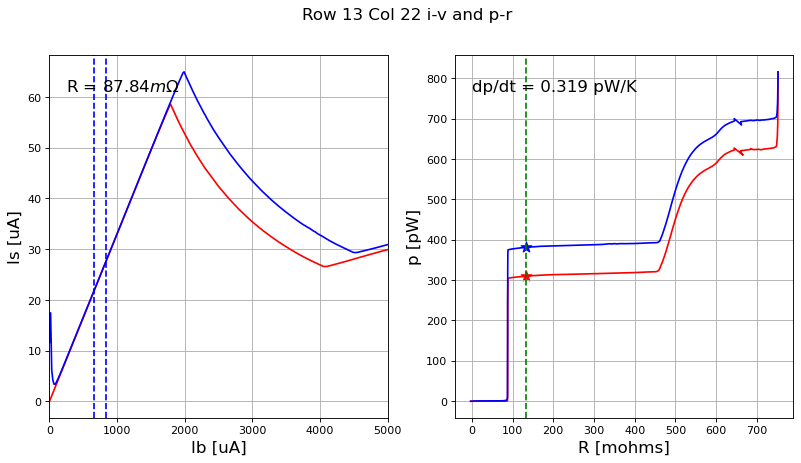

0.31930658586548766 0.08783801168202768
row 13, col 23


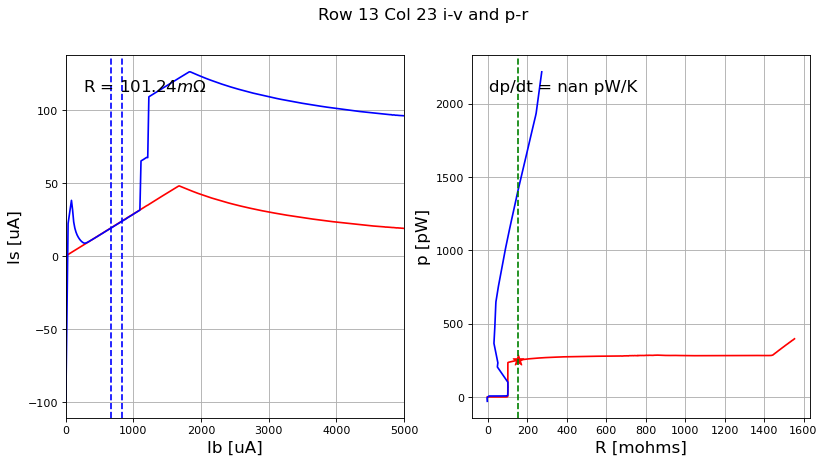

nan 0.10123586326823736
row 13, col 24


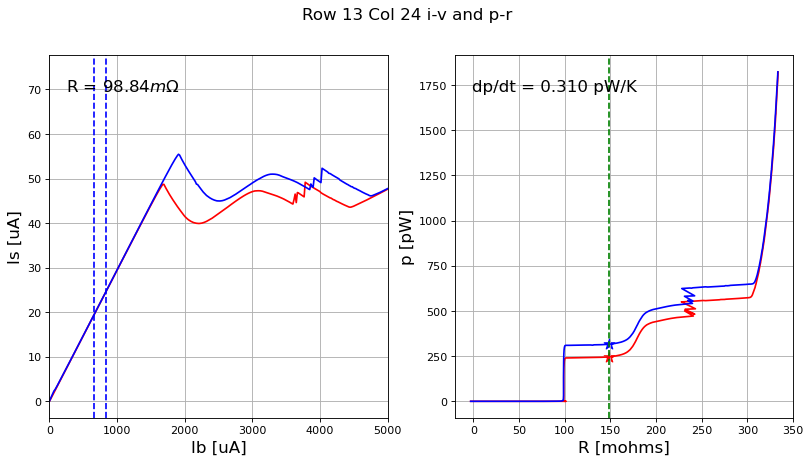

0.3104056247370368 0.098836183250023
row 13, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


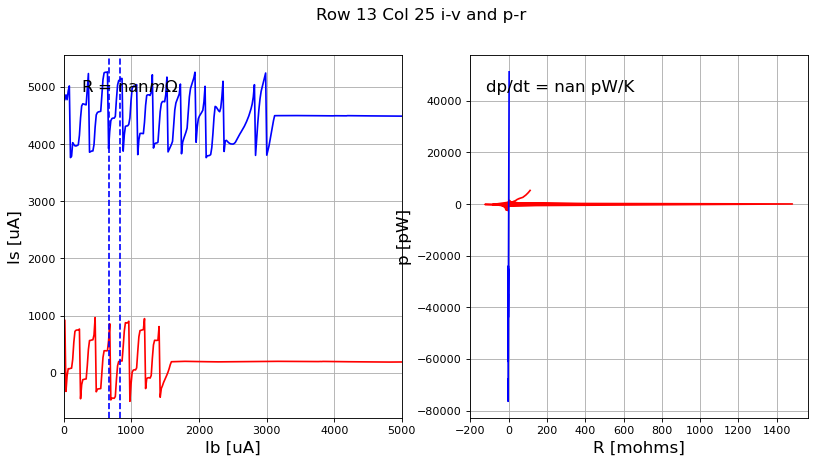

nan nan
row 13, col 26


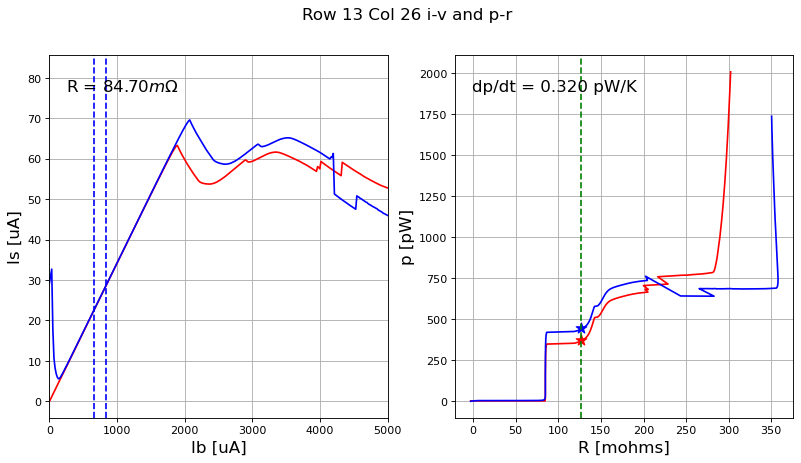

0.3202381601801004 0.08469905776491396
row 13, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


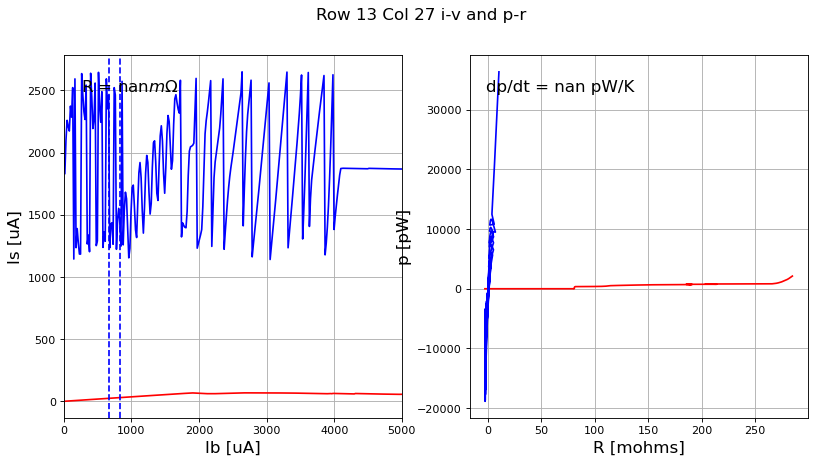

nan nan
row 13, col 28


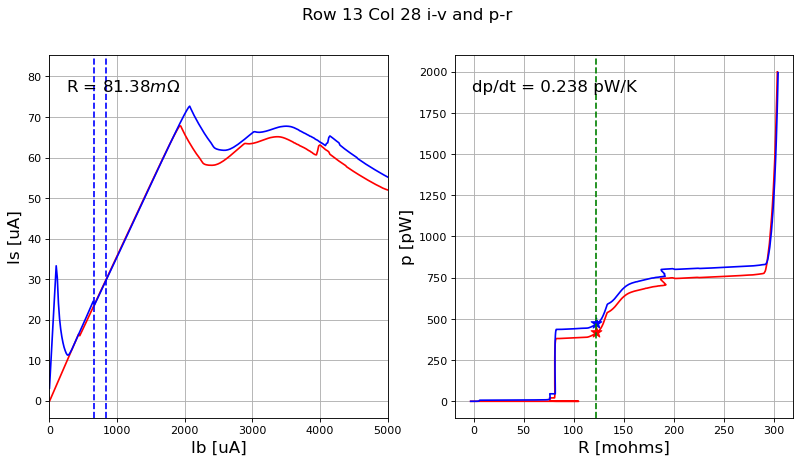

0.23760551789502218 0.08137849122571858
row 13, col 29


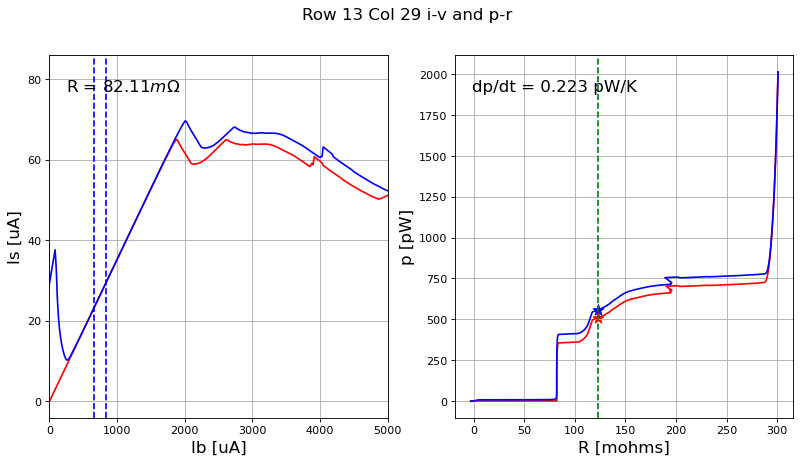

0.22296863339391362 0.0821124952958591
row 13, col 30


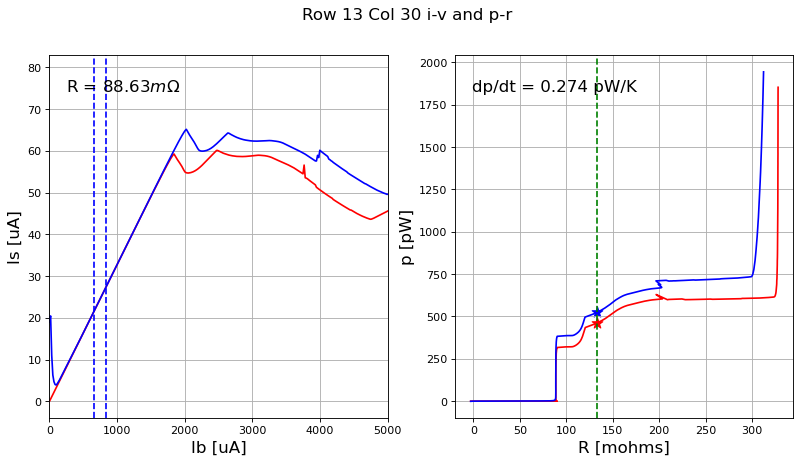

0.2743450327568138 0.08862557938847201
row 13, col 31


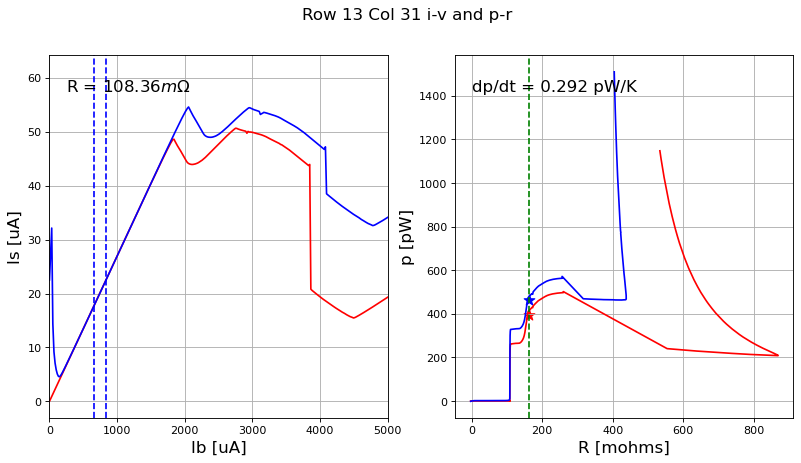

0.29229218367947724 0.10835589091283532
row 14, col 16


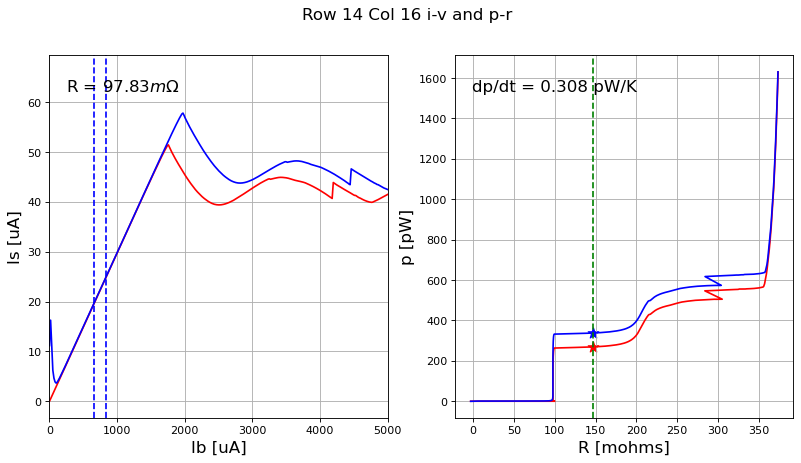

0.3084558654678426 0.09782551569161382
row 14, col 17


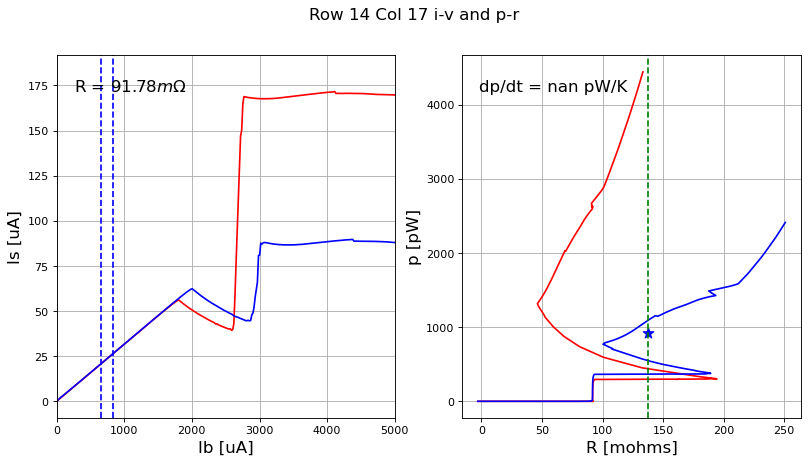

nan 0.09178416172568239
row 14, col 18


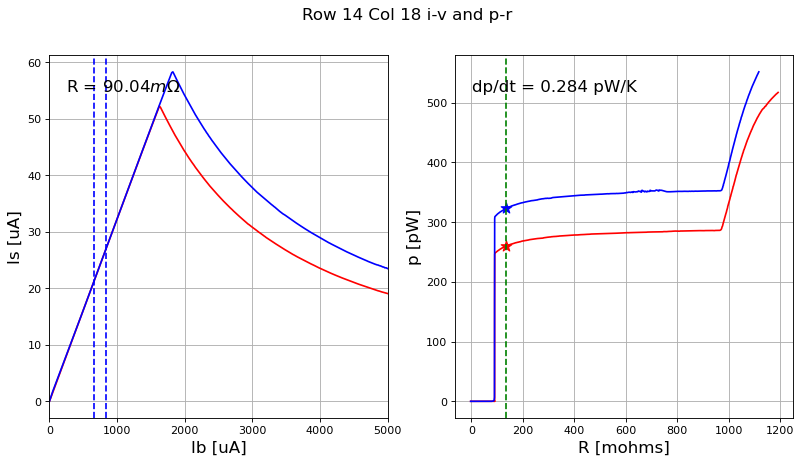

0.28363041358010826 0.09004272506720407
row 14, col 19


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


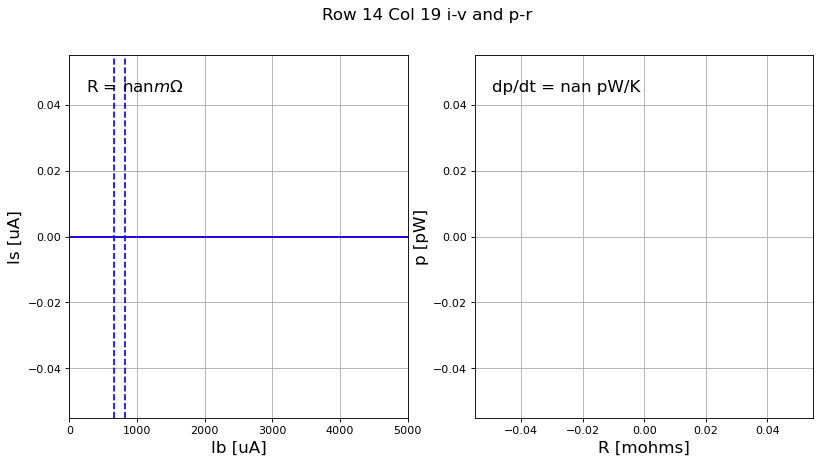

nan nan
row 14, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


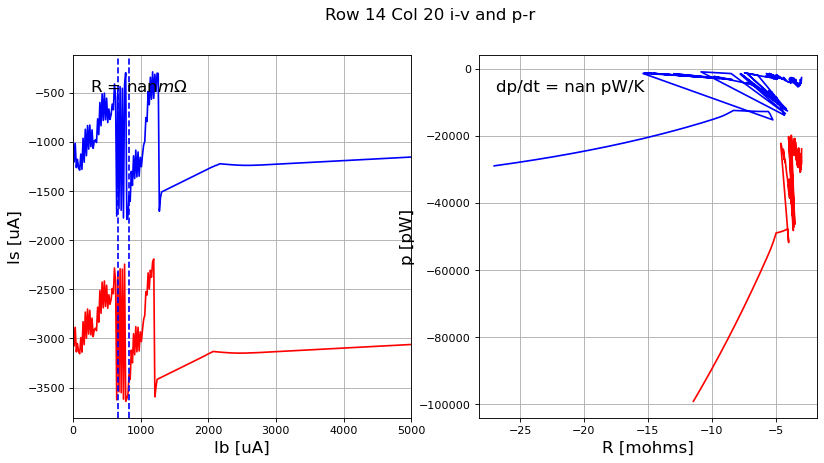

nan nan
row 14, col 21


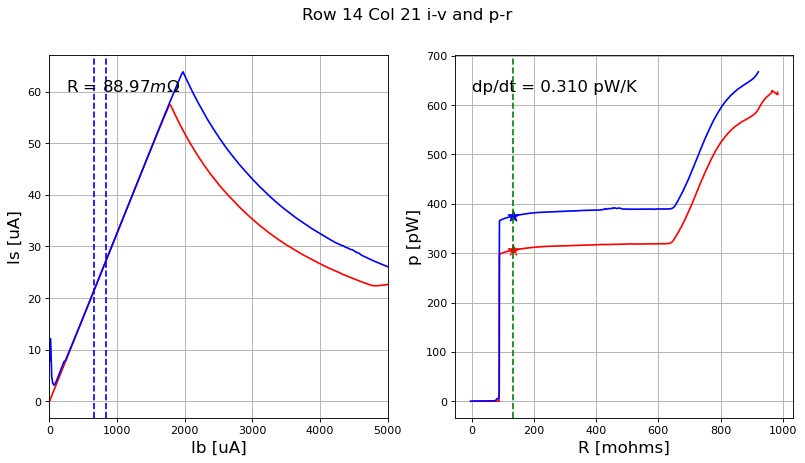

0.30986729636914745 0.08897286551562245
row 14, col 22


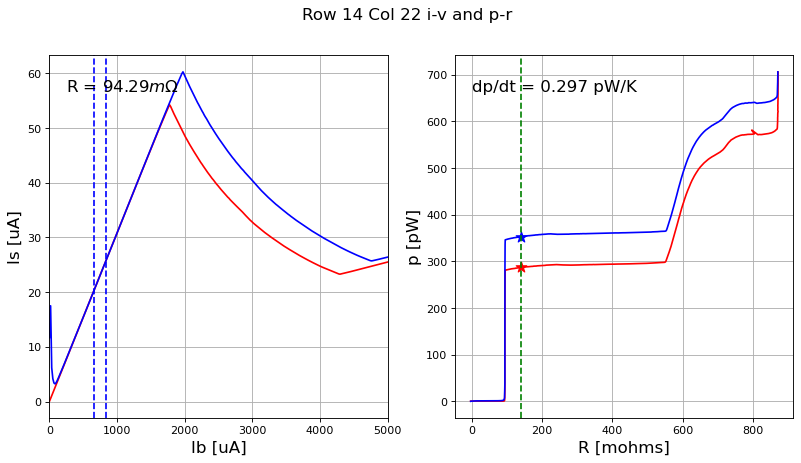

0.2966647314503651 0.0942914288268788
row 14, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


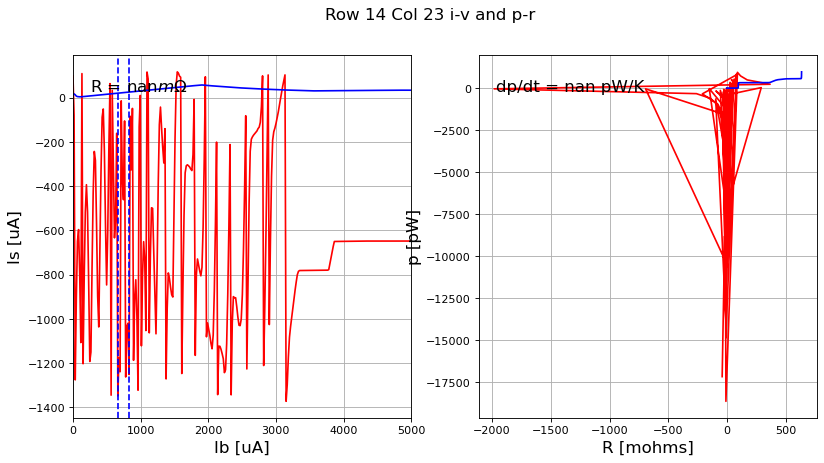

nan nan
row 14, col 24


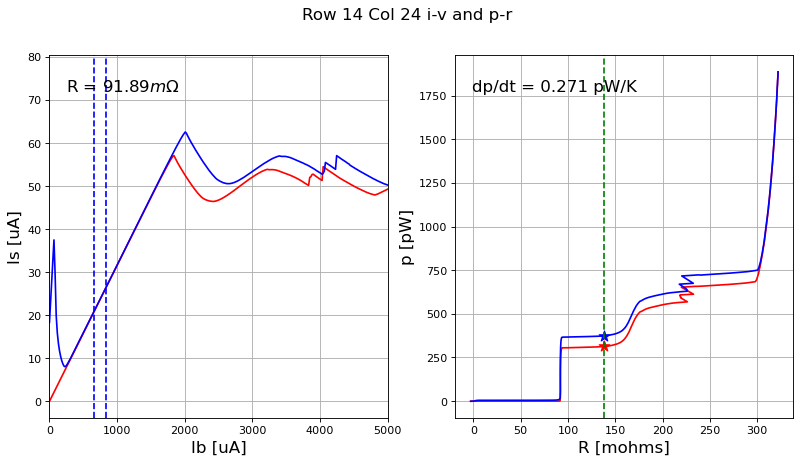

0.27090320320404176 0.09189240808657659
row 14, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


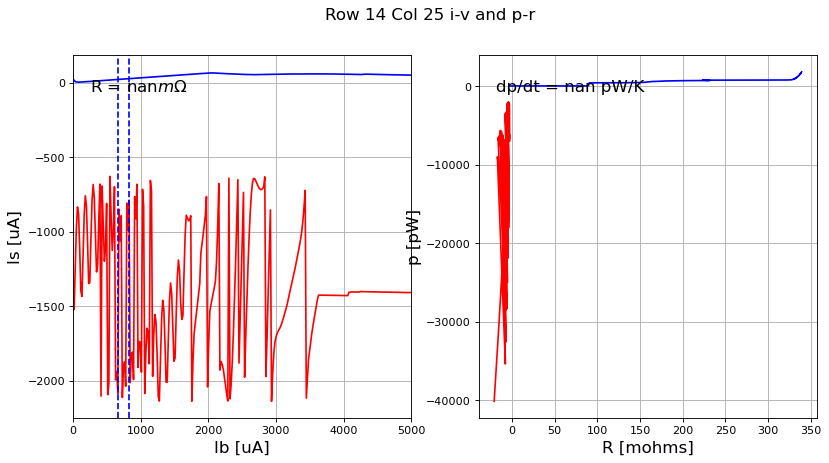

nan nan
row 14, col 26


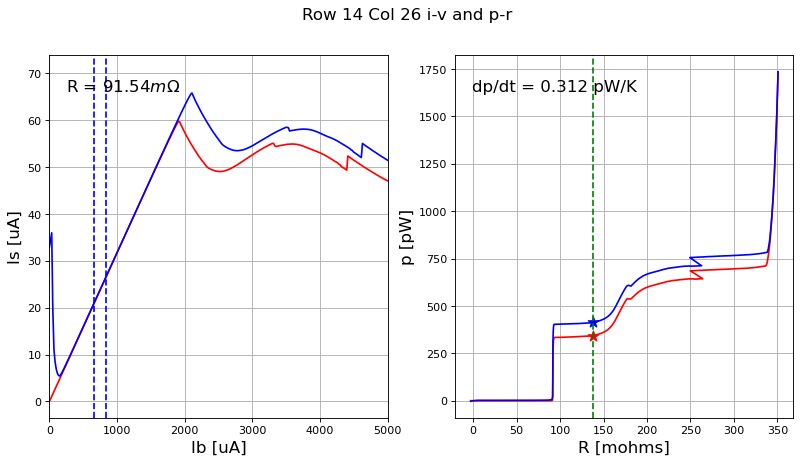

0.3120209444460734 0.09154377624215479
row 14, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


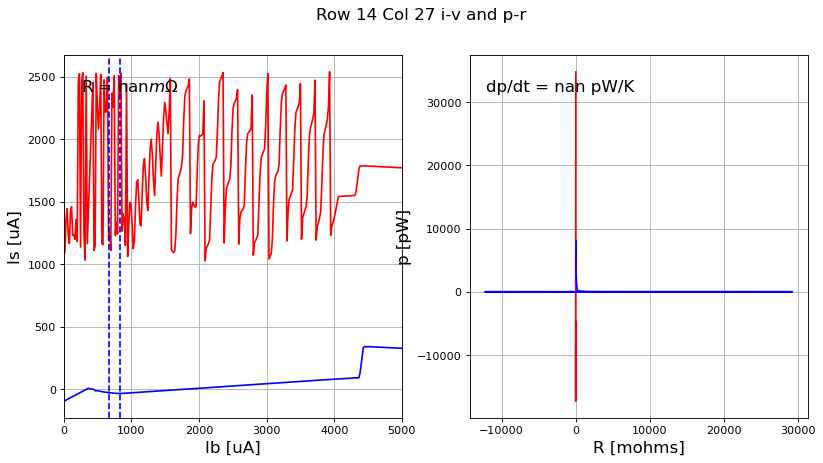

nan nan
row 14, col 28


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


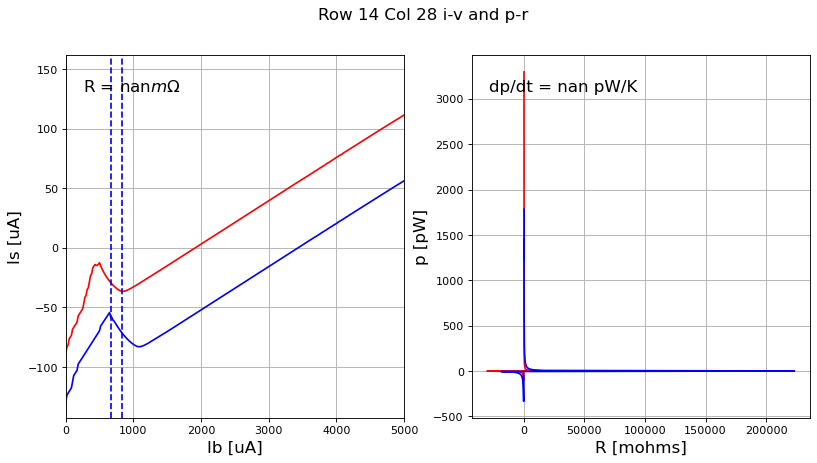

nan nan
row 14, col 29


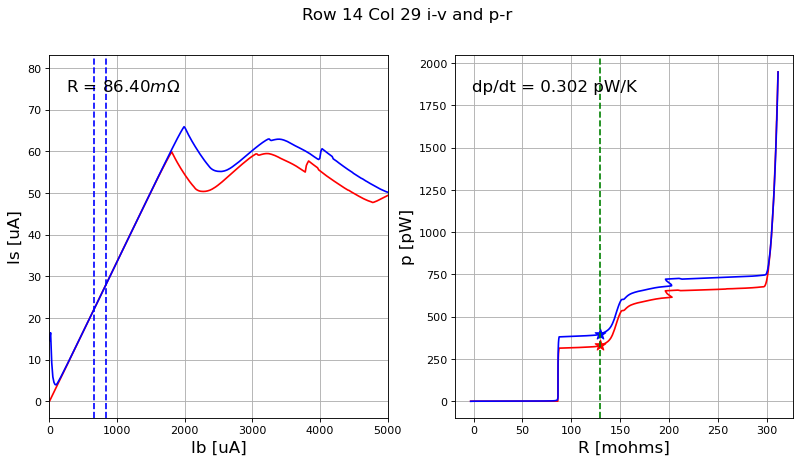

0.30150172842822337 0.08640073401916801
row 14, col 30


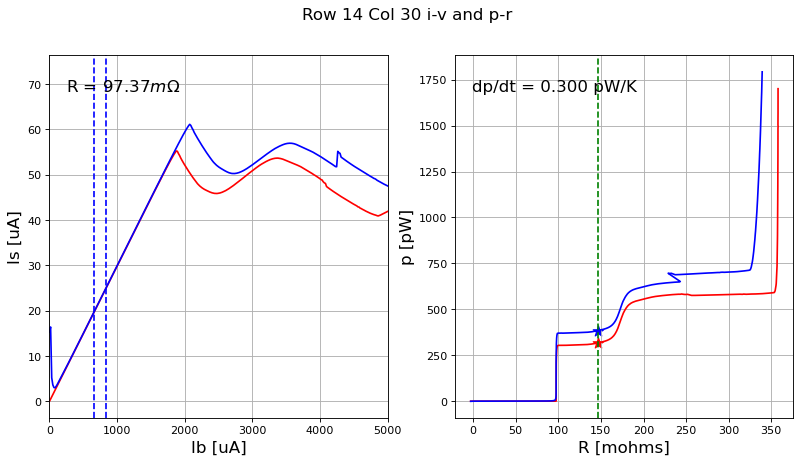

0.29993143217851137 0.09737296108549799
row 14, col 31


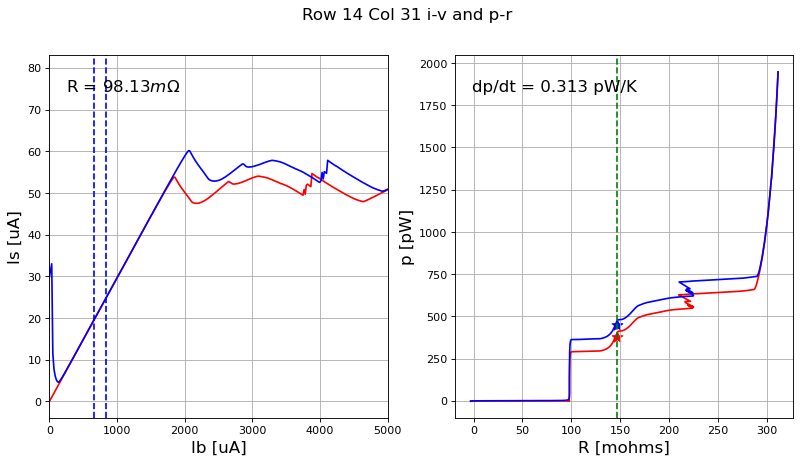

0.31327517685108563 0.09812875959066
row 15, col 16


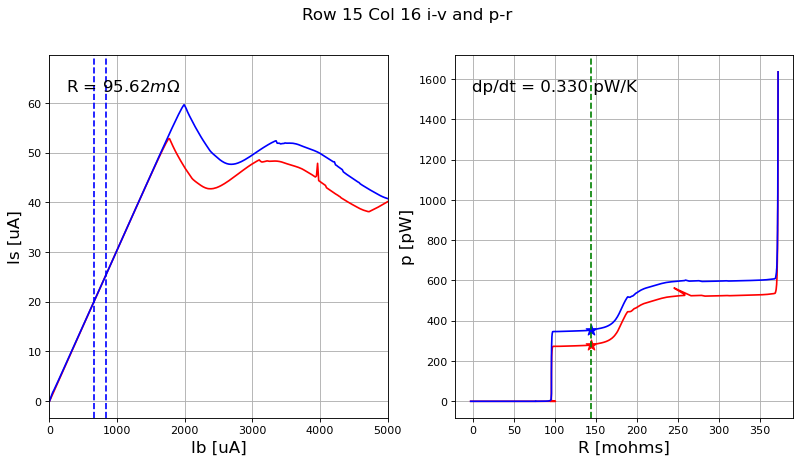

0.3299436896868118 0.09561553423229074
row 15, col 17


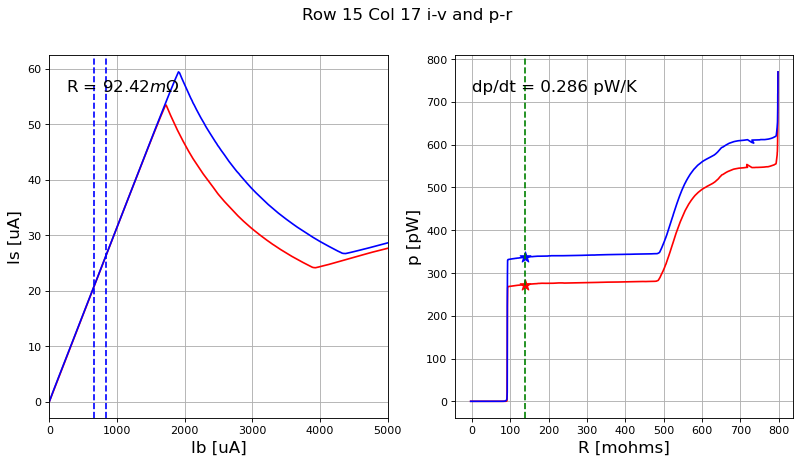

0.2863332219998852 0.09241657850279718
row 15, col 18


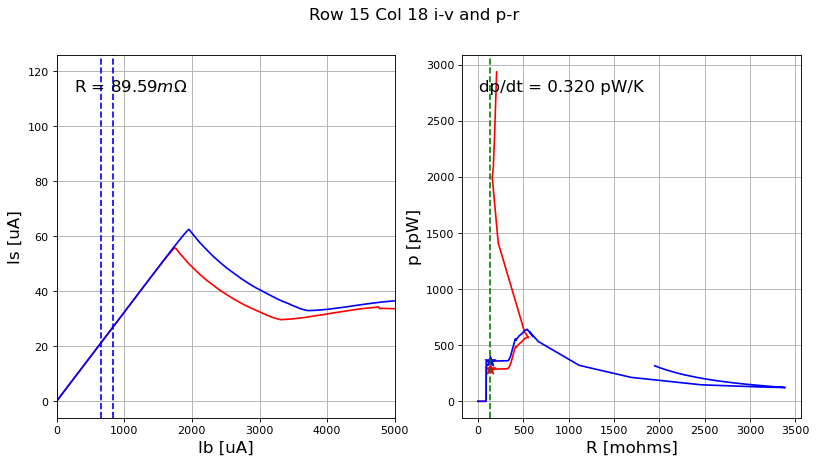

0.31965138161281886 0.08959117019687218
row 15, col 19


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


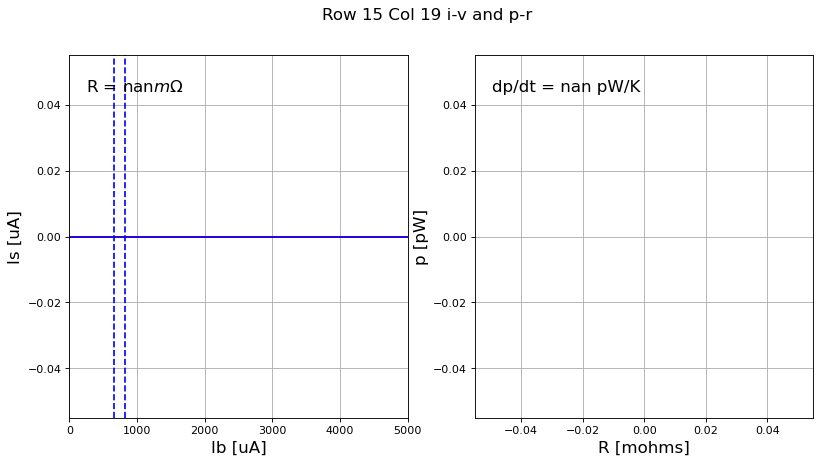

nan nan
row 15, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


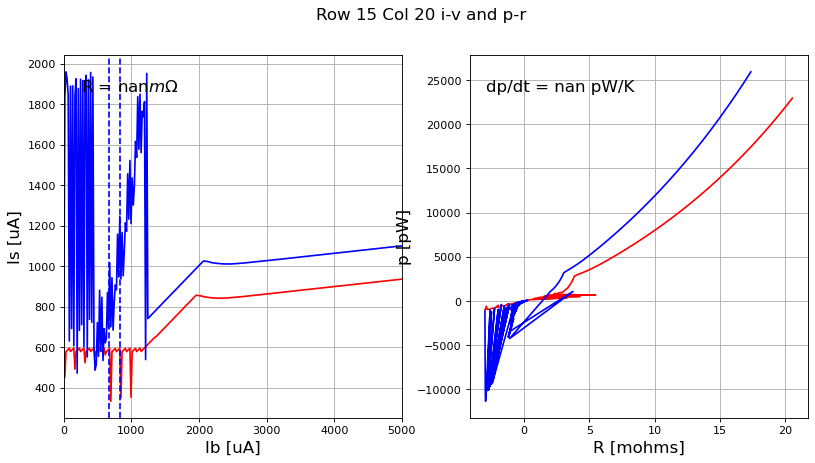

nan nan
row 15, col 21


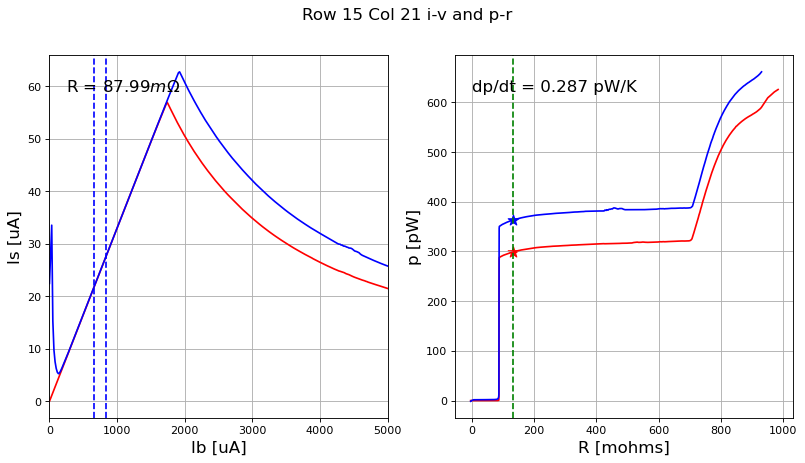

0.28739629587669496 0.08799072175865519
row 15, col 22


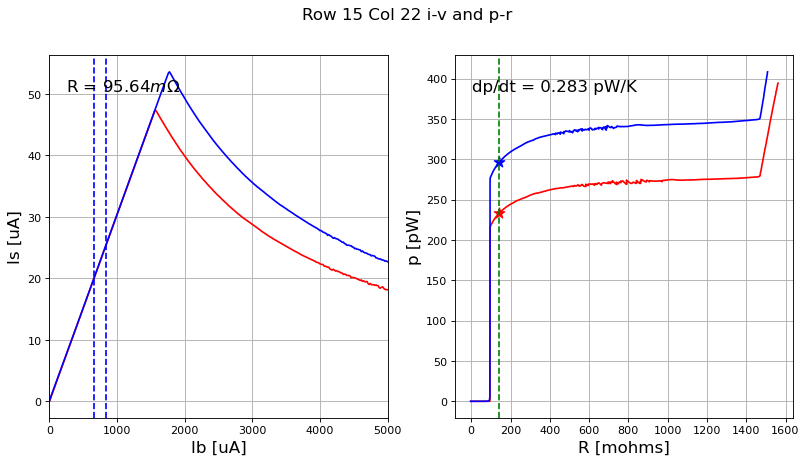

0.28273620773011704 0.09563740744254856
row 15, col 23


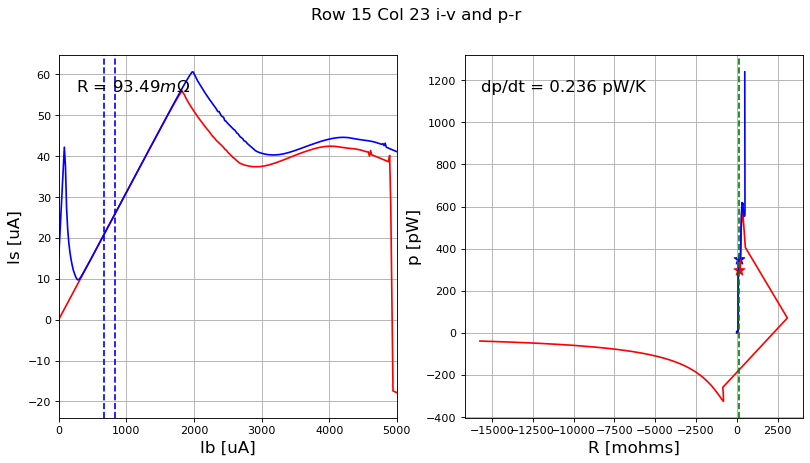

0.2361619884741818 0.09349013870376416
row 15, col 24


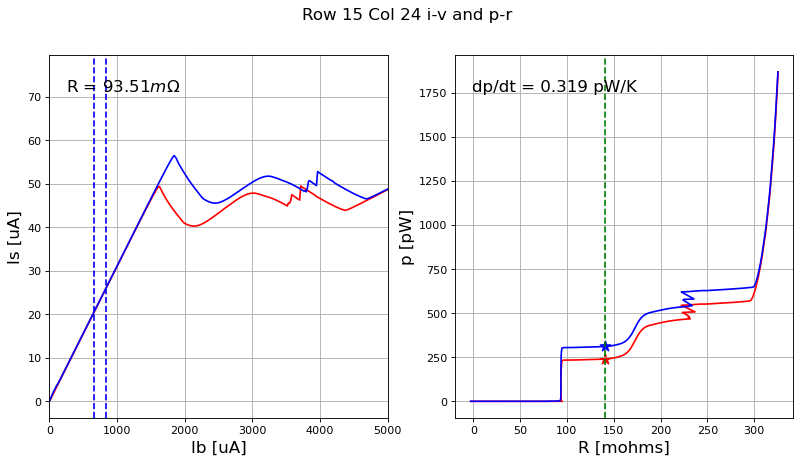

0.3188102135586525 0.09351068793364806
row 15, col 25


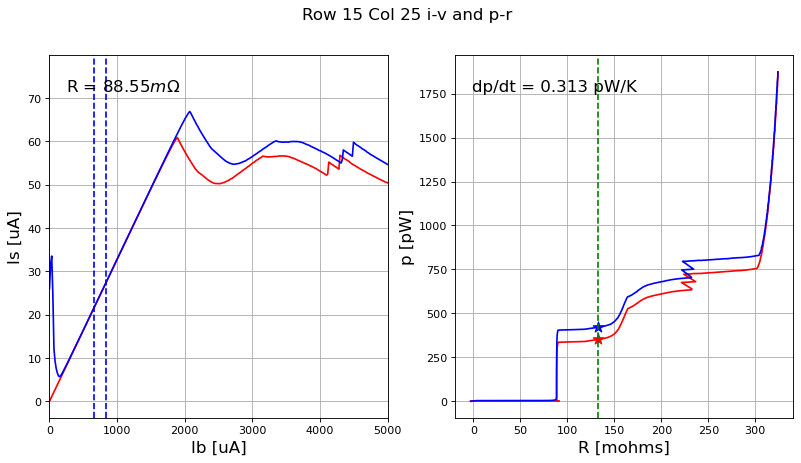

0.31327230576682336 0.08854876163265019
row 15, col 26


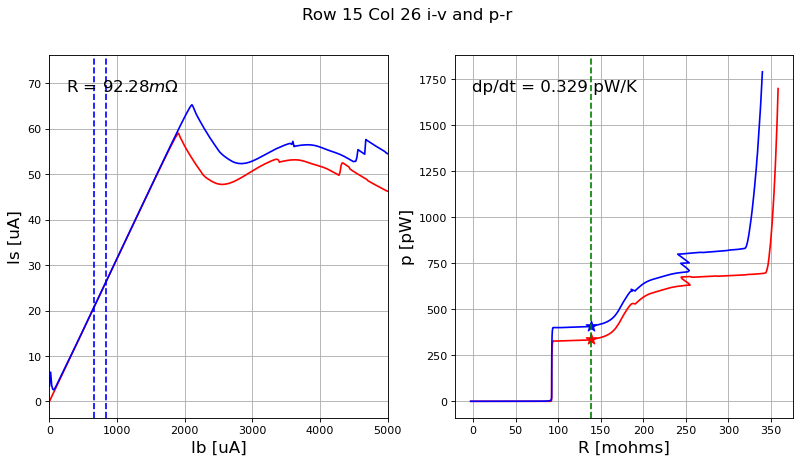

0.3286634421813047 0.09228495219637844
row 15, col 27


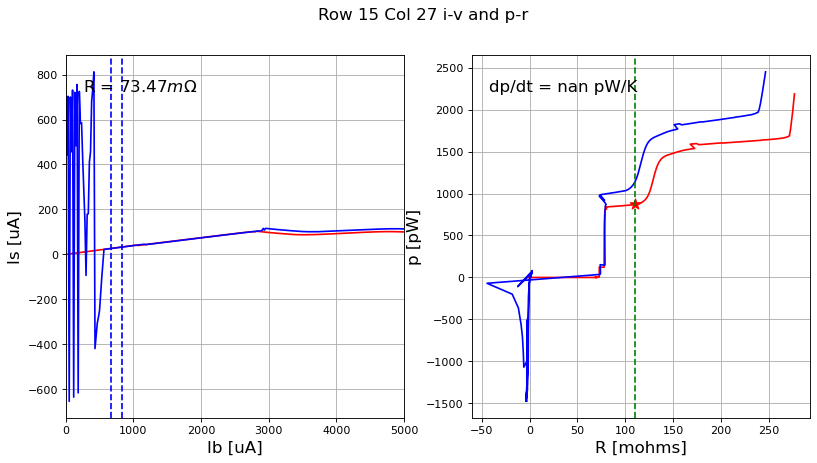

nan 0.07346567335156515
row 15, col 28


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


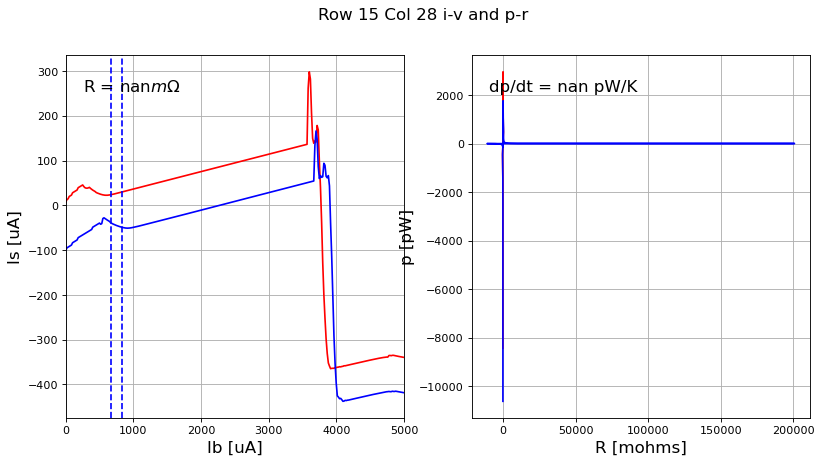

nan nan
row 15, col 29


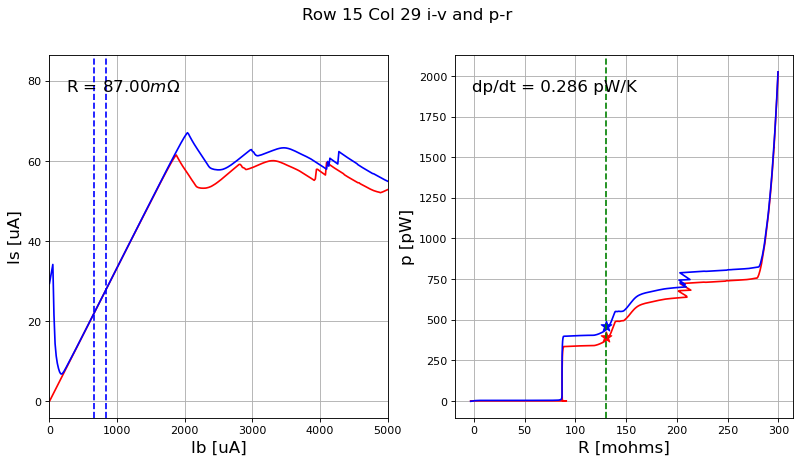

0.28592750542691264 0.08699739678079227
row 15, col 30


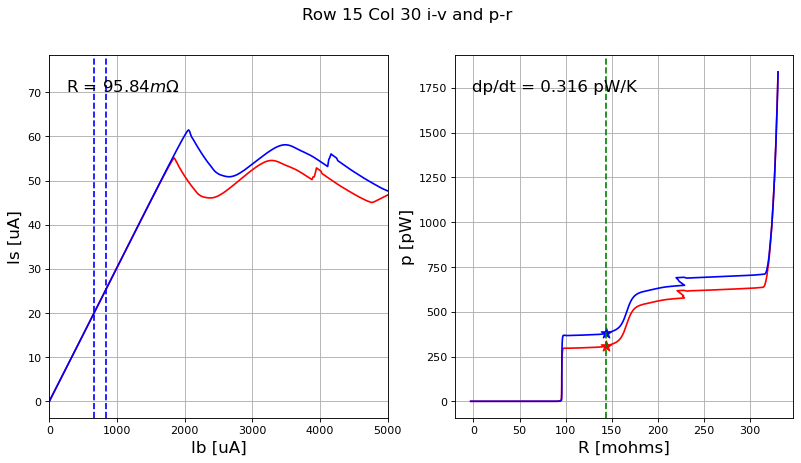

0.31565260444194443 0.09583563578274634
row 15, col 31


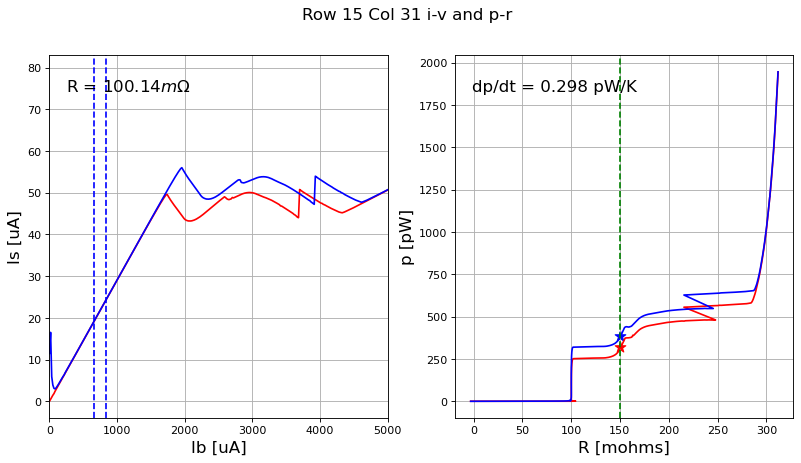

0.29789483179782594 0.10014217325667037
row 16, col 16


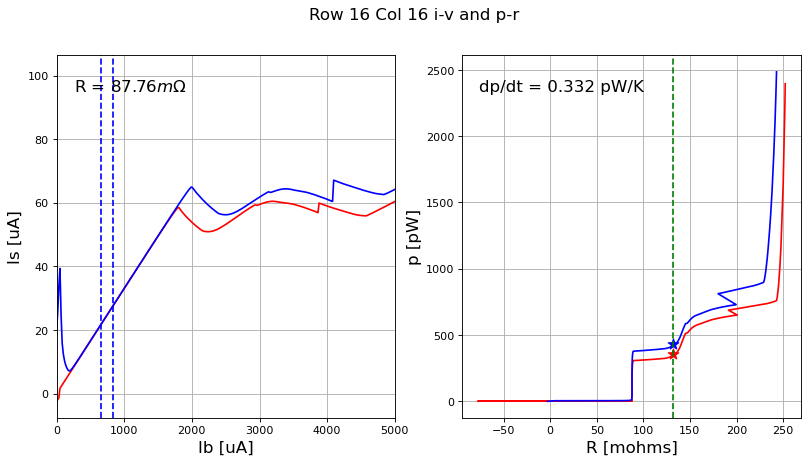

0.3321027720426917 0.08775911781018234
row 16, col 17


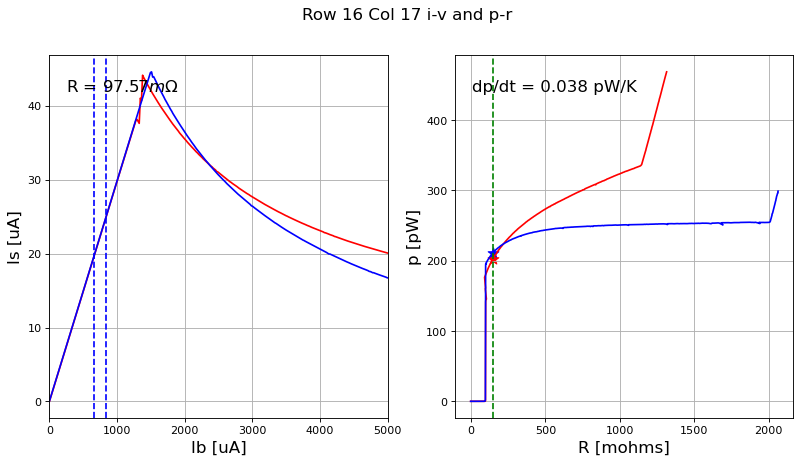

0.03774438519983281 0.09757189100957445
row 16, col 18


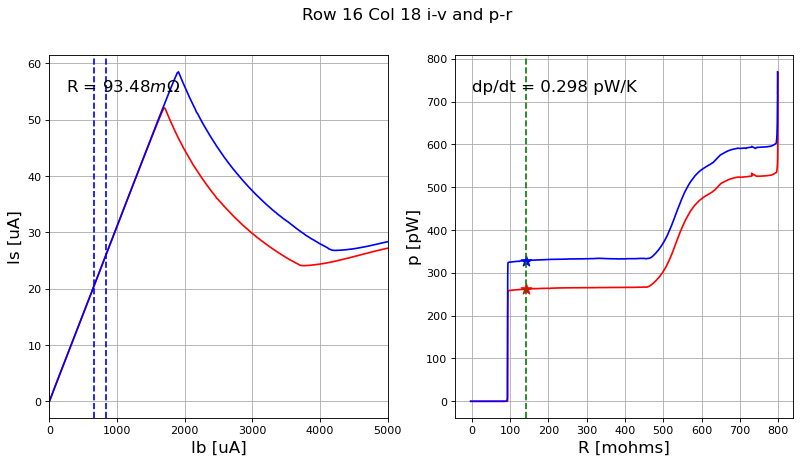

0.298355366139457 0.09348107252829269
row 16, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


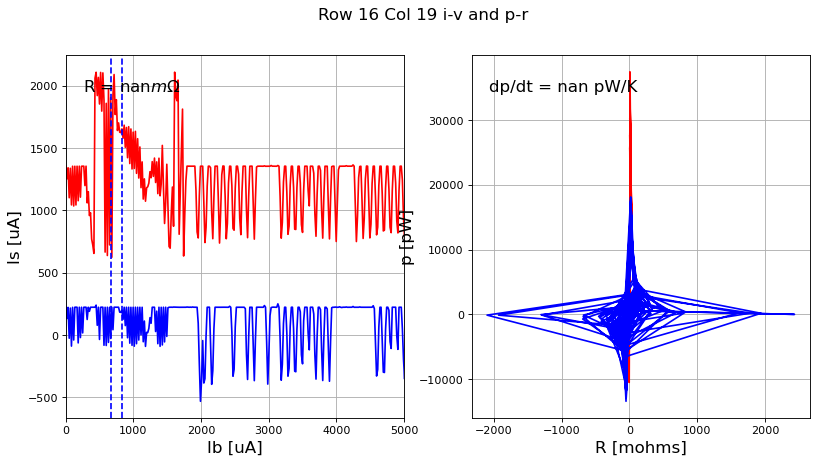

nan nan
row 16, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


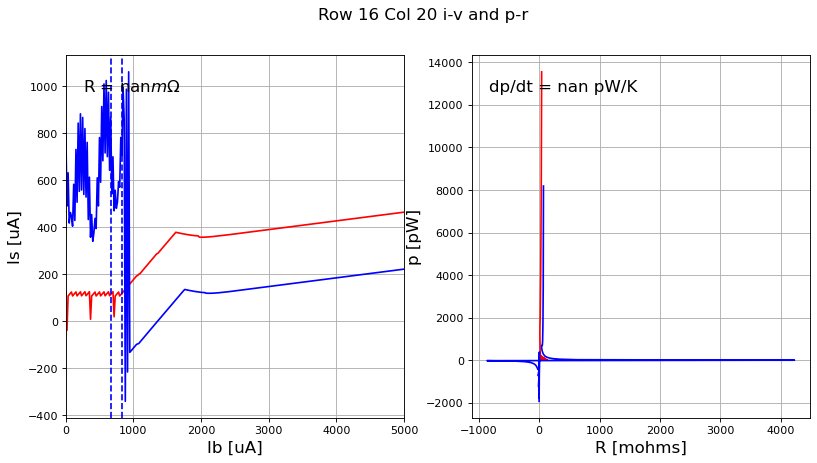

nan nan
row 16, col 21


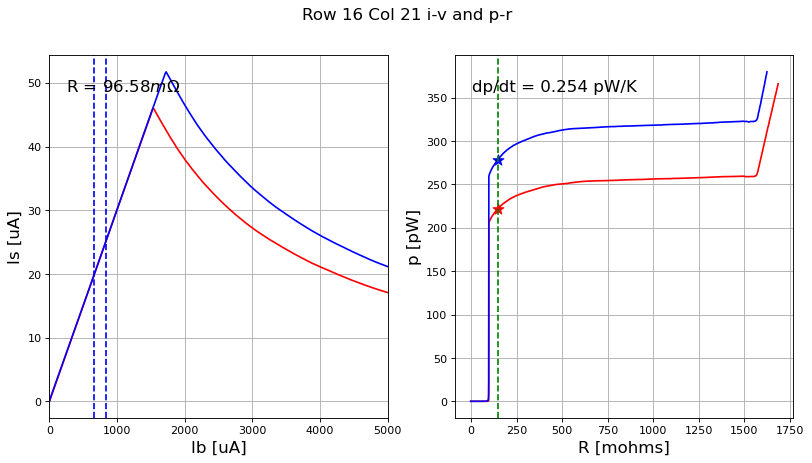

0.2537080461047365 0.09658290668750952
row 16, col 22


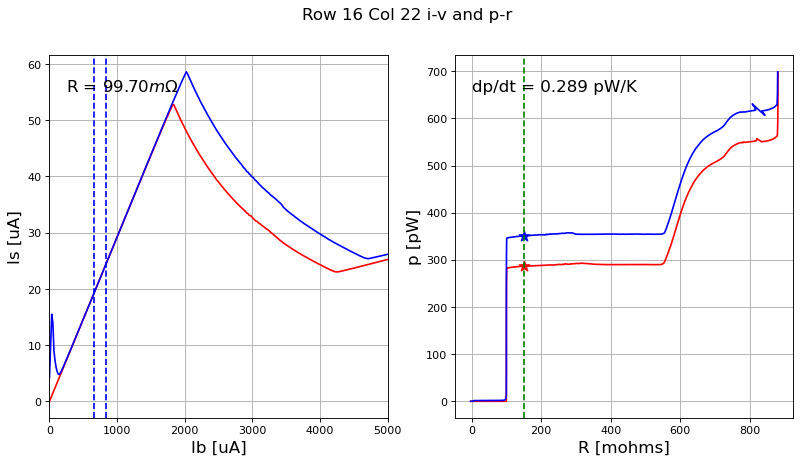

0.2885527958165155 0.09969705774789353
row 16, col 23


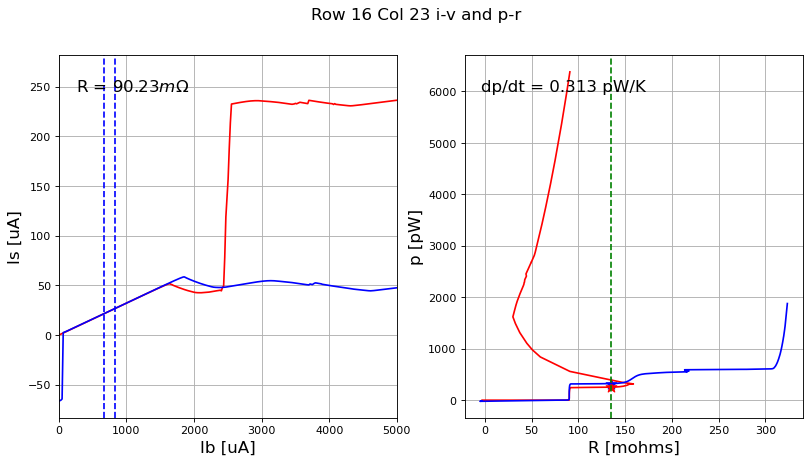

0.3128570214851672 0.09022945068289029
row 16, col 24


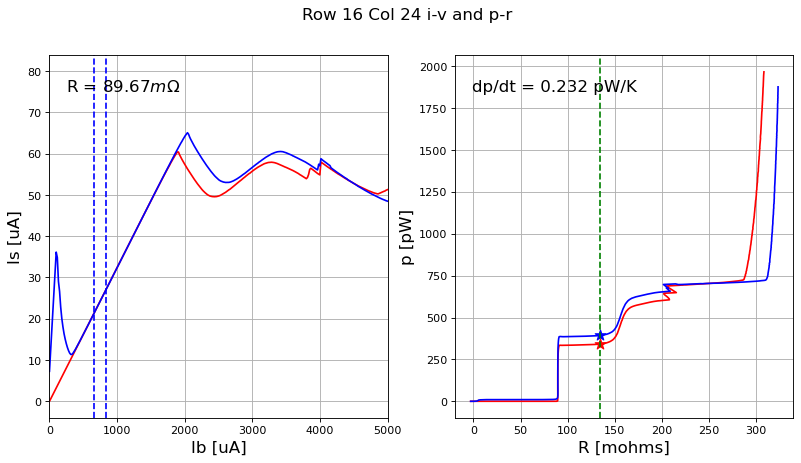

0.23216497407333636 0.08967148948610179
row 16, col 25


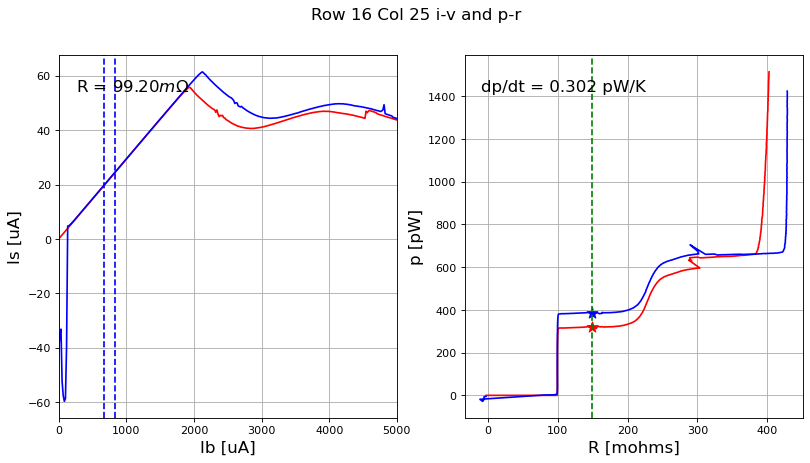

0.3023650716592519 0.09920207842735351
row 16, col 26


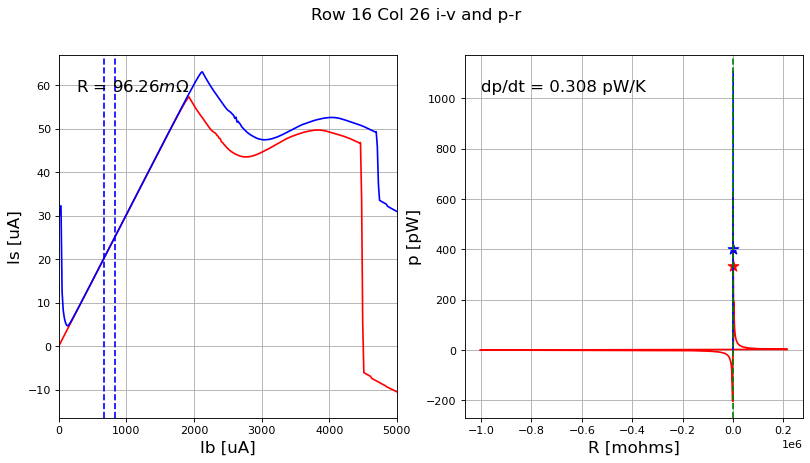

0.3084557897881341 0.09626109503330772
row 16, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


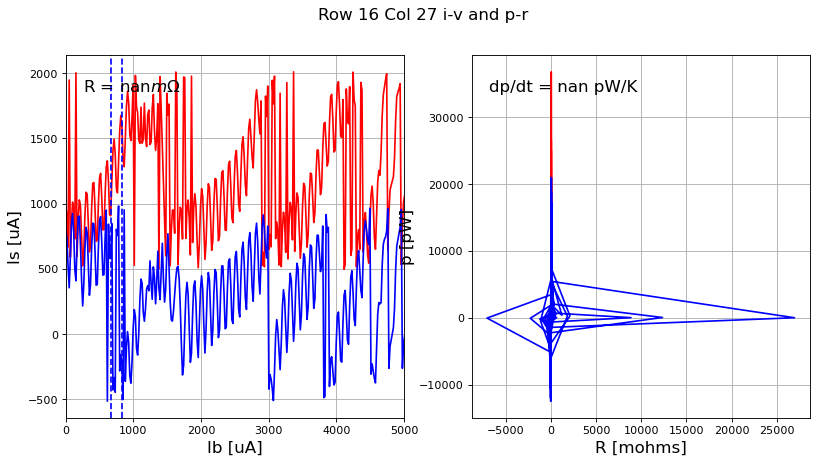

nan nan
row 16, col 28


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


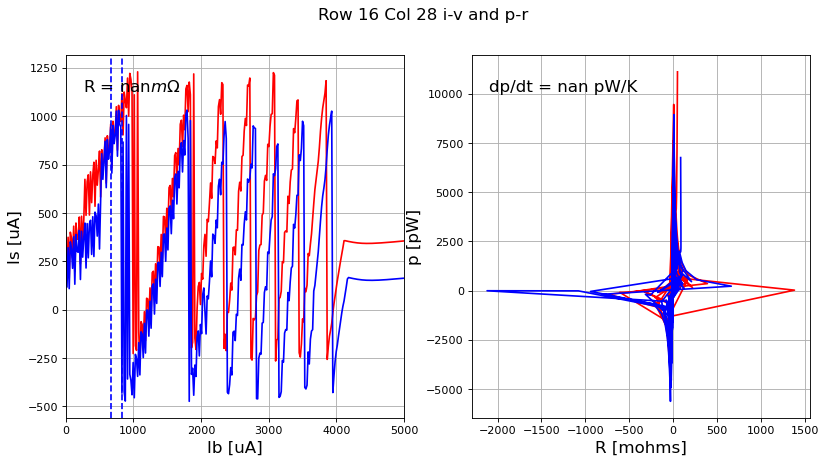

nan nan
row 16, col 29


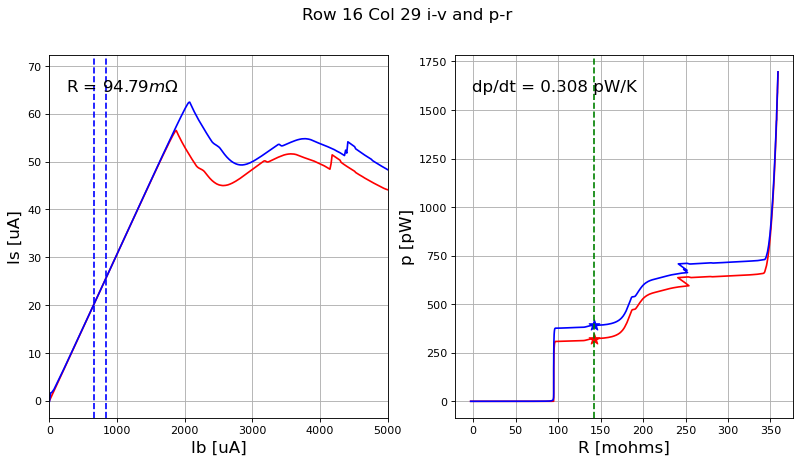

0.3077705413188183 0.09478953107524189
row 16, col 30


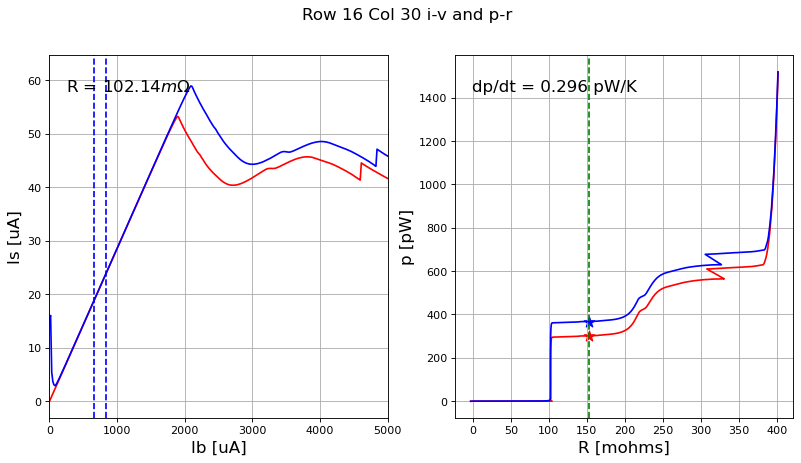

0.2959350322579586 0.10213921539639845
row 16, col 31


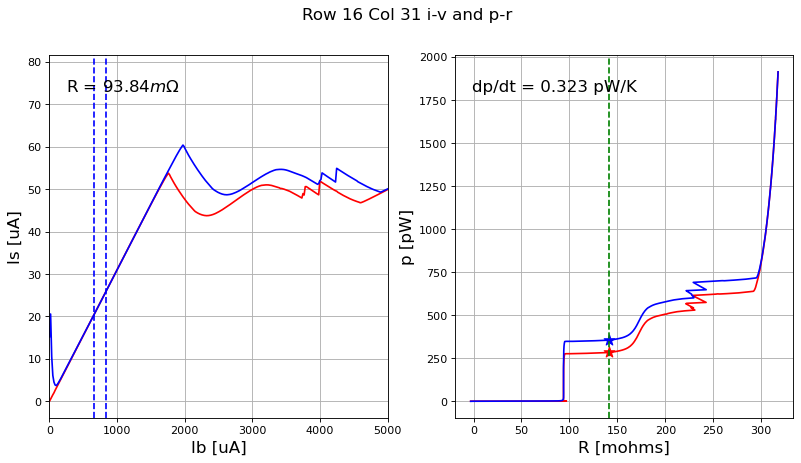

0.323482356768611 0.0938420727403721
row 17, col 16


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


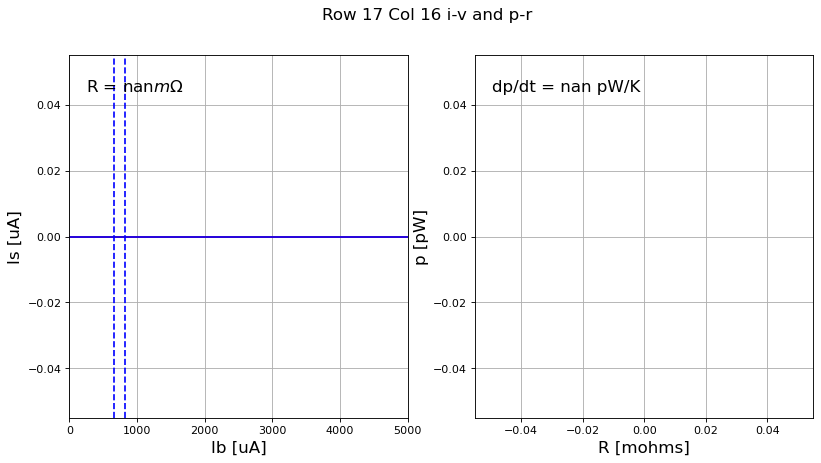

nan nan
row 17, col 17


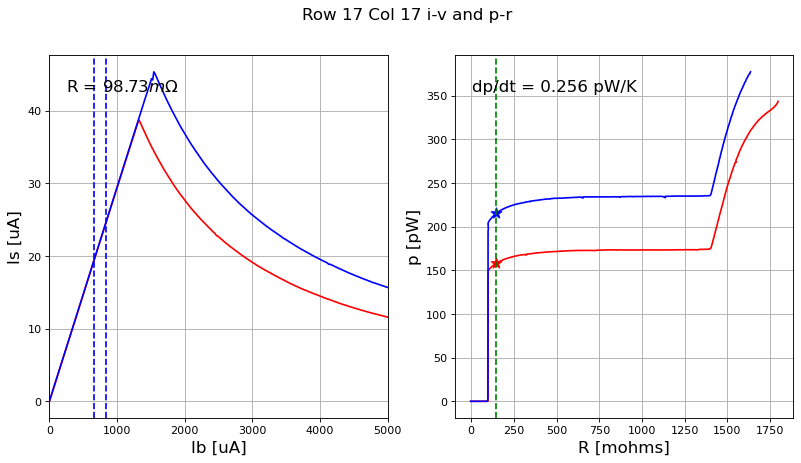

0.256007874664064 0.09872521471473225
row 17, col 18


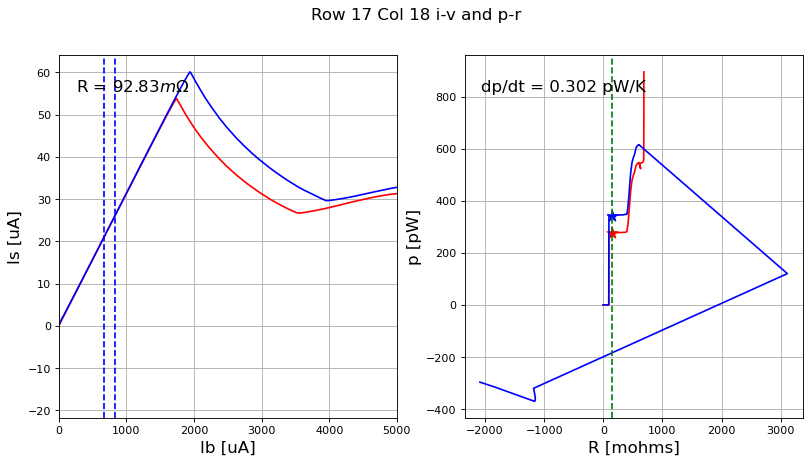

0.3019758513141667 0.09282657725901608
row 17, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


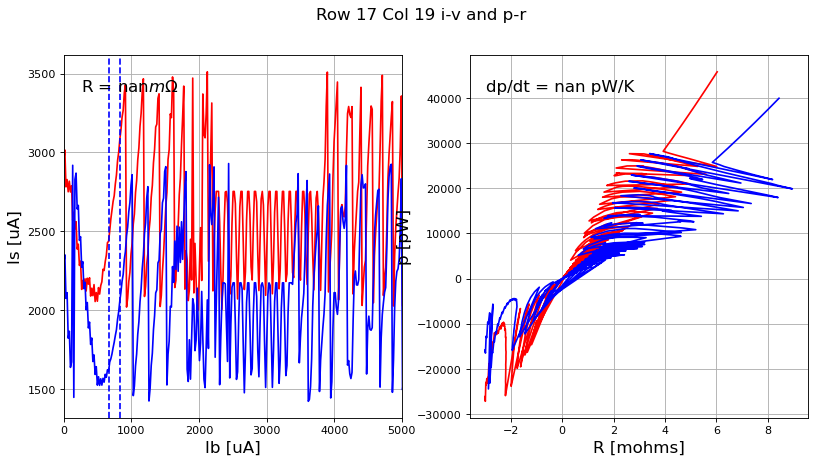

nan nan
row 17, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


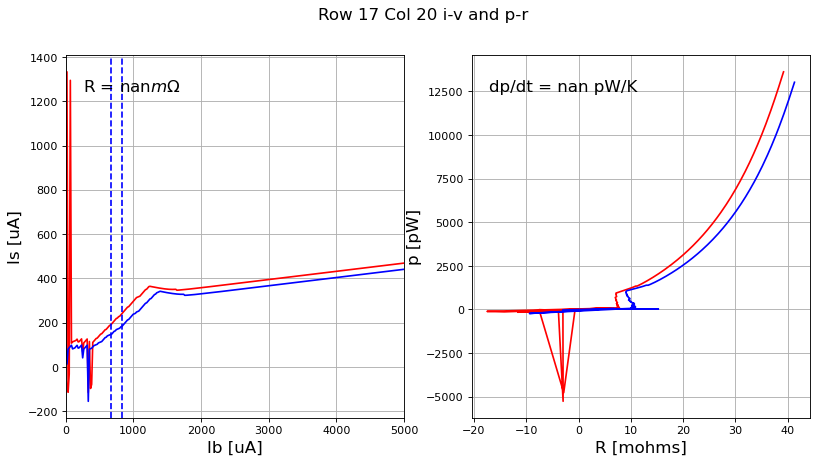

nan nan
row 17, col 21


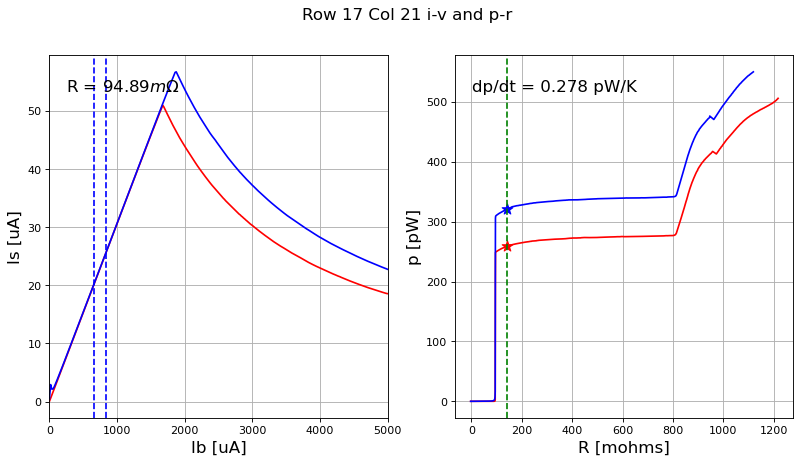

0.27764213956842554 0.09489227571206885
row 17, col 22
#####################
22 17


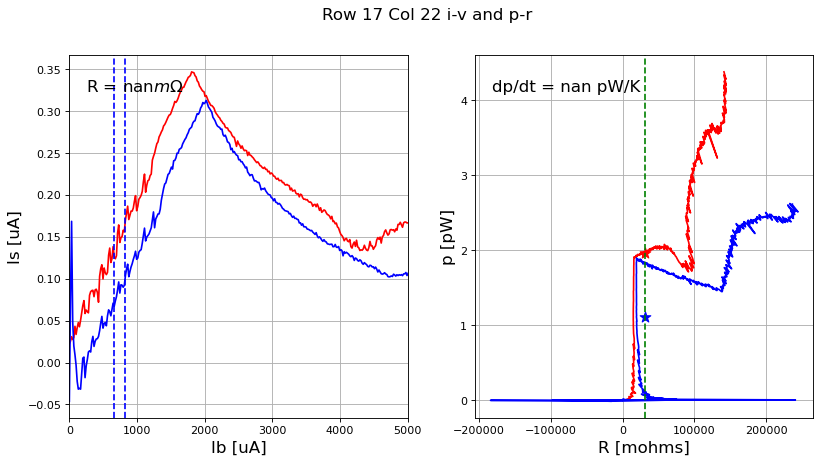

nan nan
row 17, col 23


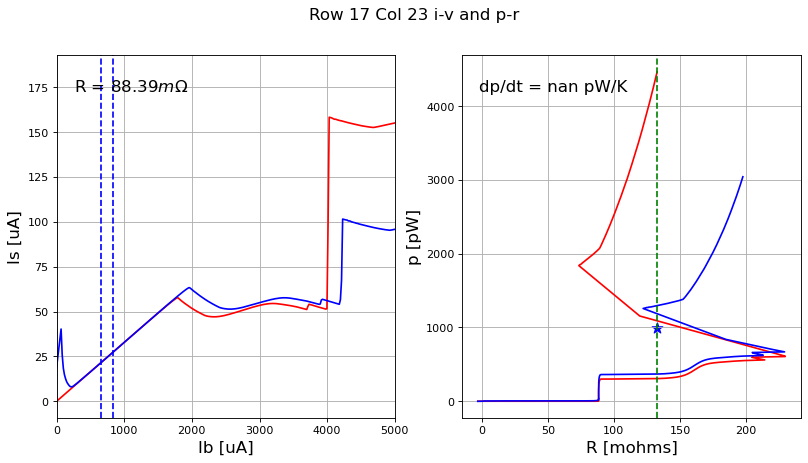

nan 0.08838719697862356
row 17, col 24


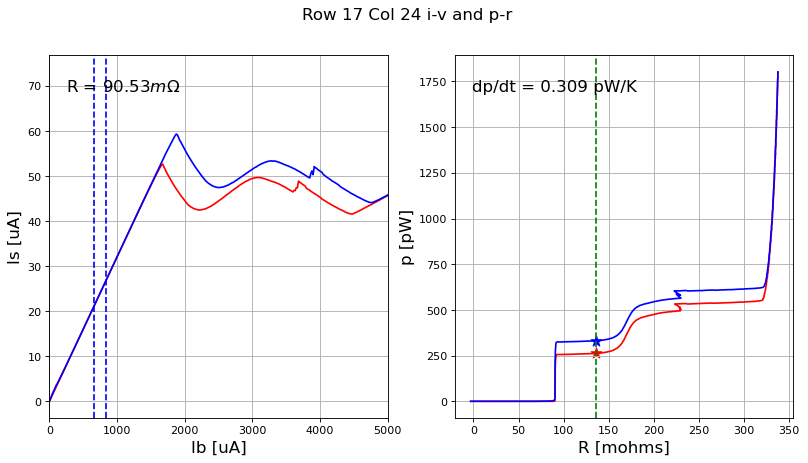

0.3087603836049176 0.09053180713893705
row 17, col 25


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


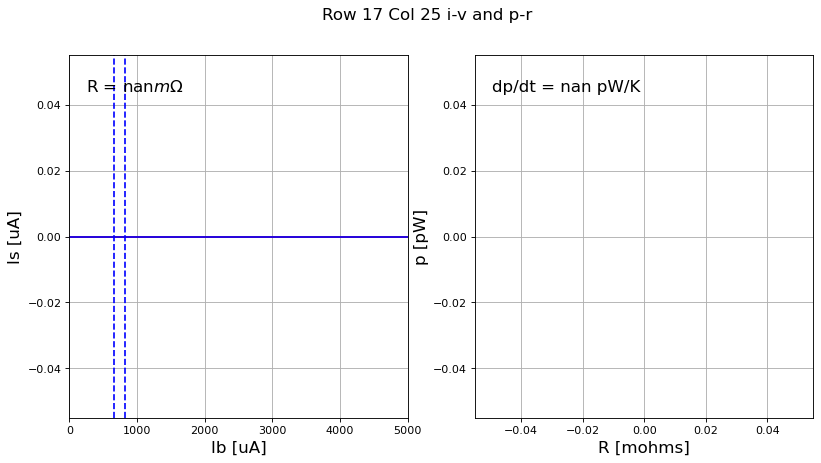

nan nan
row 17, col 26


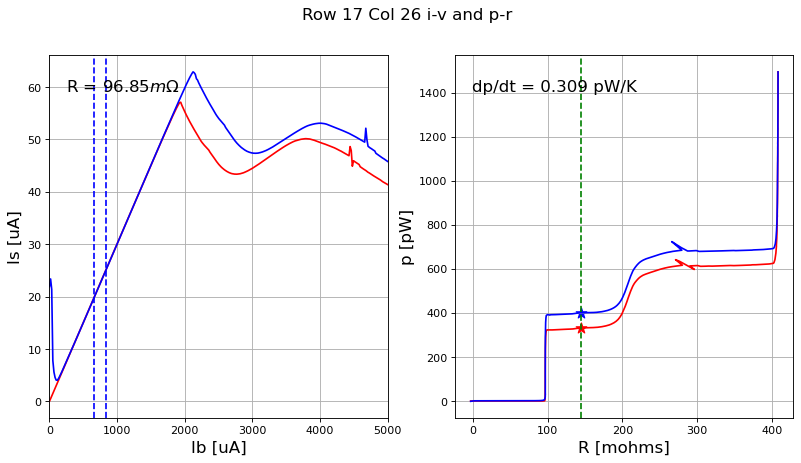

0.30865082069061317 0.09684843855930607
row 17, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


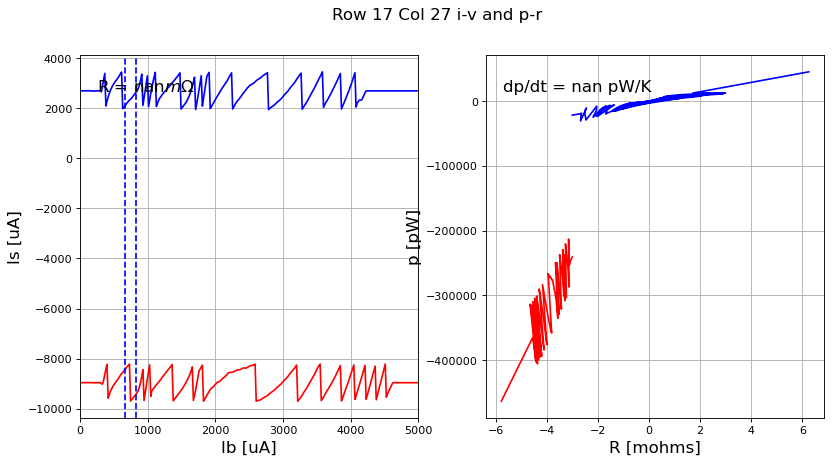

nan nan
row 17, col 28


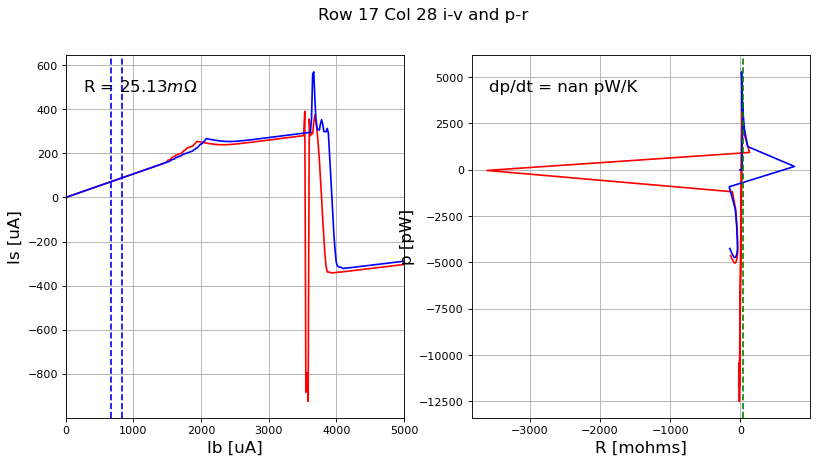

nan 0.025129677247397408
row 17, col 29
#####################
29 17


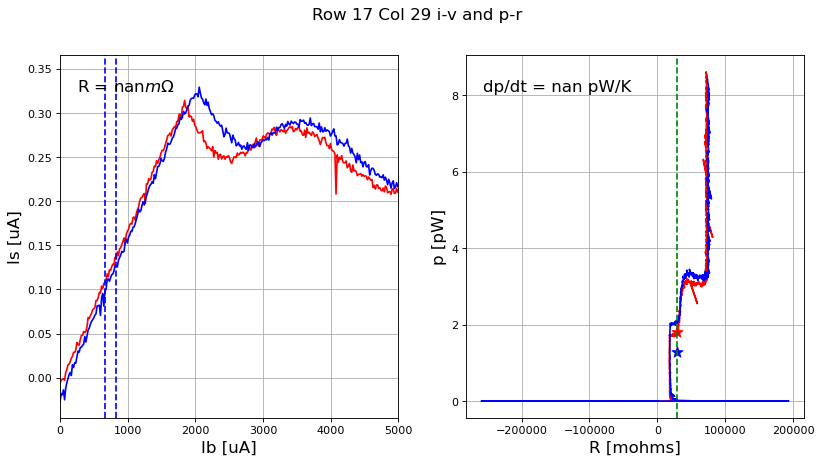

nan nan
row 17, col 30


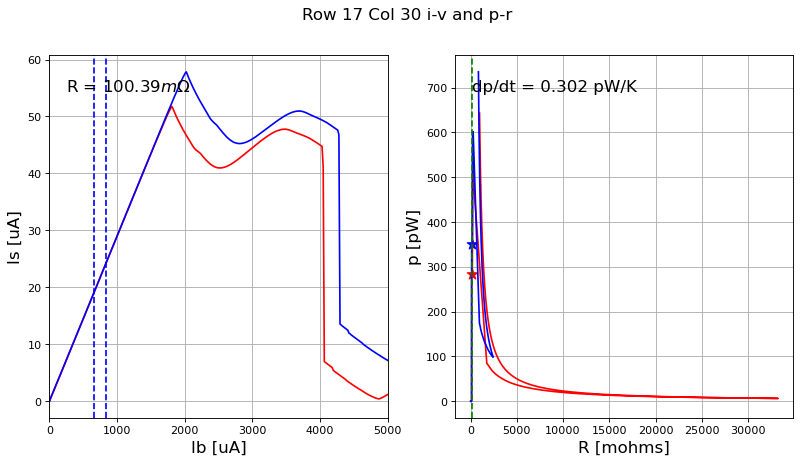

0.30241815069440015 0.10038784324959521
row 17, col 31


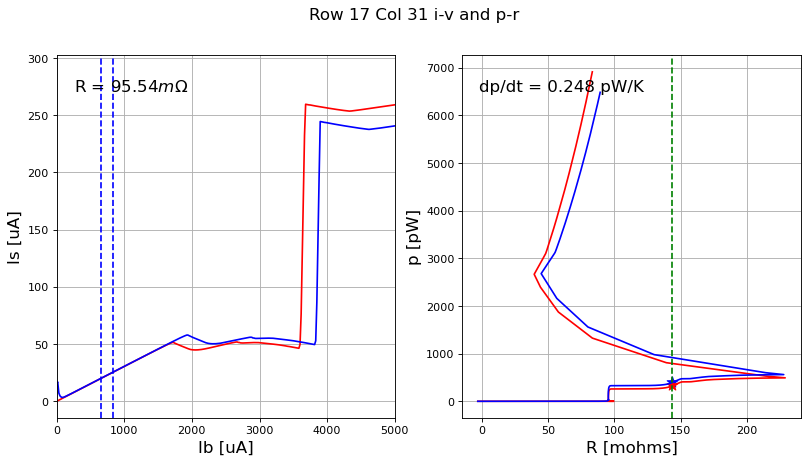

0.24838873757202237 0.09554405723705758
row 18, col 16


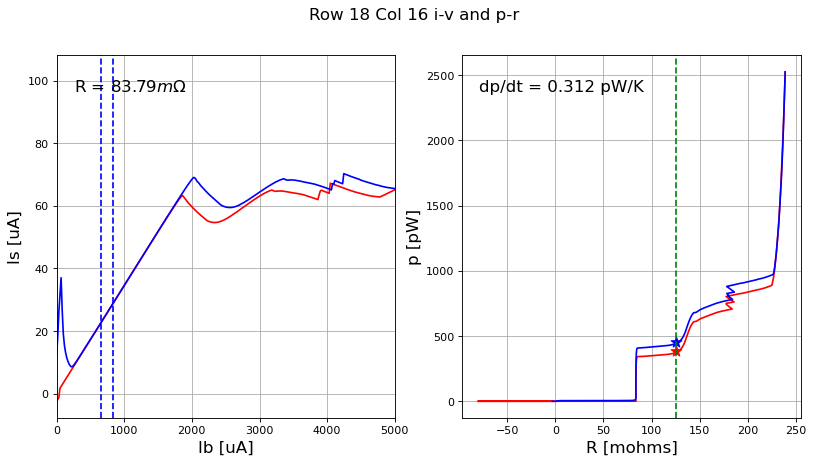

0.3118570213532275 0.08379214704520627
row 18, col 17


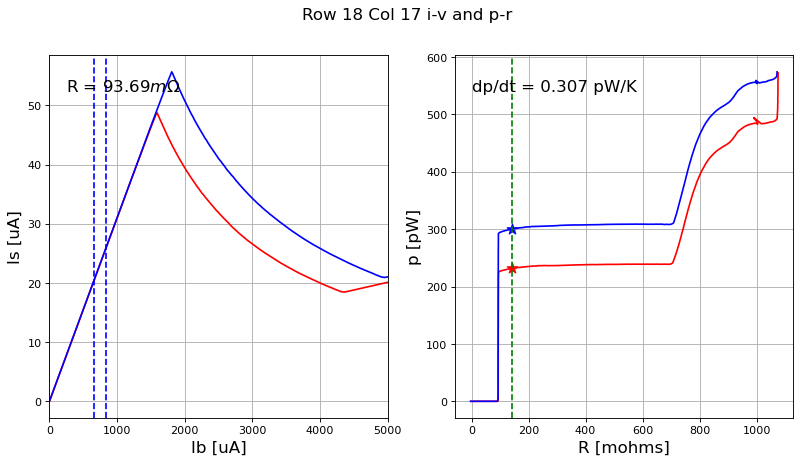

0.3069317829976257 0.09368896376837105
row 18, col 18


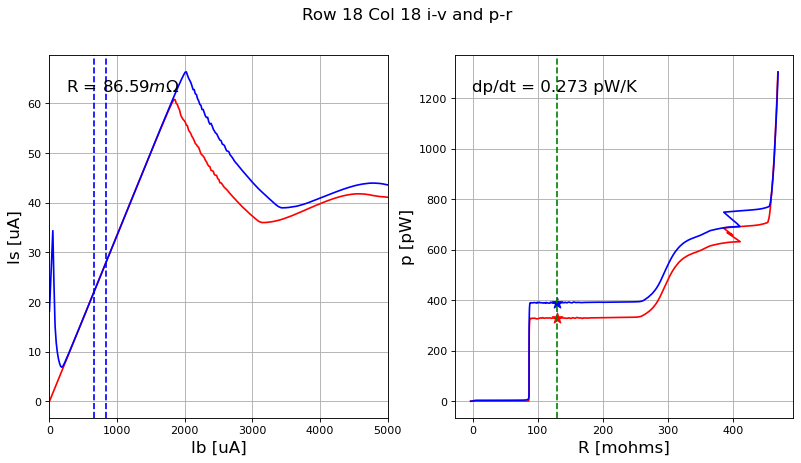

0.27318195413065577 0.0865924326414052
row 18, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


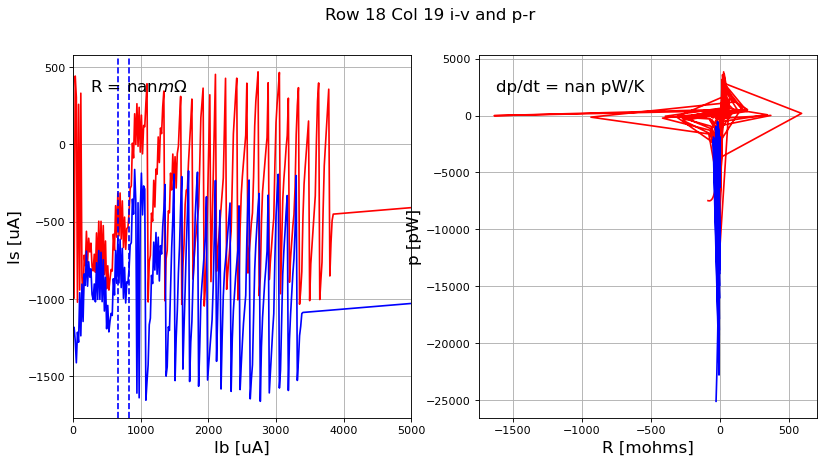

nan nan
row 18, col 20


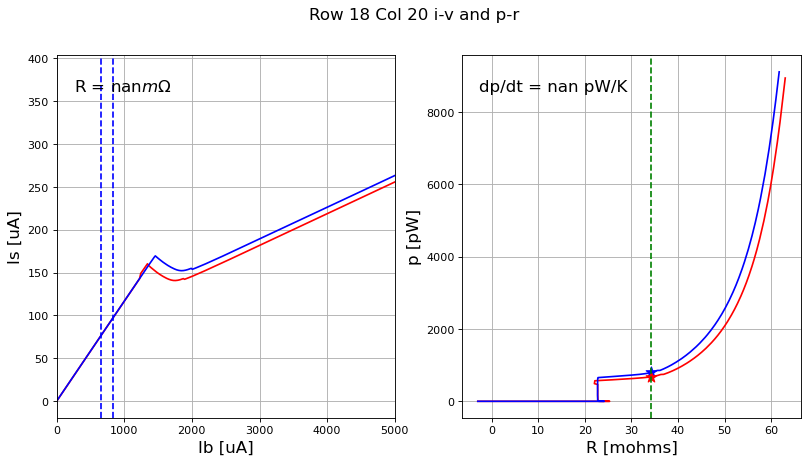

nan nan
row 18, col 21


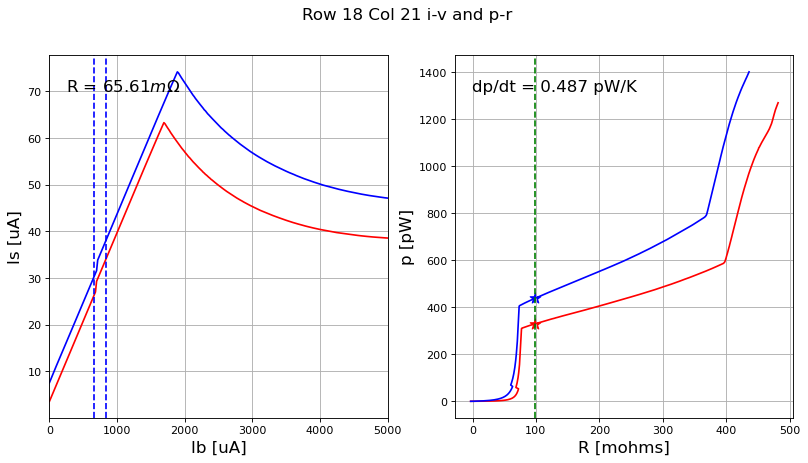

0.4866069535914968 0.06561286613402374
row 18, col 22


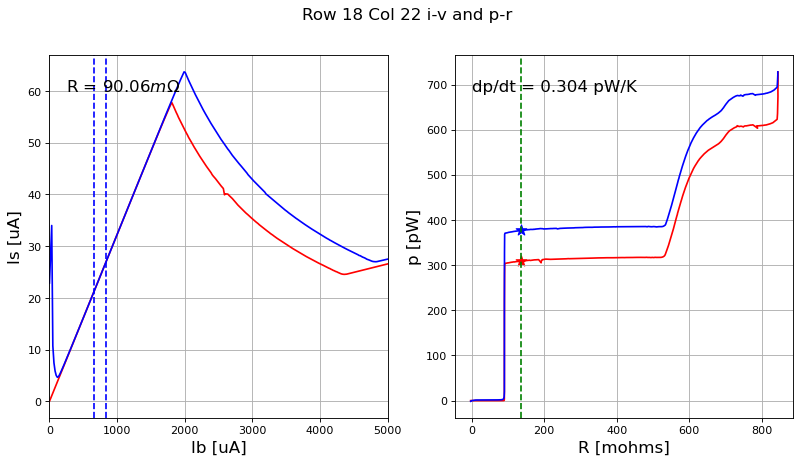

0.30397827605848127 0.09005516800472829
row 18, col 23


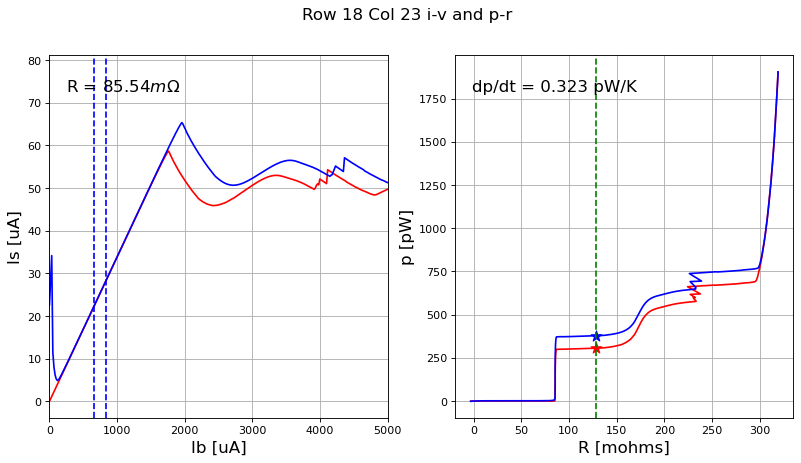

0.32281473263712246 0.08553762786238639
row 18, col 24


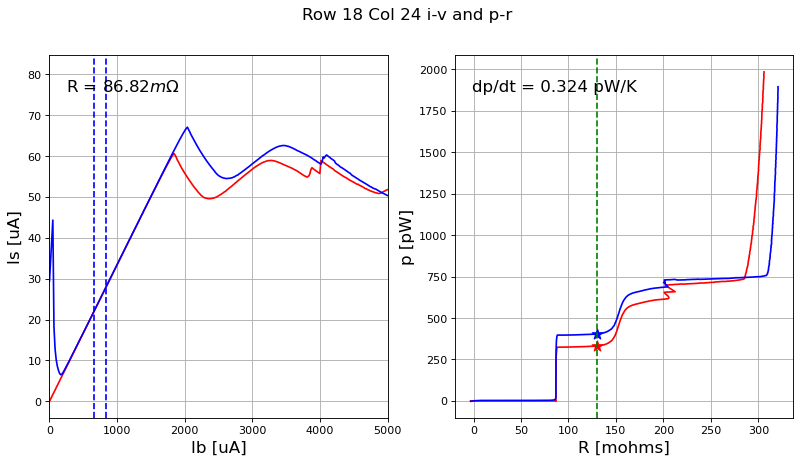

0.3240510179848445 0.0868242704490449
row 18, col 25


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


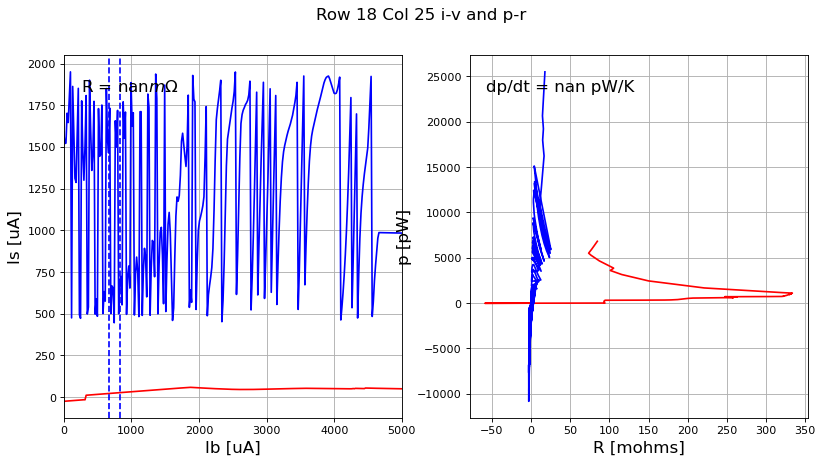

nan nan
row 18, col 26


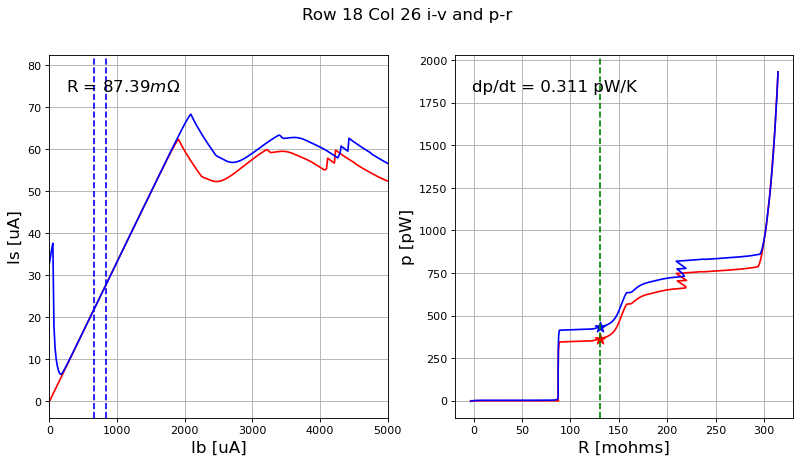

0.31140208052521967 0.08738861071725082
row 18, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


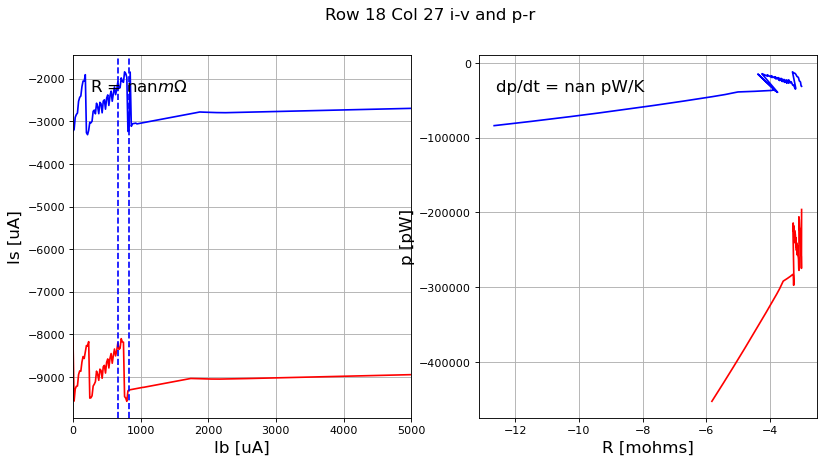

nan nan
row 18, col 28


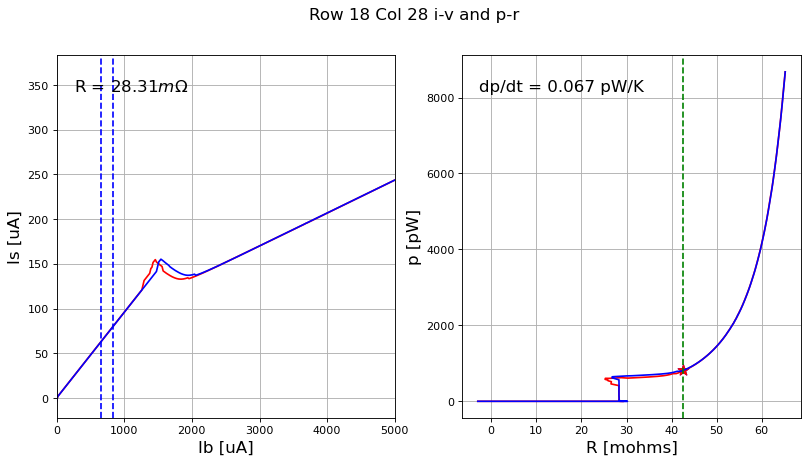

0.0665620329370615 0.028306564427733095
row 18, col 29


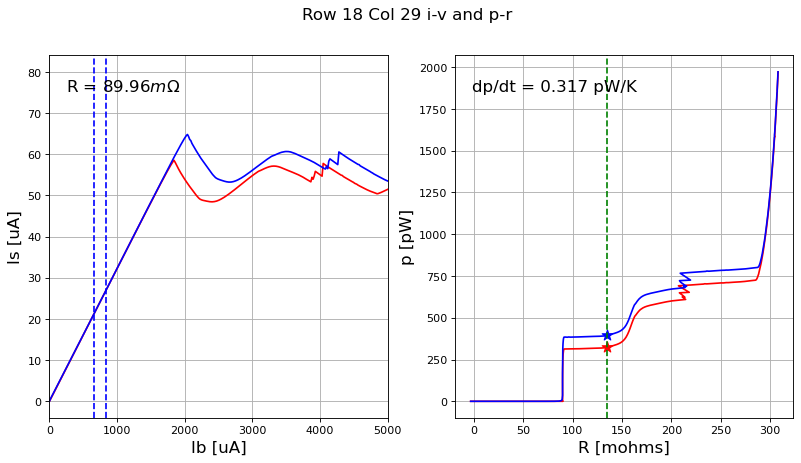

0.3173602275404946 0.08996094328033113
row 18, col 30


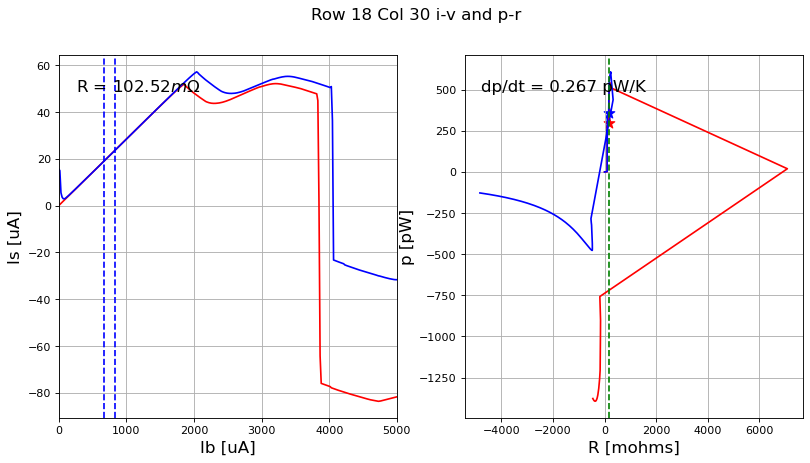

0.26687440307208055 0.10251855809684302
row 18, col 31


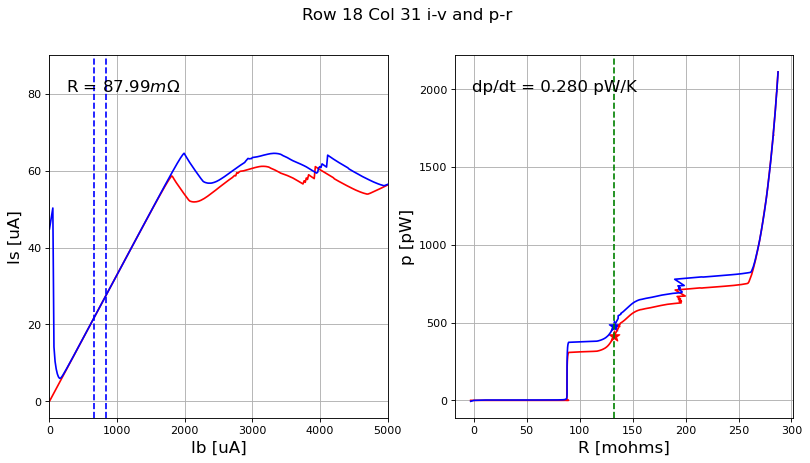

0.27976552361210016 0.08798715687078314
row 19, col 16


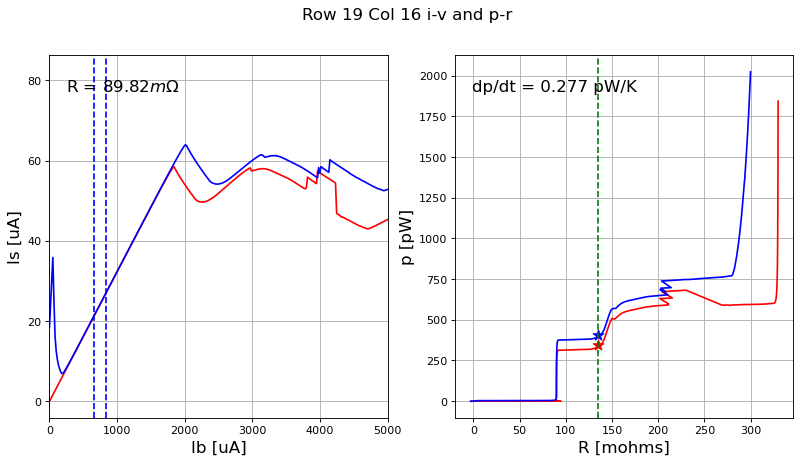

0.276707744652883 0.08981527226685805
row 19, col 17


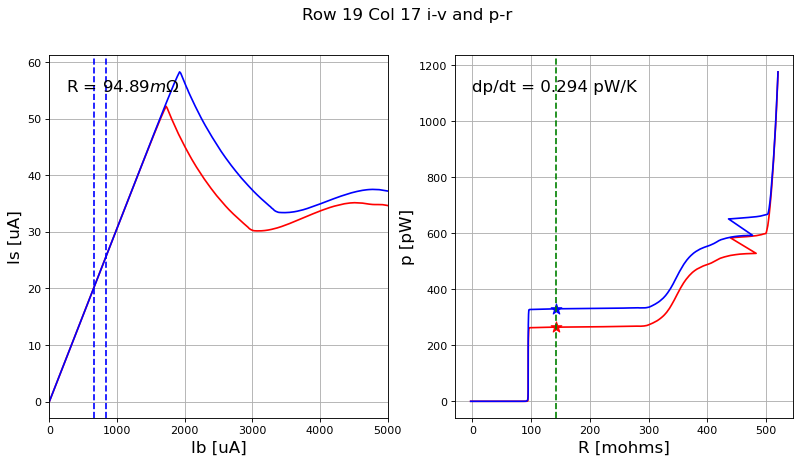

0.2935403835055343 0.09489144008832219
row 19, col 18


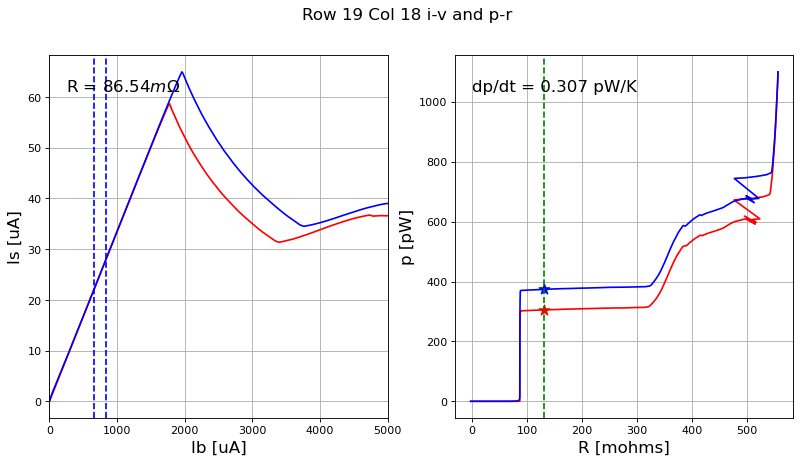

0.307236223324513 0.08653712052126725
row 19, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


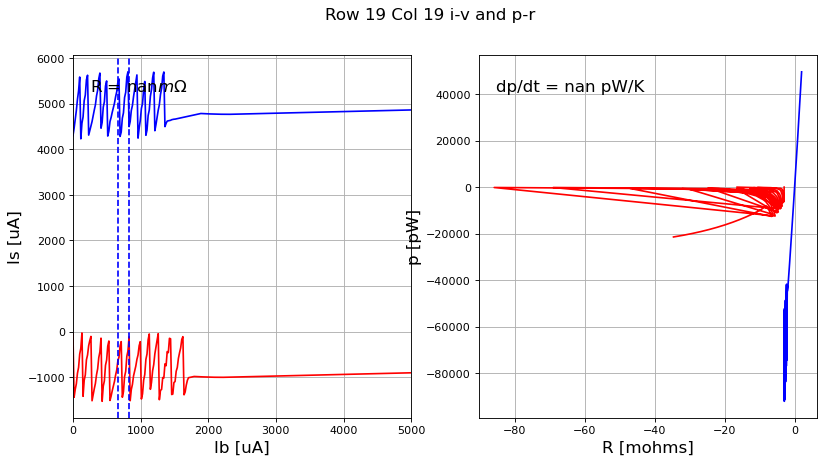

nan nan
row 19, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


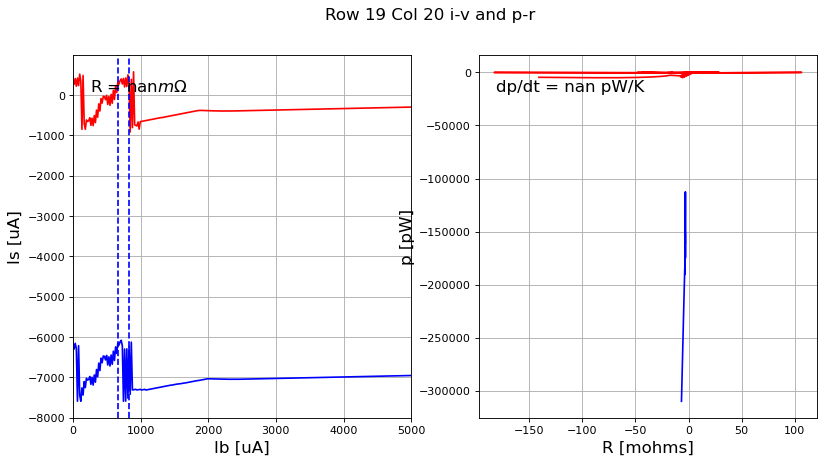

nan nan
row 19, col 21


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


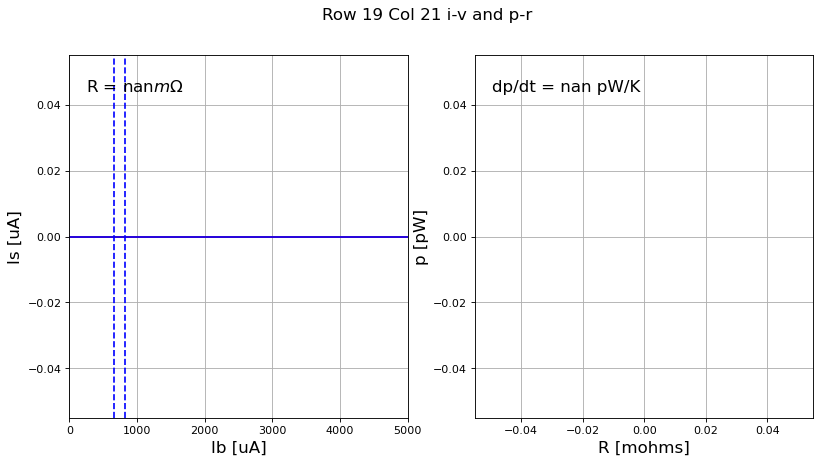

nan nan
row 19, col 22


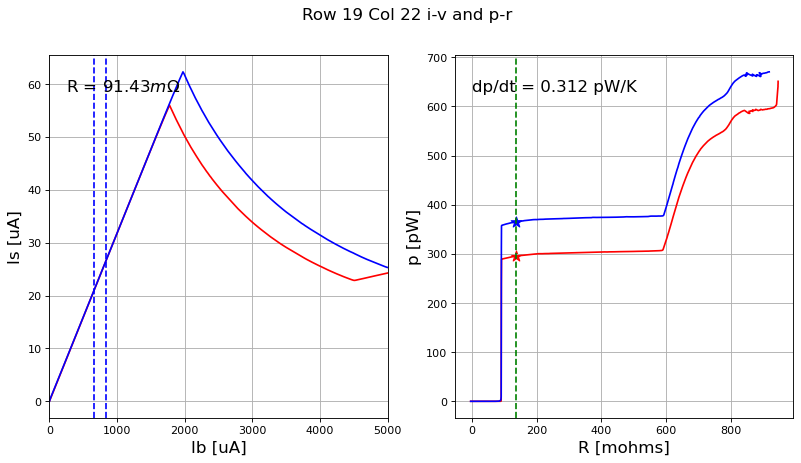

0.3121003402349822 0.09142576642386119
row 19, col 23


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


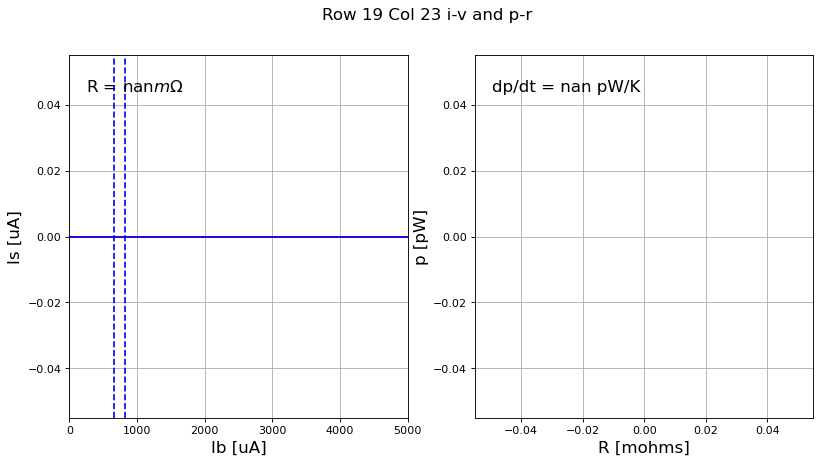

nan nan
row 19, col 24


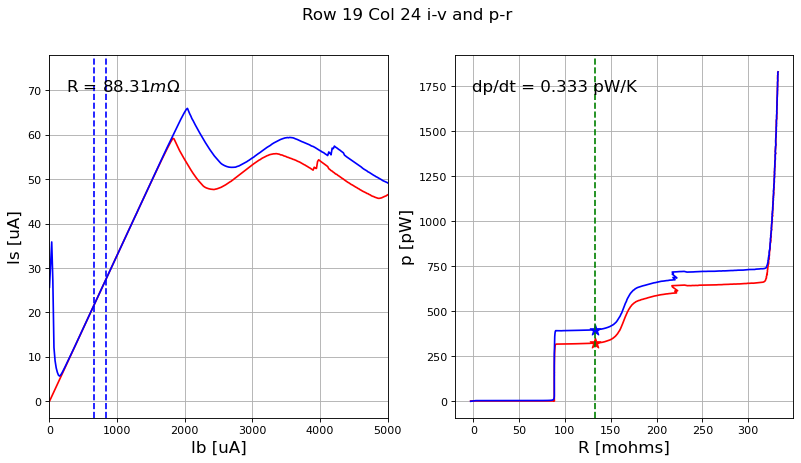

0.3327841561385944 0.08831173949575667
row 19, col 25


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


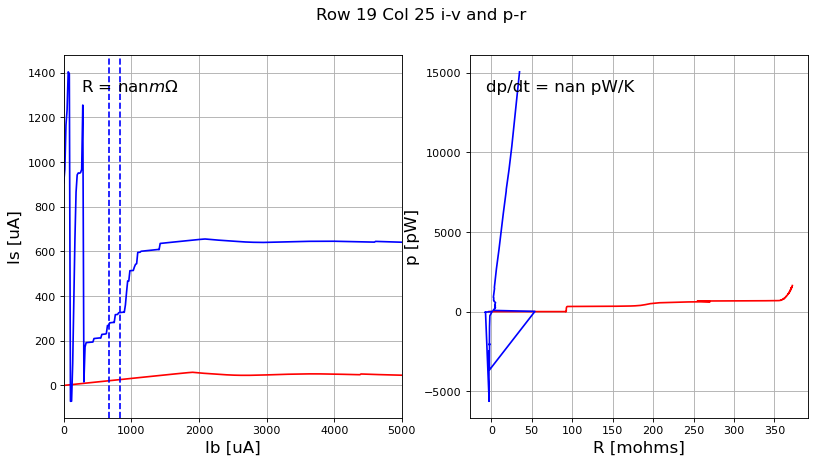

nan nan
row 19, col 26


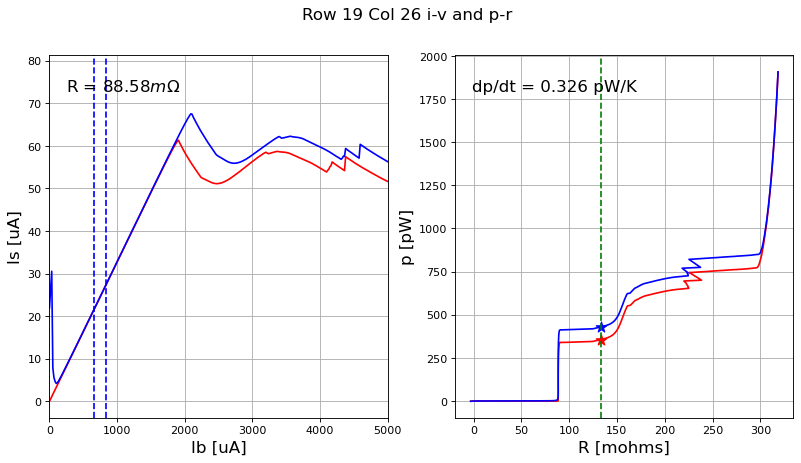

0.32562300066173294 0.08857840800197977
row 19, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


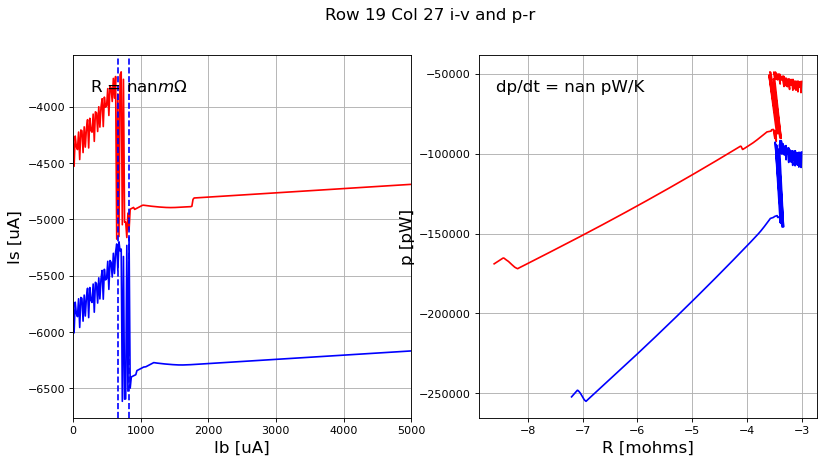

nan nan
row 19, col 28


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


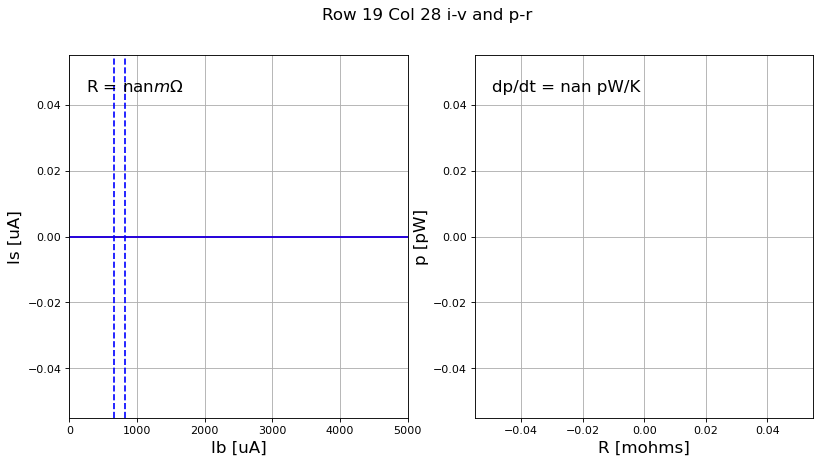

nan nan
row 19, col 29


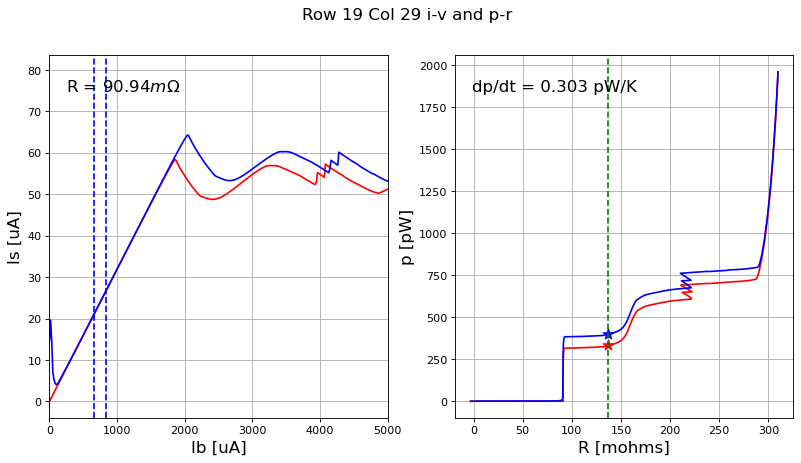

0.30319560616126967 0.09093519528206721
row 19, col 30


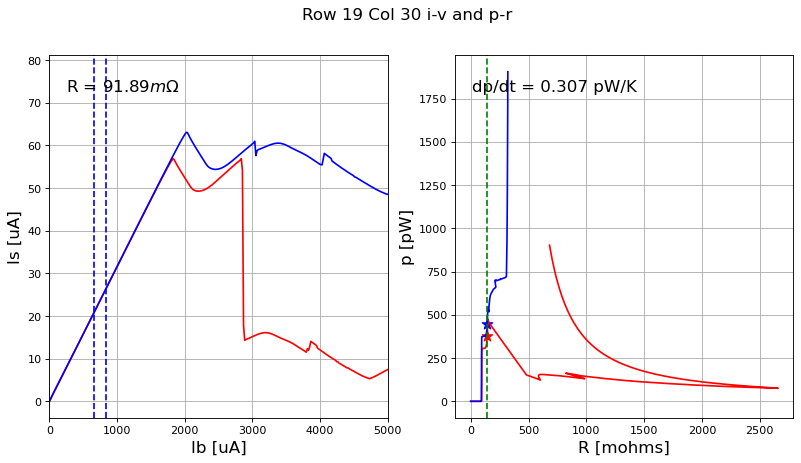

0.3074415492490324 0.09189310094906256
row 19, col 31


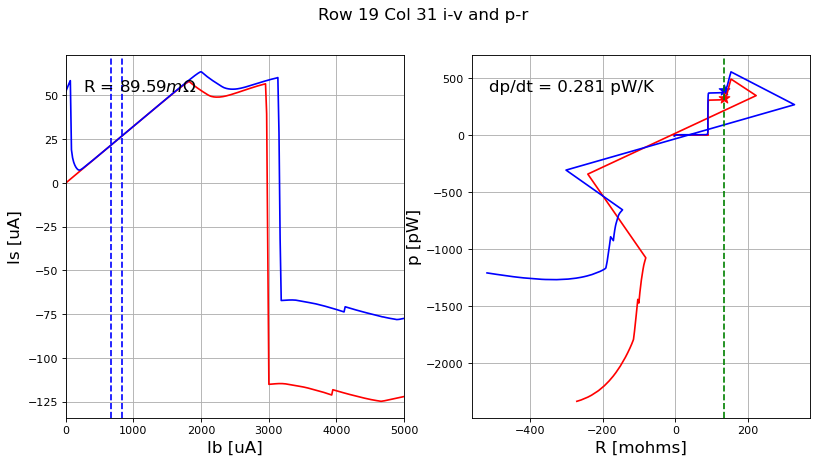

0.2805922151108965 0.0895882198288487
row 20, col 16


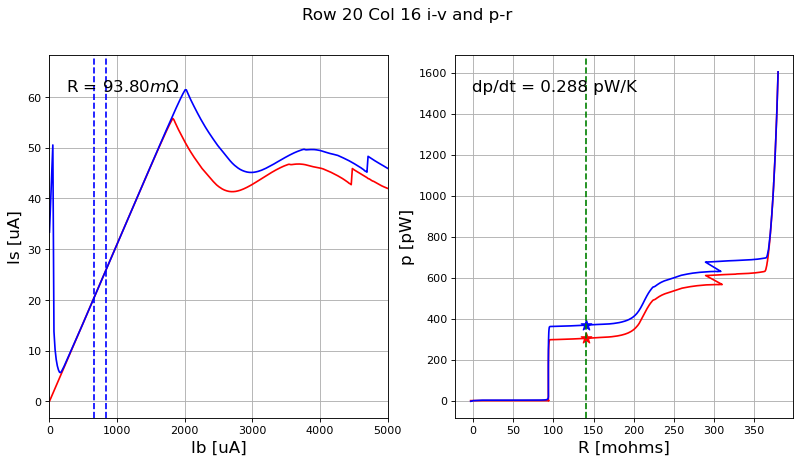

0.2884253339117717 0.09379947945000724
row 20, col 17


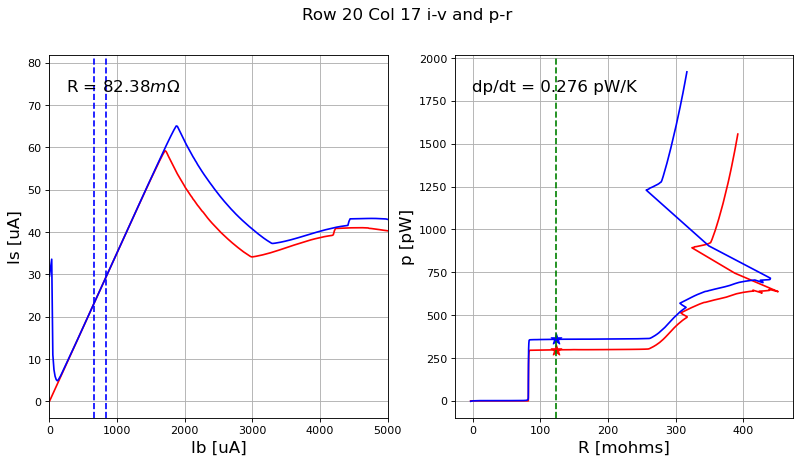

0.27572170935491364 0.08237544747390349
row 20, col 18


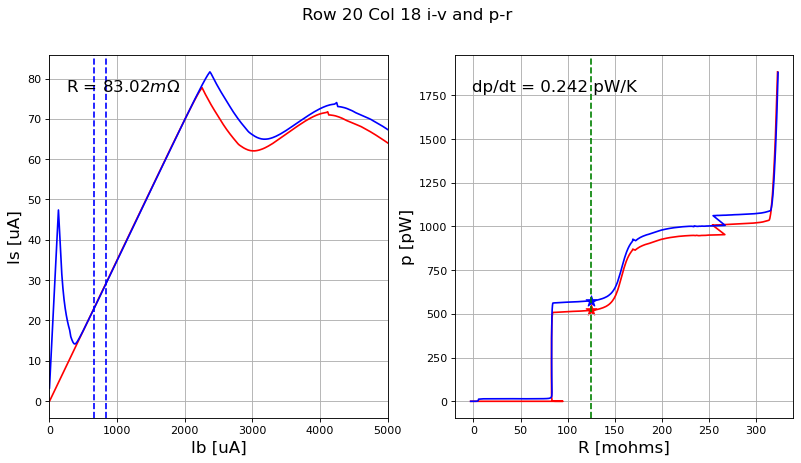

0.24173391539977995 0.08302257787108713
row 20, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


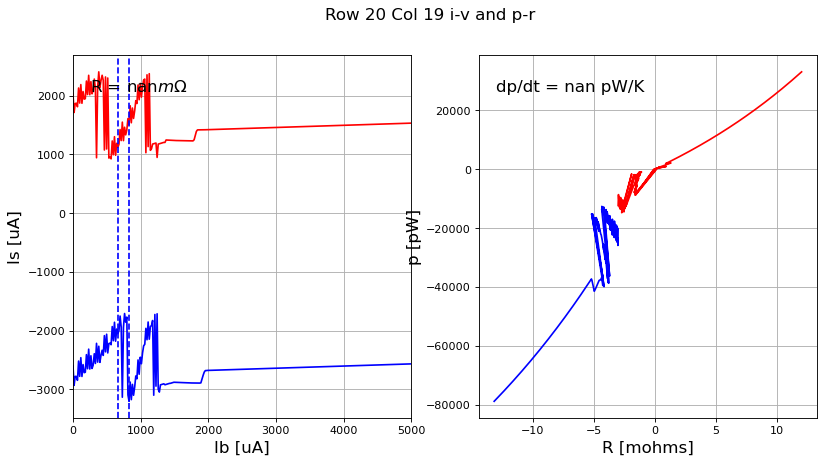

nan nan
row 20, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


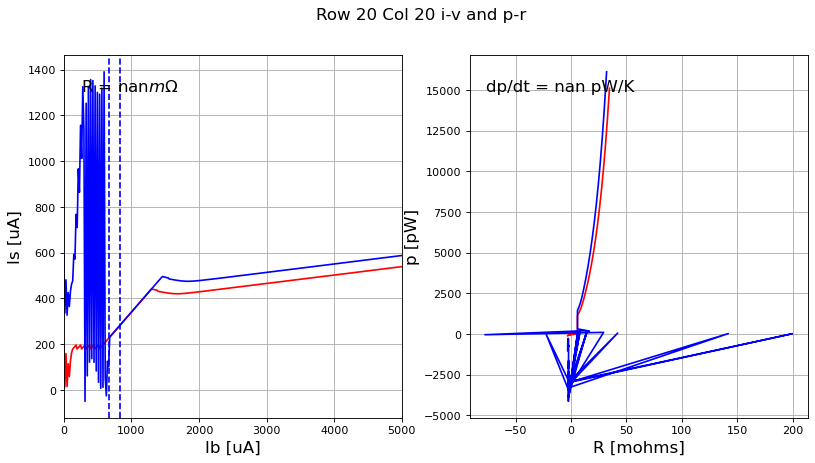

nan nan
row 20, col 21


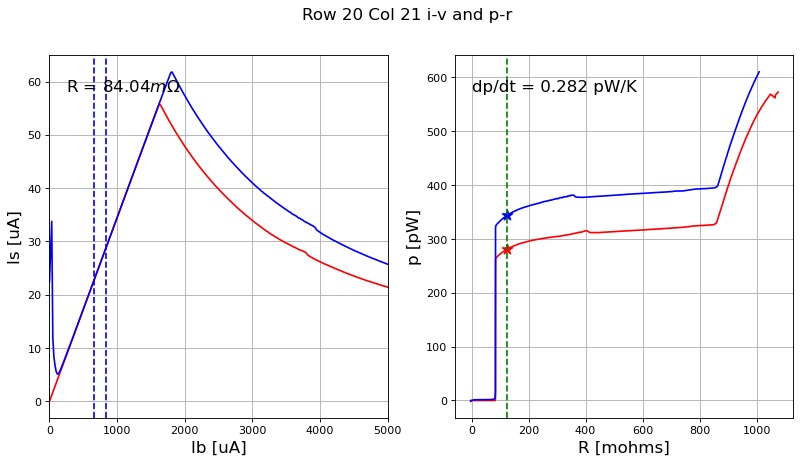

0.2816222034399255 0.08403796863711761
row 20, col 22


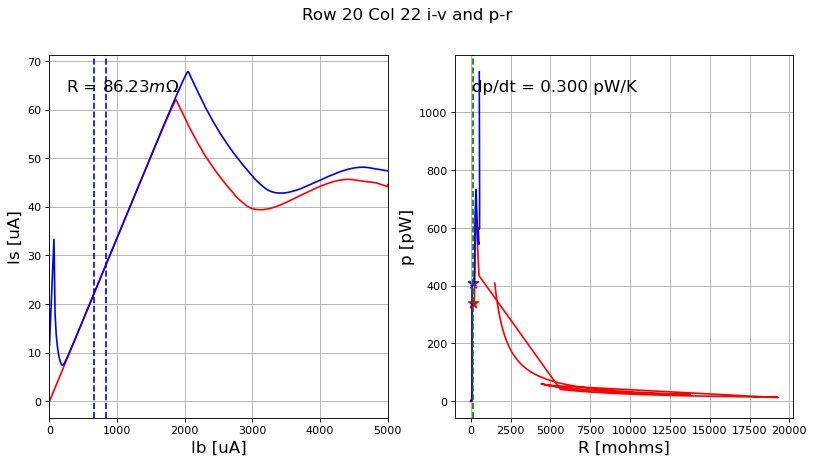

0.2995327375113124 0.08623334960280152
row 20, col 23


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


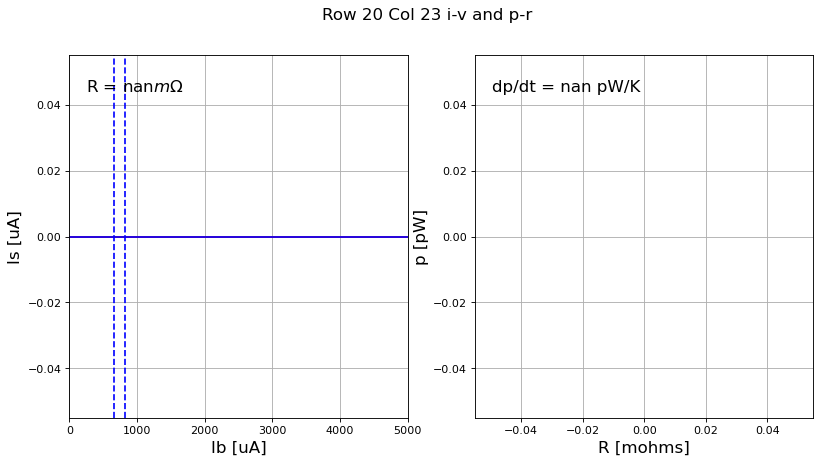

nan nan
row 20, col 24


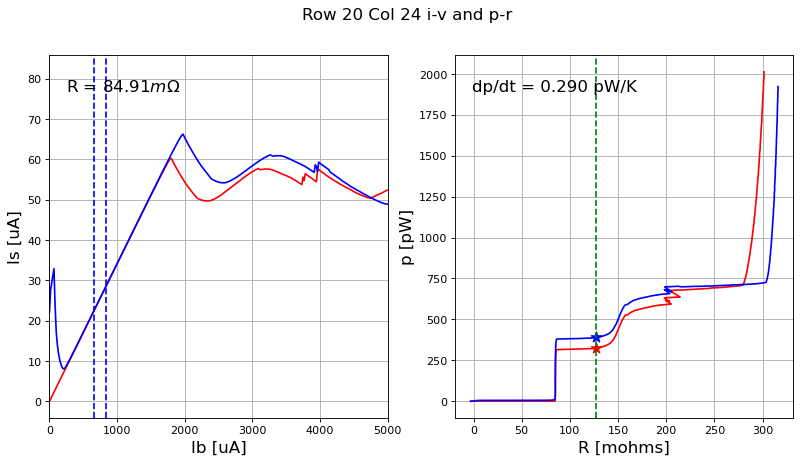

0.28999508865028994 0.08491414972499672
row 20, col 25


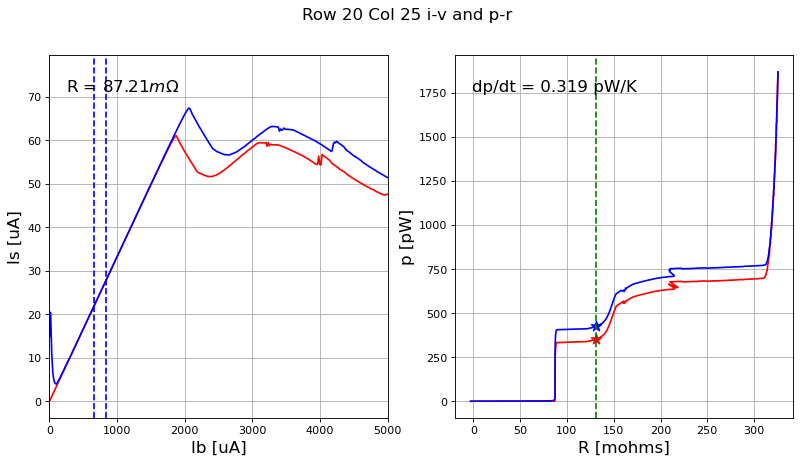

0.3192153388609472 0.08721241622688895
row 20, col 26
#####################
26 20


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


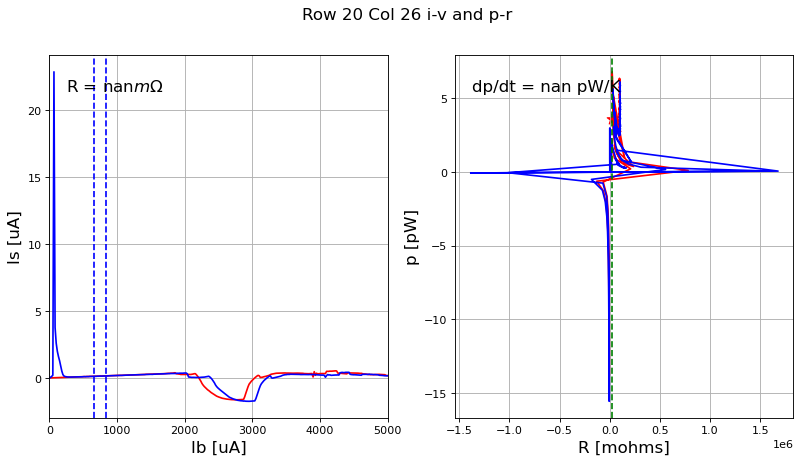

nan nan
row 20, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


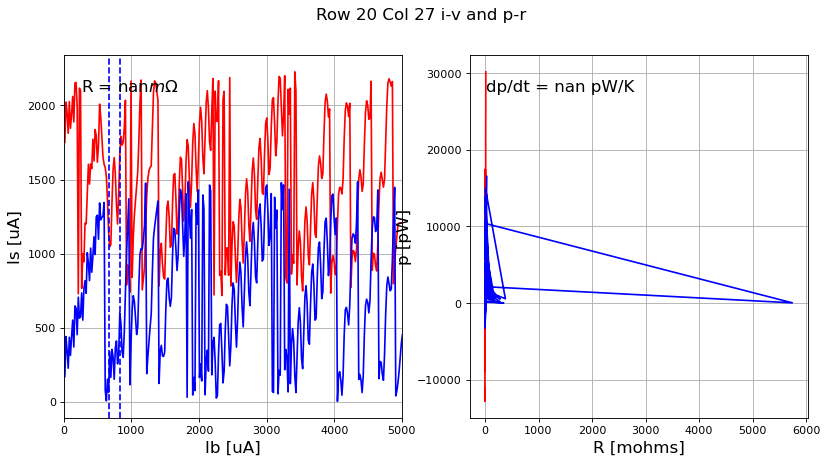

nan nan
row 20, col 28


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


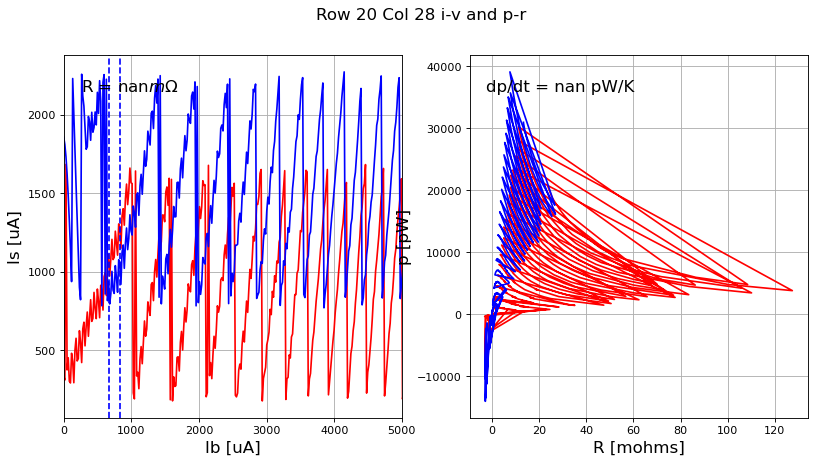

nan nan
row 20, col 29


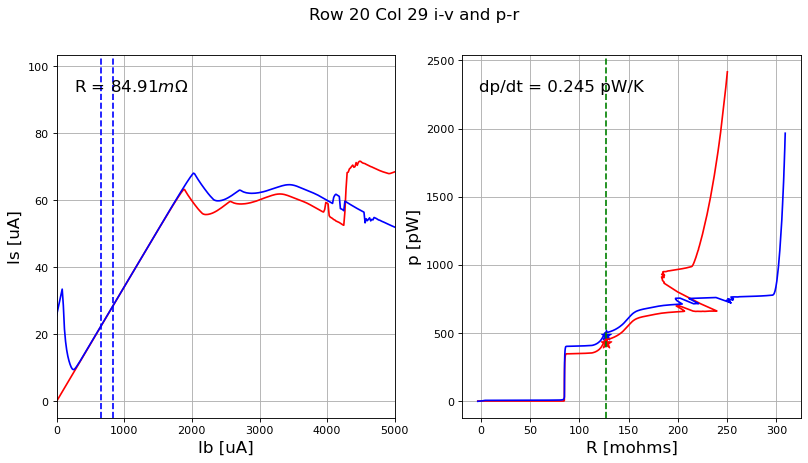

0.24545839901774846 0.08490551331995194
row 20, col 30


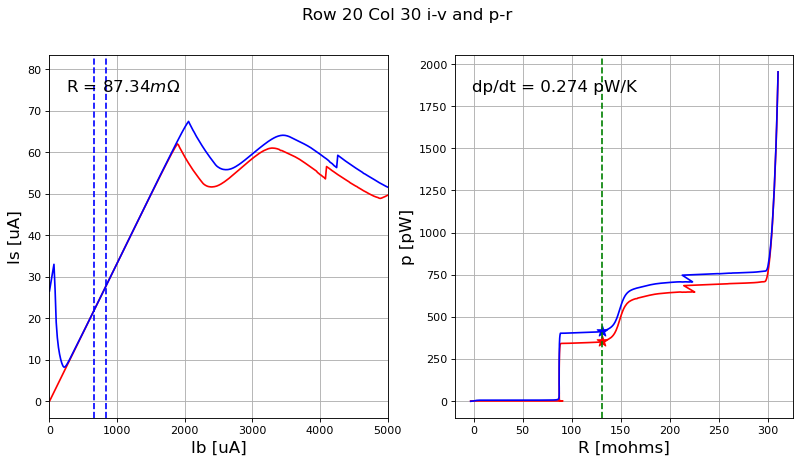

0.2735077521945047 0.08734087546994307
row 20, col 31


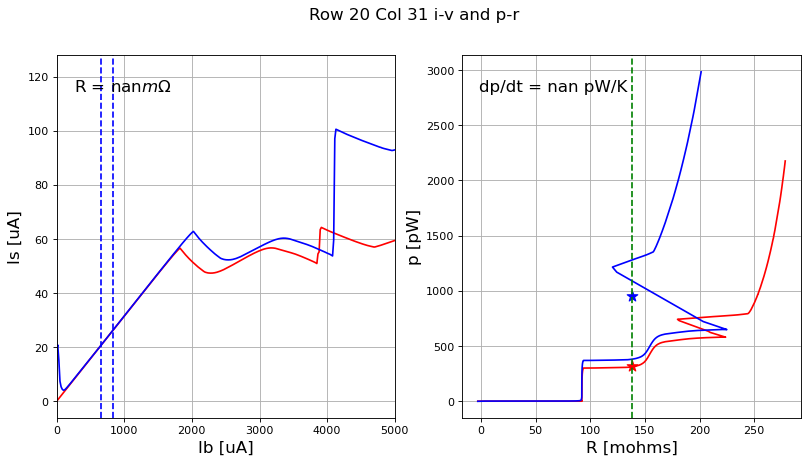

nan nan
row 21, col 16


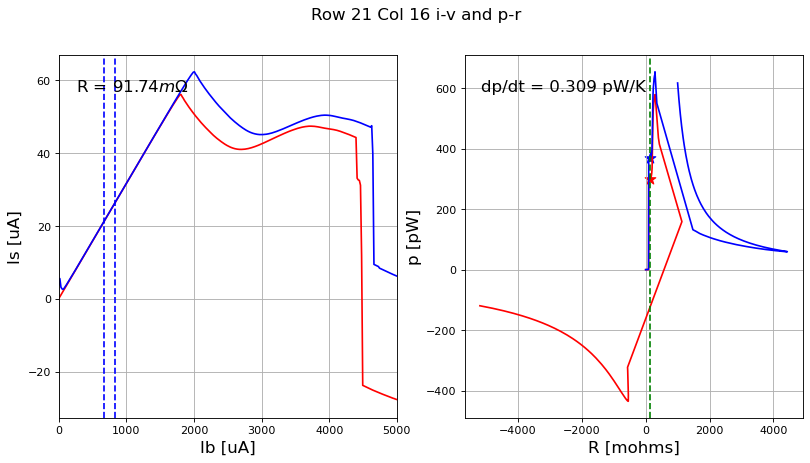

0.30893178914430464 0.0917433683418621
row 21, col 17


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


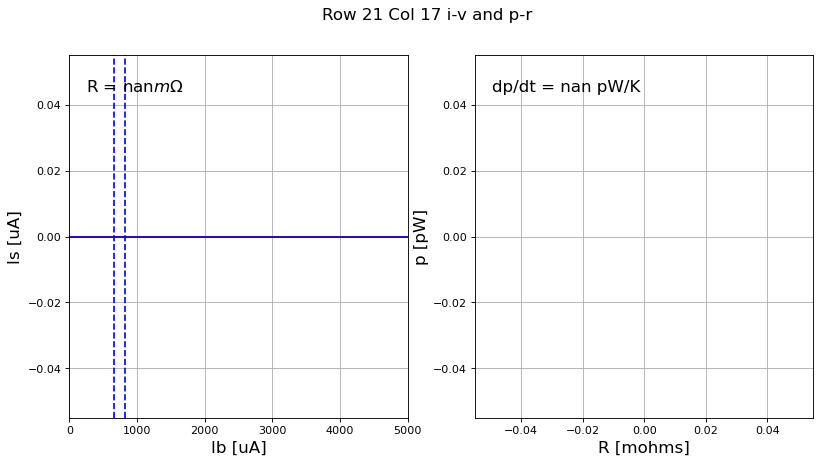

nan nan
row 21, col 18


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


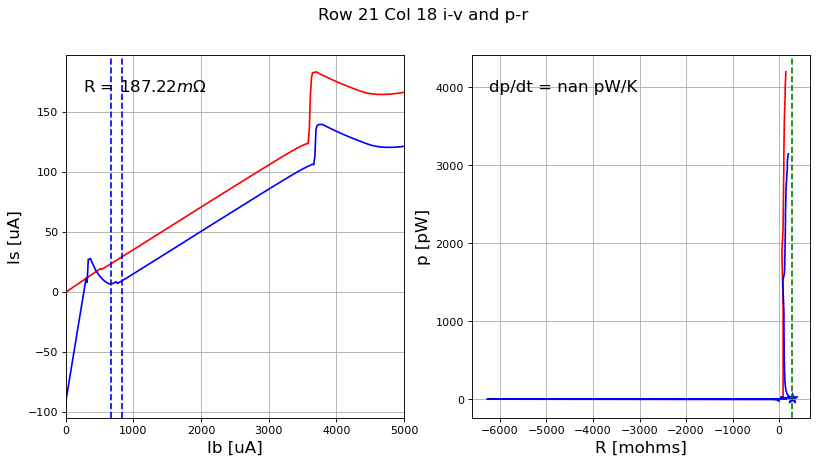

nan 0.1872231238142821
row 21, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


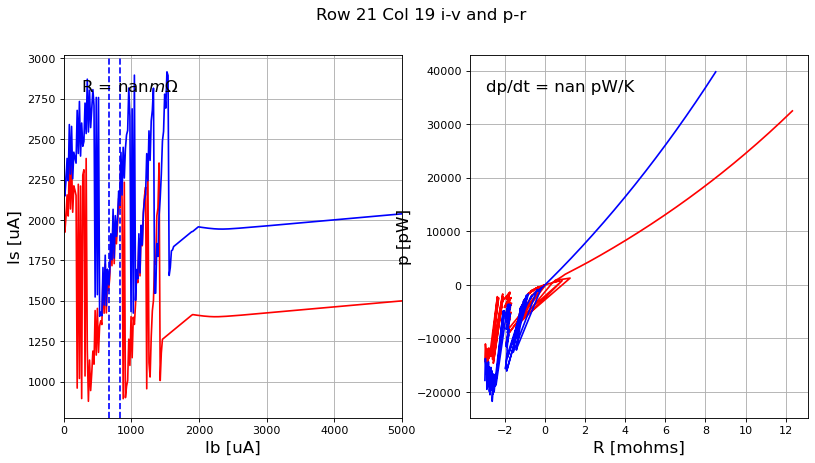

nan nan
row 21, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


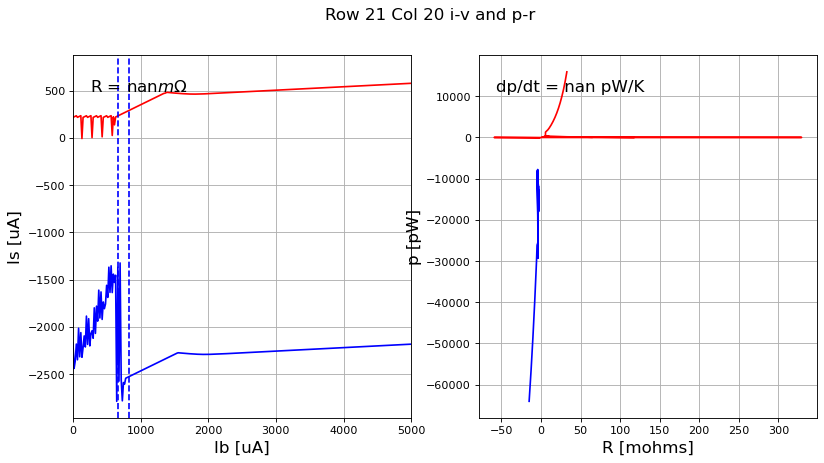

nan nan
row 21, col 21


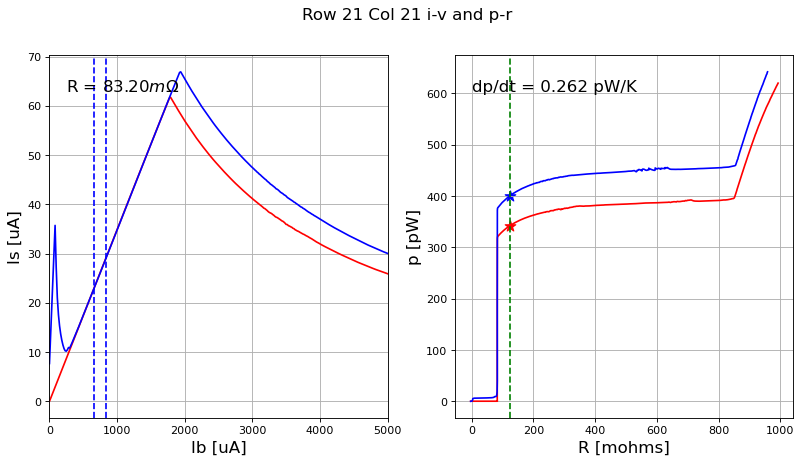

0.26168157720190244 0.083204053892936
row 21, col 22


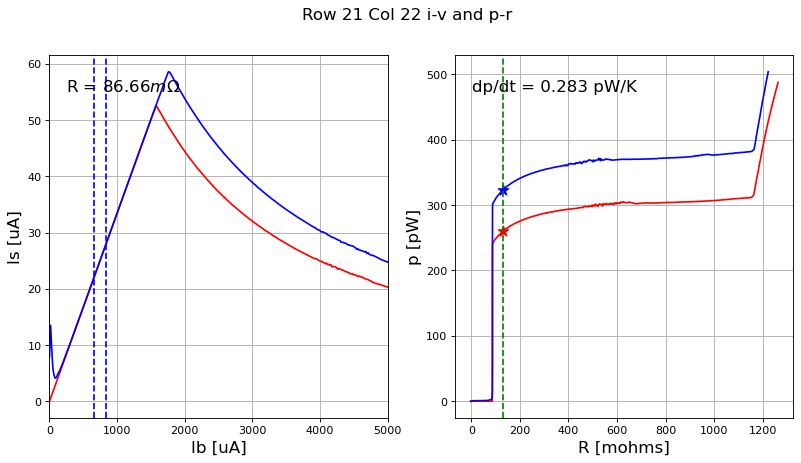

0.28280499144311816 0.08665759548836756
row 21, col 23


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


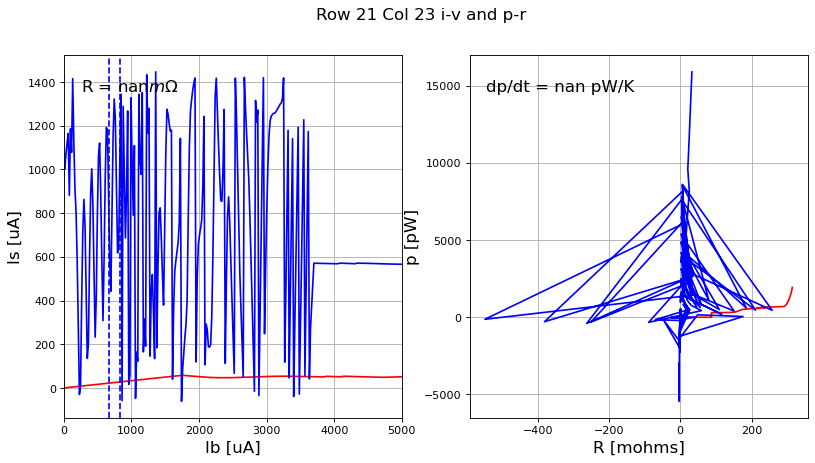

nan nan
row 21, col 24


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


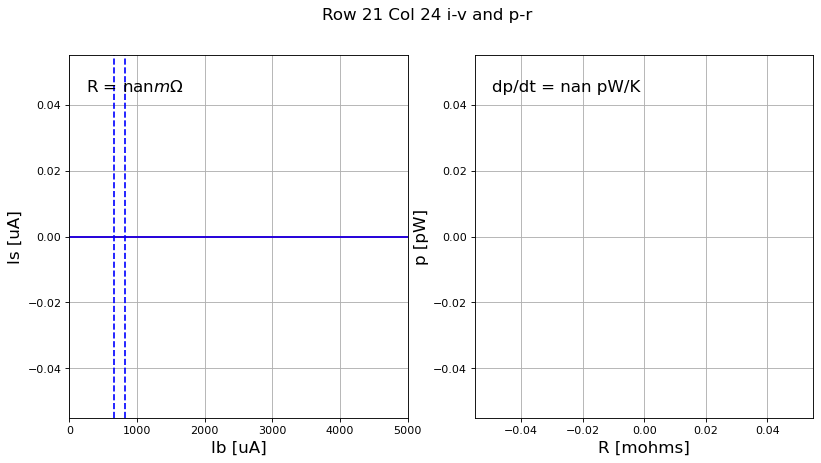

nan nan
row 21, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


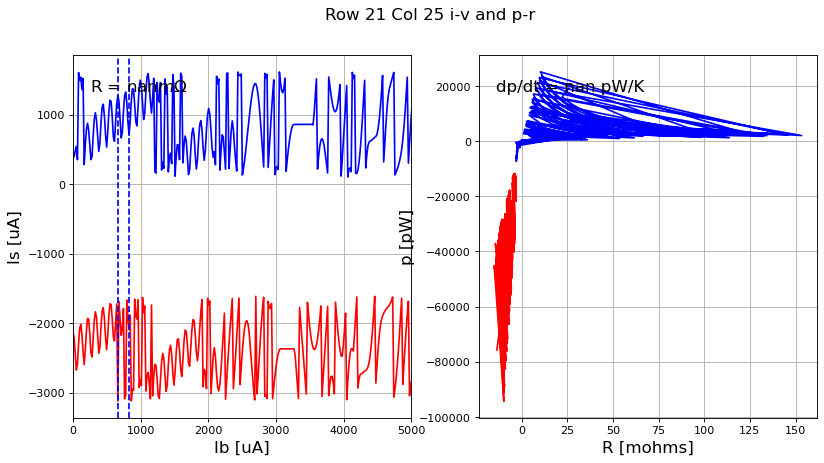

nan nan
row 21, col 26


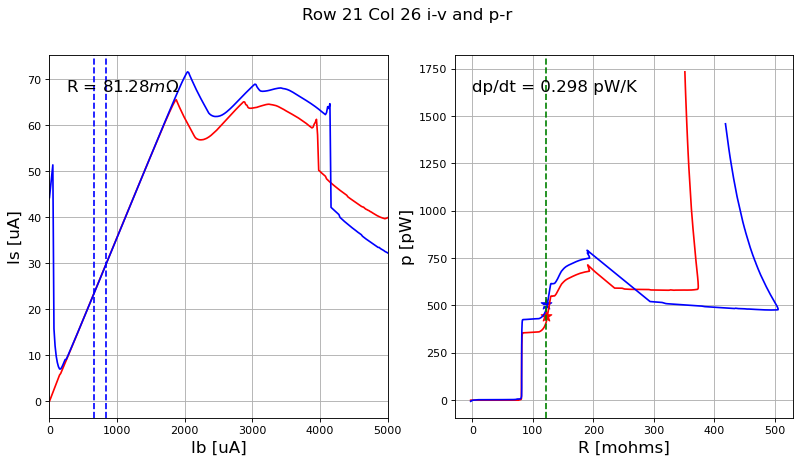

0.2983494527525809 0.08127624668036046
row 21, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


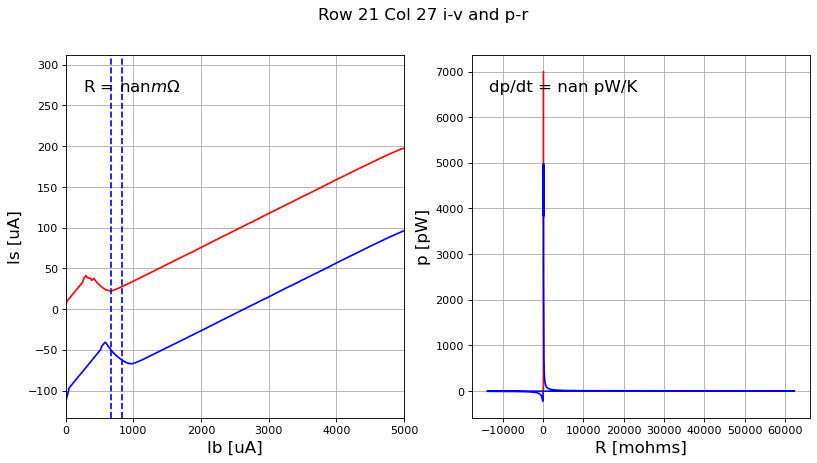

nan nan
row 21, col 28


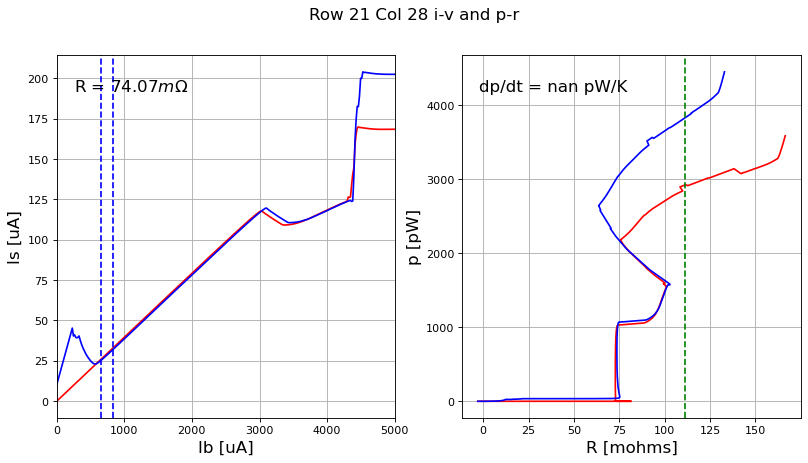

nan 0.07407030087602298
row 21, col 29


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


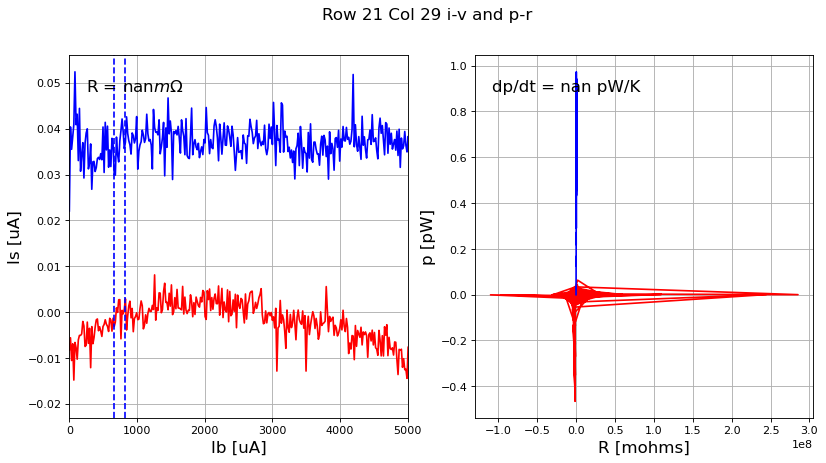

nan nan
row 21, col 30


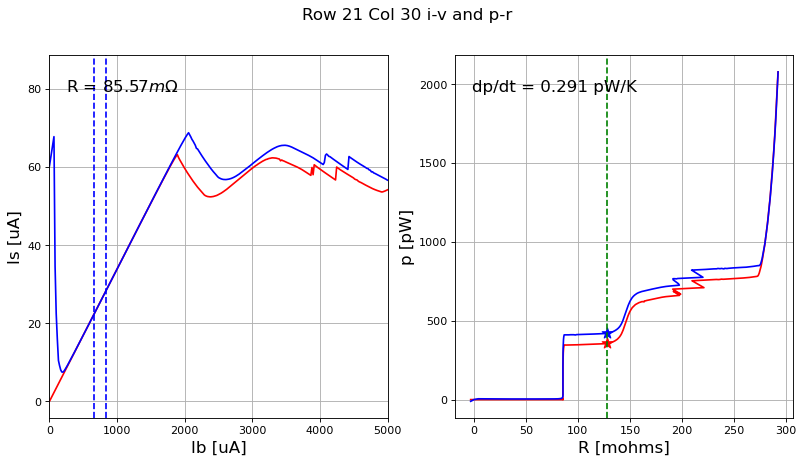

0.29093055101542 0.08556947216697894
row 21, col 31


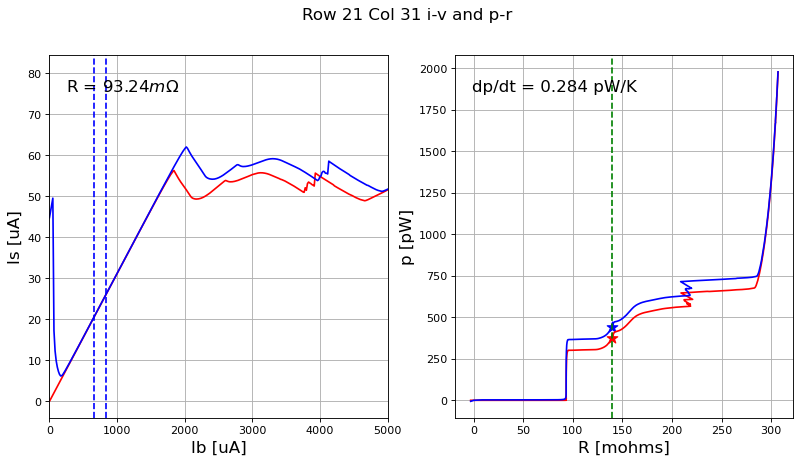

0.2842203547236016 0.09323773531508167
row 22, col 16


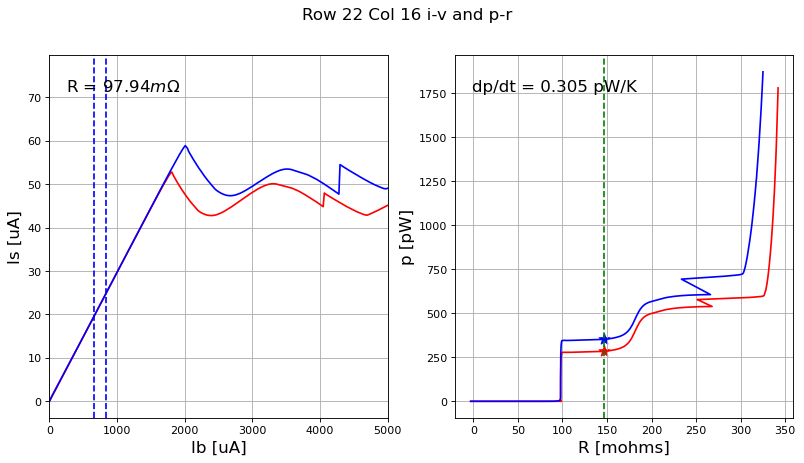

0.30454265954905585 0.09793540734860298
row 22, col 17


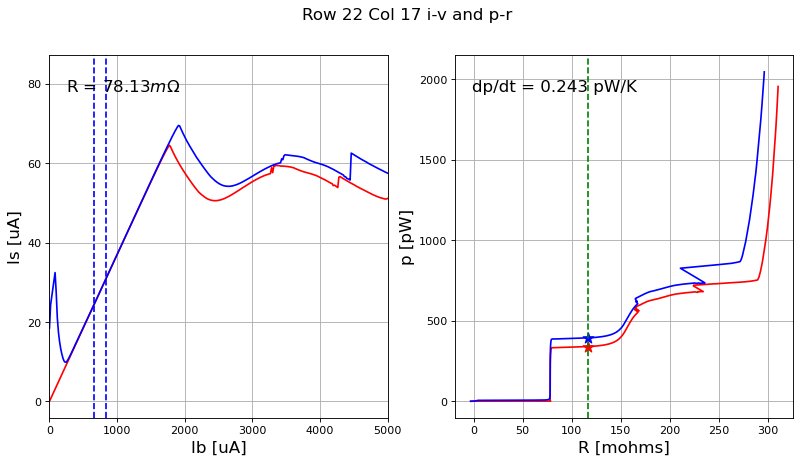

0.24289726427766045 0.07813082464109637
row 22, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


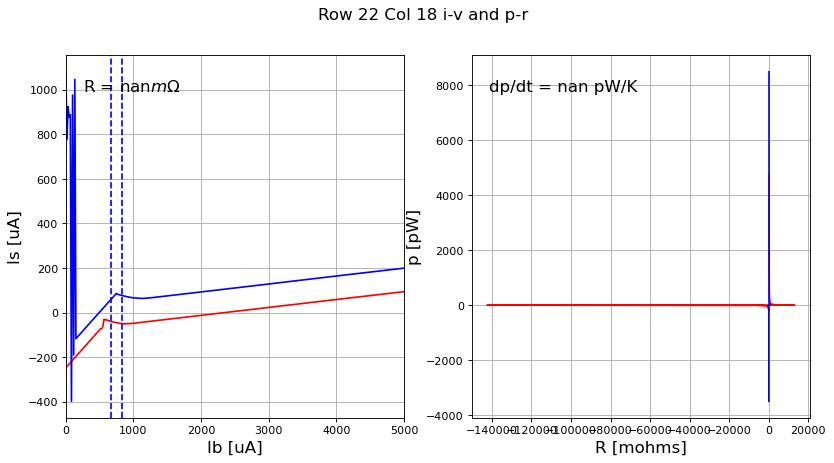

nan nan
row 22, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


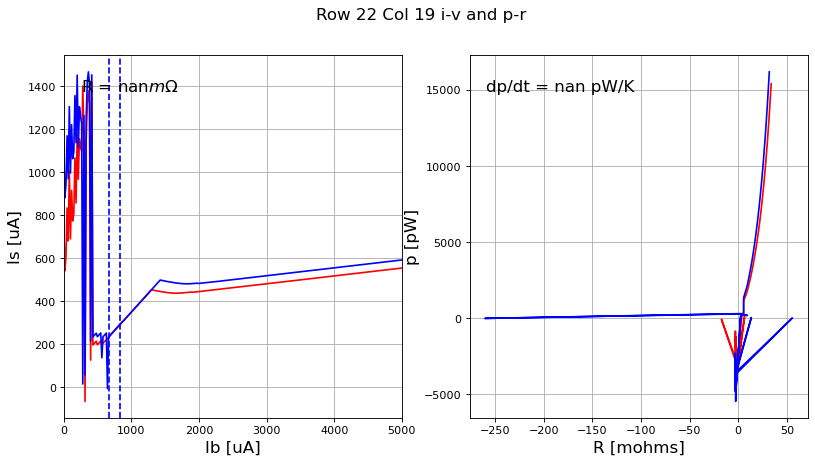

nan nan
row 22, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


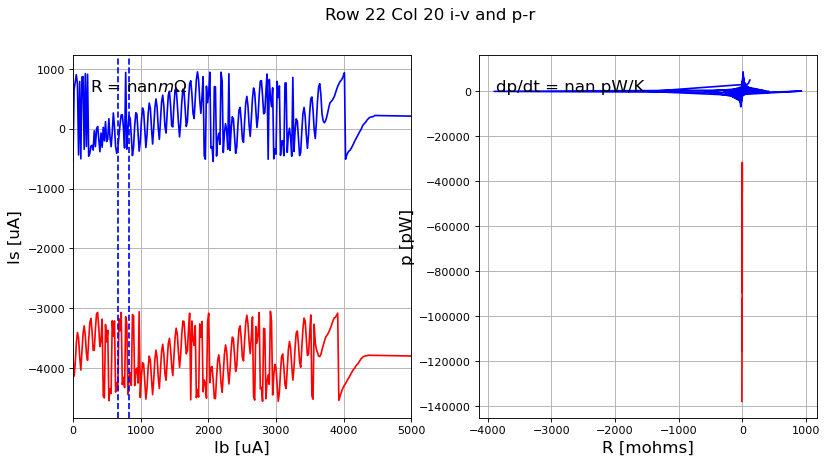

nan nan
row 22, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


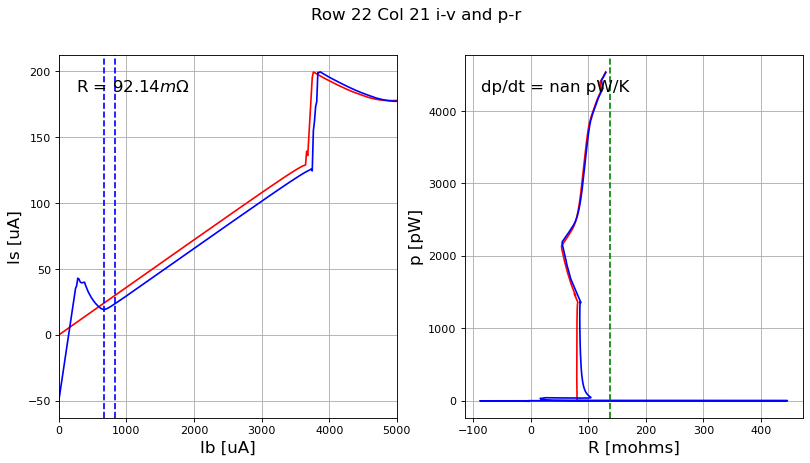

nan 0.09214181331638473
row 22, col 22


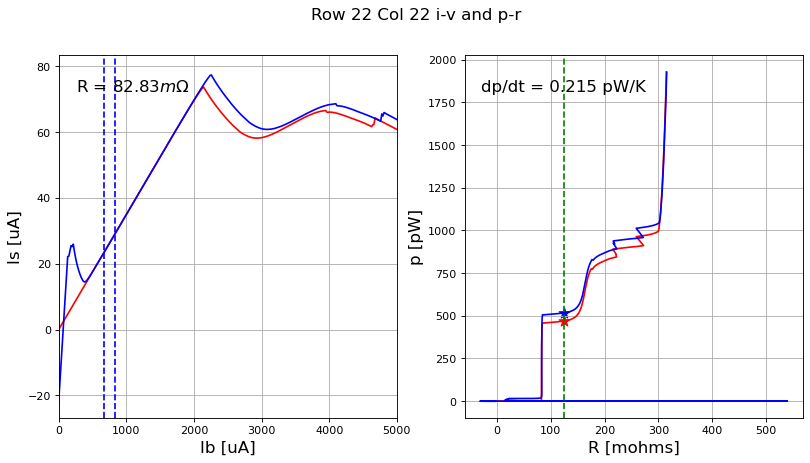

0.2153336157474599 0.08282654132433129
row 22, col 23


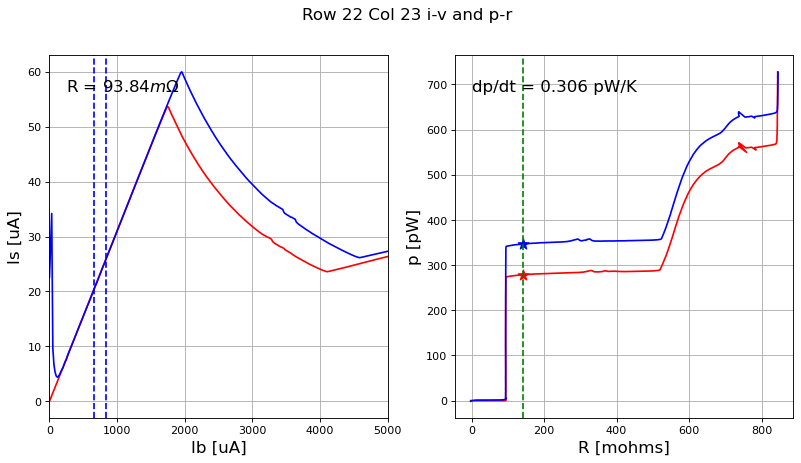

0.3056850403054664 0.09383732265735834
row 22, col 24


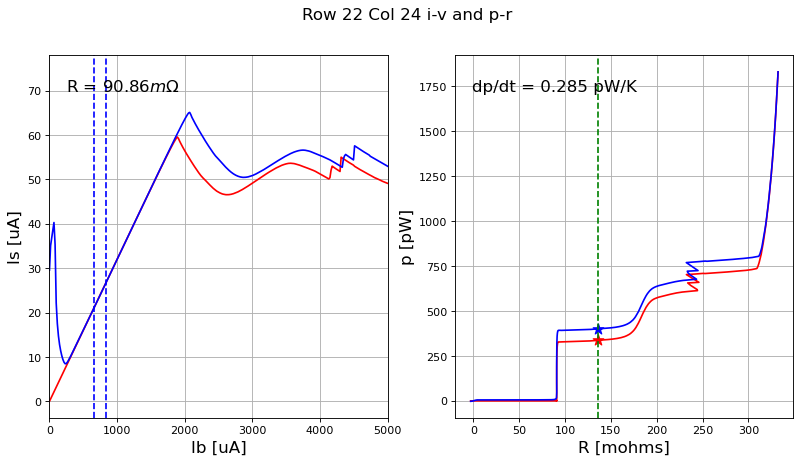

0.2845421638571672 0.09086086682231914
row 22, col 25


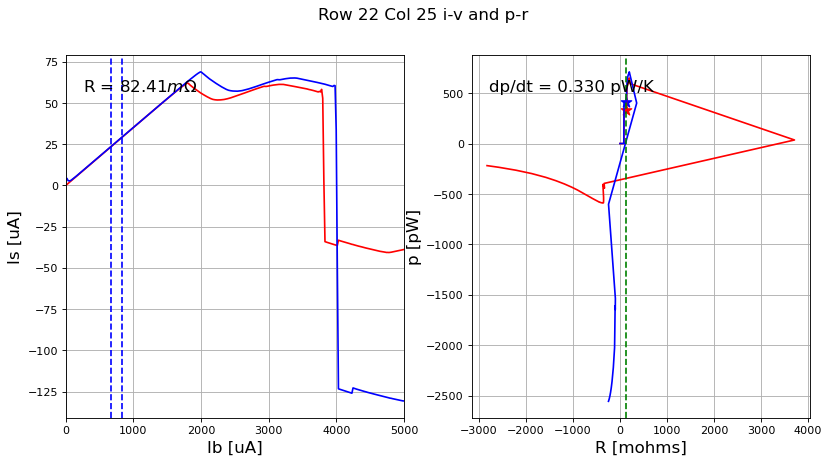

0.33046408591694637 0.08240741662964204
row 22, col 26


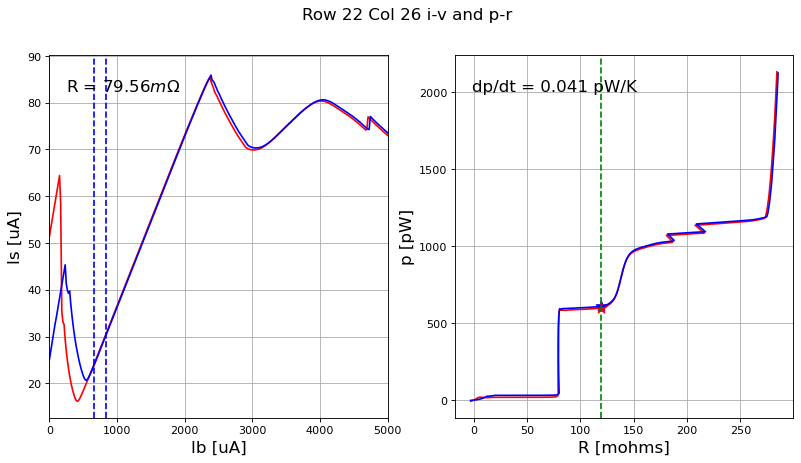

0.04068533989281986 0.07956250000810138
row 22, col 27


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


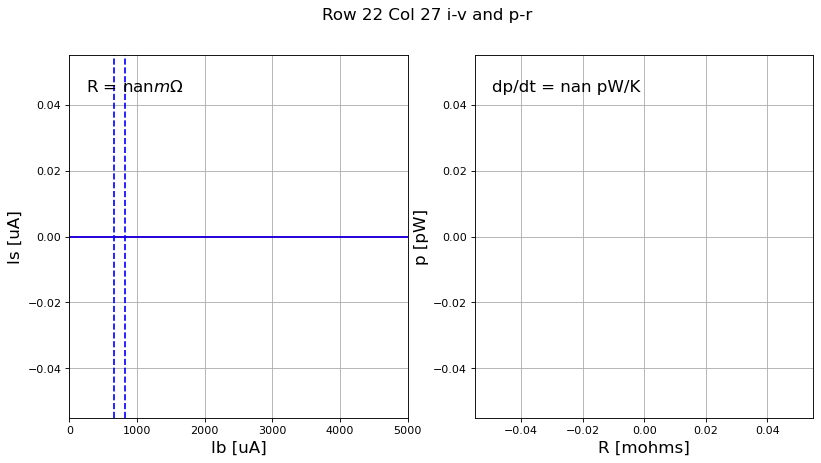

nan nan
row 22, col 28


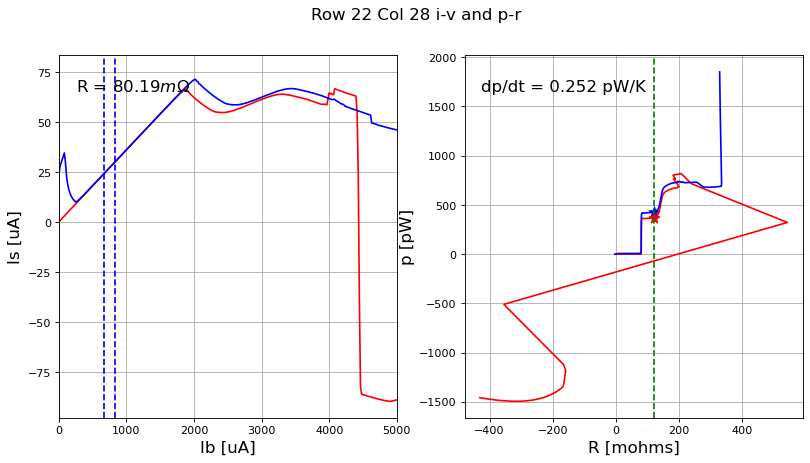

0.25203486431903105 0.08019471896552385
row 22, col 29


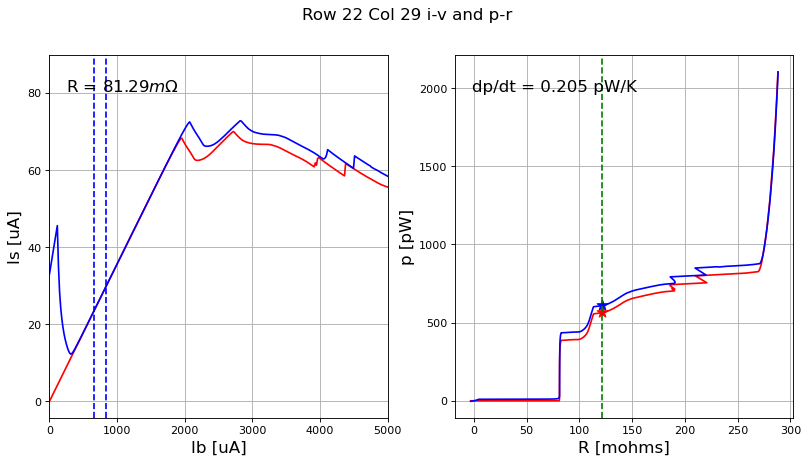

0.20501193585207 0.08129114738016183
row 22, col 30


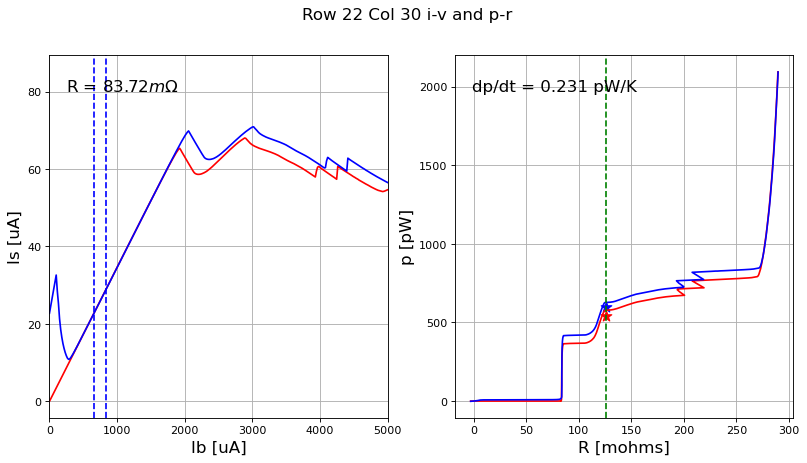

0.2313517893095041 0.08371801070636475
row 22, col 31


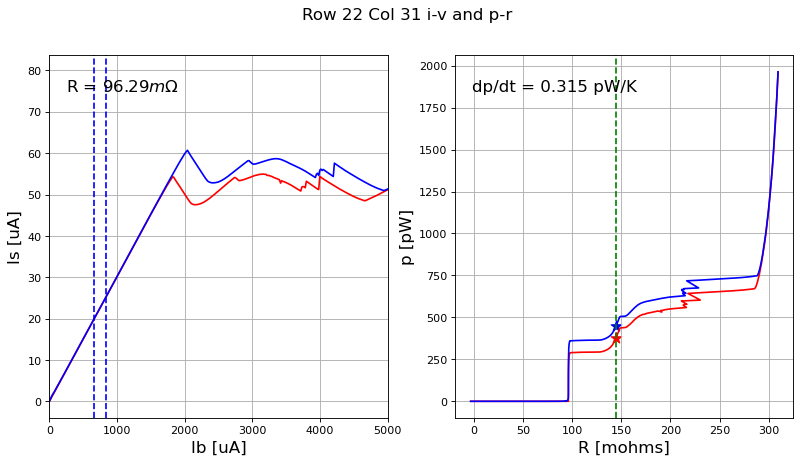

0.31468205943116356 0.09629415397099786
row 23, col 16


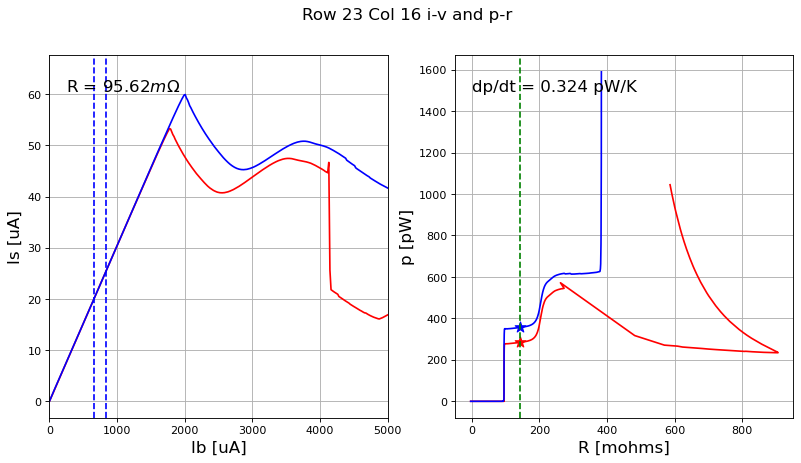

0.32392083723458204 0.09562244806964362
row 23, col 17


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


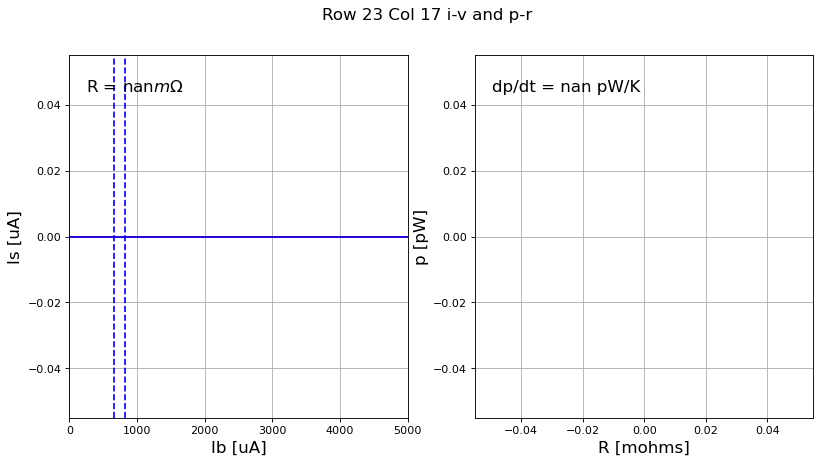

nan nan
row 23, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


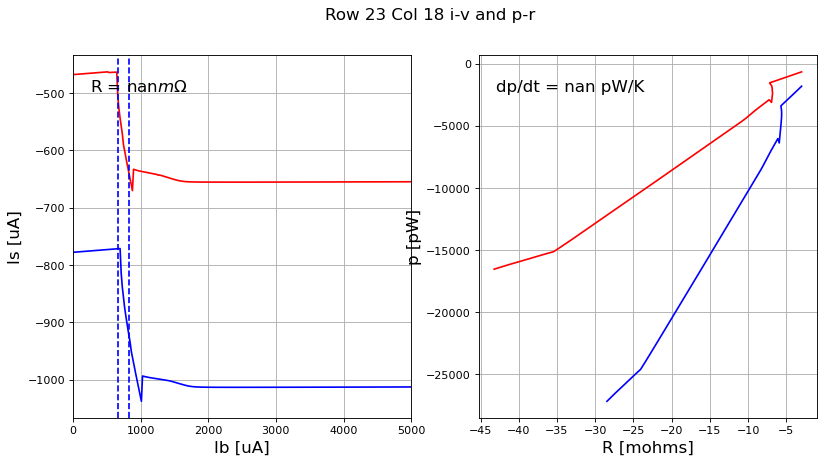

nan nan
row 23, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


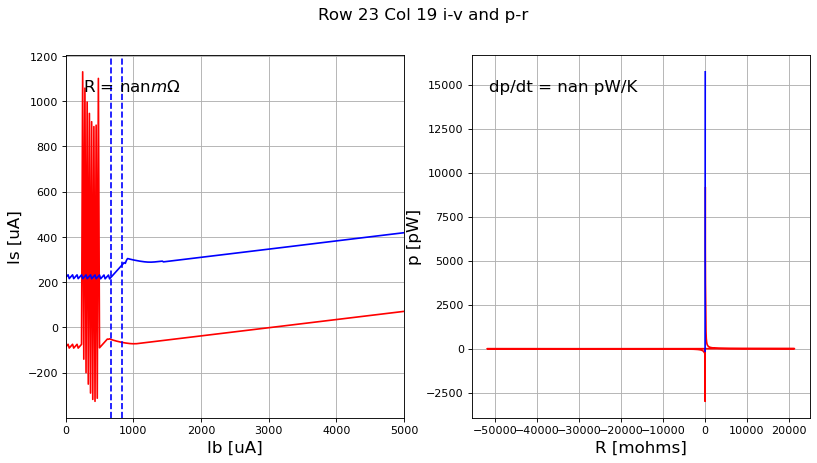

nan nan
row 23, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


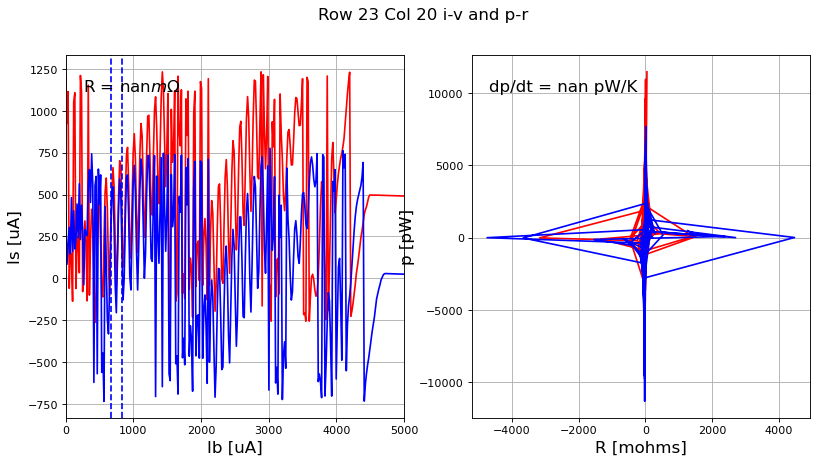

nan nan
row 23, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


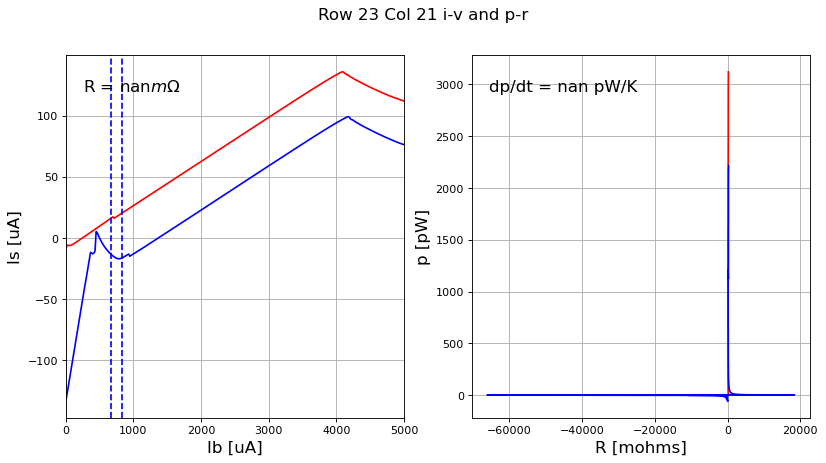

nan nan
row 23, col 22


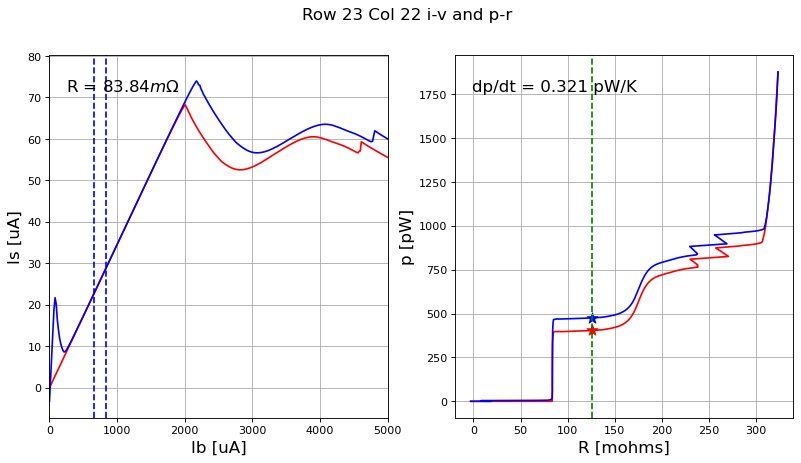

0.3212694589250958 0.0838364655644119
row 23, col 23


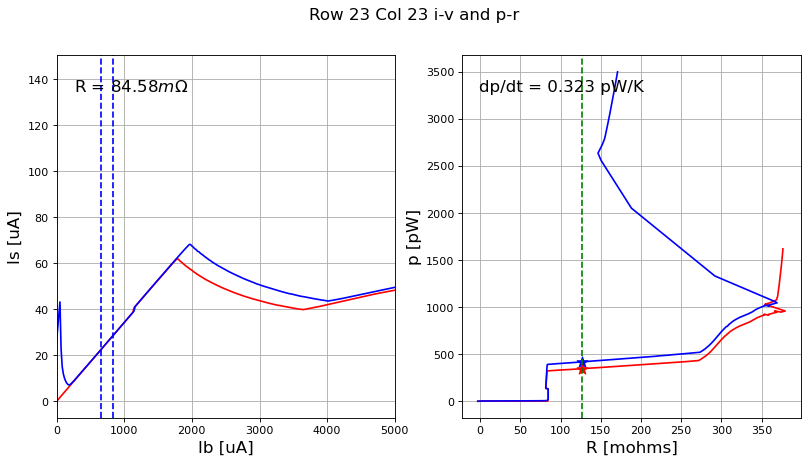

0.3231886299974733 0.08457985506813627
row 23, col 24


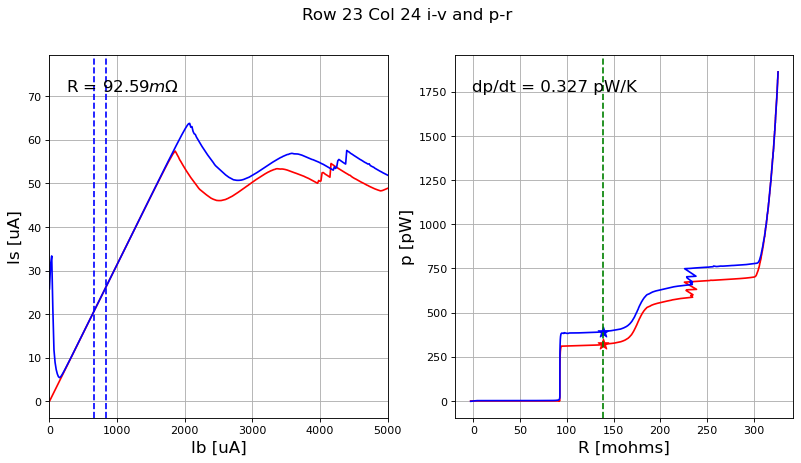

0.3270394410515453 0.0925889427641421
row 23, col 25


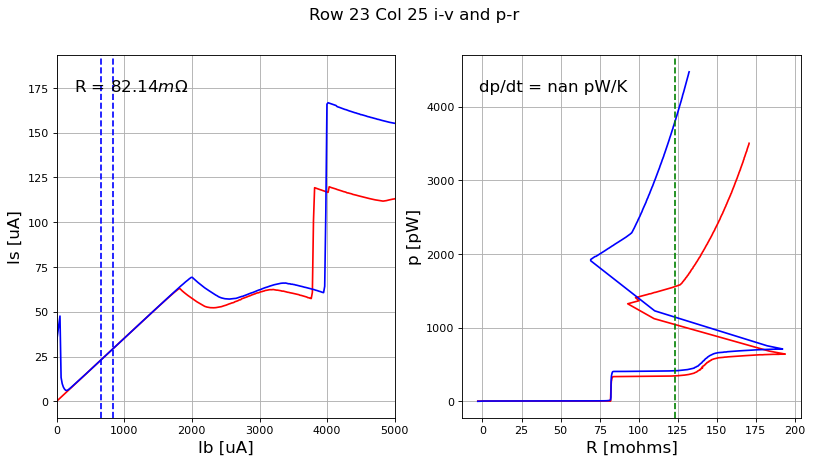

nan 0.08214240116356701
row 23, col 26


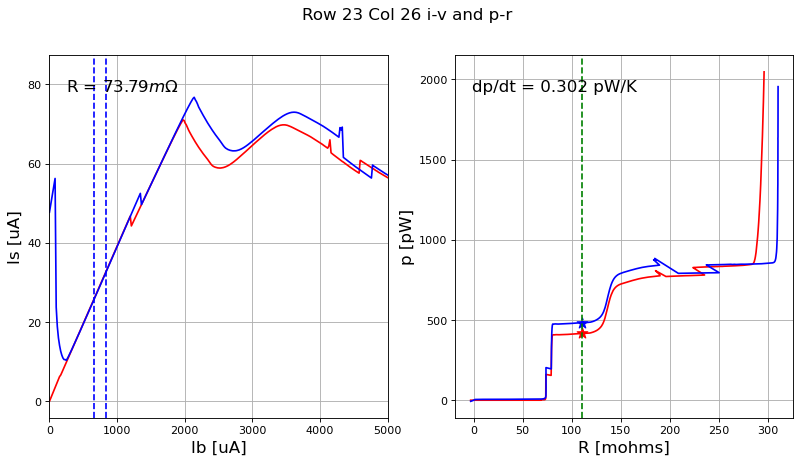

0.30168012190020294 0.07379112635891472
row 23, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


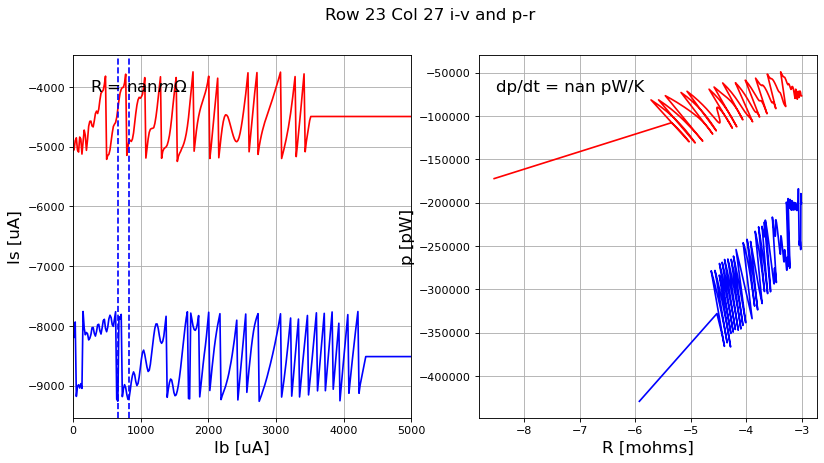

nan nan
row 23, col 28


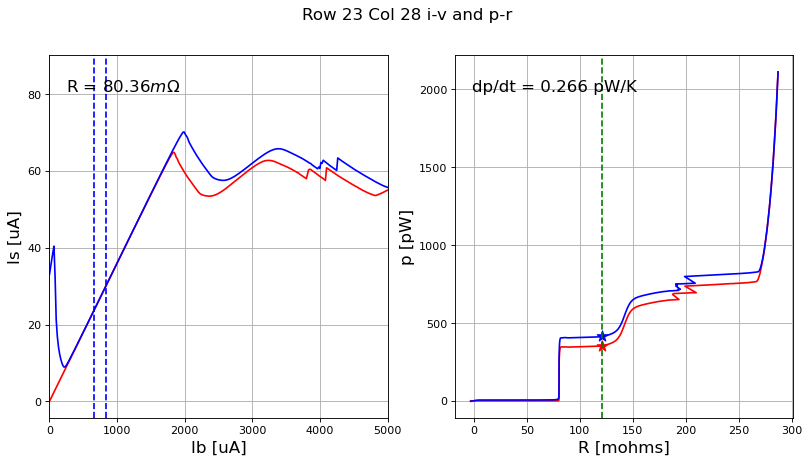

0.26605853251632317 0.08036018391800602
row 23, col 29


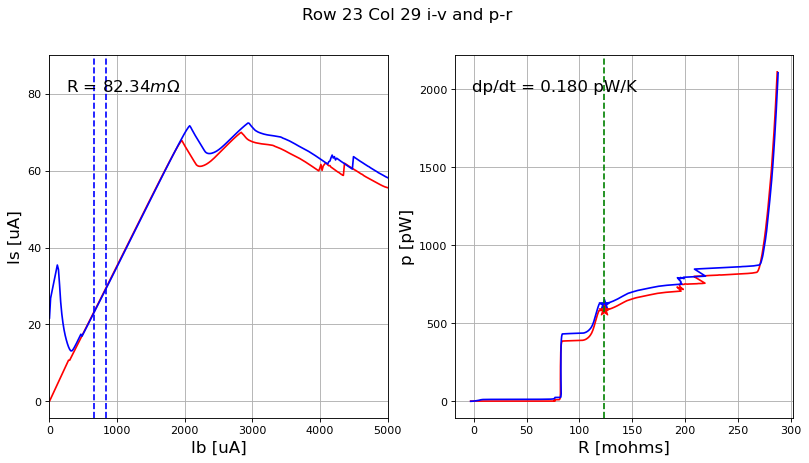

0.18039283745413726 0.08234322176082615
row 23, col 30


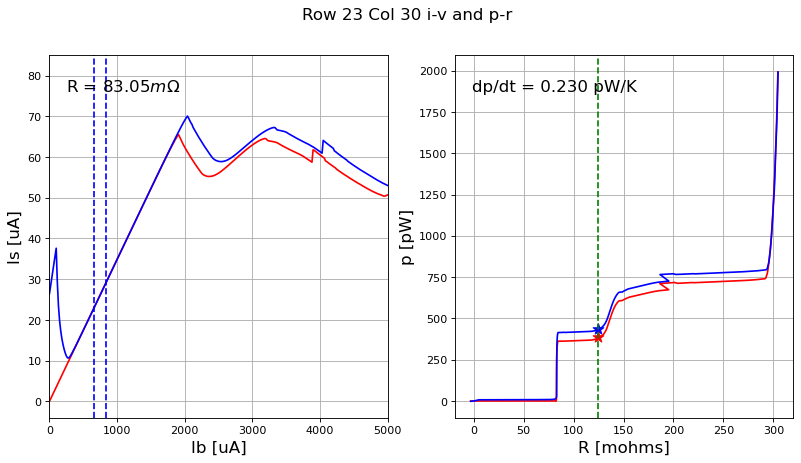

0.22962504012580914 0.08304630655769618
row 23, col 31


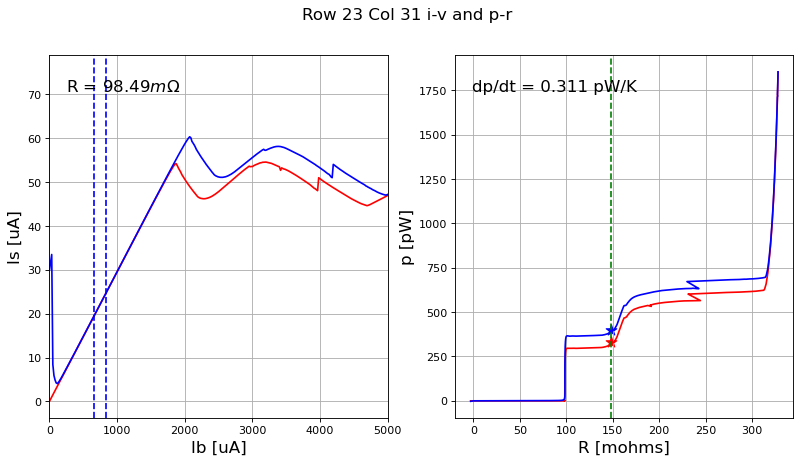

0.3114967679876349 0.09848989607417868
row 24, col 16


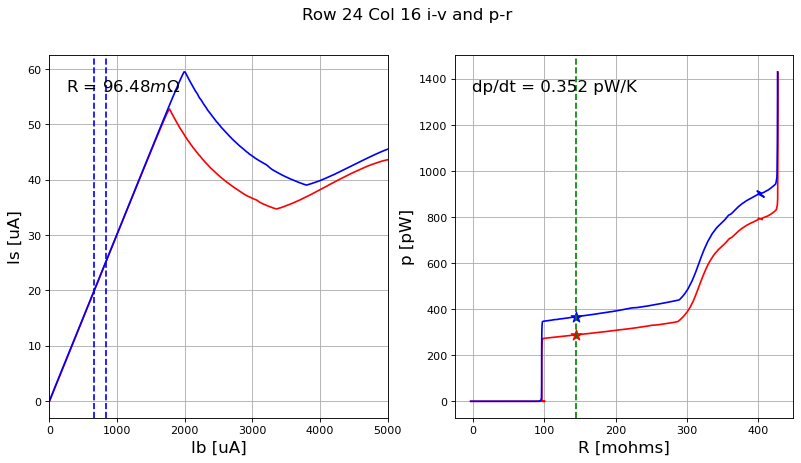

0.35203153177655105 0.09648295043921623
row 24, col 17


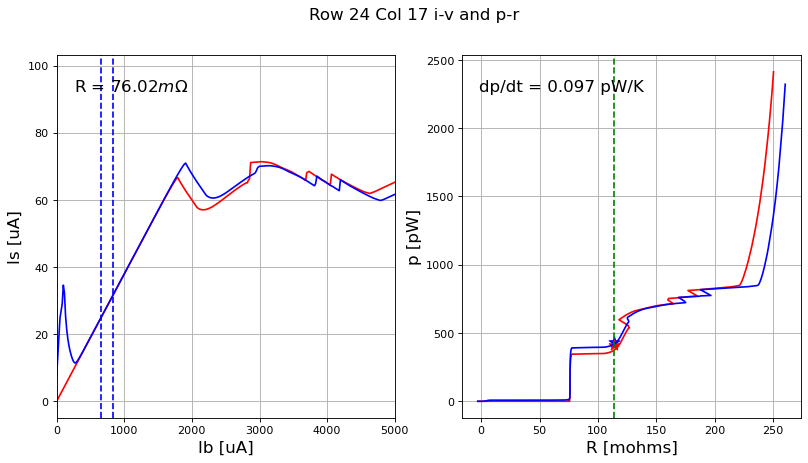

0.09680013770691552 0.07601944466827845
row 24, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


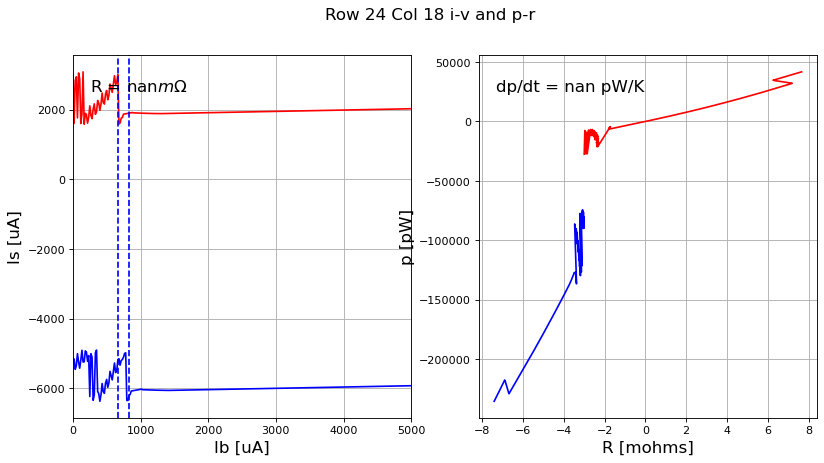

nan nan
row 24, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


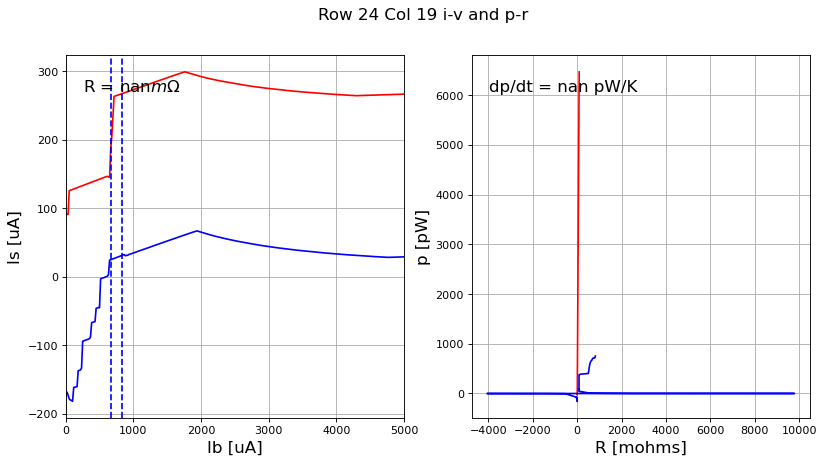

nan nan
row 24, col 20


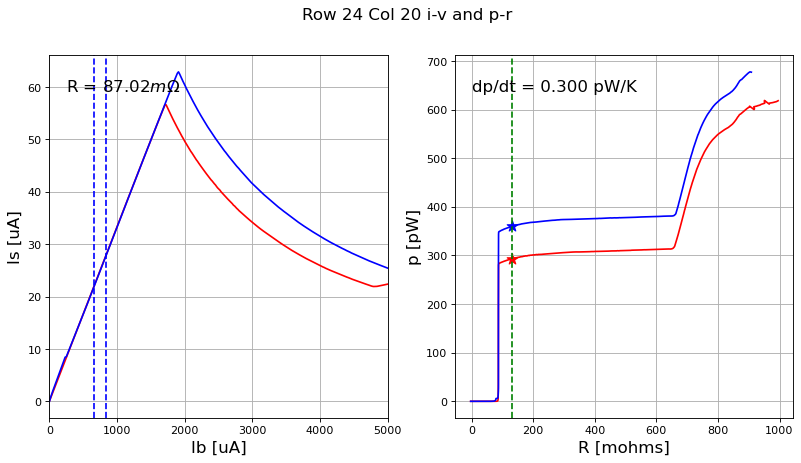

0.299591566144655 0.08702333081153413
row 24, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


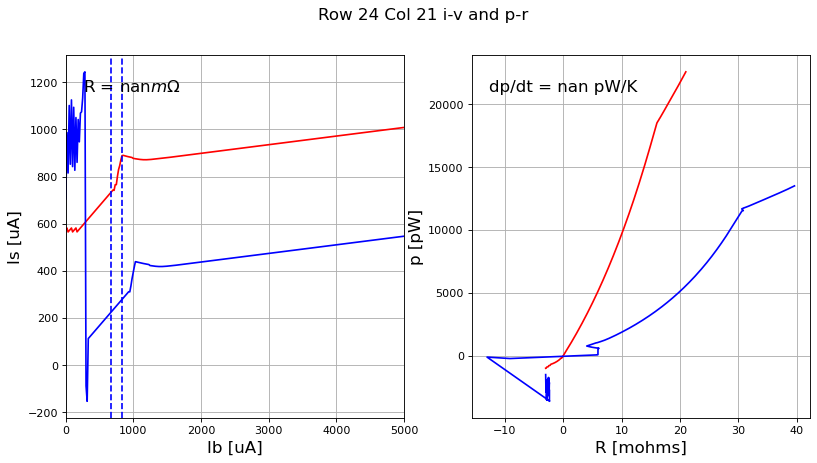

nan nan
row 24, col 22


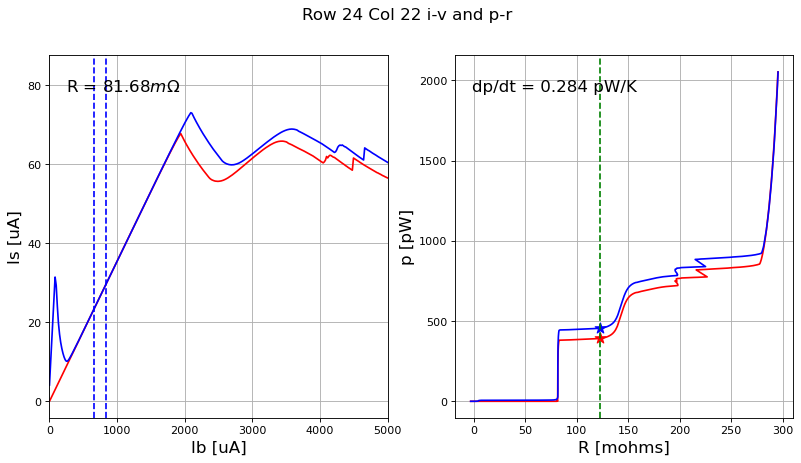

0.28423581006287957 0.08167901347557086
row 24, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


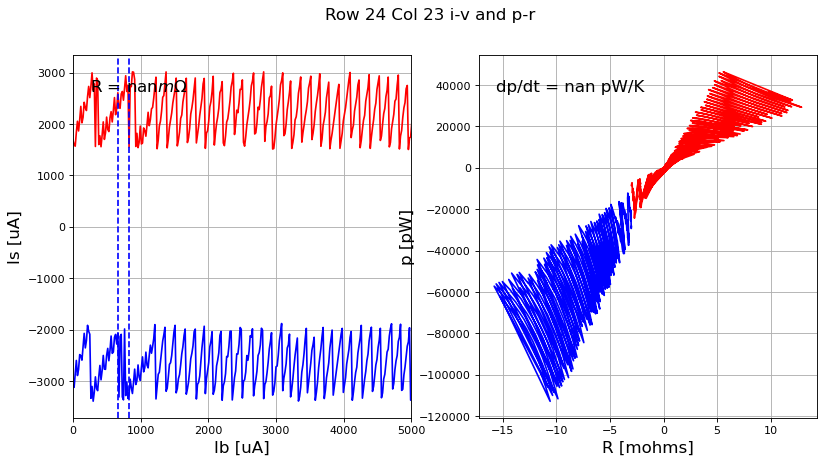

nan nan
row 24, col 24


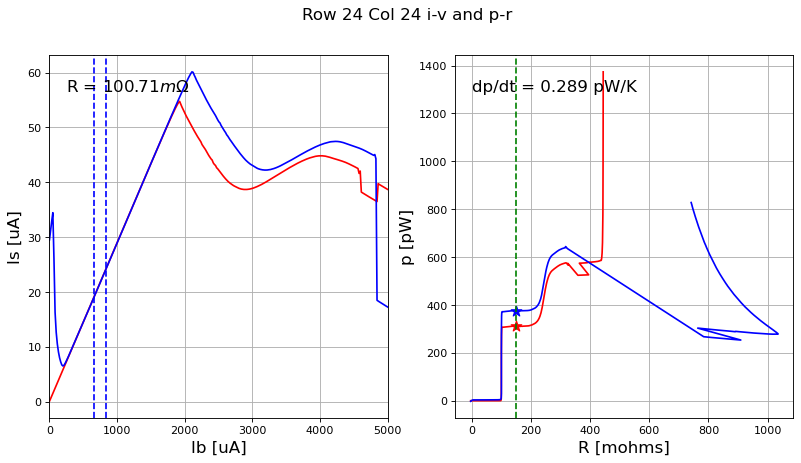

0.289435822800705 0.10070605744981789
row 24, col 25


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


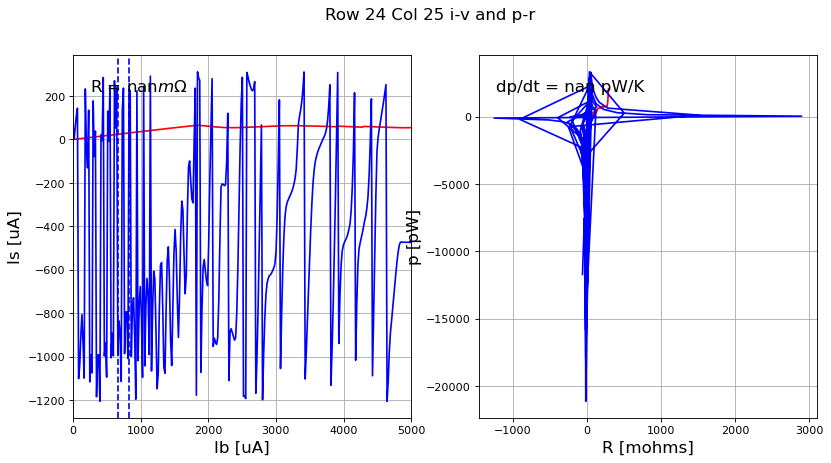

nan nan
row 24, col 26


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


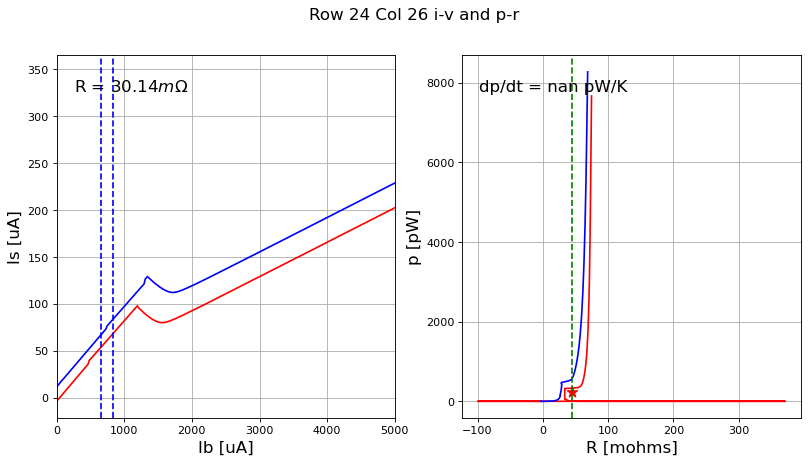

nan 0.030140709628165466
row 24, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


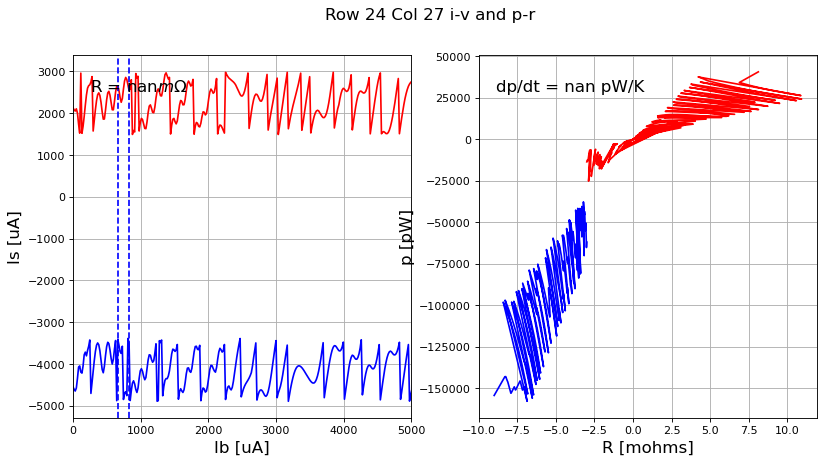

nan nan
row 24, col 28


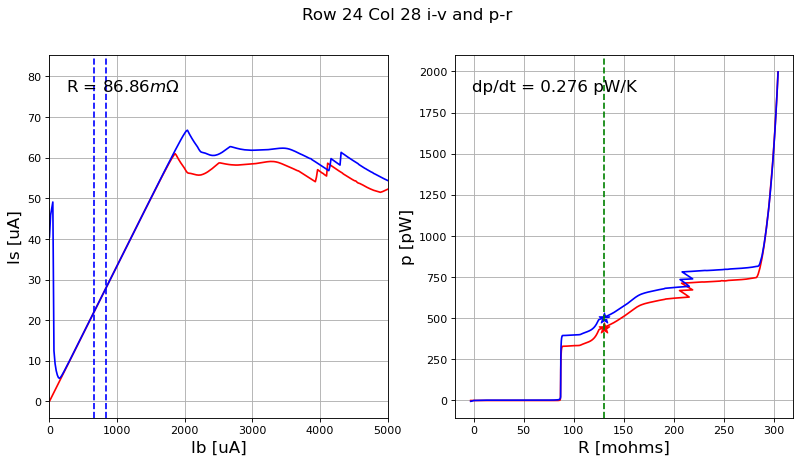

0.27558937230929004 0.08685698358853979
row 24, col 29


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


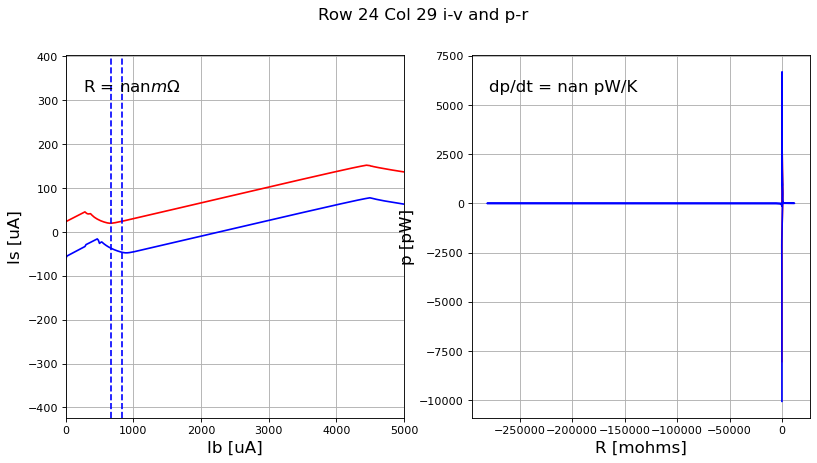

nan nan
row 24, col 30
#####################
30 24


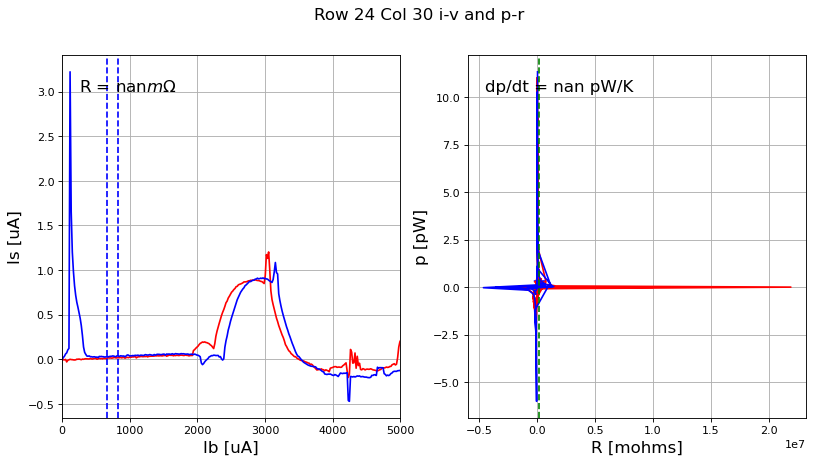

nan nan
row 24, col 31


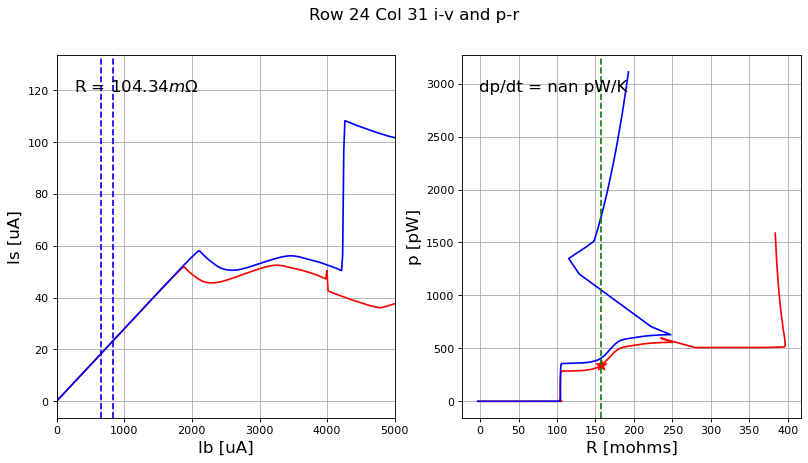

nan 0.10434143833922618
row 25, col 16


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


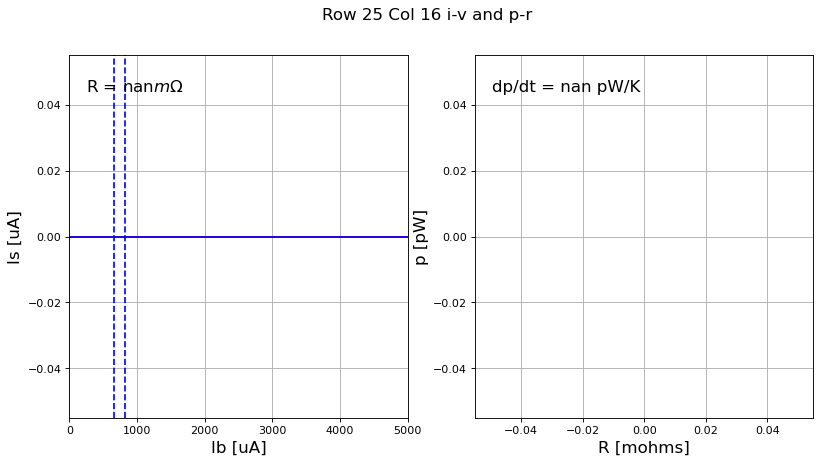

nan nan
row 25, col 17


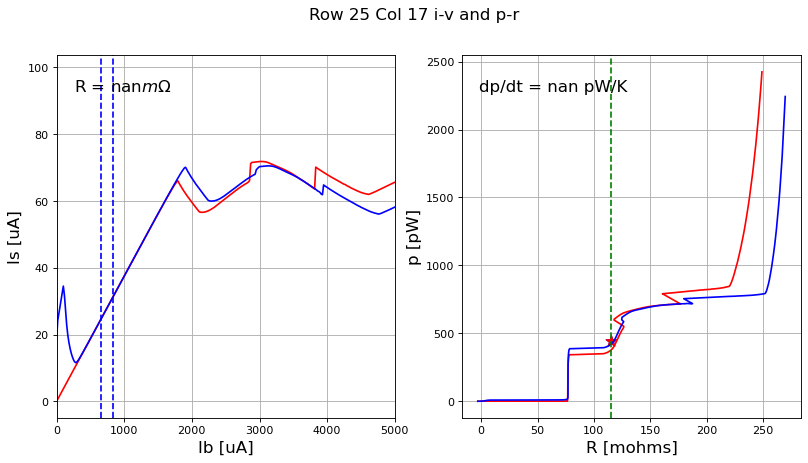

nan nan
row 25, col 18


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


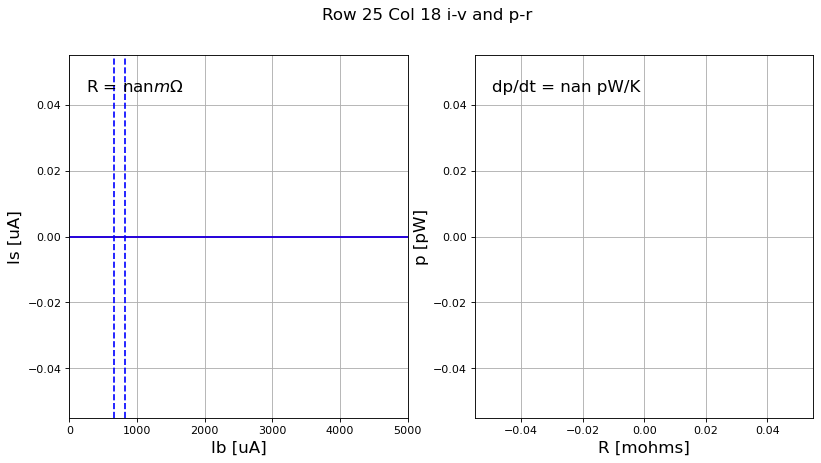

nan nan
row 25, col 19


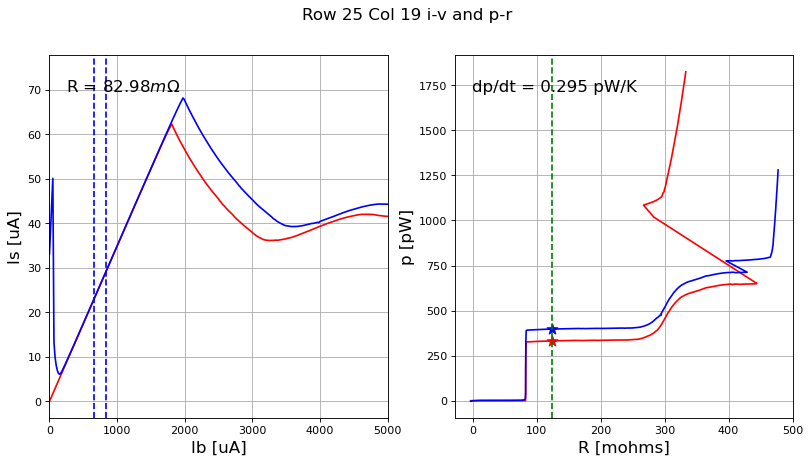

0.29542098037409575 0.08298210079772798
row 25, col 20


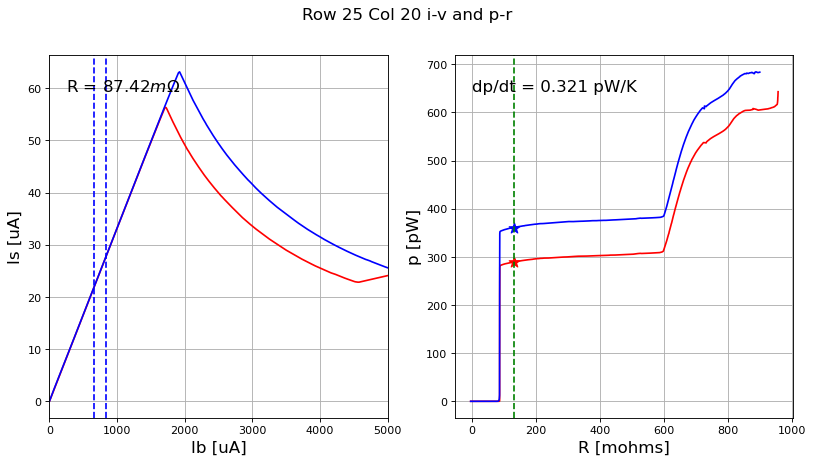

0.32102730477195957 0.08741826950521997
row 25, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


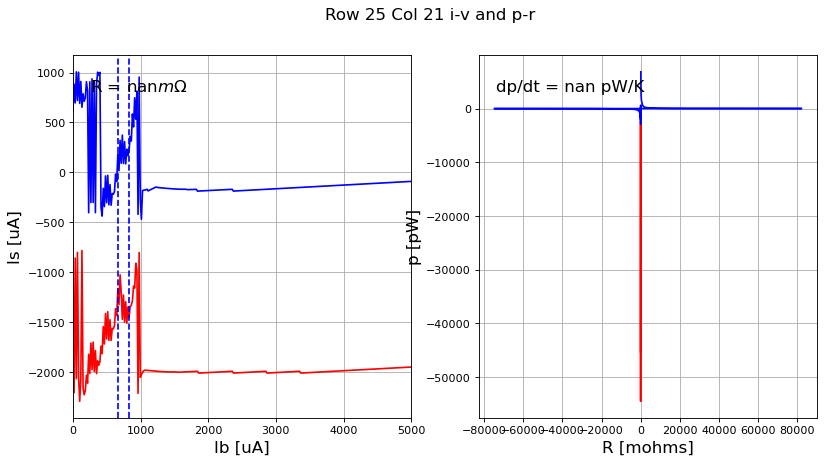

nan nan
row 25, col 22


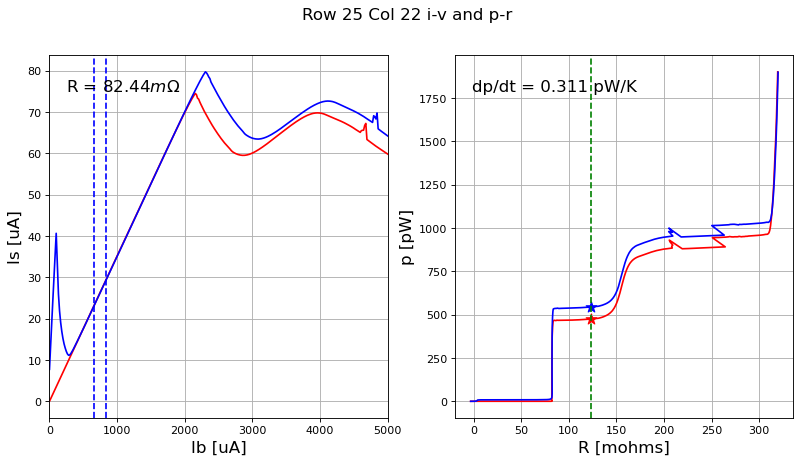

0.311411614471711 0.08243878341409827
row 25, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


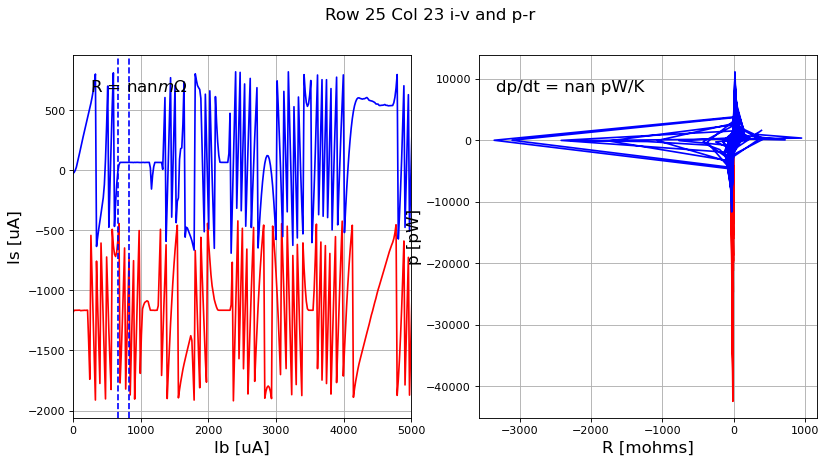

nan nan
row 25, col 24


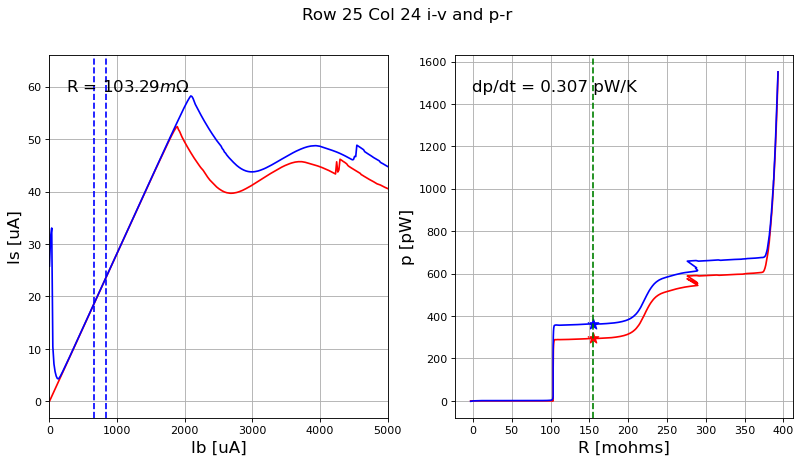

0.3067666072537857 0.10329180488673702
row 25, col 25


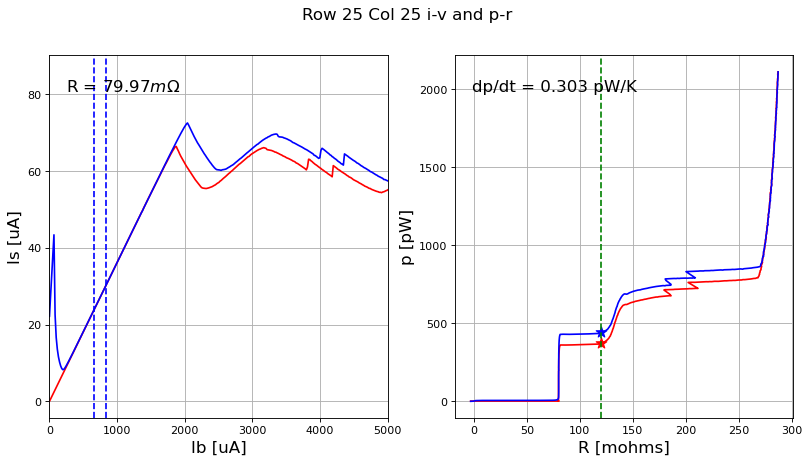

0.30321778933346216 0.07997128222336485
row 25, col 26


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


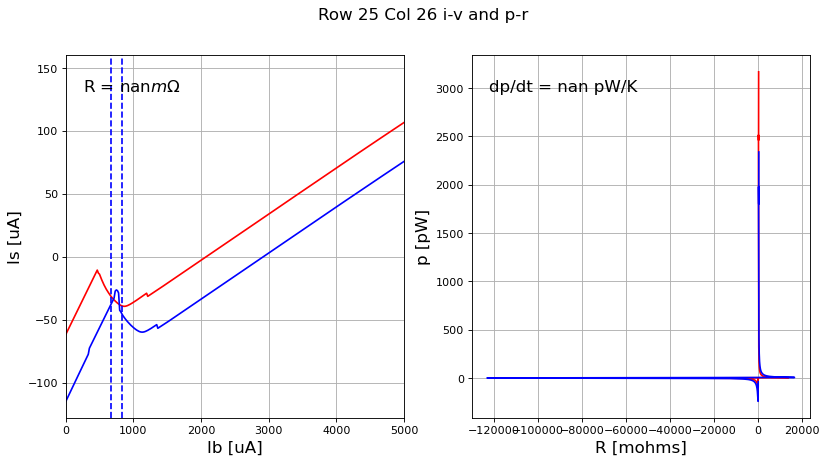

nan nan
row 25, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


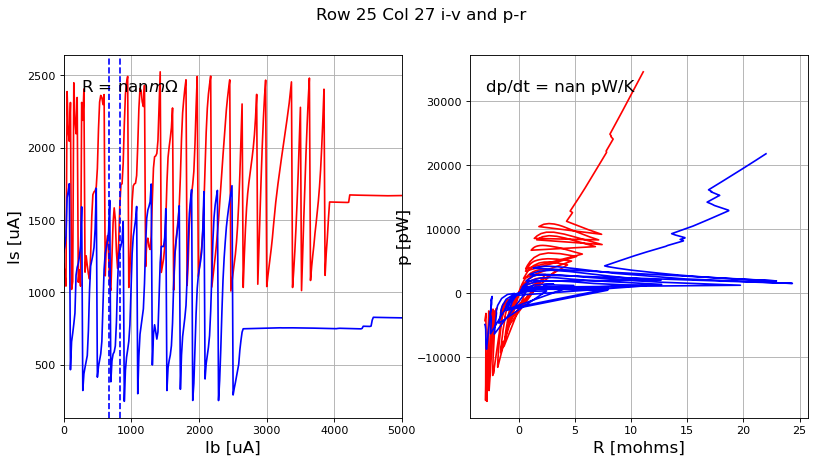

nan nan
row 25, col 28


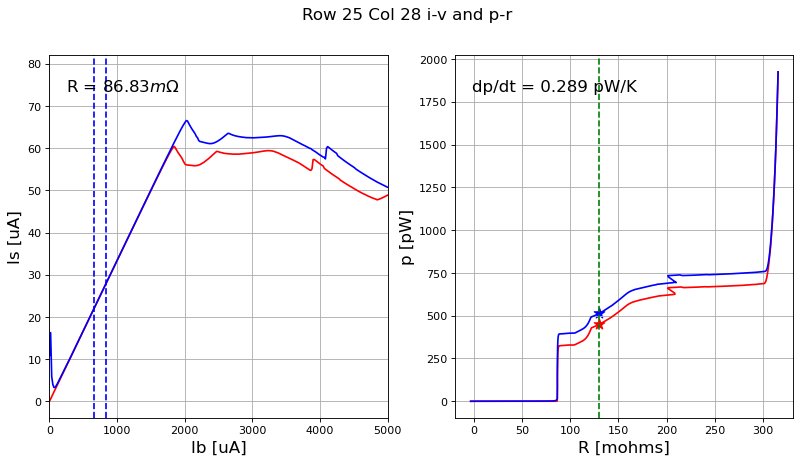

0.28904664055201196 0.08682939001924499
row 25, col 29


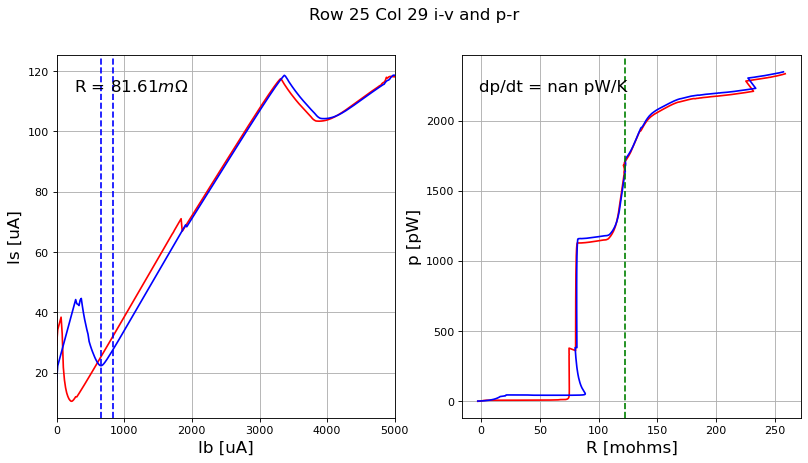

nan 0.08160695027170203
row 25, col 30


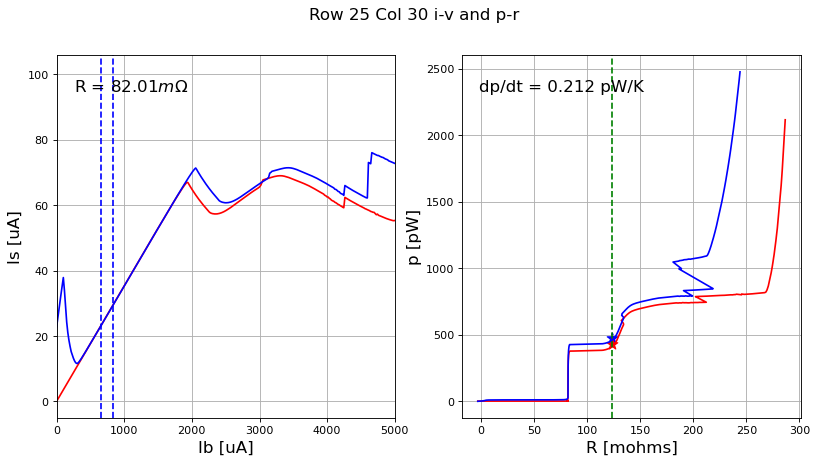

0.21190781187825863 0.0820142708885693
row 25, col 31


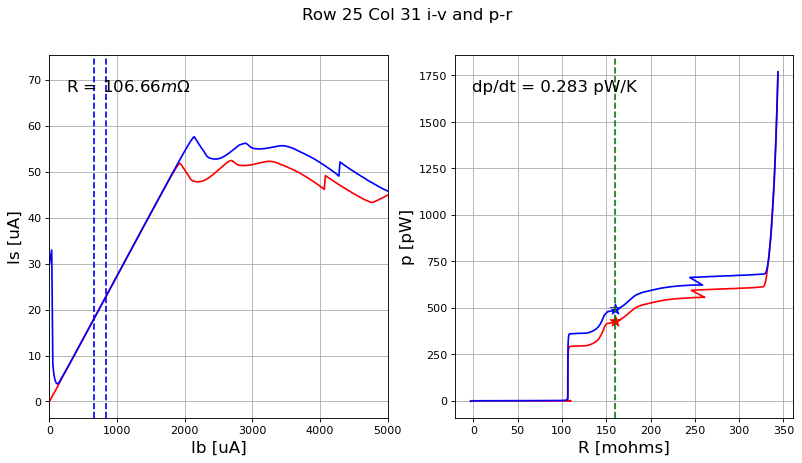

0.2834897878802714 0.10666362110404422
row 26, col 16


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


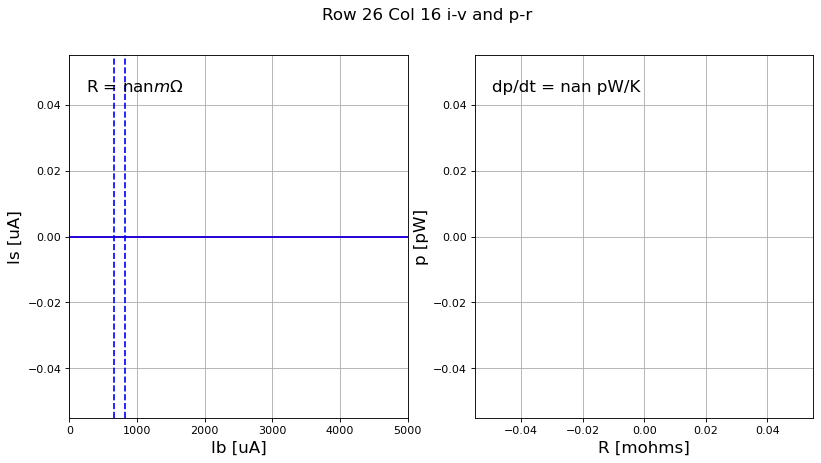

nan nan
row 26, col 17
#####################
17 26


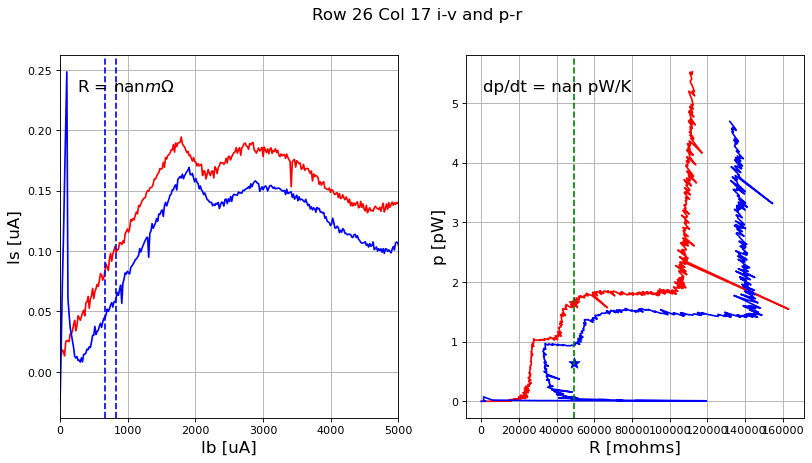

nan nan
row 26, col 18


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


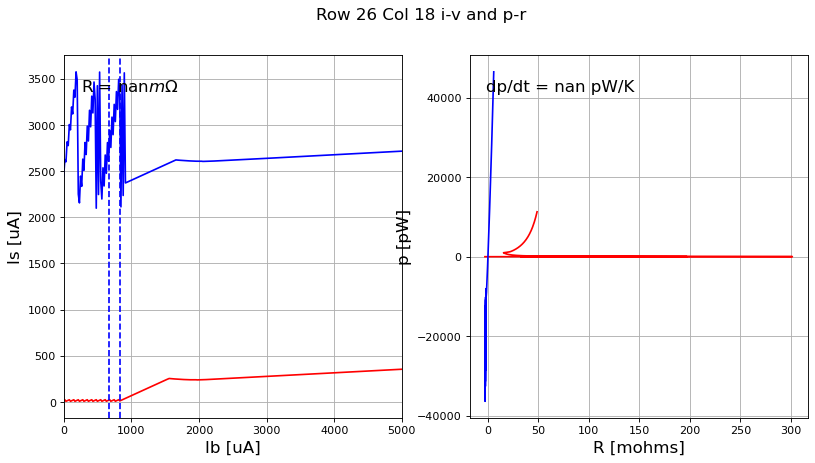

nan nan
row 26, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


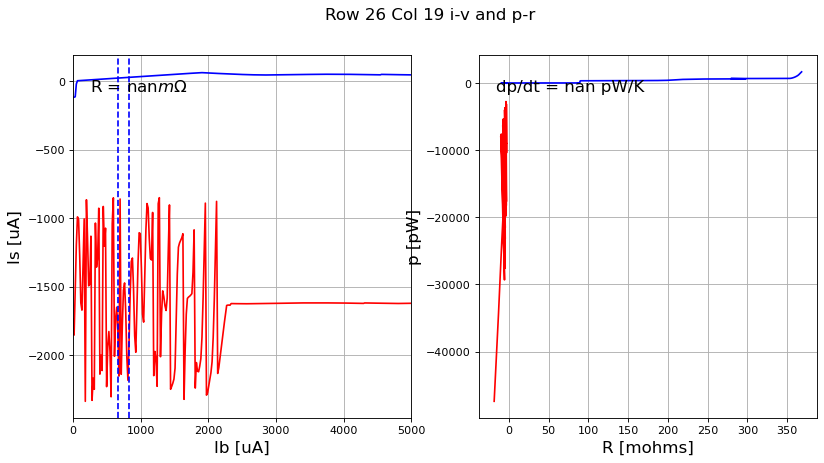

nan nan
row 26, col 20


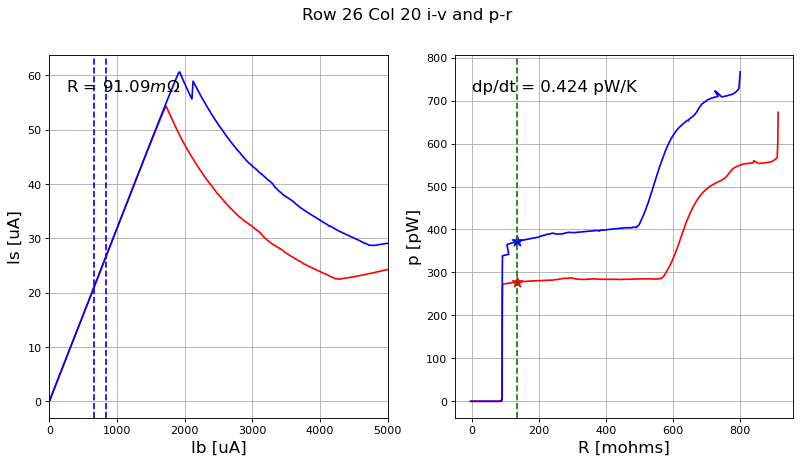

0.42368222377246256 0.09109109263833816
row 26, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


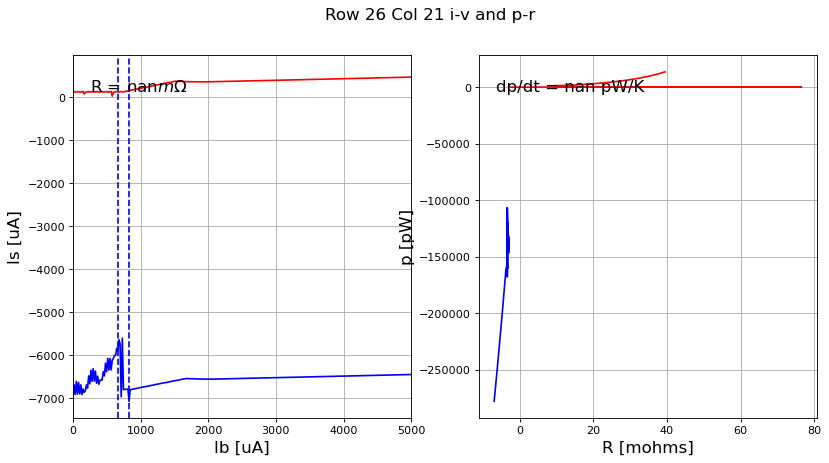

nan nan
row 26, col 22


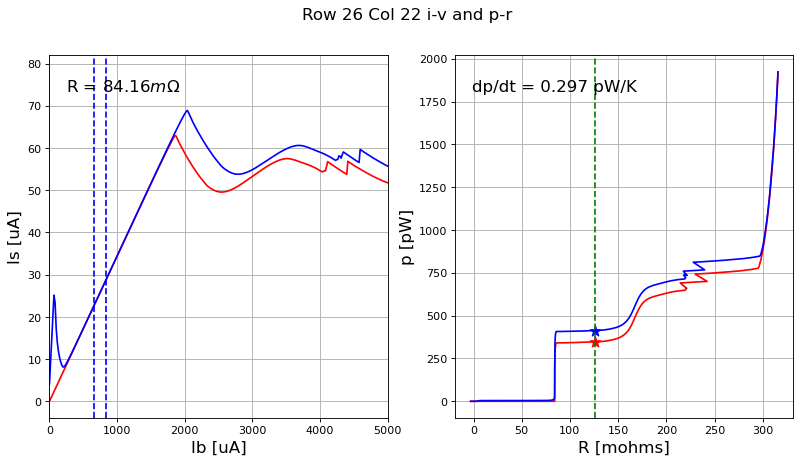

0.2967473201683967 0.08416290486271552
row 26, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


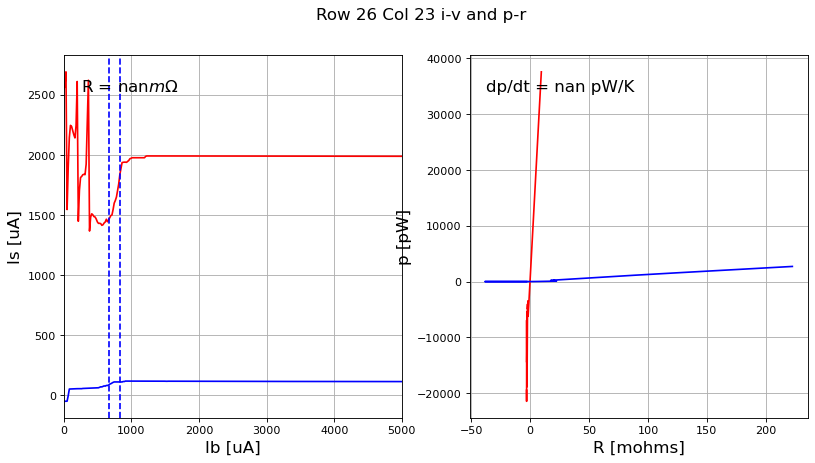

nan nan
row 26, col 24


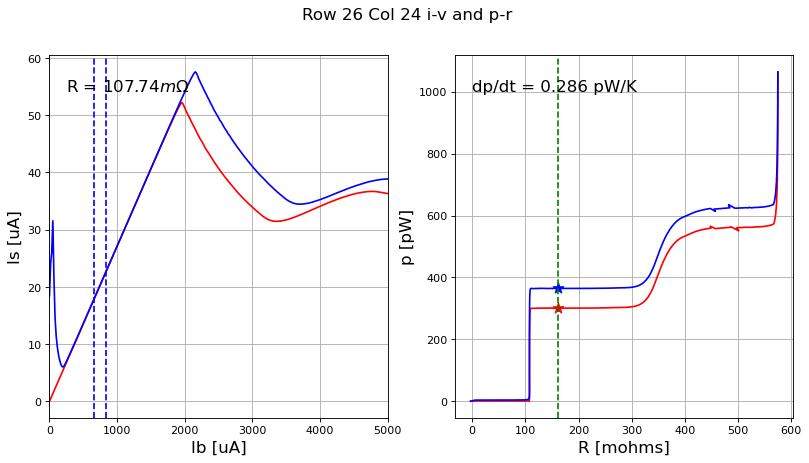

0.28568084882338246 0.10774082381107178
row 26, col 25


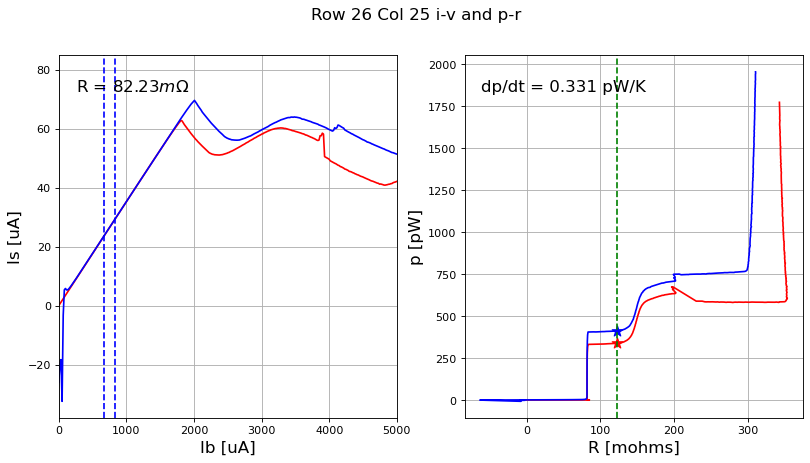

0.3305347409981159 0.08222920277967127
row 26, col 26


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


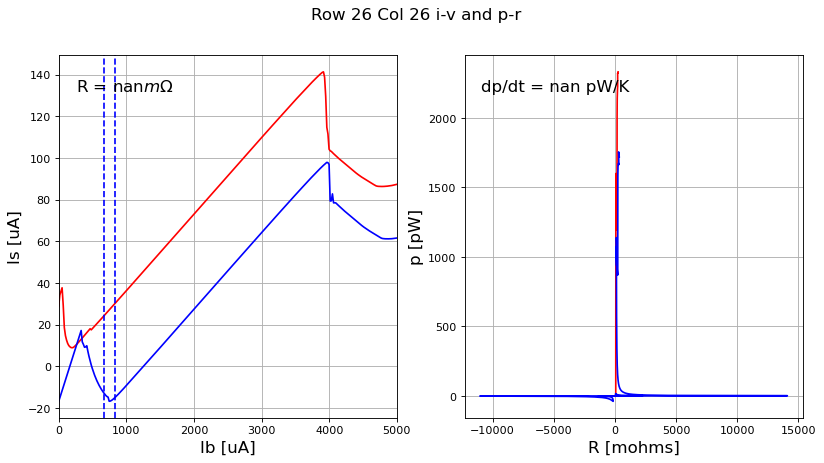

nan nan
row 26, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


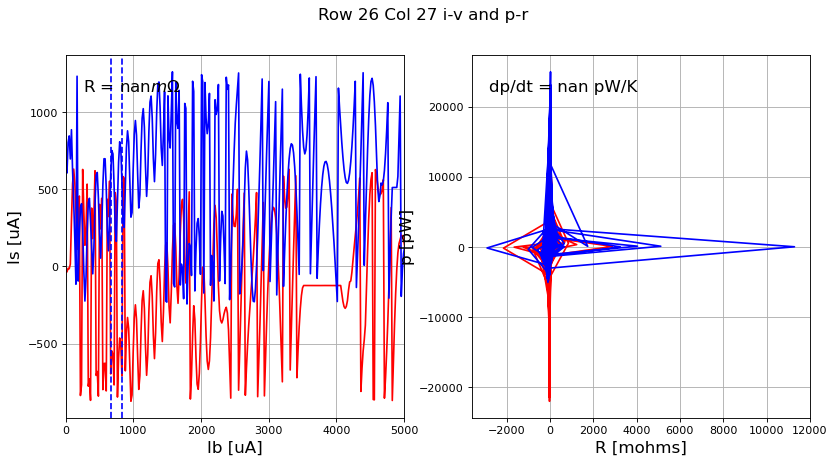

nan nan
row 26, col 28


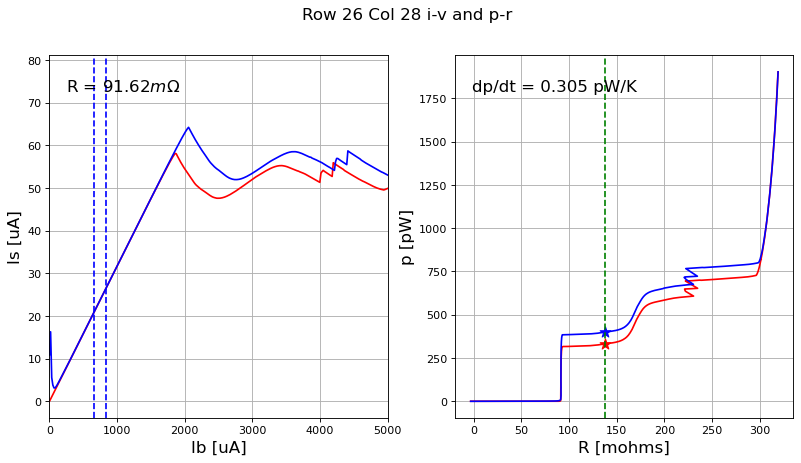

0.3048803272552423 0.09161850905130452
row 26, col 29


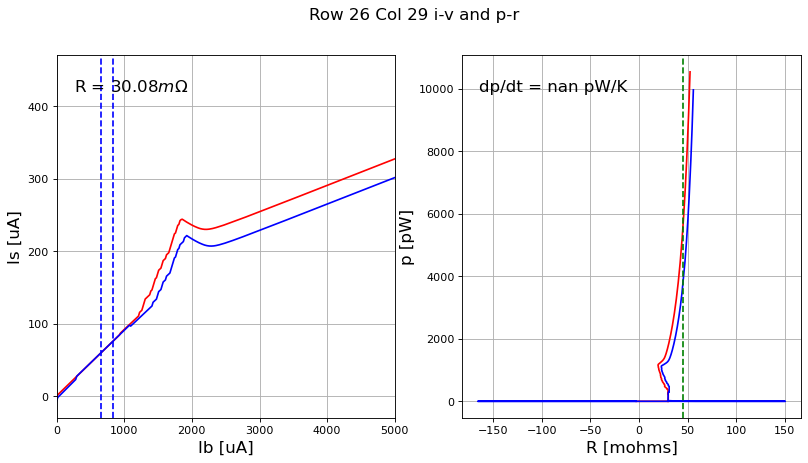

nan 0.030079212468439732
row 26, col 30


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


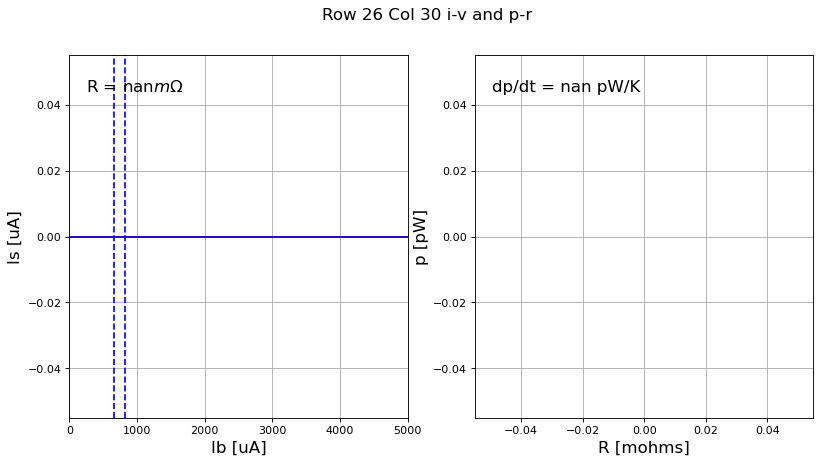

nan nan
row 26, col 31


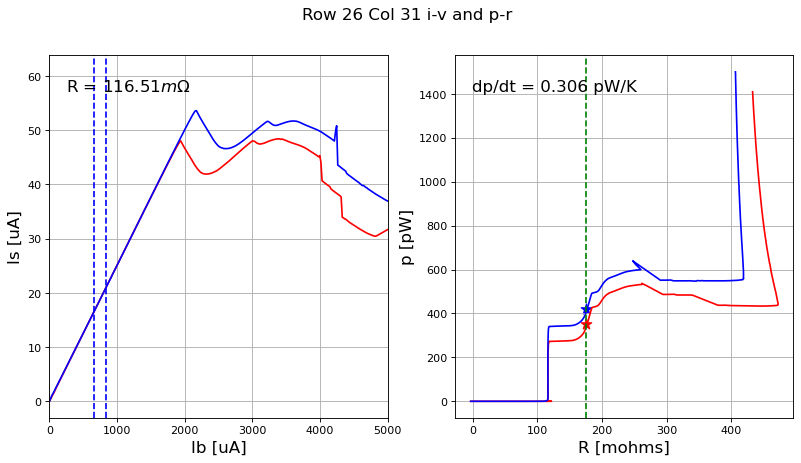

0.306135827295714 0.11650768177502922
row 27, col 16


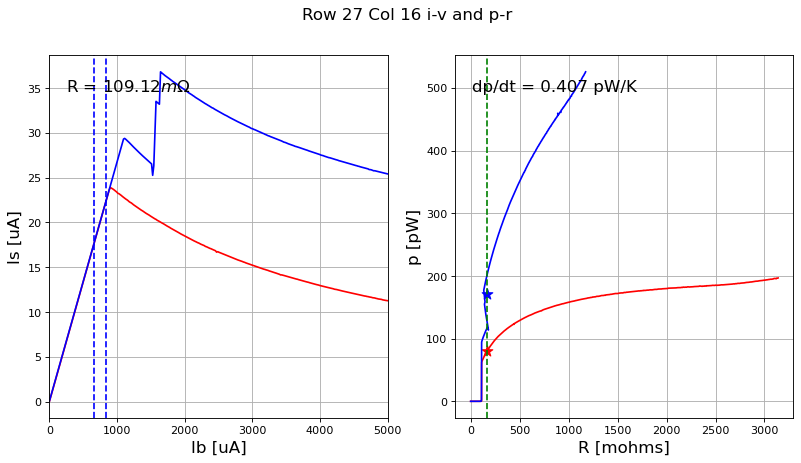

0.4071063053283092 0.10911795755456685
row 27, col 17
#####################
17 27


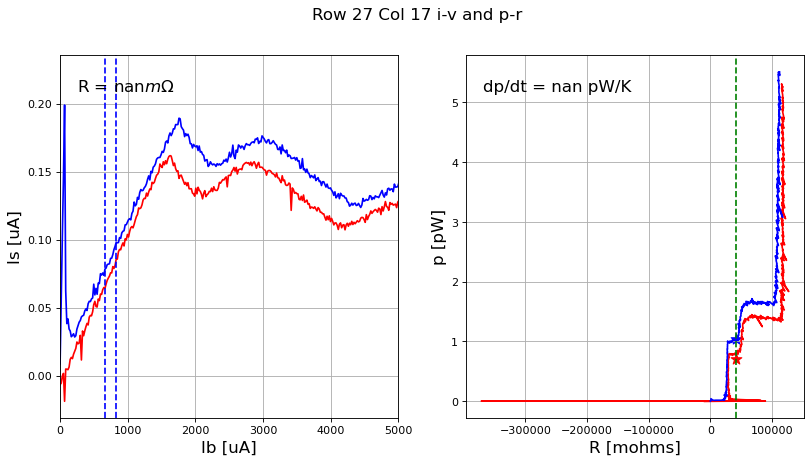

nan nan
row 27, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


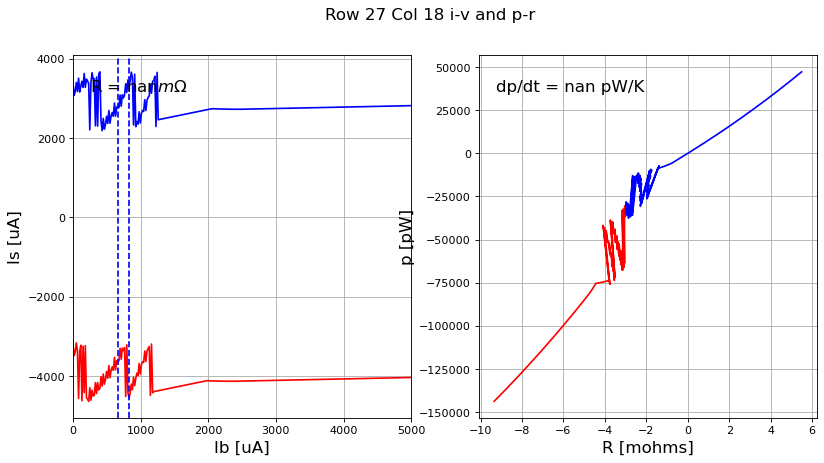

nan nan
row 27, col 19


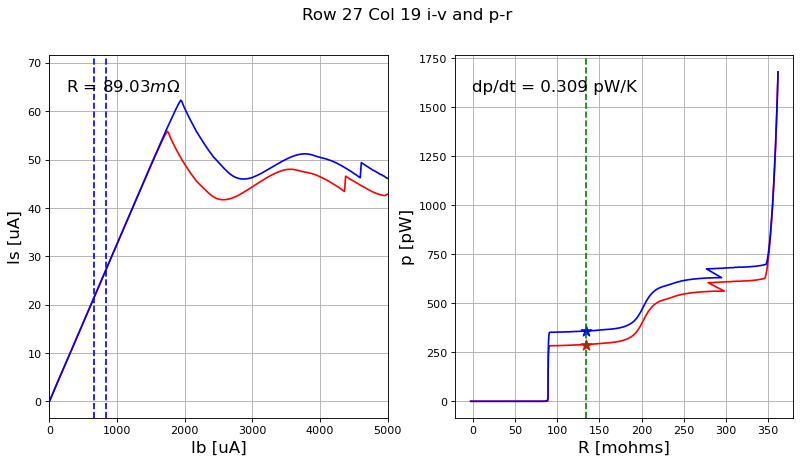

0.30877215454779544 0.08903333180646177
row 27, col 20


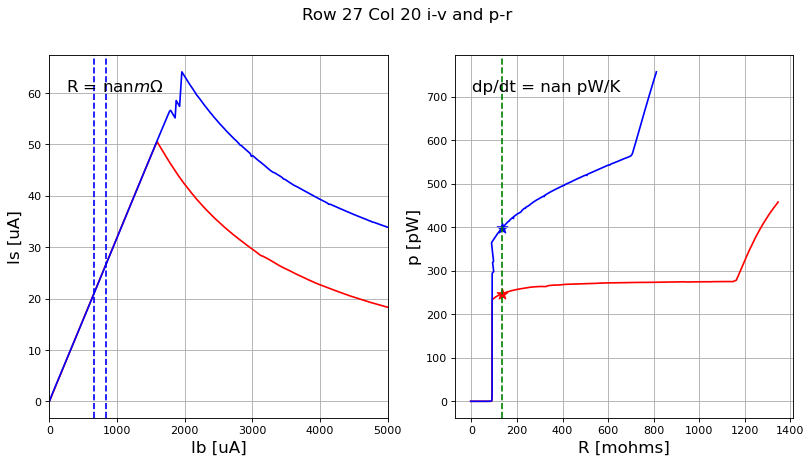

nan nan
row 27, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


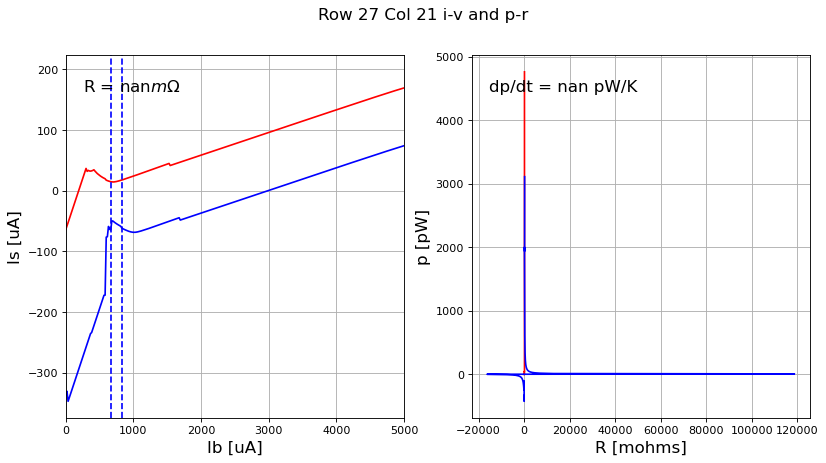

nan nan
row 27, col 22


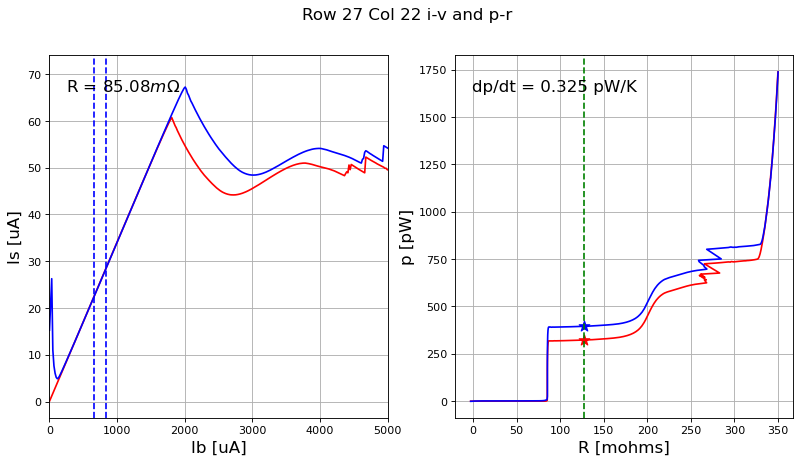

0.32468272637558915 0.0850818926745809
row 27, col 23


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


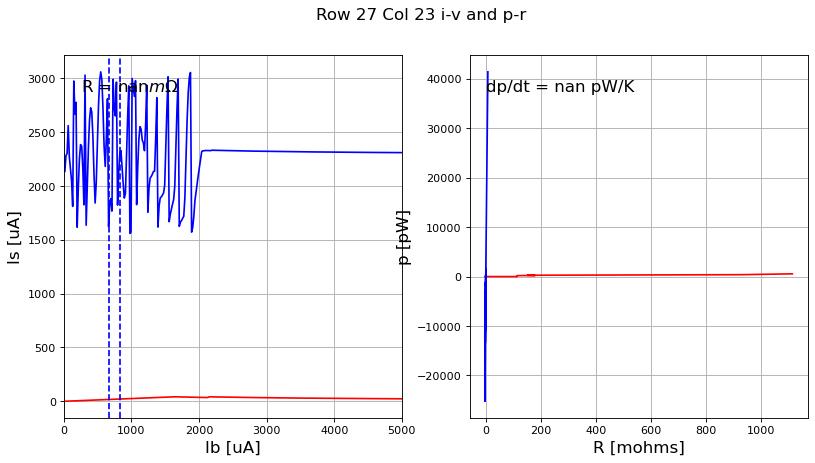

nan nan
row 27, col 24


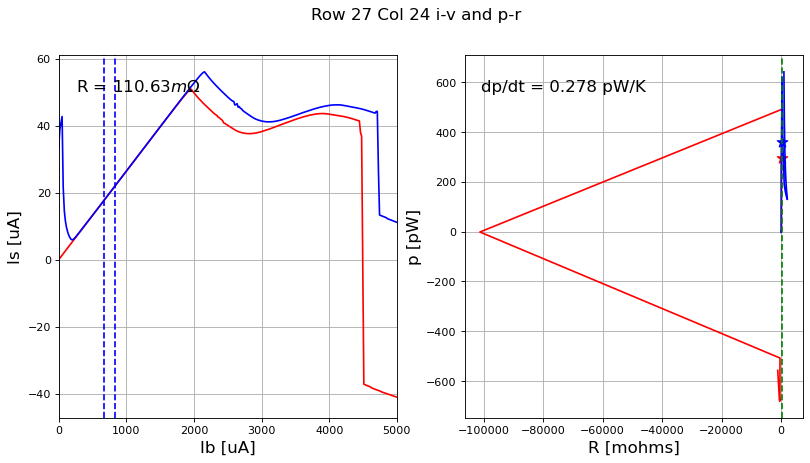

0.27803183078598215 0.11063139953615204
row 27, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


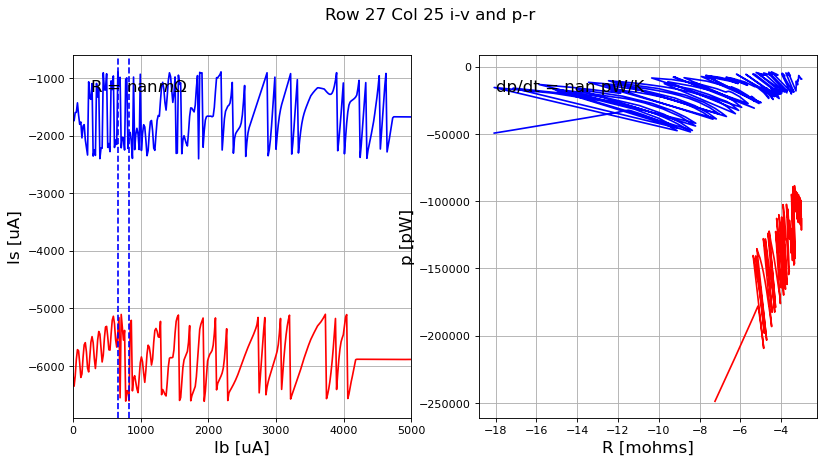

nan nan
row 27, col 26


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


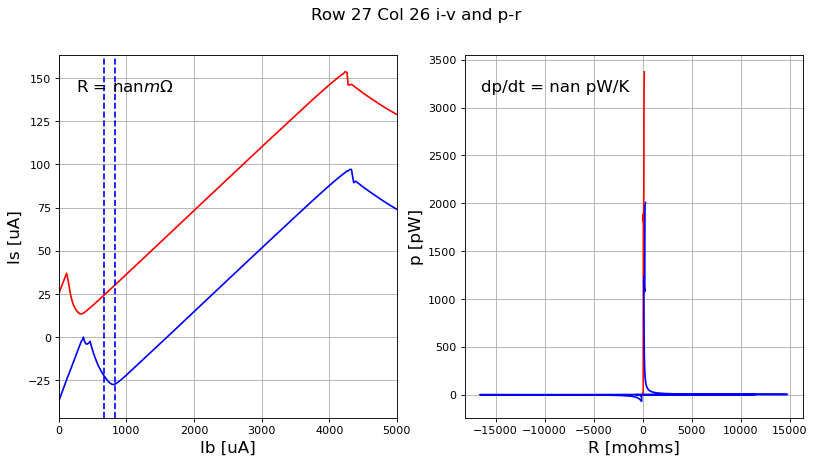

nan nan
row 27, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


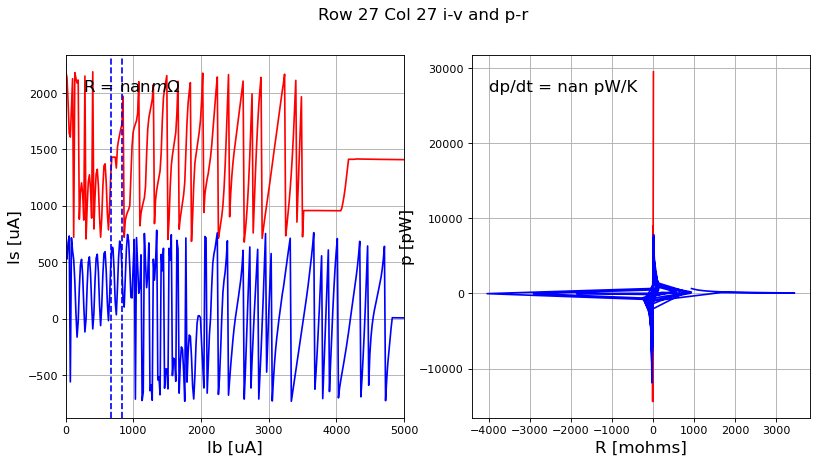

nan nan
row 27, col 28


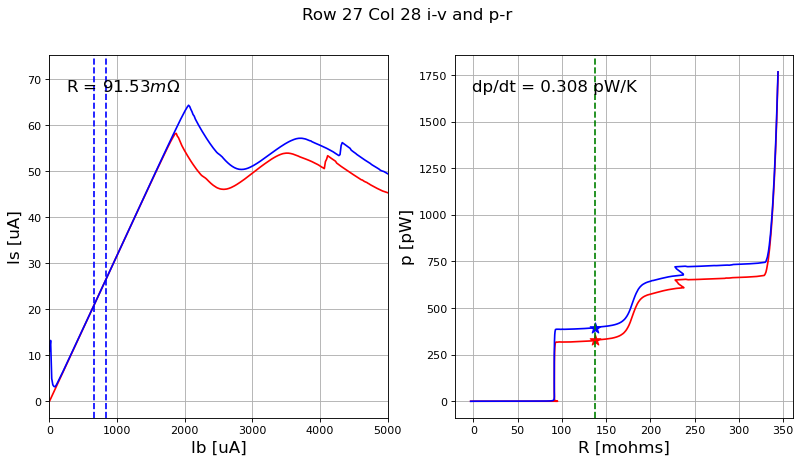

0.3077601999701685 0.09153299306862989
row 27, col 29


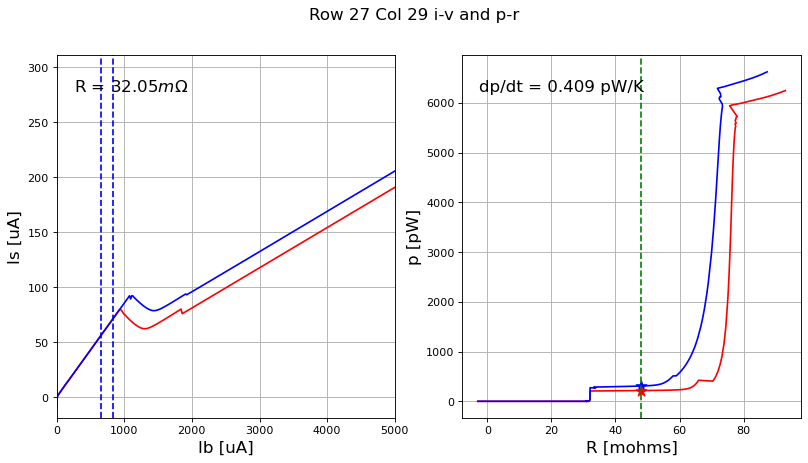

0.40884422273199394 0.03204831557909395
row 27, col 30


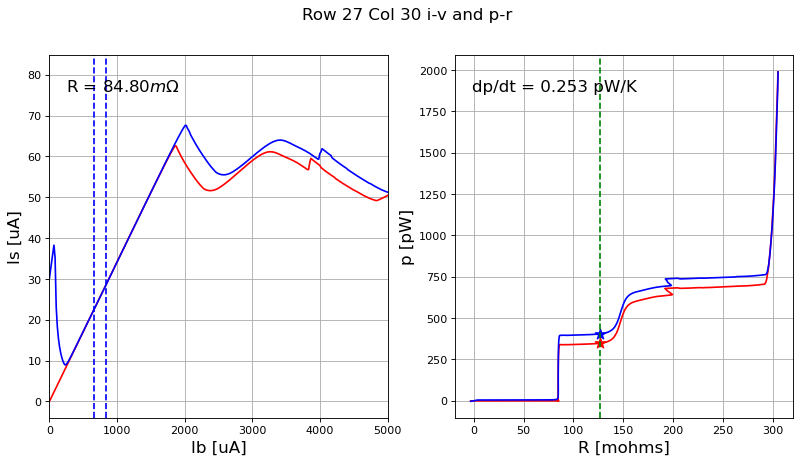

0.2528442291113009 0.0848009729174667
row 27, col 31


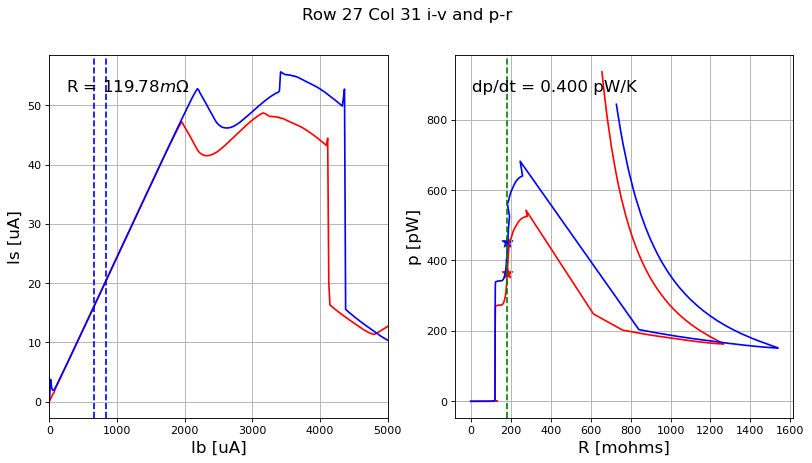

0.3995750468111869 0.11978317715393913
row 28, col 16


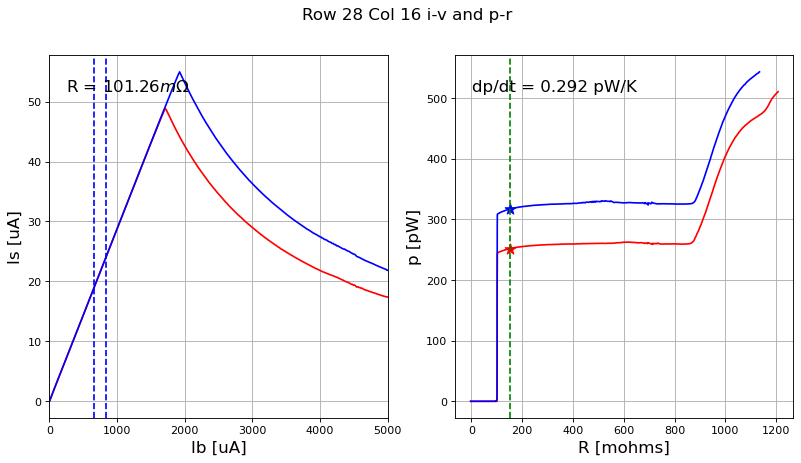

0.292002631890307 0.10126135286356784
row 28, col 17


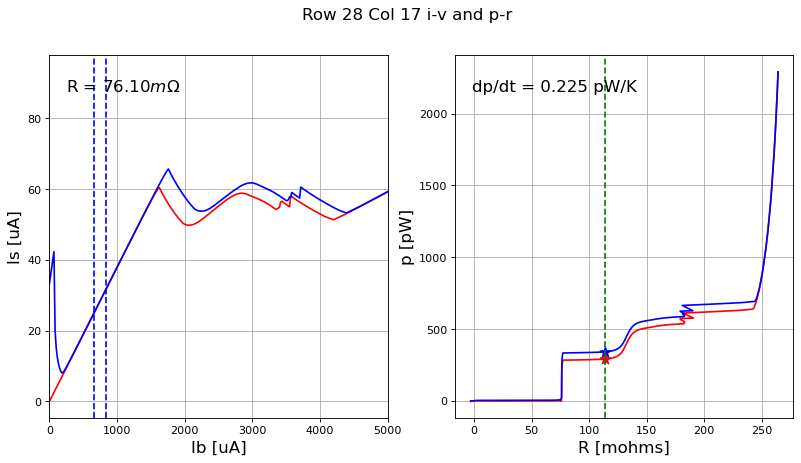

0.22537603217071603 0.07610316050292193
row 28, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


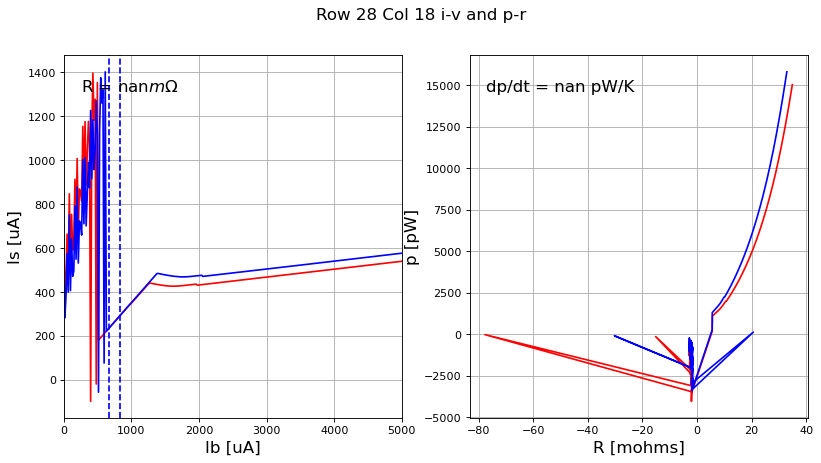

nan nan
row 28, col 19


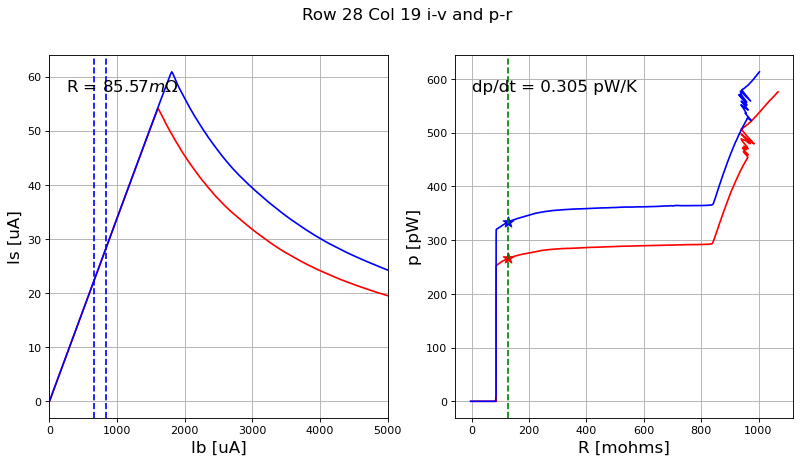

0.3046822566754294 0.08557341244082475
row 28, col 20


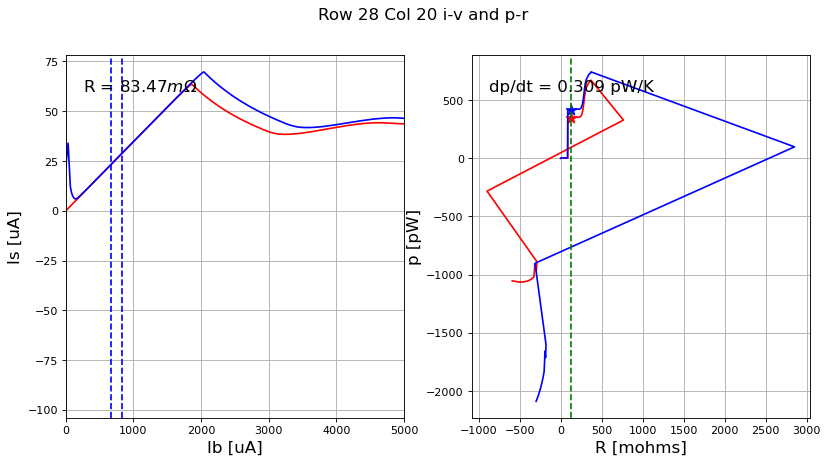

0.3087793052365767 0.08346635488066152
row 28, col 21


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


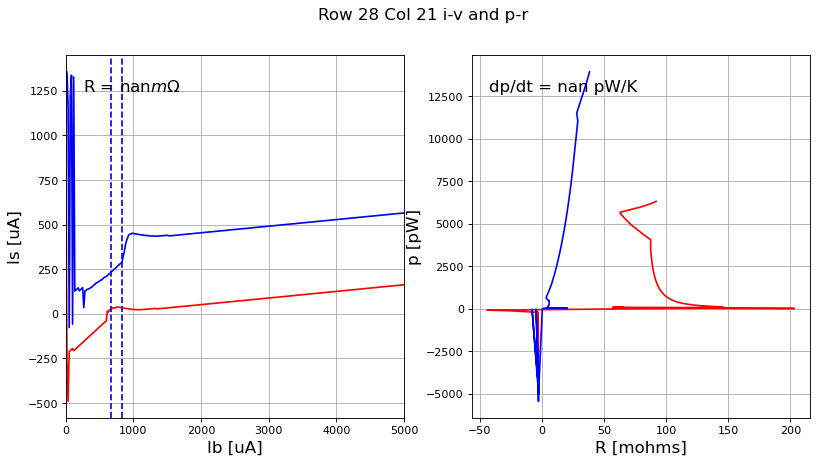

nan nan
row 28, col 22


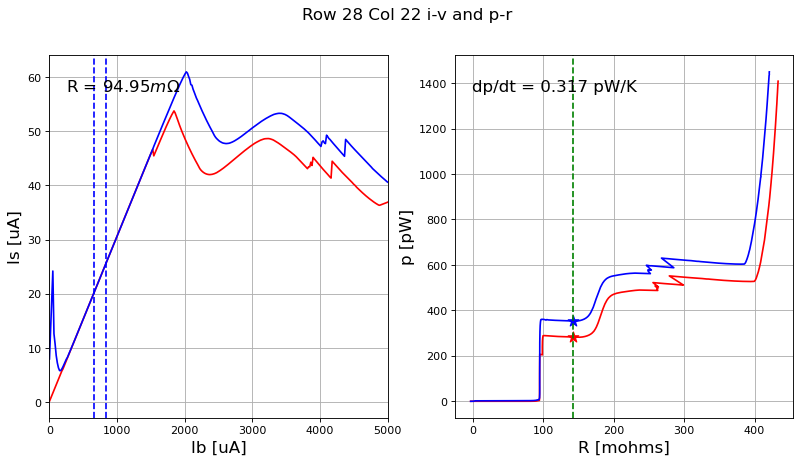

0.3165230871140664 0.0949516547567945
row 28, col 23
#####################
23 28


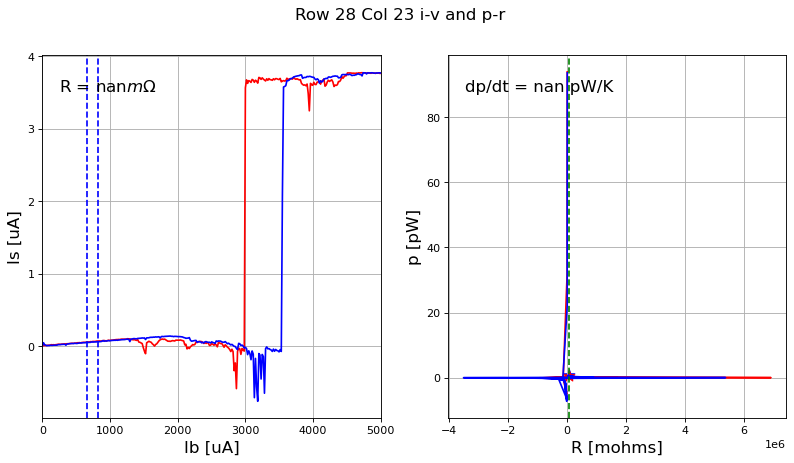

nan nan
row 28, col 24


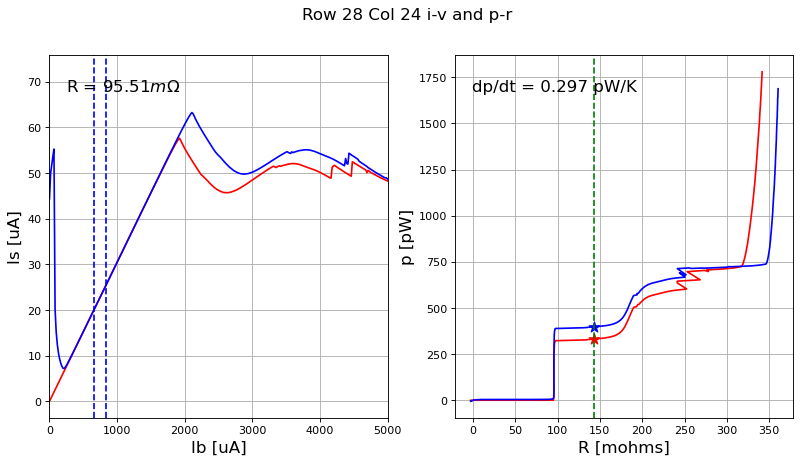

0.296932914481955 0.09551300023177783
row 28, col 25


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


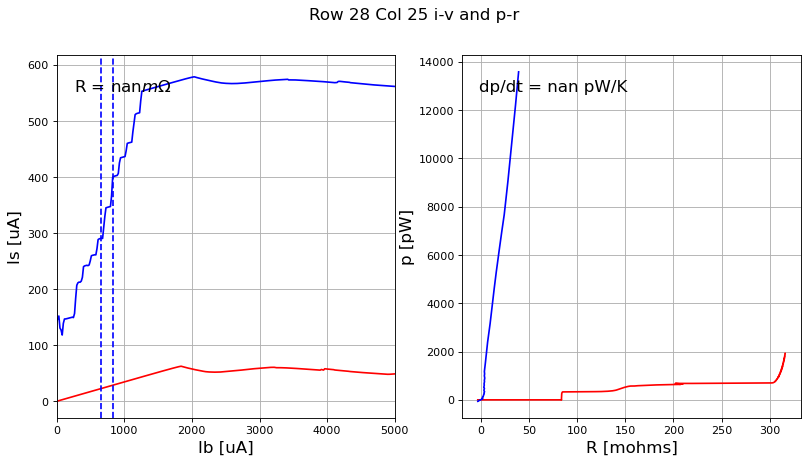

nan nan
row 28, col 26


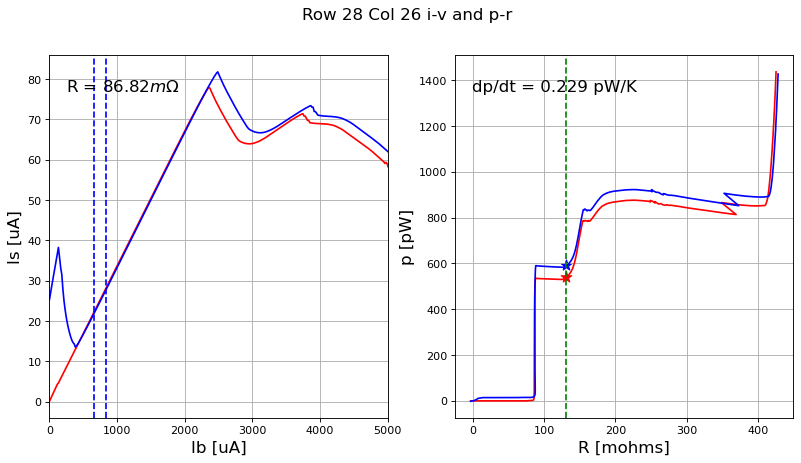

0.22898969239700528 0.08682119436672577
row 28, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


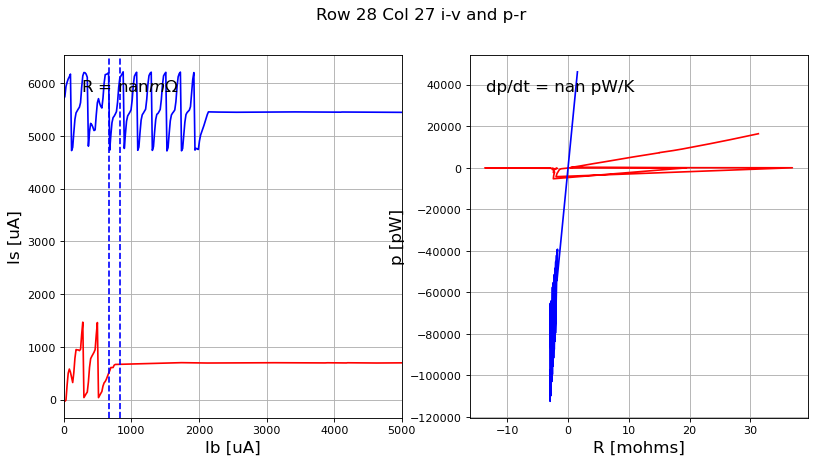

nan nan
row 28, col 28


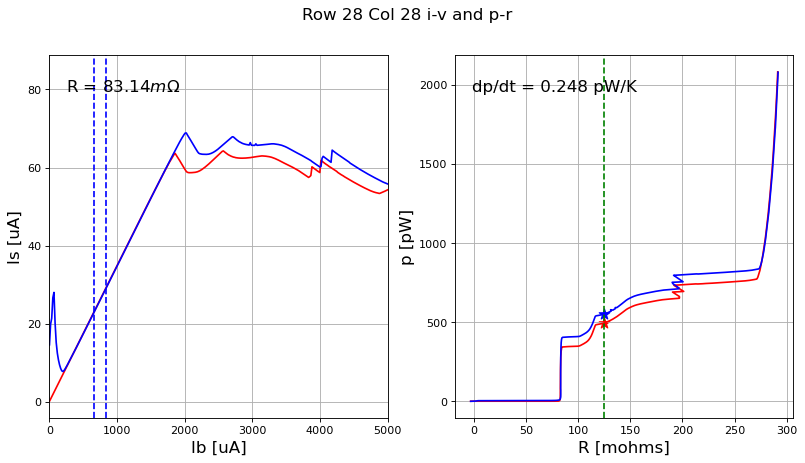

0.2475786243682277 0.08313736579244471
row 28, col 29


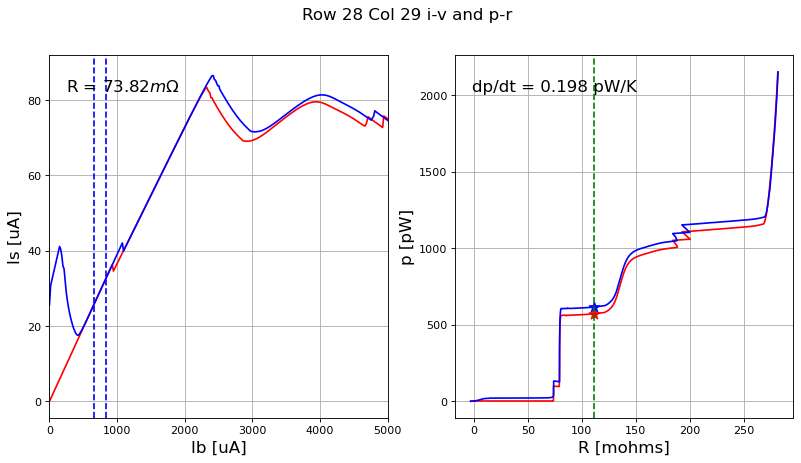

0.1976752833322055 0.07382471037797289
row 28, col 30


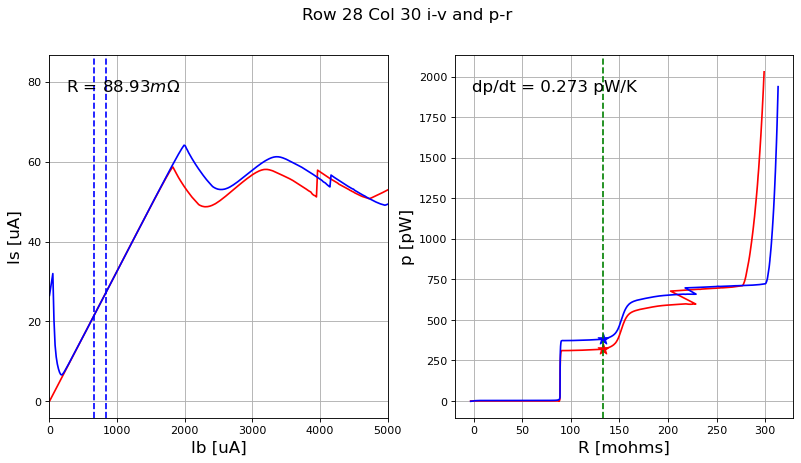

0.27306615382358207 0.08893499708512884
row 28, col 31


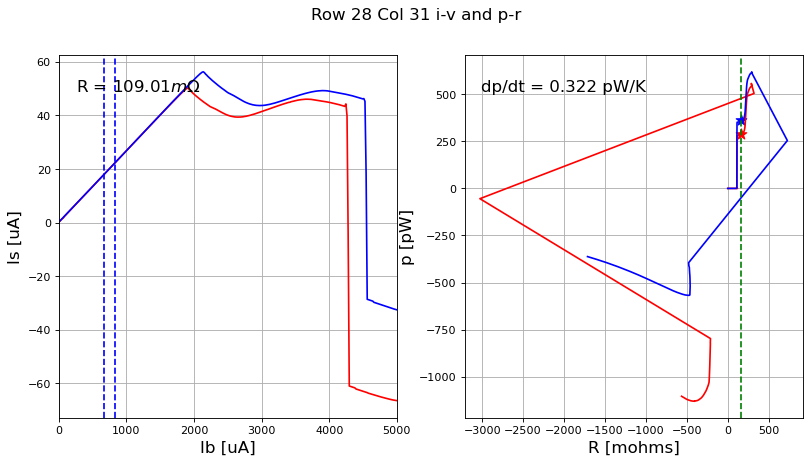

0.3218236040510555 0.1090106766711322
row 29, col 16


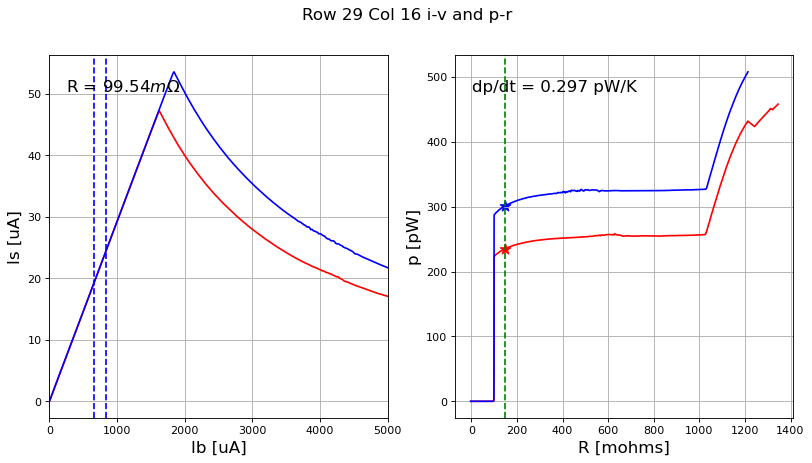

0.2967740500131908 0.09954264330300903
row 29, col 17


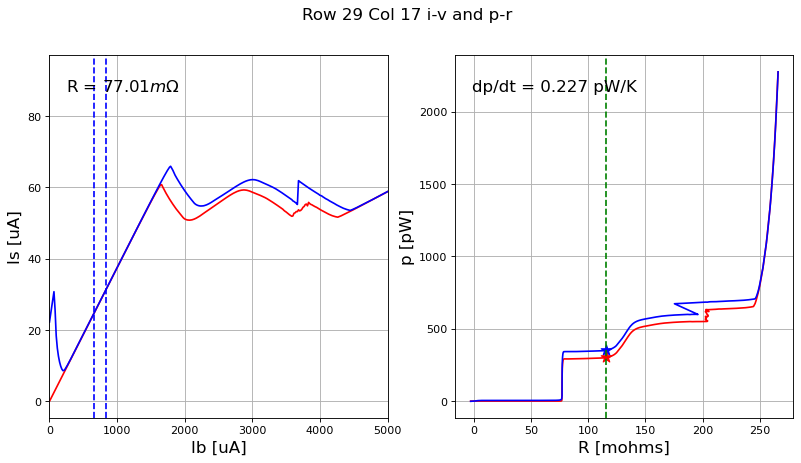

0.22661192977842867 0.07701427025198494
row 29, col 18


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


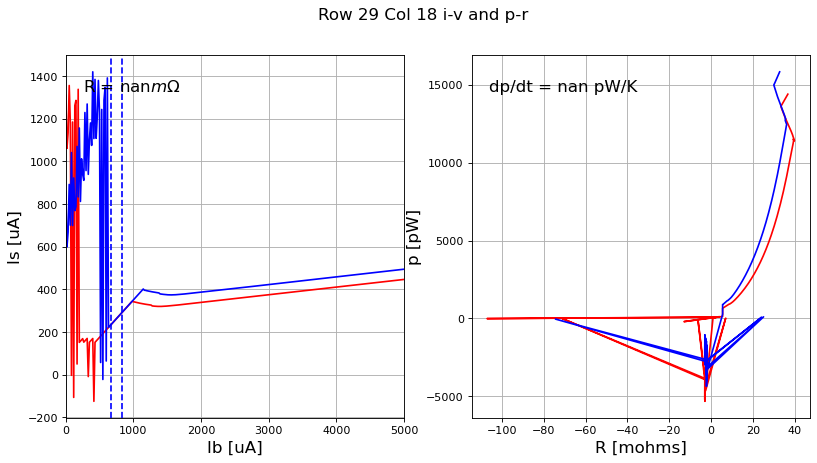

nan nan
row 29, col 19


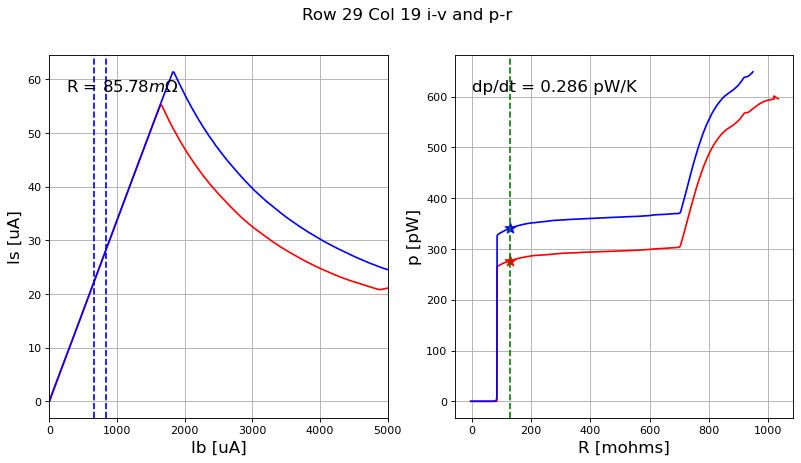

0.28592178079488845 0.0857778190086102
row 29, col 20


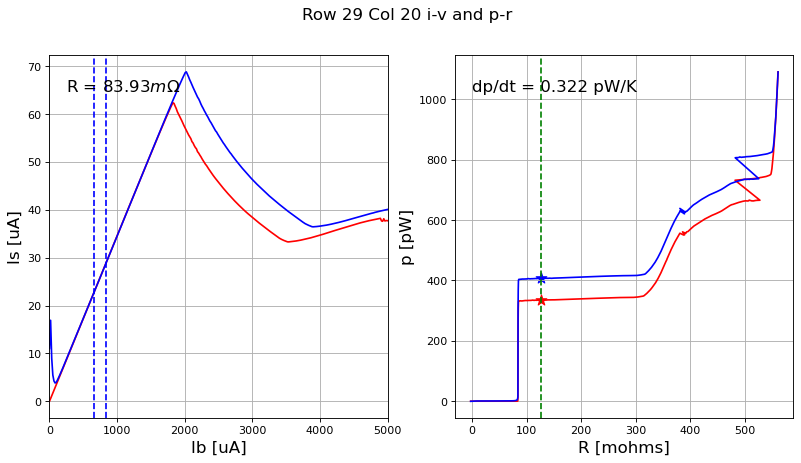

0.3220595609859781 0.08392591630476331
row 29, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


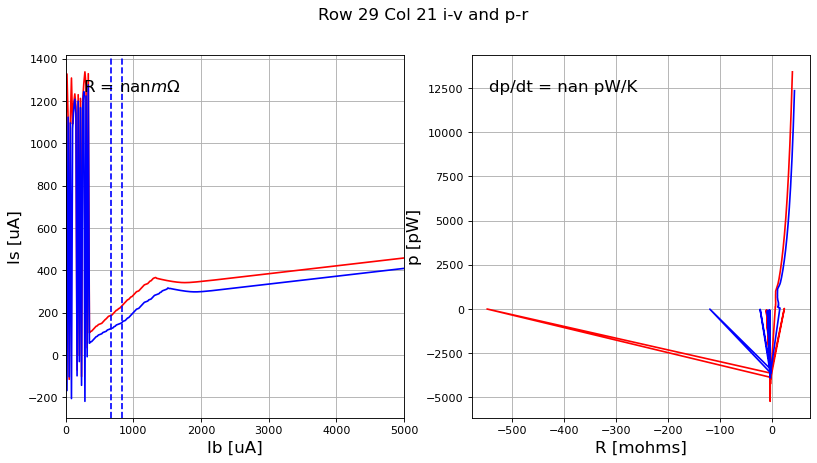

nan nan
row 29, col 22


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


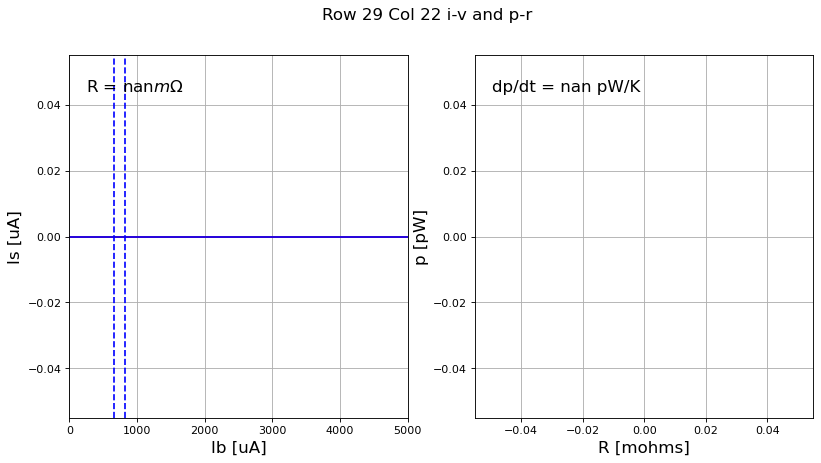

nan nan
row 29, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


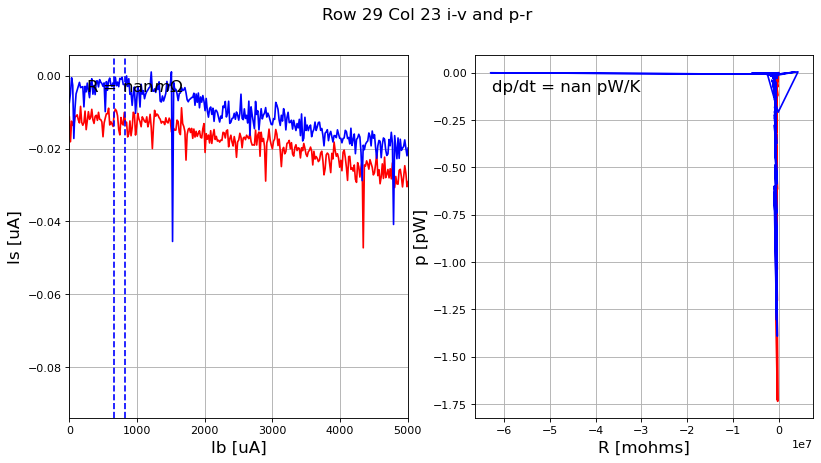

nan nan
row 29, col 24


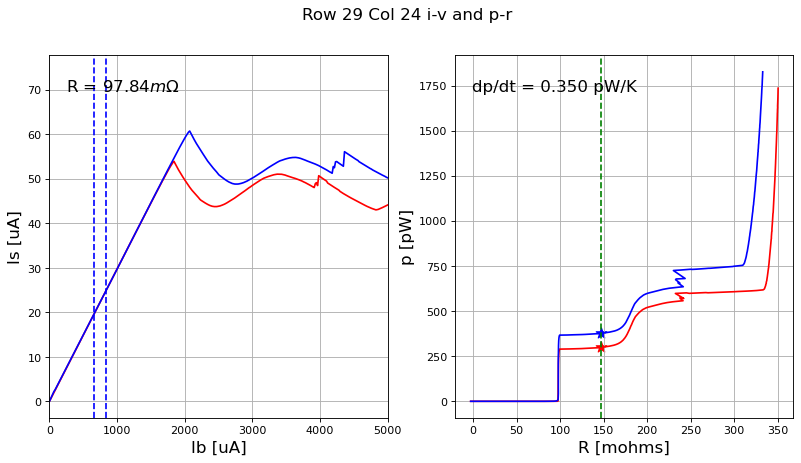

0.35026836633890696 0.09784298040307271
row 29, col 25


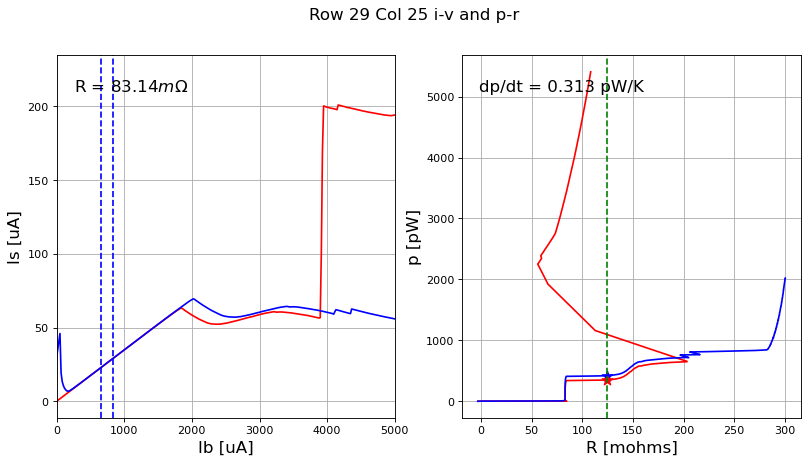

0.3132104111685969 0.08314122204829907
row 29, col 26


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


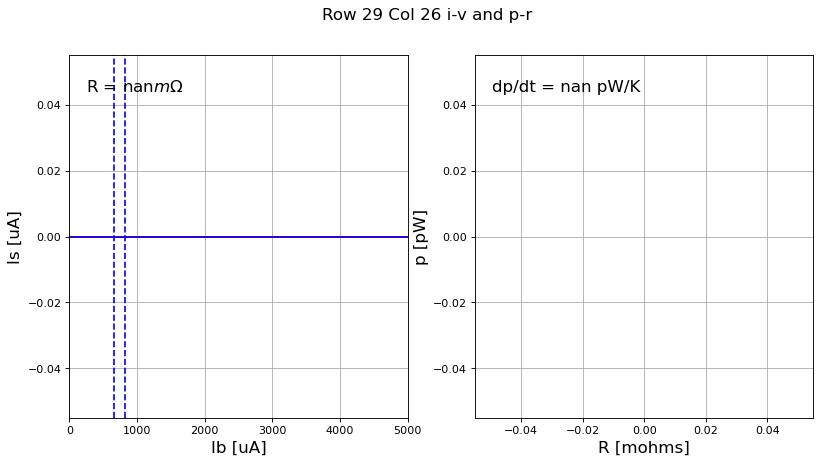

nan nan
row 29, col 27


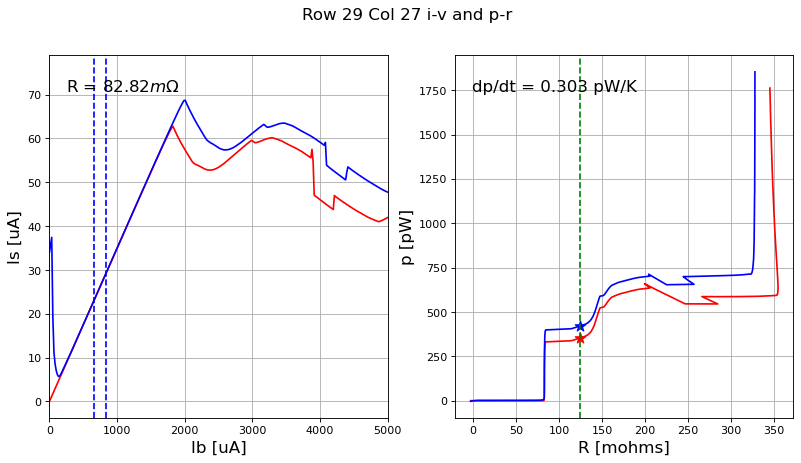

0.30310573449221034 0.08282410963477481
row 29, col 28


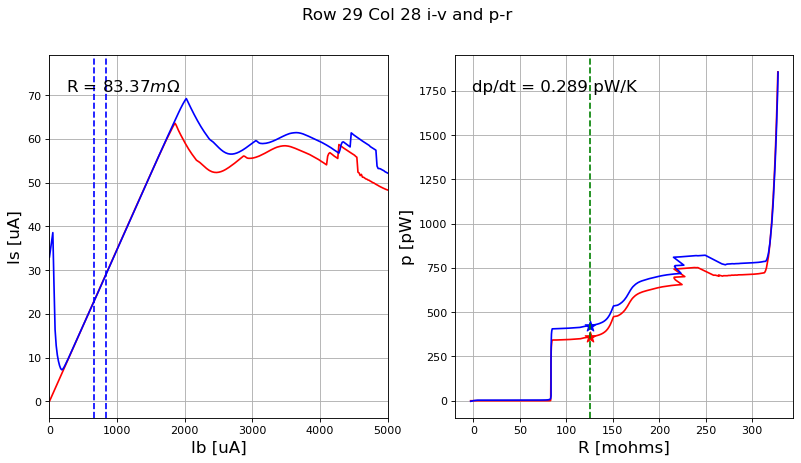

0.28853234384359294 0.08337167810562984
row 29, col 29


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


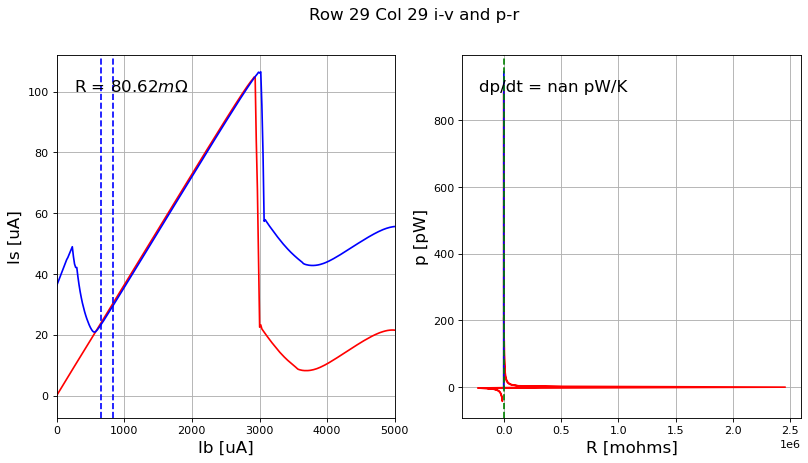

nan 0.08062241227468736
row 29, col 30


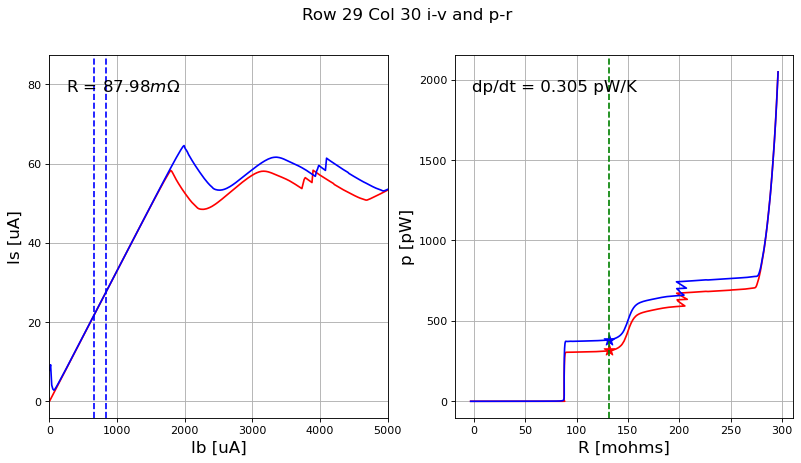

0.3046994646717361 0.08798371644204432
row 29, col 31


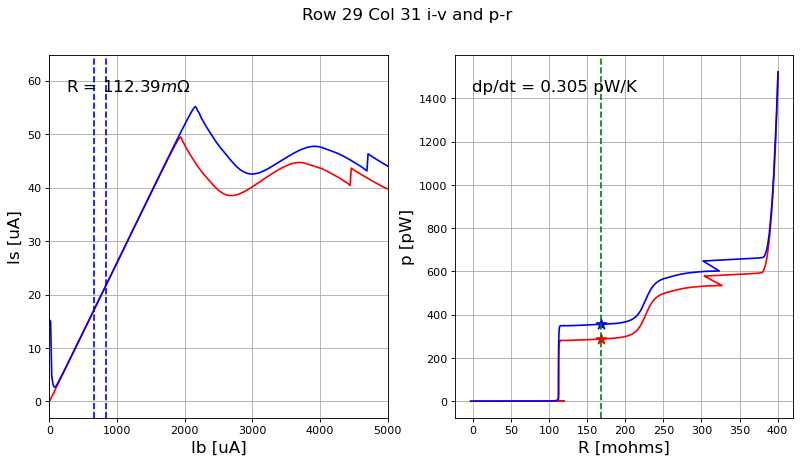

0.3049513186319163 0.11239171493623948
row 30, col 16


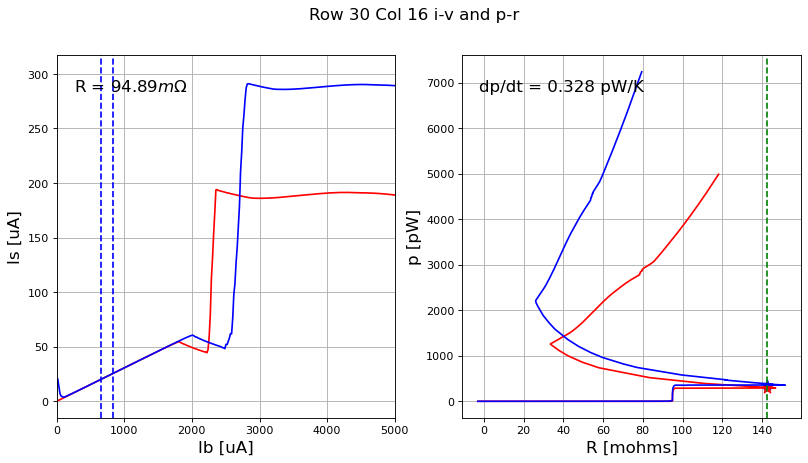

0.32788134631597227 0.09489079499569844
row 30, col 17


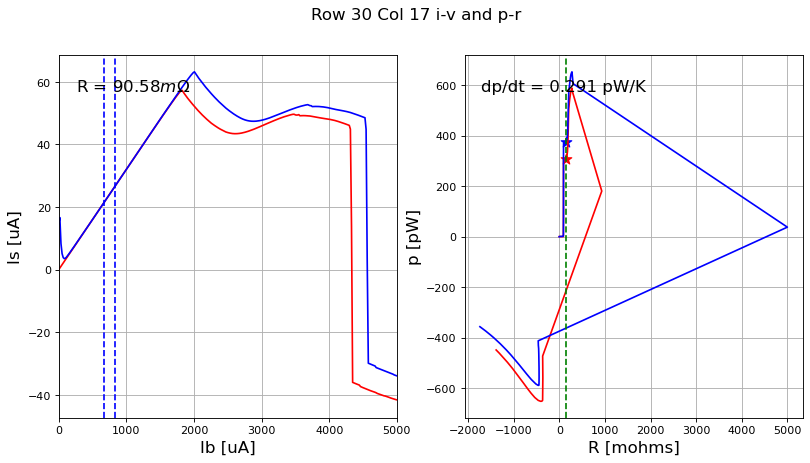

0.2908308191226014 0.09058296950911542
row 30, col 18


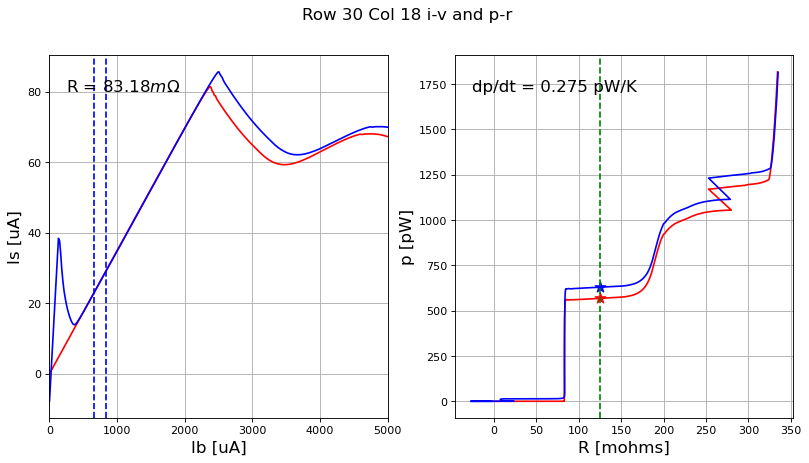

0.2749183534461786 0.08318200494154543
row 30, col 19


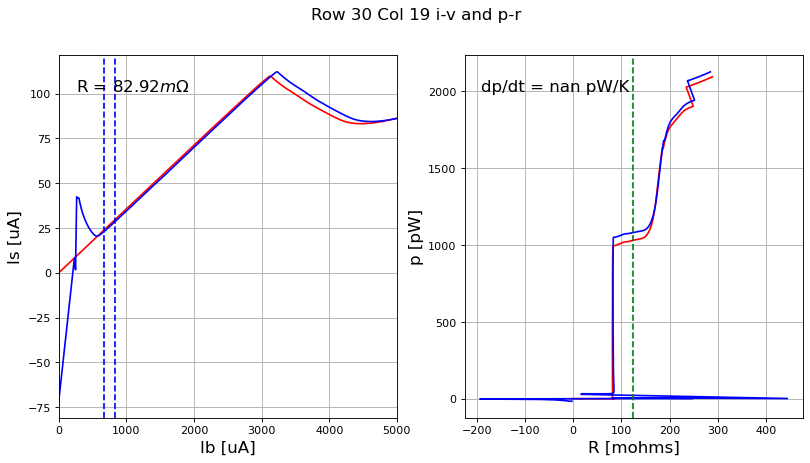

nan 0.08291952788726686
row 30, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


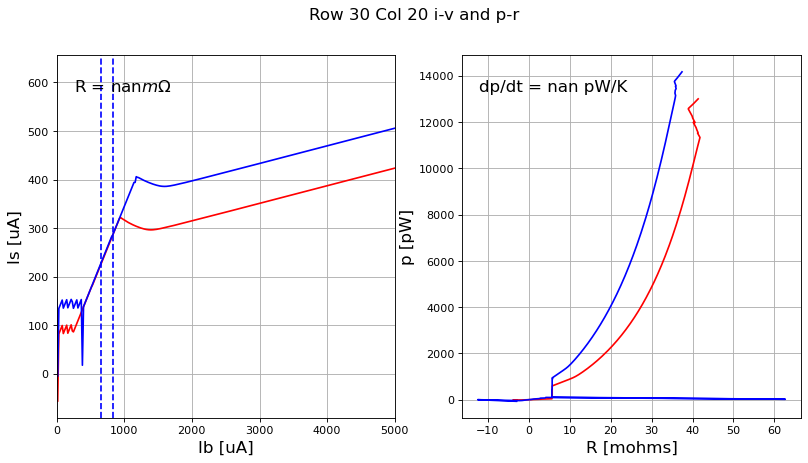

nan nan
row 30, col 21


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


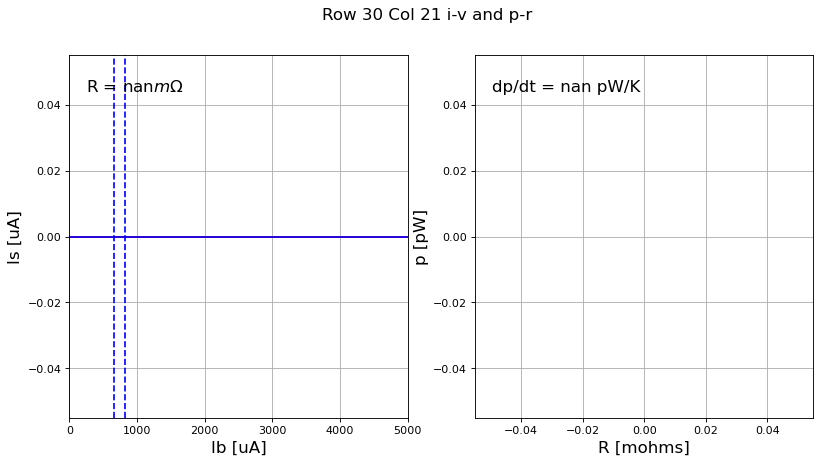

nan nan
row 30, col 22


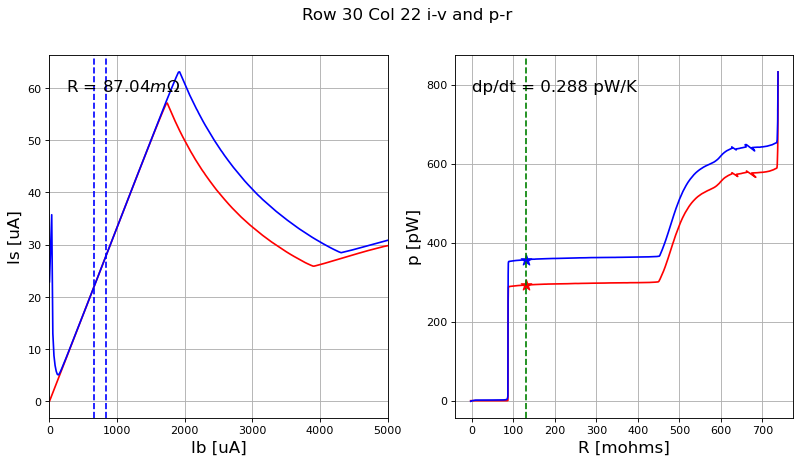

0.28752680470075653 0.08704191702166025
row 30, col 23


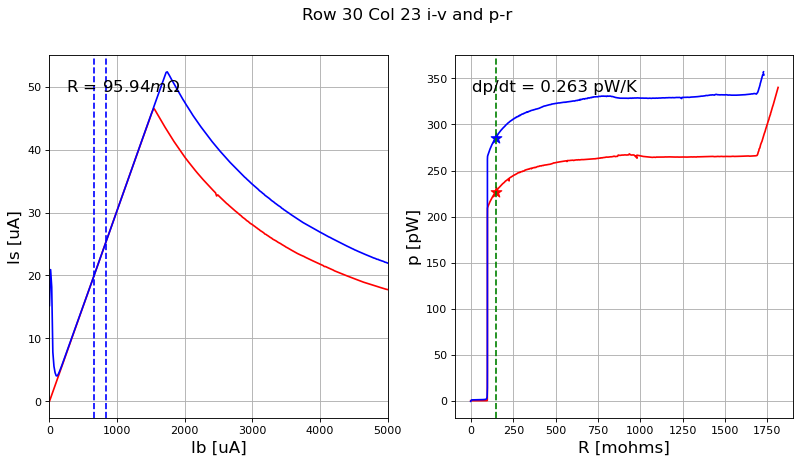

0.26349522092176536 0.09593754665913337
row 30, col 24


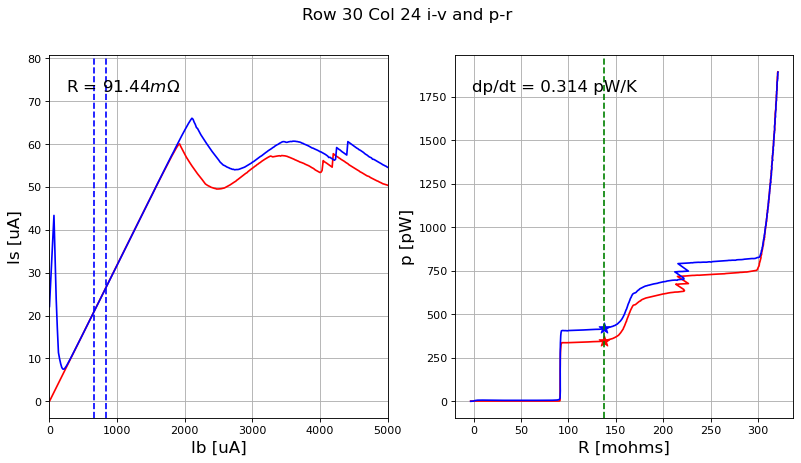

0.31365104073588806 0.09144053921700329
row 30, col 25


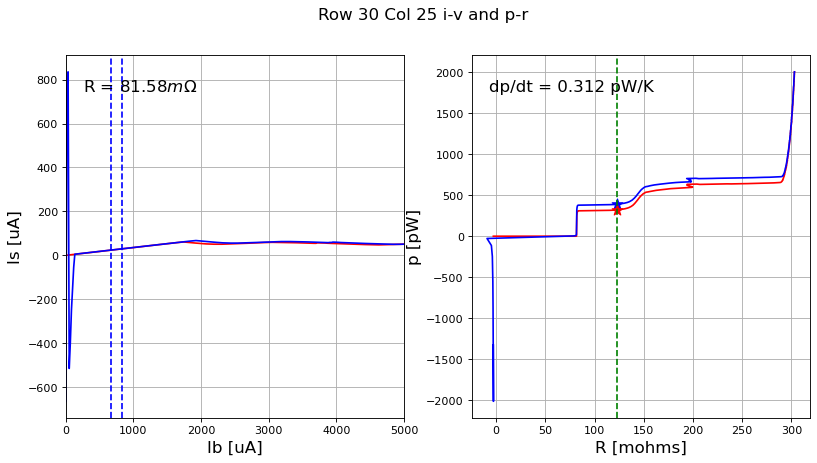

0.3123282856290732 0.08157635079879408
row 30, col 26


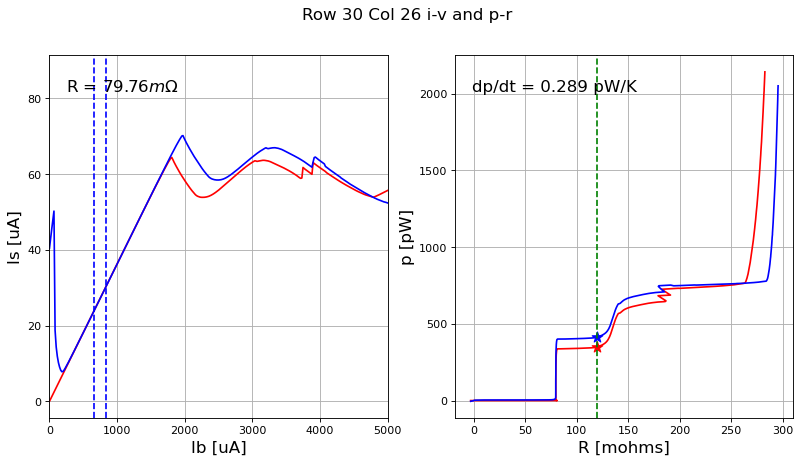

0.28897198917727057 0.07975935804885054
row 30, col 27


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


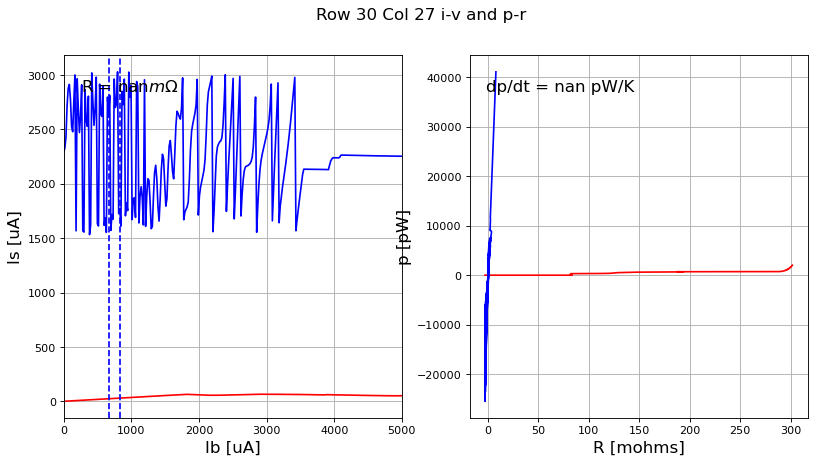

nan nan
row 30, col 28


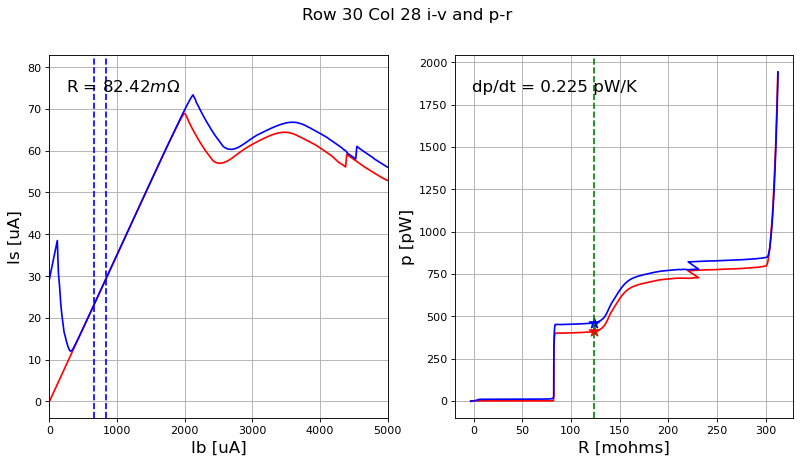

0.22456629150468482 0.08241543458656662
row 30, col 29


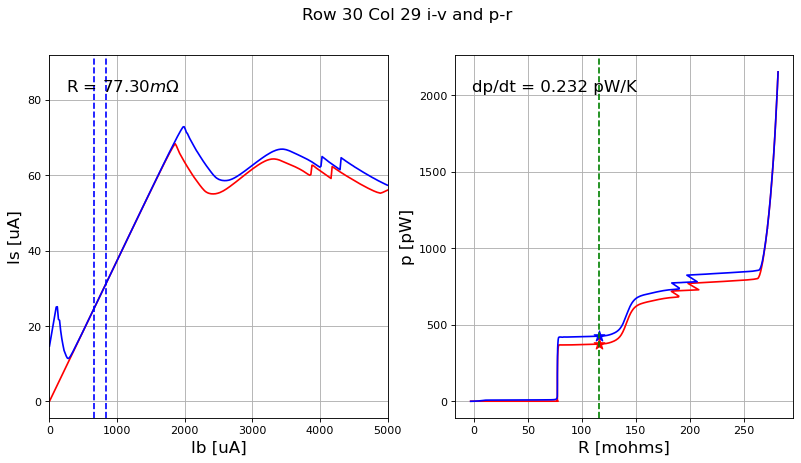

0.2320512470844431 0.0772998351549414
row 30, col 30


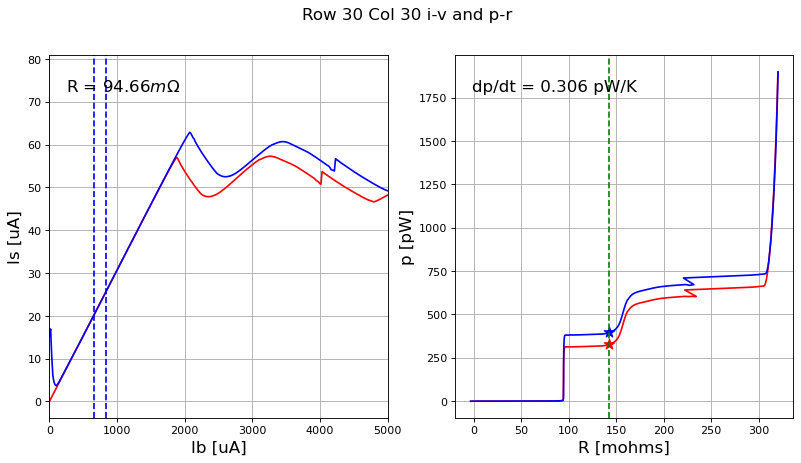

0.30608544056573783 0.09465543536787144
row 30, col 31


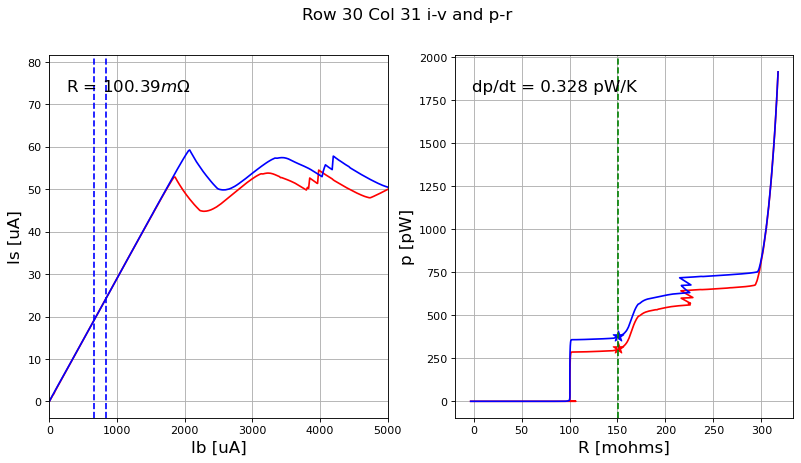

0.3280079946855915 0.10039039743823222
row 31, col 16


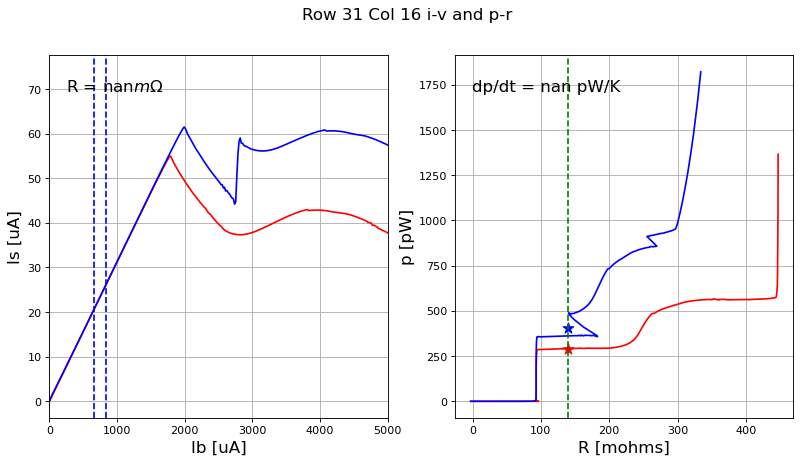

nan nan
row 31, col 17


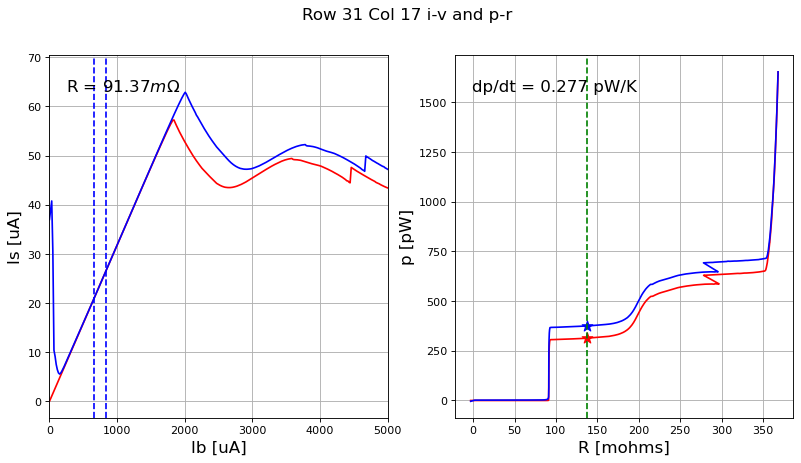

0.2768082132605551 0.09137392363253385
row 31, col 18


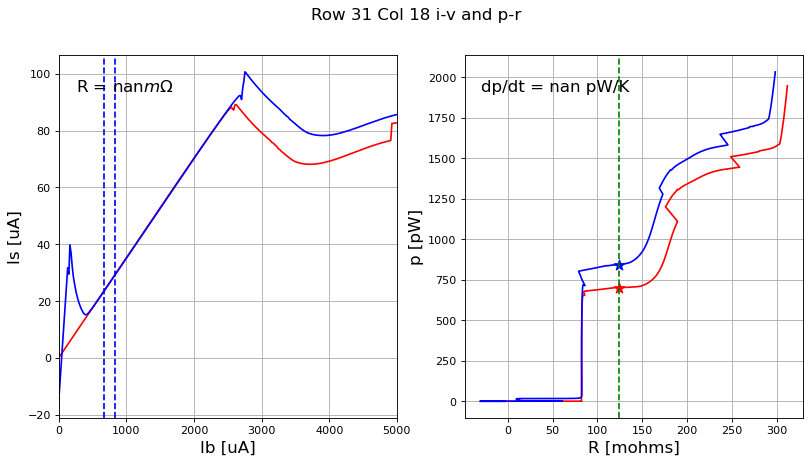

nan nan
row 31, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


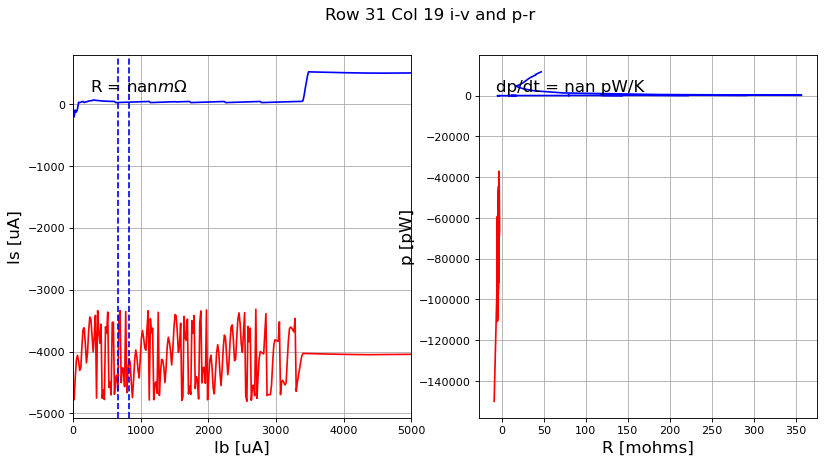

nan nan
row 31, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


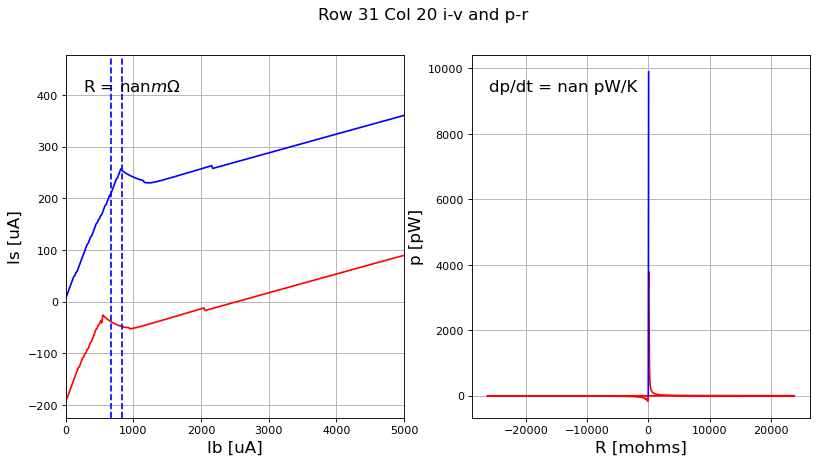

nan nan
row 31, col 21


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


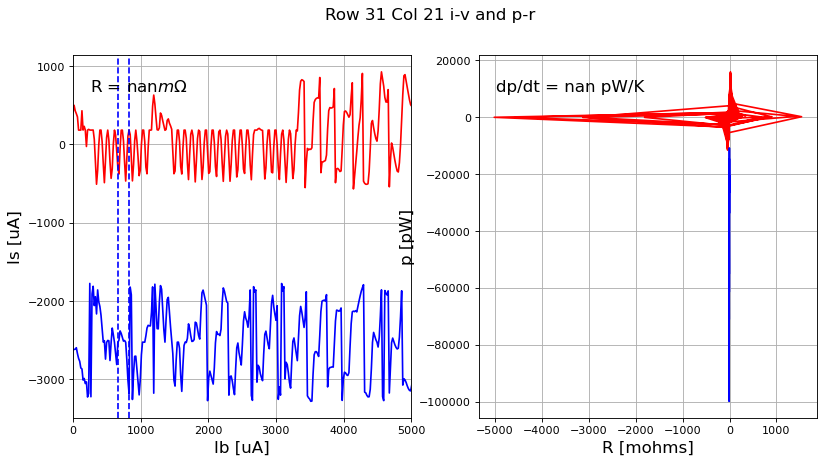

nan nan
row 31, col 22


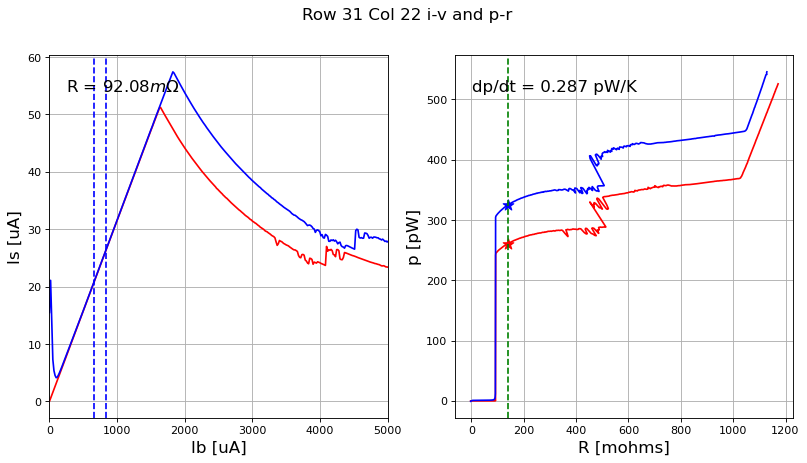

0.2871724528083442 0.09208420535970813
row 31, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


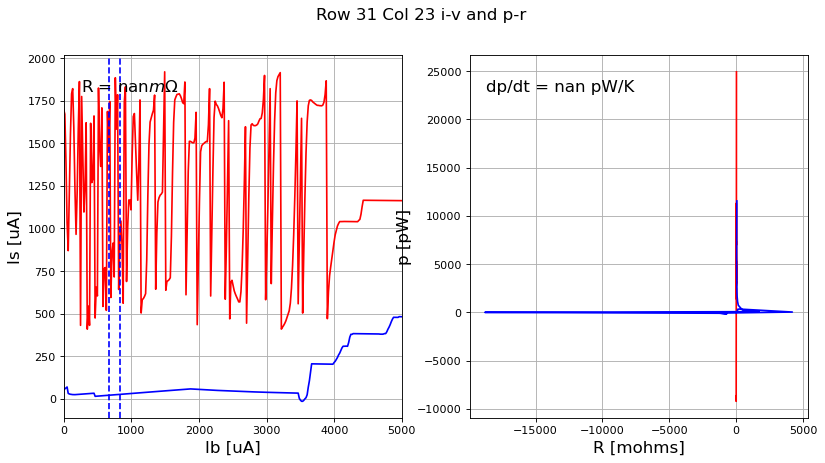

nan nan
row 31, col 24


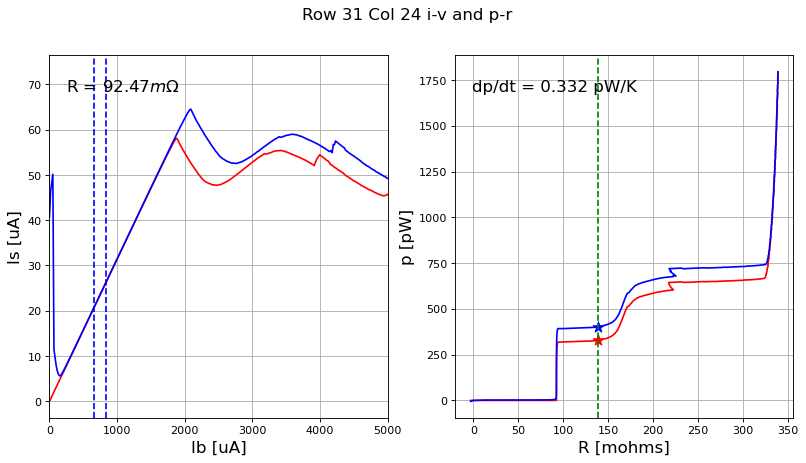

0.33160275254130006 0.09246901761251647
row 31, col 25


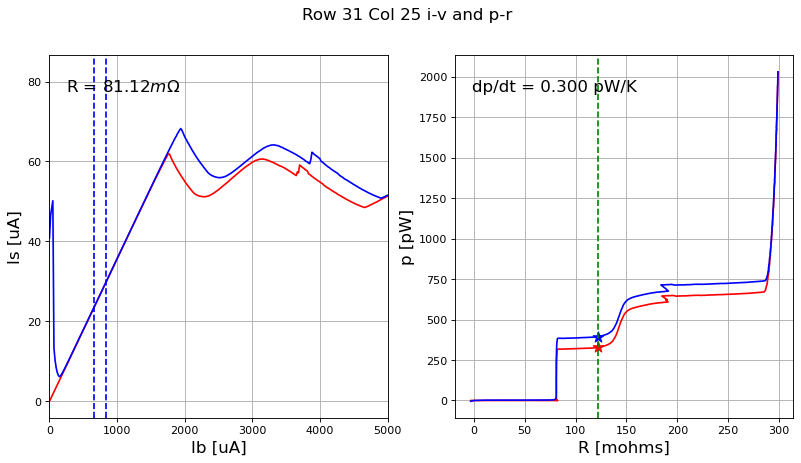

0.2995795116840476 0.08112415743924781
row 31, col 26


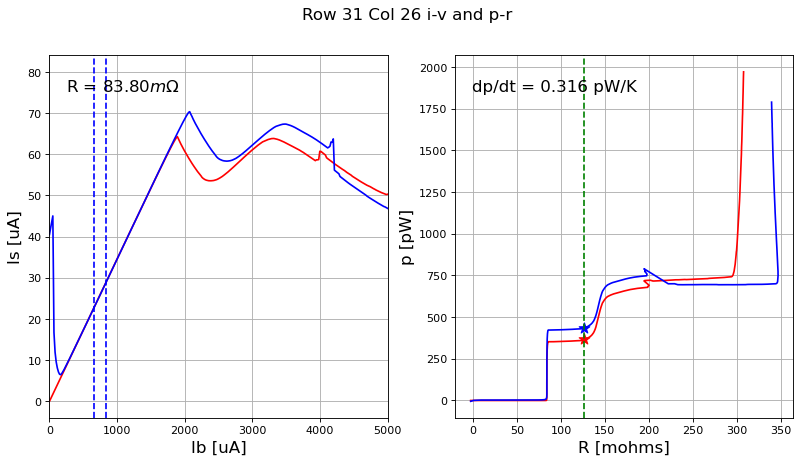

0.315956492770325 0.08379611230068071
row 31, col 27


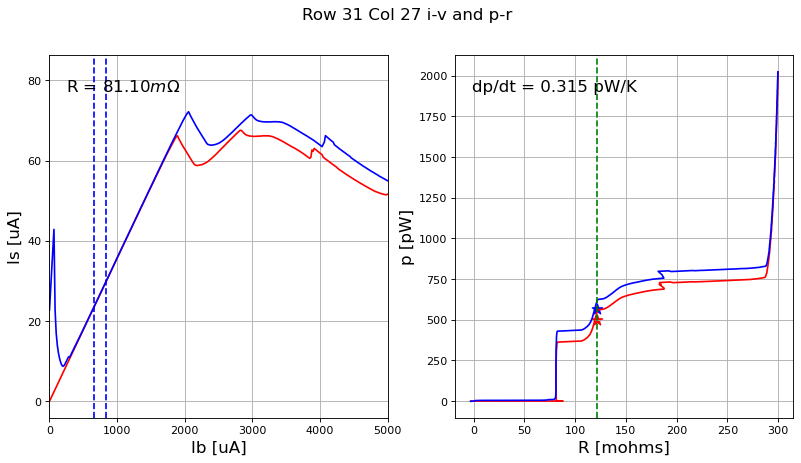

0.3149458386974007 0.08110300751396393
row 31, col 28


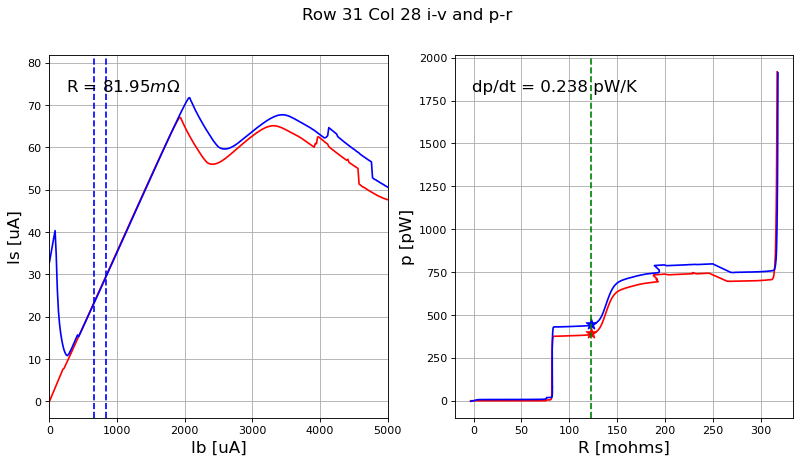

0.23812327129365315 0.08195435844953042
row 31, col 29


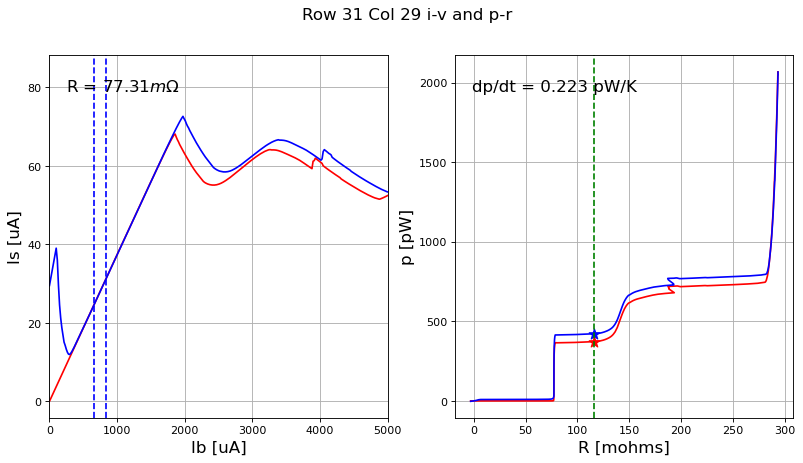

0.22290099688783188 0.07731237943659283
row 31, col 30


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


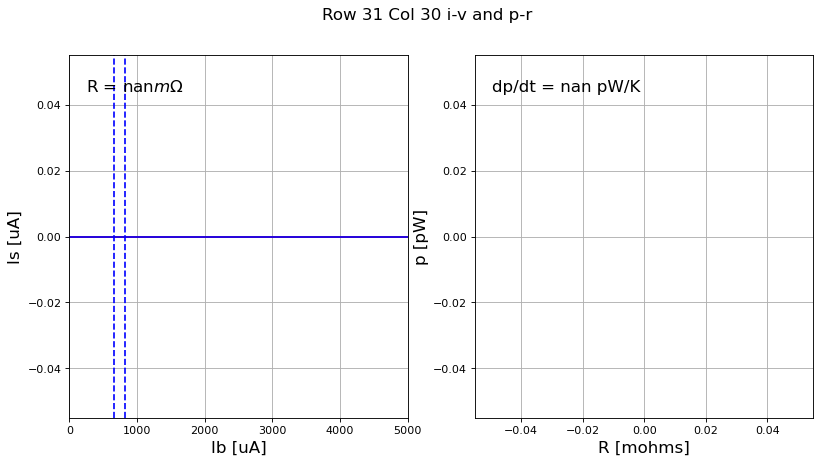

nan nan
row 31, col 31


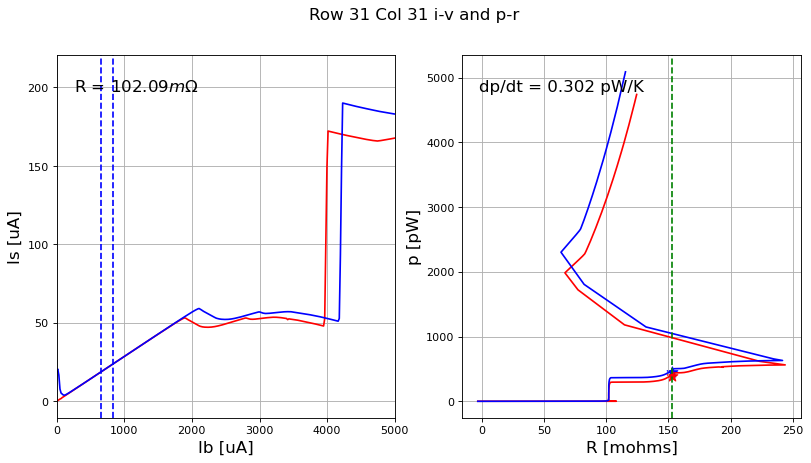

0.3018145726982983 0.10208893552279151
row 32, col 16


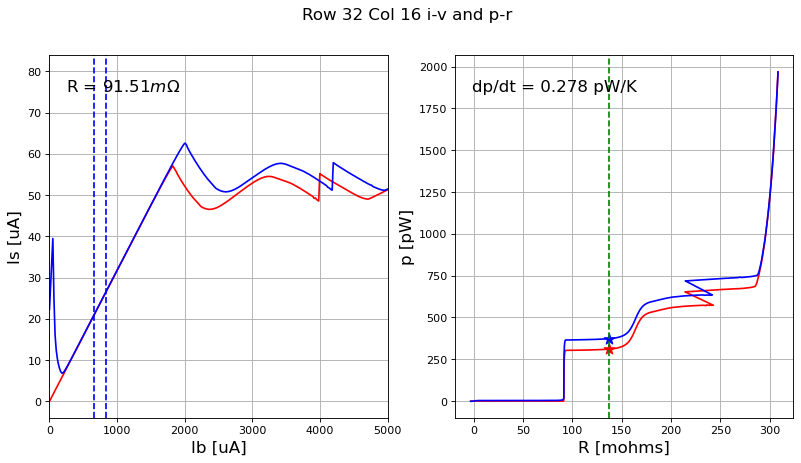

0.27803569349178103 0.09151105588901179
row 32, col 17


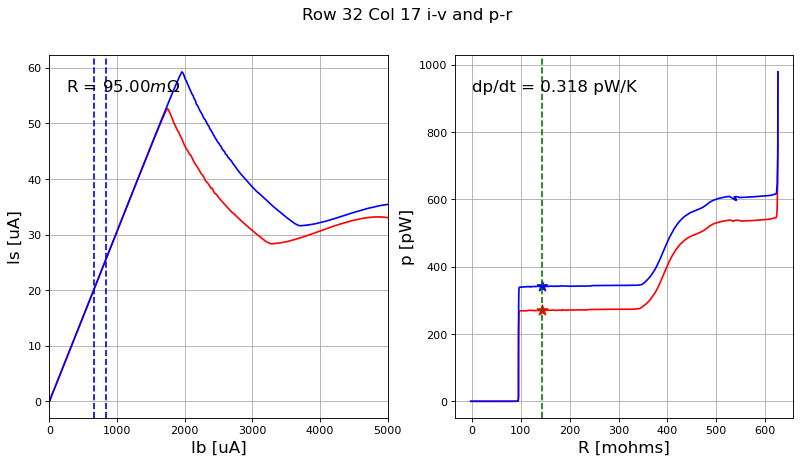

0.3184479536326809 0.0950029813058431
row 32, col 18


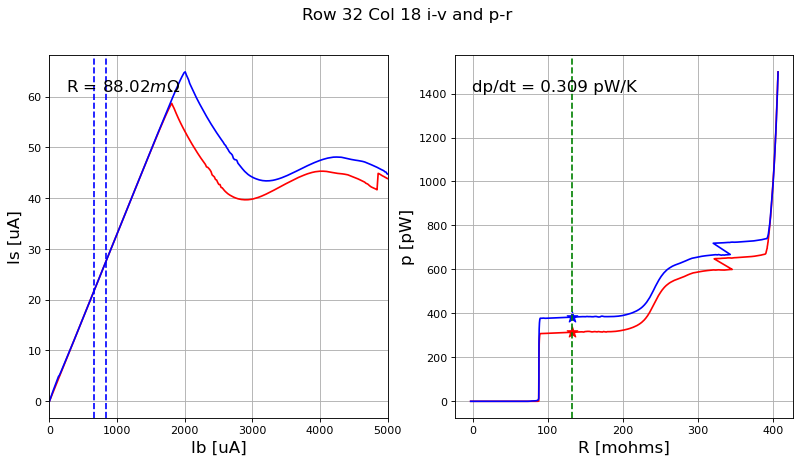

0.30948662684088424 0.08801692541066125
row 32, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


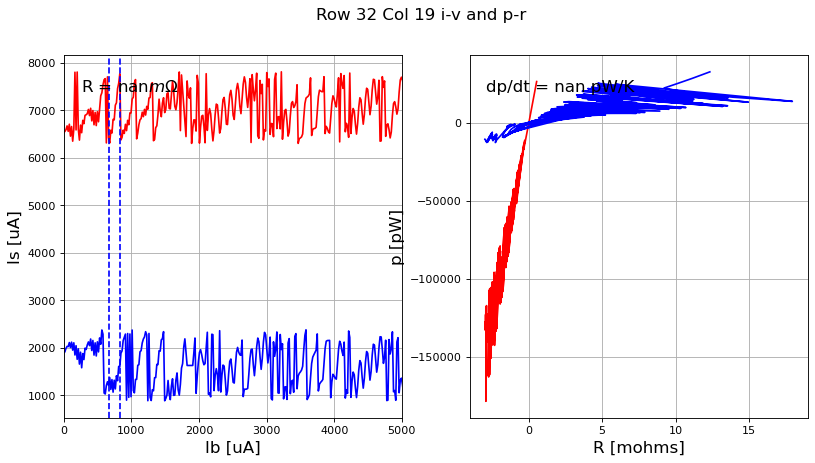

nan nan
row 32, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


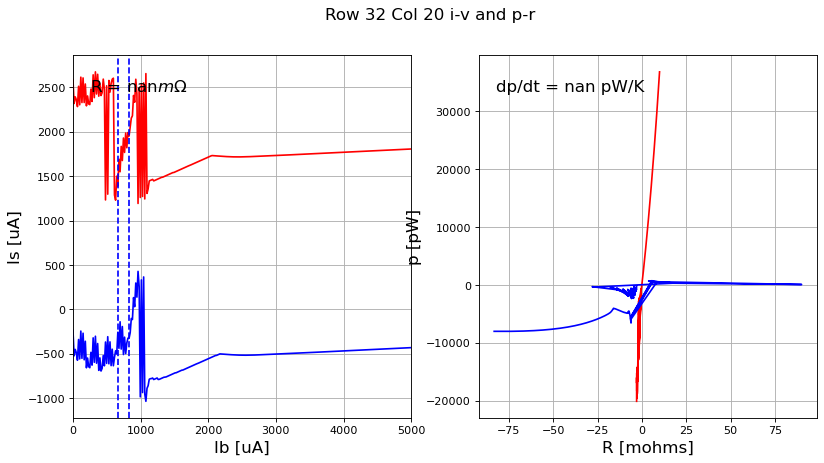

nan nan
row 32, col 21


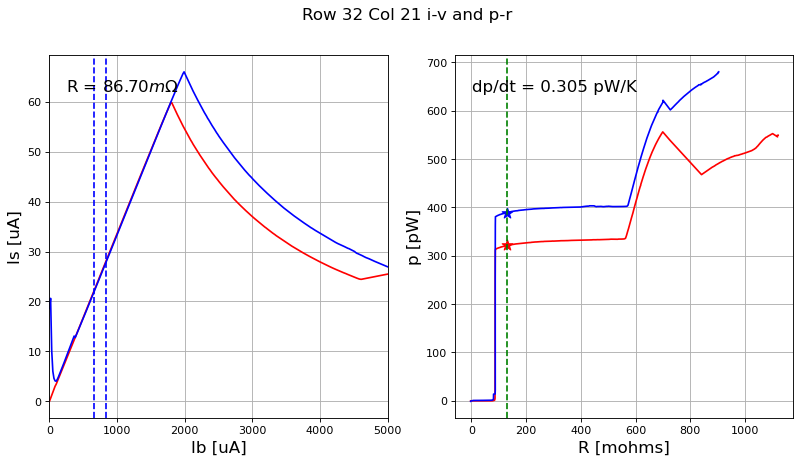

0.3048395249357207 0.08669521873778757
row 32, col 22


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


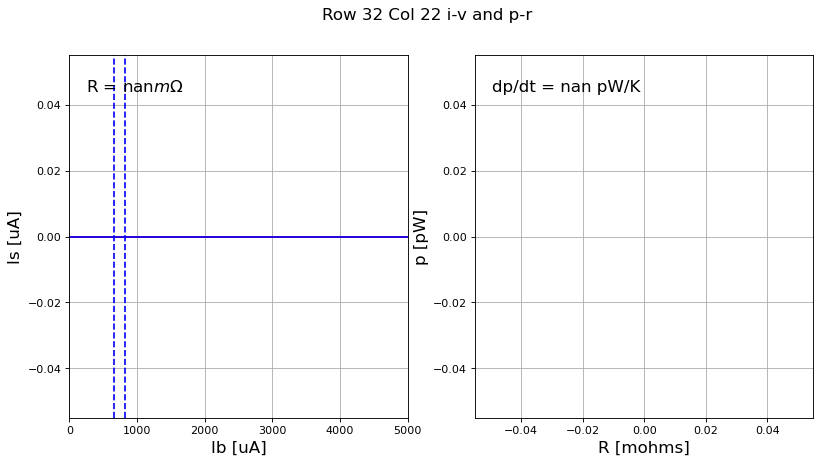

nan nan
row 32, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


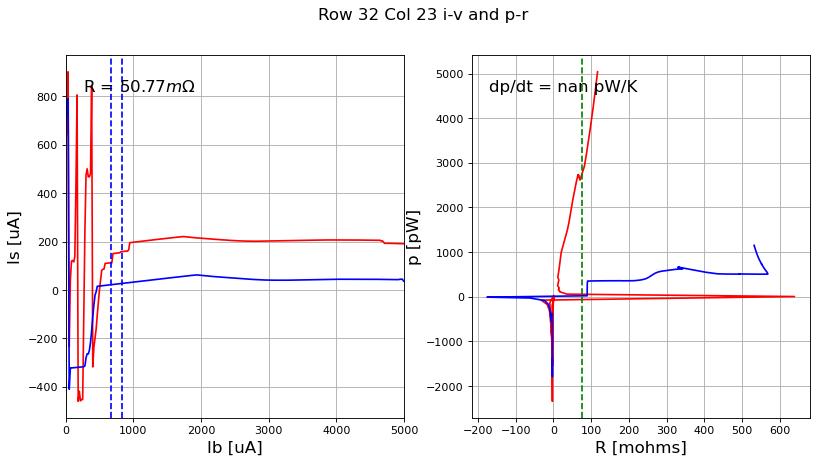

nan 0.05076600853907406
row 32, col 24


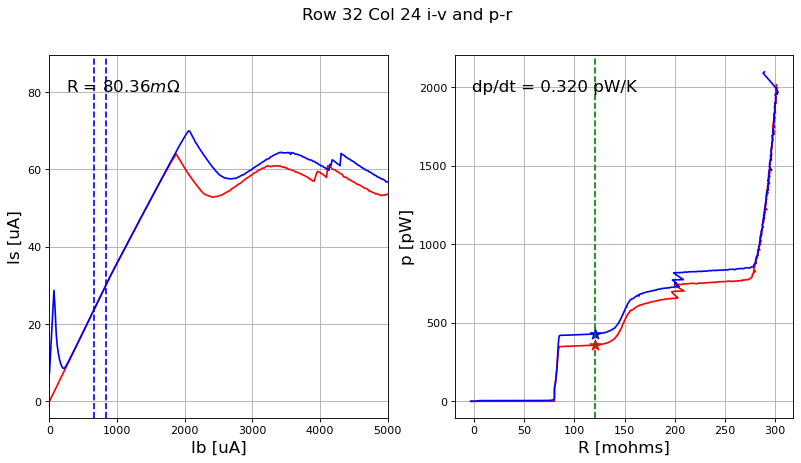

0.3199961003671866 0.08036149665284739
row 32, col 25


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


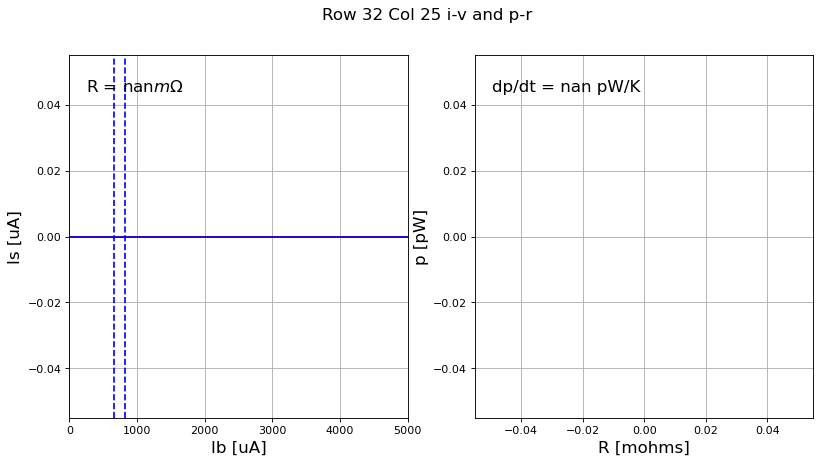

nan nan
row 32, col 26


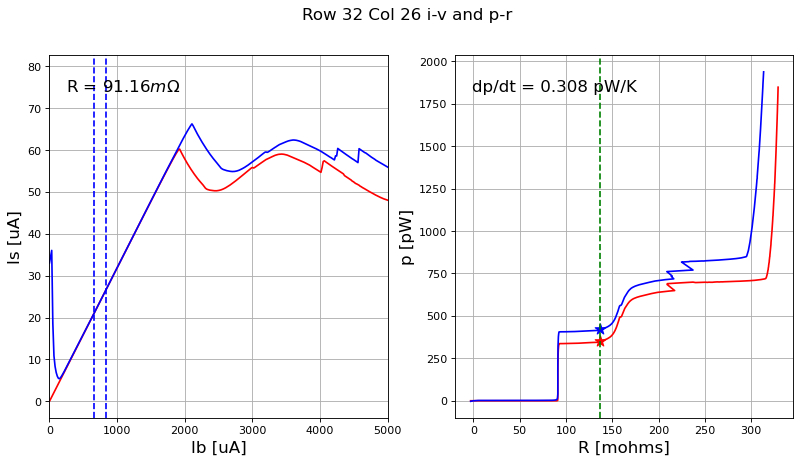

0.3080276771794588 0.09116396681271617
row 32, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


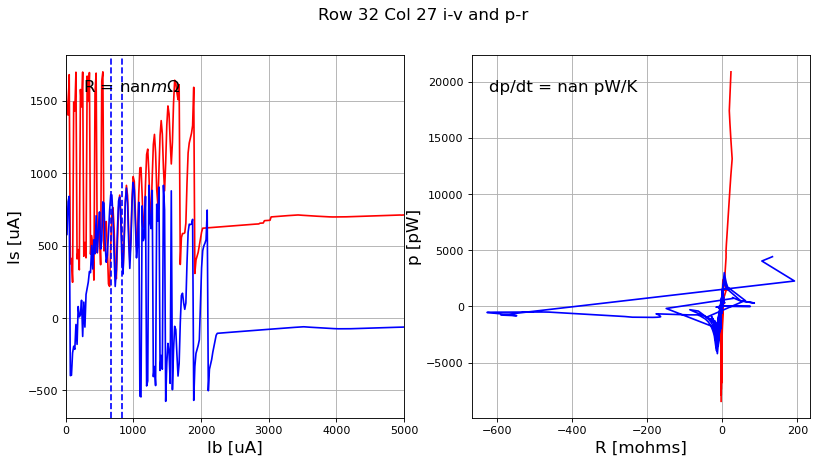

nan nan
row 32, col 28


/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


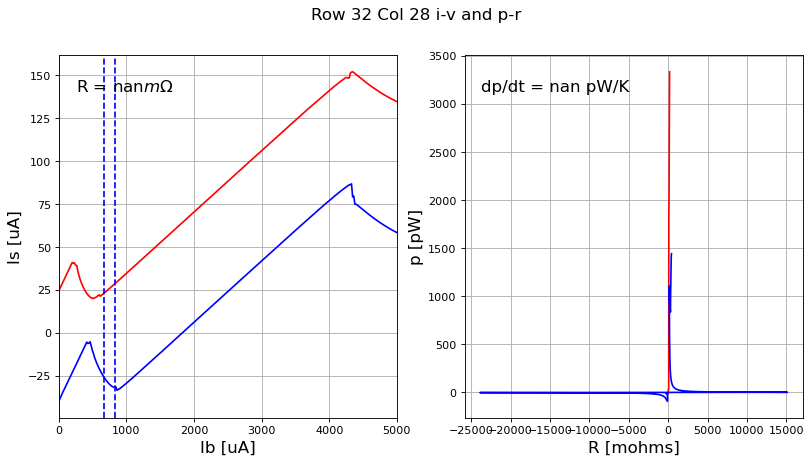

nan nan
row 32, col 29


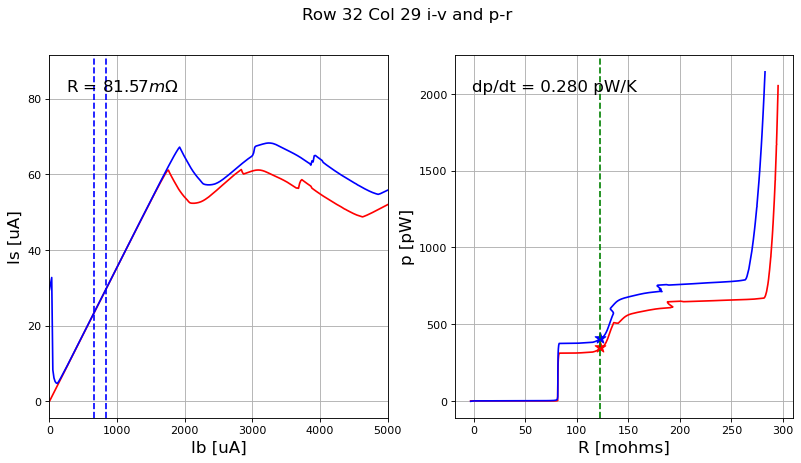

0.279819001725762 0.08157413401224811
row 32, col 30


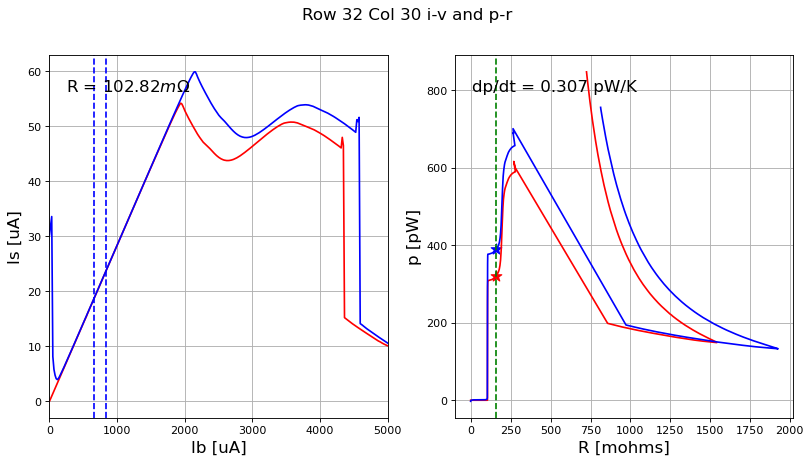

0.30744462959509405 0.10281935114384982
row 32, col 31


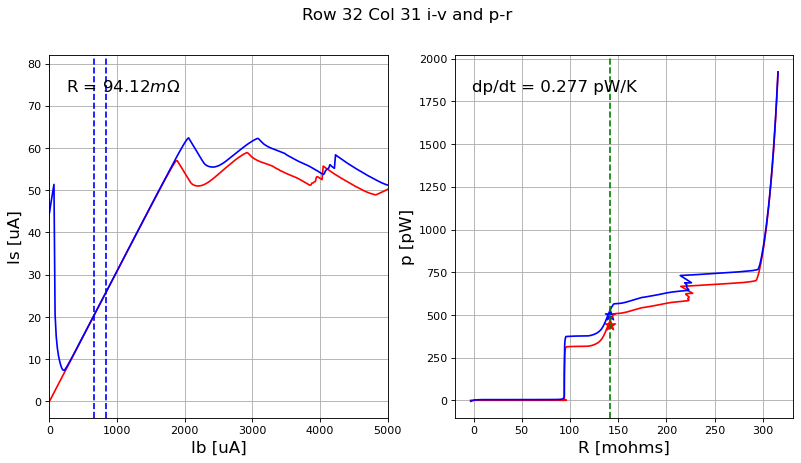

0.2771973984276308 0.09411556672069085
row 33, col 16


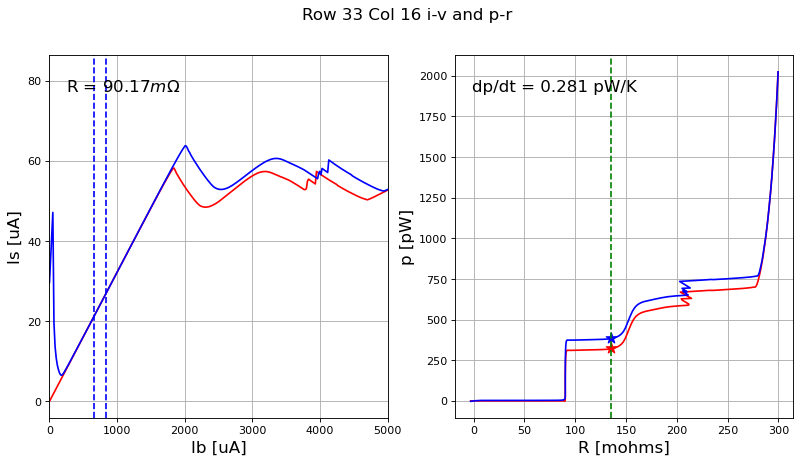

0.281059536038368 0.09017492696167698
row 33, col 17


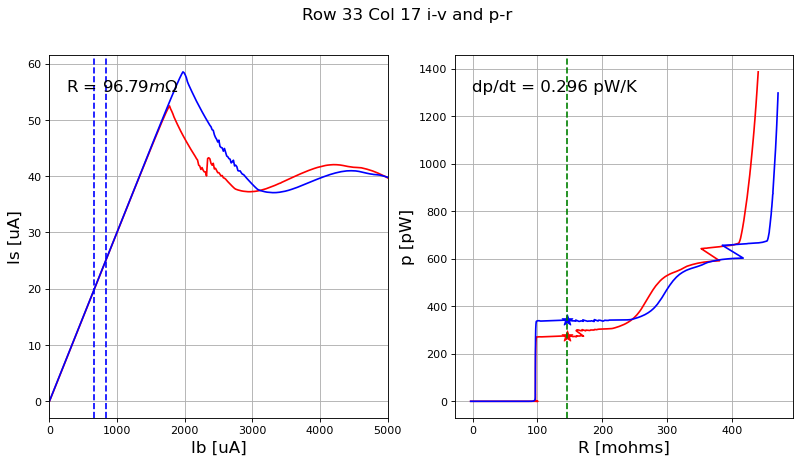

0.29608547204120556 0.09678937069269702
row 33, col 18


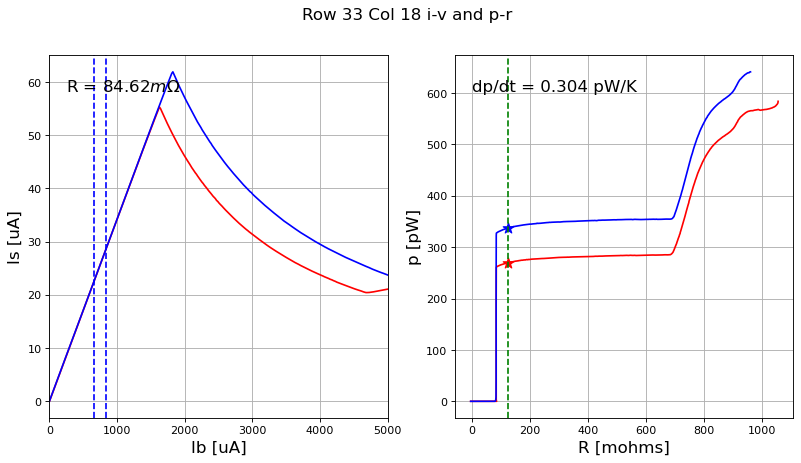

0.30369078135868505 0.08461949166040204
row 33, col 19


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


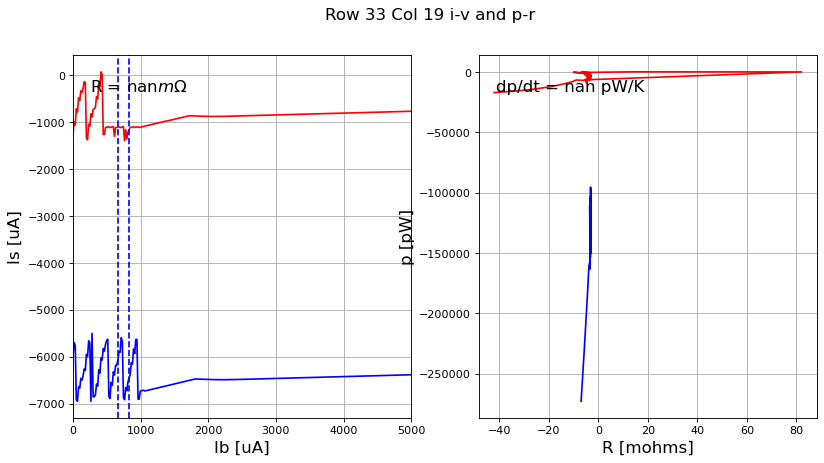

nan nan
row 33, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


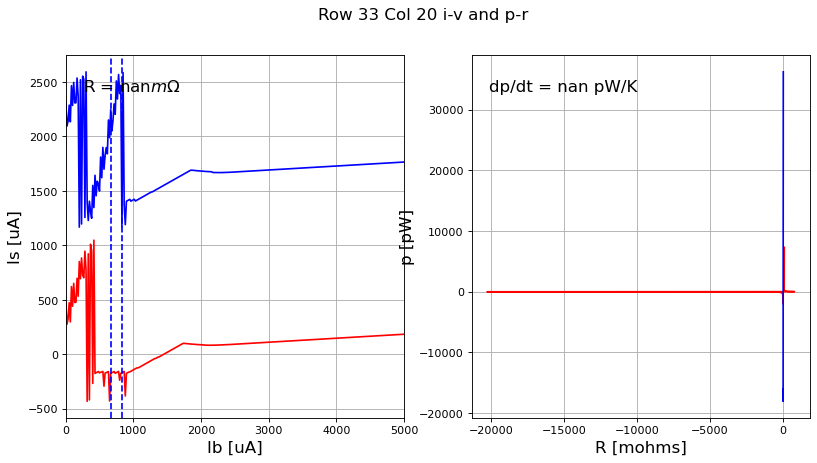

nan nan
row 33, col 21


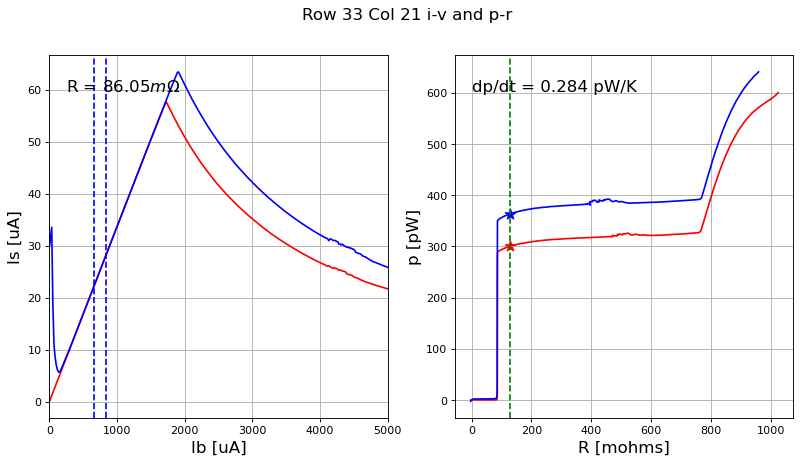

0.2839890993203426 0.08605322460742927
row 33, col 22


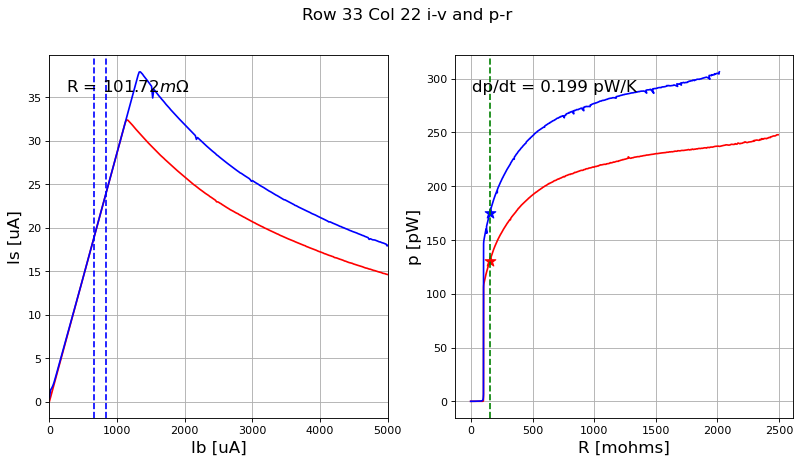

0.19931444934596995 0.10172410022602171
row 33, col 23


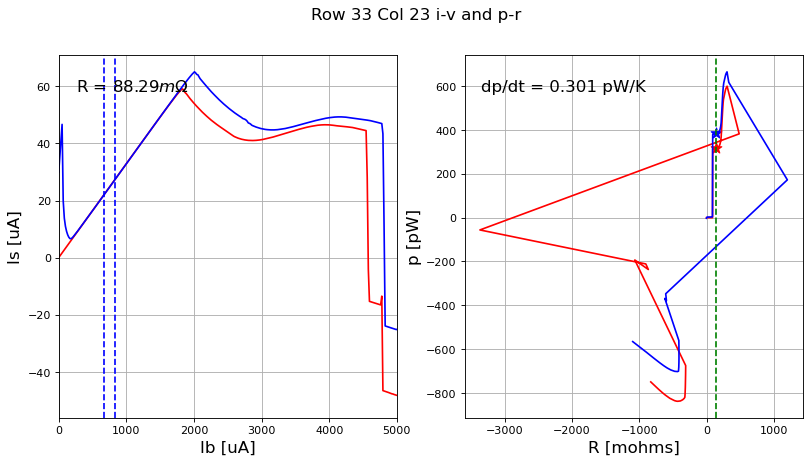

0.30083248823515585 0.0882928417070527
row 33, col 24


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


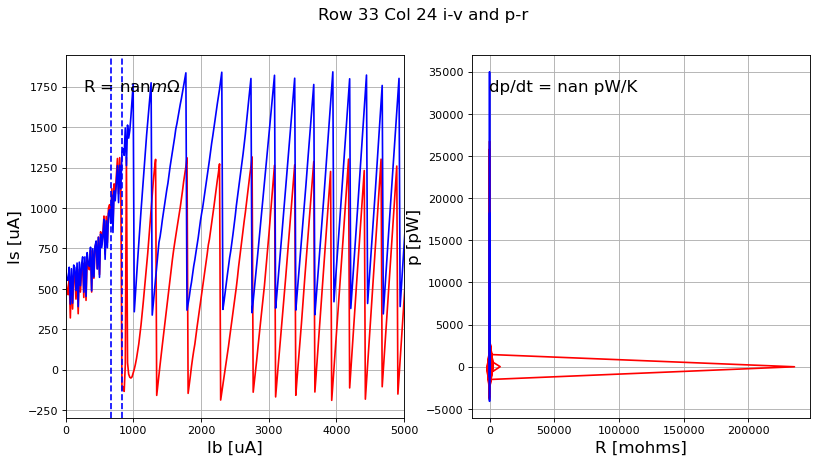

nan nan
row 33, col 25


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


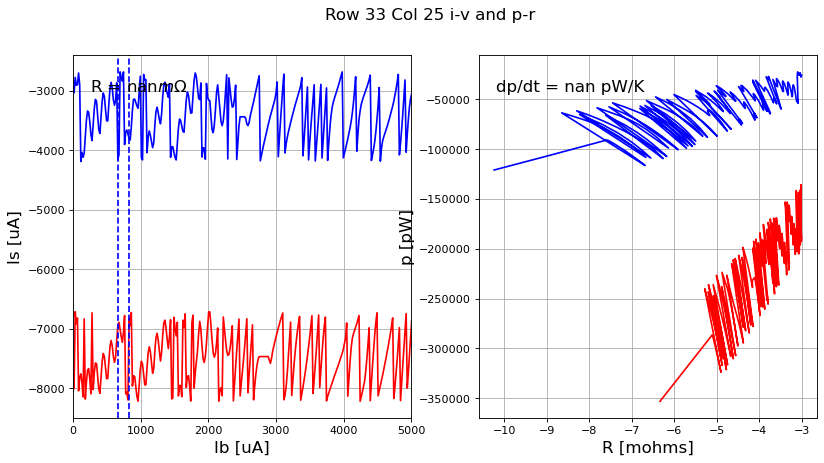

nan nan
row 33, col 26
#####################
26 33


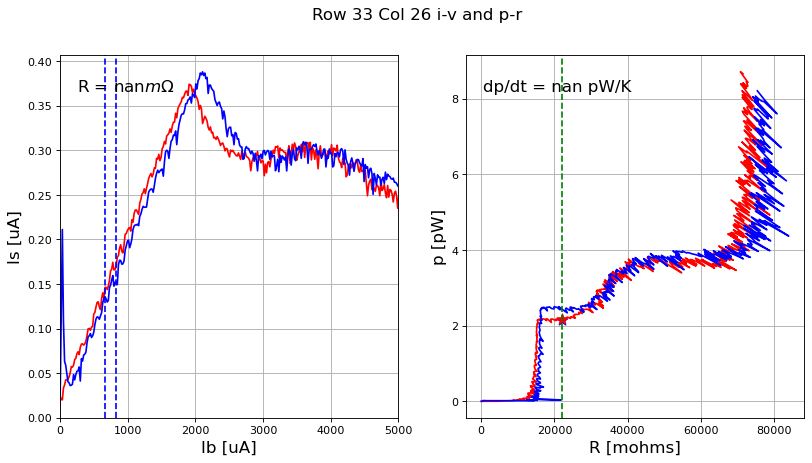

nan nan
row 33, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


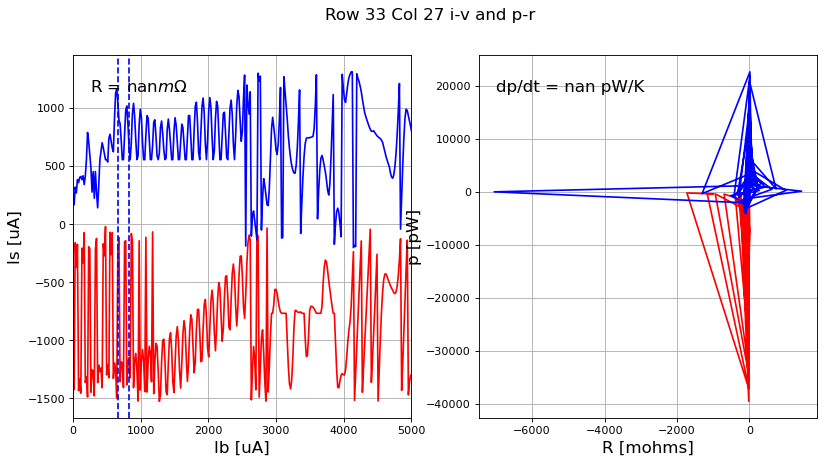

nan nan
row 33, col 28


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)
/home/yuka/oe_analysis/lcdata.py:282: RuntimeWarning: Mean of empty slice
  psat=np.nanmean(pp[idx])


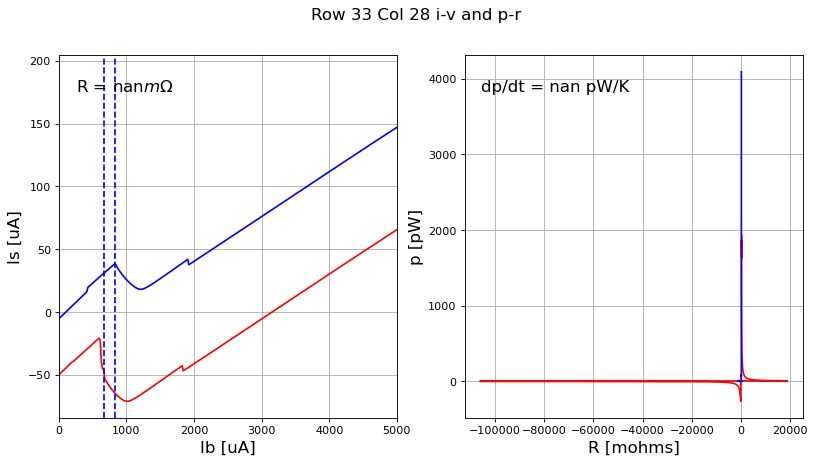

nan nan
row 33, col 29


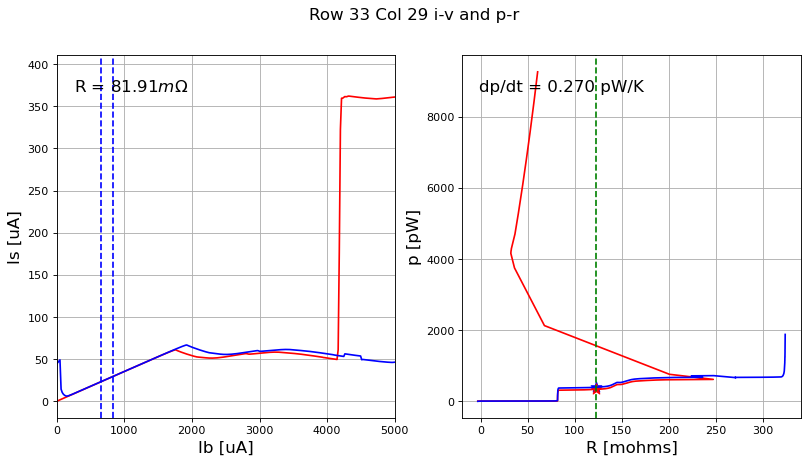

0.2696607461541175 0.08191409908243655
row 33, col 30


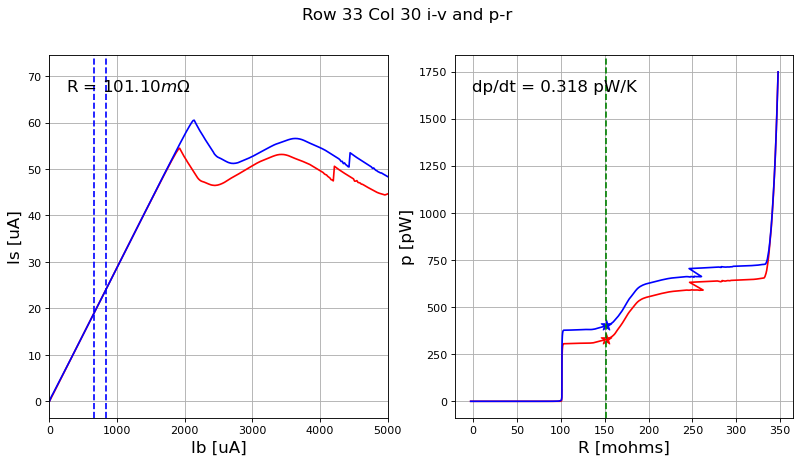

0.3177555416155382 0.10110209179946622
row 33, col 31


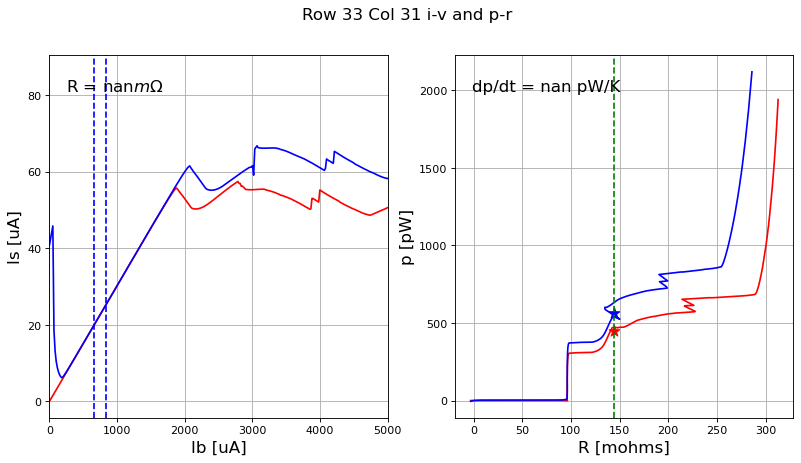

nan nan
row 34, col 16


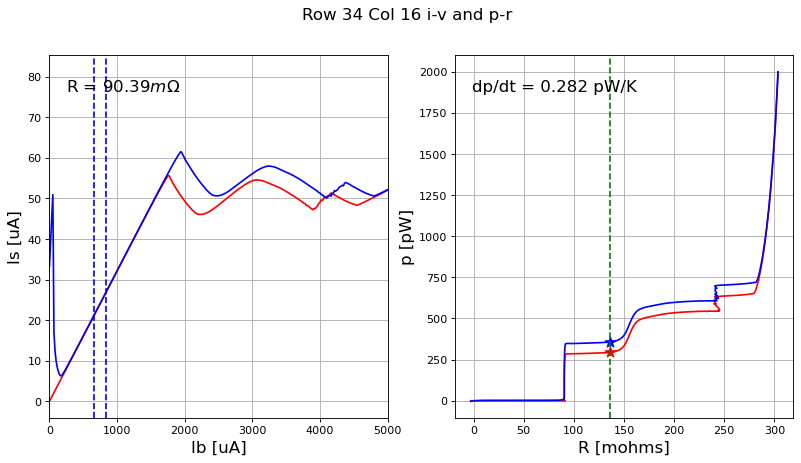

0.28150329073636027 0.09038618202264184
row 34, col 17


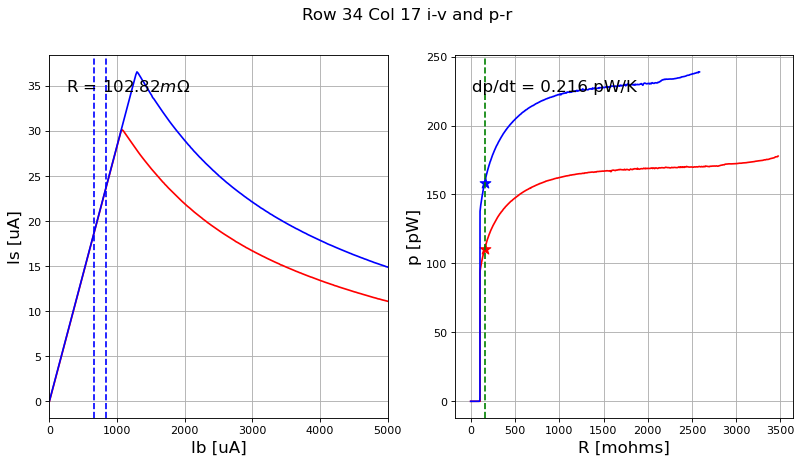

0.215975321632701 0.10281660938926712
row 34, col 18


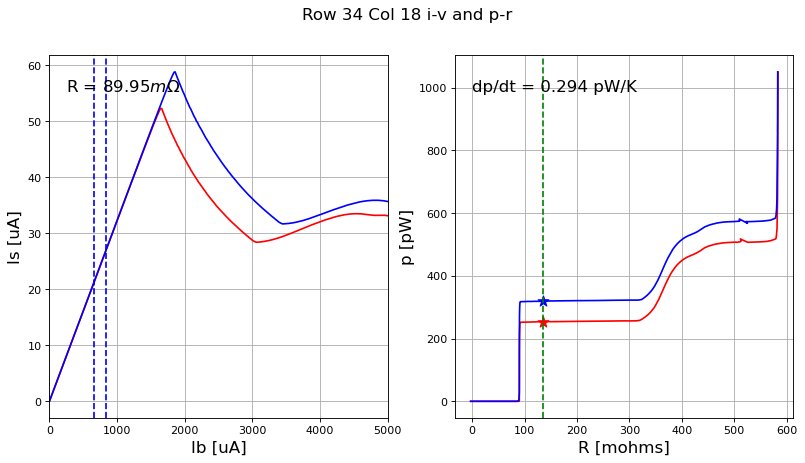

0.2943188021539227 0.08994933049278737
row 34, col 19


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


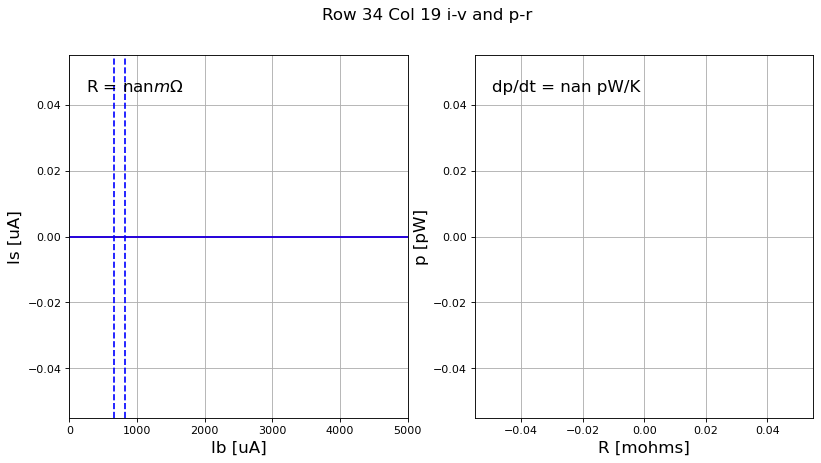

nan nan
row 34, col 20


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


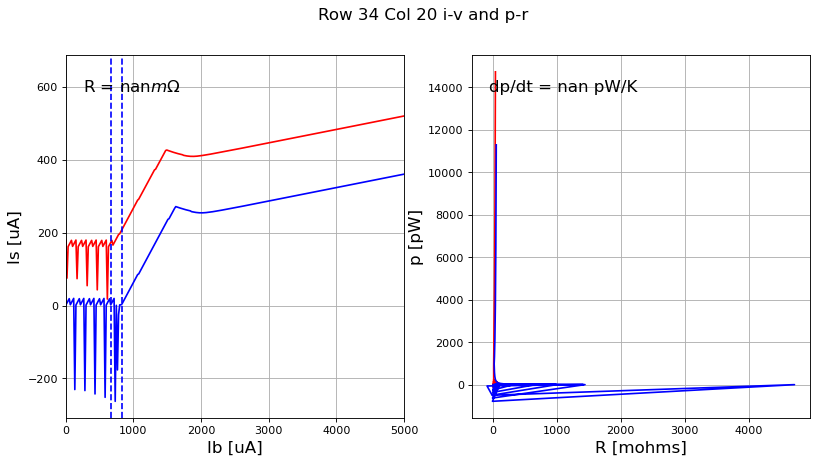

nan nan
row 34, col 21


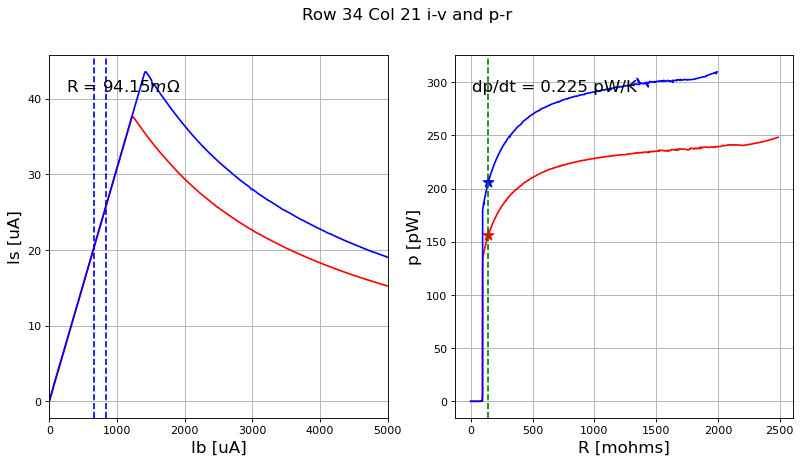

0.22470478495536472 0.09415325686420946
row 34, col 22


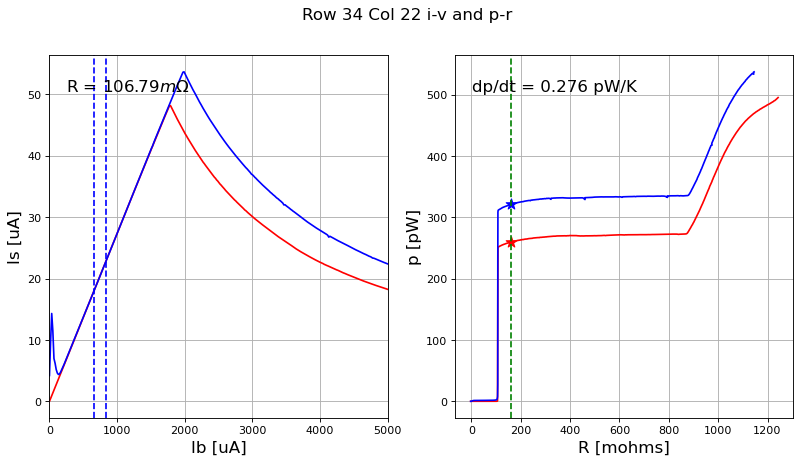

0.2755709758222918 0.10678664129514095
row 34, col 23


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


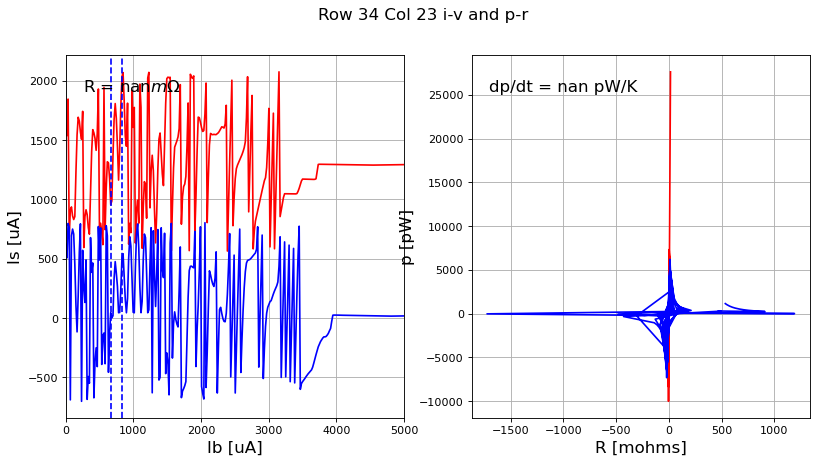

nan nan
row 34, col 24


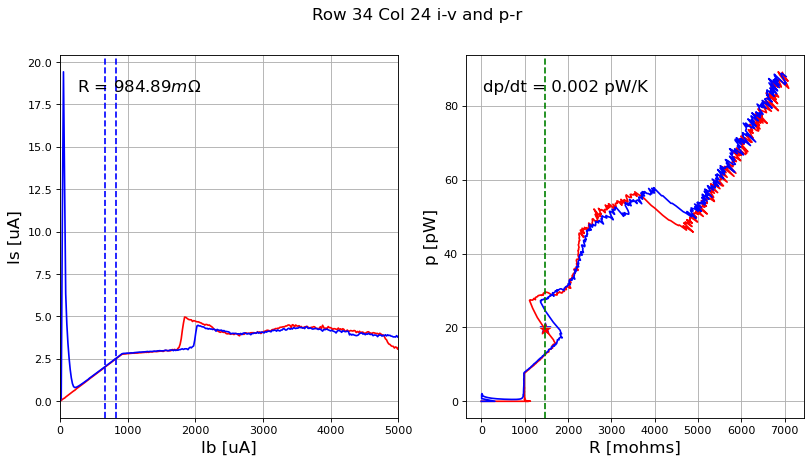

0.0015509932778670517 0.984892106038382
row 34, col 25


/home/yuka/oe_analysis/lcdata.py:127: RuntimeWarning: divide by zero encountered in scalar divide
  RR = calib["R_SH"]*(1.00/ceff[0]-1.00) #Ohms
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: divide by zero encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:248: RuntimeWarning: invalid value encountered in divide
  rr = (biascalib/fbcalib-1)*calib["R_SH"]
/home/yuka/oe_analysis/lcdata.py:249: RuntimeWarning: invalid value encountered in multiply
  pp = fbcalib*fbcalib*rr
/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


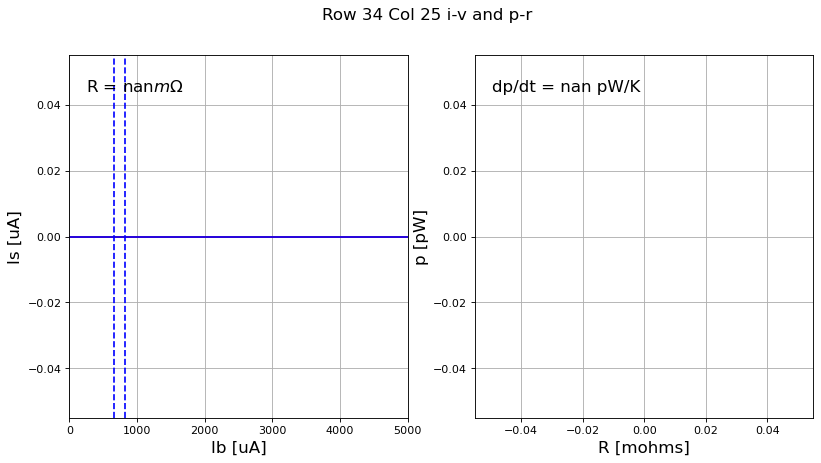

nan nan
row 34, col 26


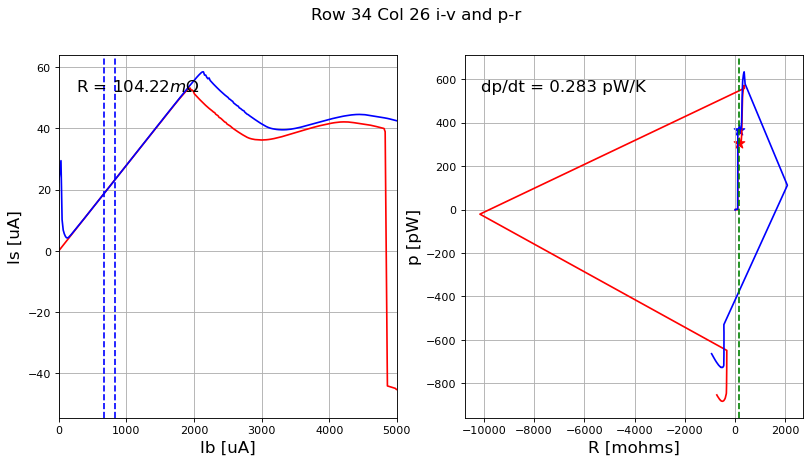

0.2830193940186303 0.10421692051105474
row 34, col 27


/home/yuka/oe_analysis/lcdata.py:266: RuntimeWarning: All-NaN slice encountered
  maxInorm = np.nanmax(Inorm)


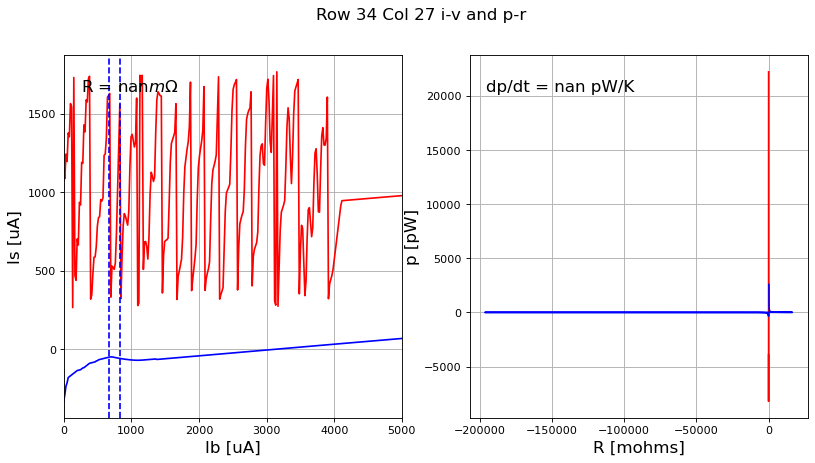

nan nan
row 34, col 28


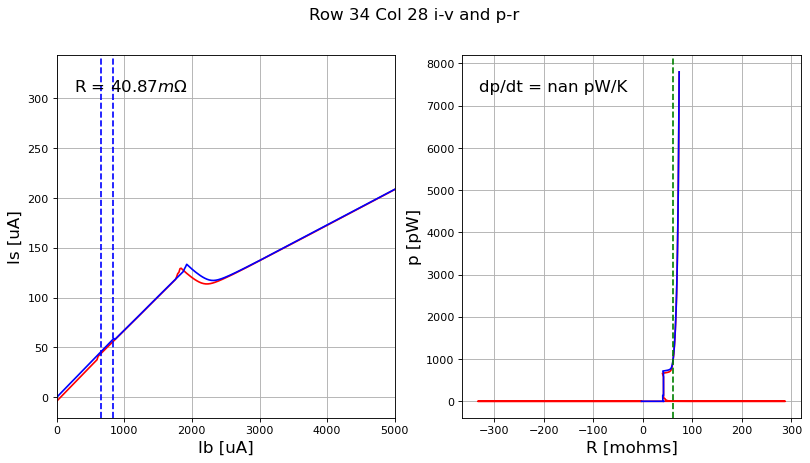

nan 0.040866106044237224
row 34, col 29


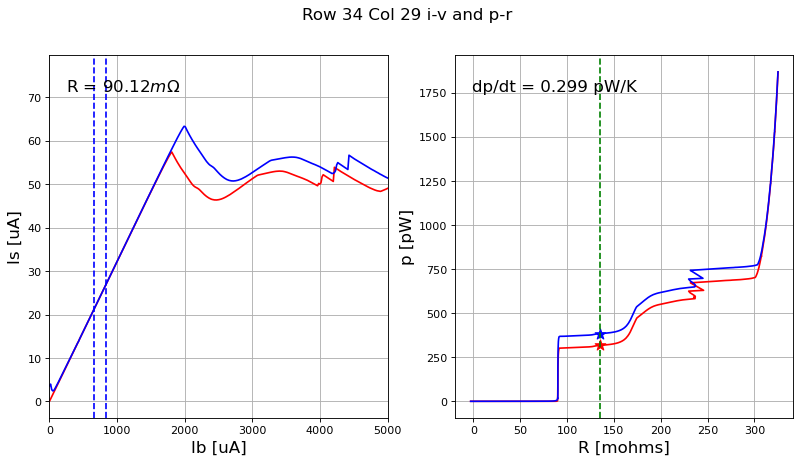

0.29908266967788644 0.09012272683723399
row 34, col 30


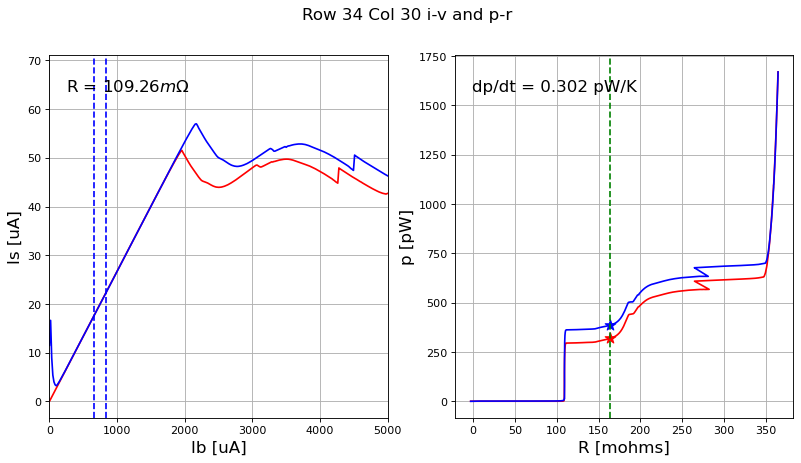

0.30179402764877605 0.10926499006486137
row 34, col 31


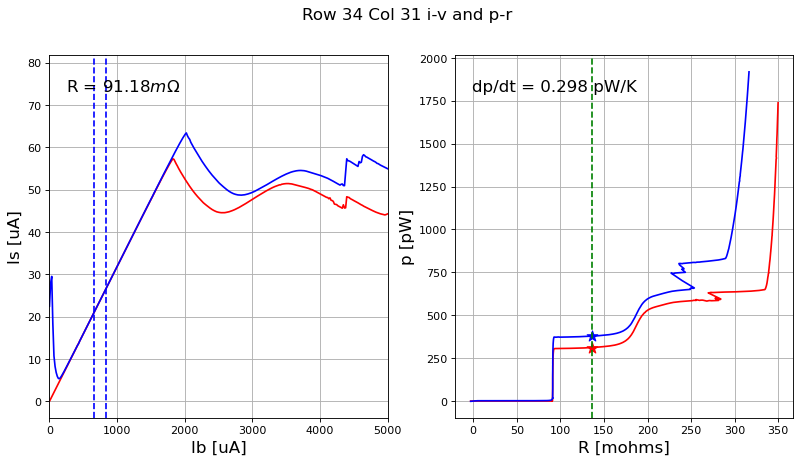

0.2978207915585548 0.0911796298354728
row 35, col 16


In [ ]:
dpdt_values = []
rnti_values=[]
rnpsat_values=[]

for row in opts.rows:
    for col in opts.cols:

        im,detcol,detrow,detpol = minfo.mce2det(col%16,row)
        detcol_array[col][row] = detcol # in pW/K
        detrow_array[col][row] = detrow # in mOhms
        detpol_array[col][row] = detpol # in mOhms

        print('row %d, col %d'%(row, col))
        fitrange = opts.fitrange
        #bad_det = [(row, col),(16,14),(24,11),(11,8),(22,9),(29,8),(32,12),(18,12),(9,13)]
        bad_det = []
        
        #*****************************
        #pl.plot(bias300, y300[row,col])
        #pl.plot(bias077, y077[row,col])
        #pl.show()
        
        bias_mask1=np.where(bias300<50000)[0]
        bias_mask2=np.where(bias077<50000)[0]
        #pl.plot(bias300[bias_mask1], y300[row,col][bias_mask1])
        #pl.plot(bias077[bias_mask2], y077[row,col][bias_mask2])
        #pl.show()

        ibias300, ites300, rnti300, ksc300, __, a  = lc(bias300[bias_mask1], y300[row,col][bias_mask1], calib, fitrange, row, col,  DCflag='RN') # fit range
        ibias077, ites077, rnti077, ksc077, __, b = lc(bias077[bias_mask2], y077[row,col][bias_mask2], calib, fitrange, row, col,  DCflag='RN')
        rnti = (rnti300 + rnti077)/2.
        rnpsat = 1.5*rnti

        rr300, pp300, psat300 = pr(ibias300, ites300, calib, rnti300, rnpsat, row=row, col=col, reasonableInorm=opts.reasonableInorm300)
        #psat300_array[col][row] = psat300*1.0e12 # in pW/K
        mask = np.where(np.logical_and((rr300<0.15), (pp300<400e-12)))[0]
        #mask = np.where((rr300<0.15))[0]
        idx300 = np.where(np.logical_and((rr300[mask]>=1.1*rnti300),(rr300[mask]<=1.2*rnti300)))[0]
        pp300_mask = pp300[mask]
        #psat300=np.nanmean(pp300_mask[idx300])

        rr077, pp077, psat077 = pr(ibias077, ites077, calib, rnti077, rnpsat, row=row, col=col, reasonableInorm=opts.reasonableInorm077) 
        psat077_array[col][row] = psat077*1.0e12 # in pW/K
        mask = np.where(np.logical_and((rr077<0.15), (pp077<400e-12)))[0]
        #mask = np.where((rr077<0.15))[0]
        # pl.plot(rr077[mask], pp077[mask])
        # pl.scatter(rnpsat077, psat077)
        # pl.show()
        idx077=np.where(np.logical_and((rr077[mask]>=1.1*rnti077),(rr077[mask]<=1.2*rnti077)))[0]
        pp077_mask = pp077[mask]
        #psat077=np.nanmean(pp077_mask[idx077])

        dpdt = (psat077 - psat300)/(300.-77.)*1.0e12
        dpdt_values.append(dpdt)
        rnti_values.append(rnti)
        rnpsat_values.append(rnpsat)
        #print(rnti077, rnti300) # change this to print out the equation!!!
        #print(rnti)
        #print(dpdt, rnti)
        #plt.plot (dpdt, rnti)

        plotit=True
        if(dpdt > .0001):
            plotit=True
        #print("dpdt %.3f pW/K"%dpdt)
        # Output
        if(rnti>2.0):
            print('#####################')
            print(col,row)
        if(rnti>3.0 or rnti<0.00) or (dpdt>.5 or dpdt<0.0):
            #print('elim')
            #print(dpdt,rnti)

            dpdt = float('nan')
            rnti   = float('nan')
            nancount+=1

        if (row, col) in bad_det:
            dpdt_array[col][row] = np.nan # in pW/K
            psat300_array[col][row] = np.nan # in pW/K
            psat077_array[col][row] = np.nan # in pW/K
            rnti_array[col][row] = np.nan # in mOhms
        else:
            dpdt_array[col][row] = dpdt # in pW/K
            psat300_array[col][row] = psat300*1.0e12 # in pW/K
            psat077_array[col][row] = psat077*1.0e12 # in pW/K
            rnti_array[col][row] = rnti*1000.0 # in mOhms

        im,detcol,detrow,detpol = minfo.mce2det(col%16,row)
        detcol_array[col][row] = detcol # in pW/K
        detrow_array[col][row] = detrow # in mOhms
        detpol_array[col][row] = detpol # in mOhms

        if (detcol,detrow) in dark_detcolrow:
        	#print('dark saving:', (detcol,detrow))
        	dpdt_dark[col][row] = dpdt
        	#dark_mcecoord.append((col,row))

        # plotting out i-v and p-r
        out_path_fig = out_path+'optfig/'
        if not os.path.isdir(out_path_fig):
            os.makedirs(out_path_fig)

        if (opts.doFigure and plotit):
            pl.figure(figsize=(12,6), dpi=80)
            pl.clf()

            ax = pl.subplot(1,2,1)
            pl.plot(ibias300*1e6,ites300*1e6,'r', label='300K')
            pl.plot(ibias077*1e6,ites077*1e6,'b', label='77K')
            pl.text(0.05, 0.9, 'R = %.2f'%(rnti*1000)+r'$m\Omega$', fontsize=15, transform=ax.transAxes)
            pl.xlabel('Ib [uA]', fontsize=15)
            pl.ylabel('Is [uA]', fontsize=15)
            pl.axvline(x = opts.fitrange['rnti_low']*calib["BIAS_CAL"][0]*1e6,color='b', linestyle='--')
            pl.axvline(x = opts.fitrange['rnti_hgh']*calib["BIAS_CAL"][0]*1e6,color='b', linestyle='--')
            pl.xlim(0,5000)
            pl.grid()

            ax = pl.subplot(1,2,2)
            pl.suptitle('Row %02d'%row + ' Col %02d'%col +' i-v and p-r ', fontsize=15)
            pl.plot(rr300*1.0e3,pp300*1.0e12,'r', rr077*1.0e3,pp077*1.0e12,'b') # pW-mOhms
            plt.axvline(x=rnpsat*1.0e3,color='g',linestyle='--')
            plt.scatter([rnpsat*1.0e3],[psat077*1.0e12], s=100, color='b', marker='*')
            plt.scatter([rnpsat*1.0e3],[psat300*1.0e12], s=100, color='r', marker='*')
            #pl.ylim(opts.pmin, opts.pmax)
            #pl.xlim(opts.rmin, opts.rmax)
            pl.text(0.05, 0.9, 'dp/dt = %.3f pW/K'%dpdt, fontsize=15, transform=ax.transAxes)
            pl.xlabel('R [mohms]', fontsize=15)
            pl.ylabel('p [pW]' , fontsize=15)
            pl.grid()
            
            #if opts.ifoutputinMCE:
            #    fn = os.path.join(out_path_fig+'opteff_mcerow'+str(row)+'_mcecol'+str(col)+'.png')
            if (detcol,detrow) in dark_detcolrow:
                fn = os.path.join(out_path_fig+'opteff_detrow'+str(detrow)+'_detcol'+str(detcol)+'_pol'+str(detpol)+'_dark.png')
            else:
                fn = os.path.join(out_path_fig+'opteff_detrow'+str(detrow)+'_detcol'+str(detcol)+'_pol'+str(detpol)+'.png')
            	#fn = os.path.join(out_path_fig,'opteff_mcerow%02d'%( row) + '_mcecol%02d.png'%col)
            #if (detcol,detrow) in dark_detcolrow:
            pl.savefig(fn)
            pl.show()

            print (dpdt, rnti)

In [ ]:
oedata = {'dpdt':dpdt_array, 'dpdt_dark':dpdt_dark, 'psat077':psat077_array, 'psat300':psat300_array, 'rnti':rnti_array, 'detcol':detcol_array, 'detrow':detrow_array, 'detpol':detpol_array,}
fnpickle ='outputs/dpdt_results.txt'
f = open(fnpickle,'wb')
pickle.dump(oedata,f)
f.close()